In [1]:
# Imports

import numpy as np
import matplotlib
from matplotlib import pyplot as plt
%matplotlib inline     
## use `%matplotlib notebook` for interactive figures
# plt.style.use('ggplot')
from scipy.stats import gaussian_kde

import tigramite
from tigramite import data_processing as pp
from tigramite.toymodels import structural_causal_processes as toys
from tigramite import plotting as tp
from tigramite.independence_tests.robust_parcorr import RobustParCorr
from tigramite.pcmci import PCMCI
from tigramite.graphs import Graphs

from tigramite.toymodels import surrogate_generator 

from tigramite.models import Models
from tigramite.causal_effects import CausalEffects

import sklearn
from sklearn.linear_model import LinearRegression, LogisticRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.neural_network import MLPRegressor 
from tigramite.causal_effects import CausalEffects
from sklearn.gaussian_process import GaussianProcessRegressor
from sklearn.preprocessing import StandardScaler
from tigramite.data_processing import DataFrame


import pandas as pd
import ast
# Find more estimators in sklearn!

In [2]:
cd

/Users/alondraalvarez


In [3]:
cd Desktop/REU 2025

/Users/alondraalvarez/Desktop/REU 2025


In [4]:
############################### Data ########################################

In [21]:
site = "S3"

path = f"{site}_data/30_min_CO2_aerosols/"
path_complete = f"{site}_data/30_min_CO2_aerosols/Morning/"

# Events
Events = pd.read_csv(path_complete + f"{site}_resumen_morning_10h.csv")

morning_events = list(zip(
    pd.to_datetime(Events['start_time']),
    pd.to_datetime(Events['end_time'])))


In [22]:
def get_path_effect(graph, X, Y, mediation=None, conf_lev=0.9):
    causal_effects = CausalEffects(graph, graph_type='stationary_dag', 
                                    X=X, Y=Y, 
                                   S=None, 
                                   verbosity=0)

    dox_vals = np.linspace(0., 1., 2)

    # Fit causal effect model from observational data
    causal_effects.fit_wright_effect(
        dataframe=dataframe, 
        mask_type='y',
        mediation=mediation, #'direct',
        method = 'parents',
        data_transform=data_transform, #sklearn.preprocessing.StandardScaler(),
        )

    # Predict effect of interventions do(X=0.), ..., do(X=1.) in one go
    intervention_data = np.repeat(dox_vals.reshape(len(dox_vals), 1), axis=1, repeats=len(X))
    pred_Y = causal_effects.predict_wright_effect( 
            intervention_data=intervention_data)

    # Fit causal effect model from observational data
    causal_effects.fit_bootstrap_of(
        method='fit_wright_effect',
        method_args={'dataframe':dataframe,  
        'mask_type':'y',
        'mediation':mediation, #'direct',
        'data_transform':data_transform,
        },
        seed=42
        )

    # Predict effect of interventions do(X=0.), ..., do(X=1.) in one go
    intervention_data = np.repeat(dox_vals.reshape(len(dox_vals), 1), axis=1, repeats=len(X))
    conf = causal_effects.predict_bootstrap_of(
        method='predict_wright_effect',
        method_args={'intervention_data':intervention_data},
        conf_lev=conf_lev)

    print("Wright's path effect    = %.2f [%.2f, %.2f]"
                %(pred_Y[1], conf[0,1], conf[1,1]))
    
    return pred_Y[1], conf[0,1], conf[1,1]

Negative precipitation values in event 0: 0


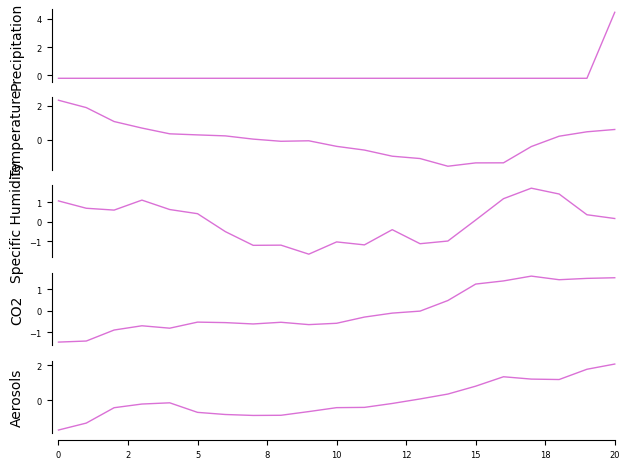

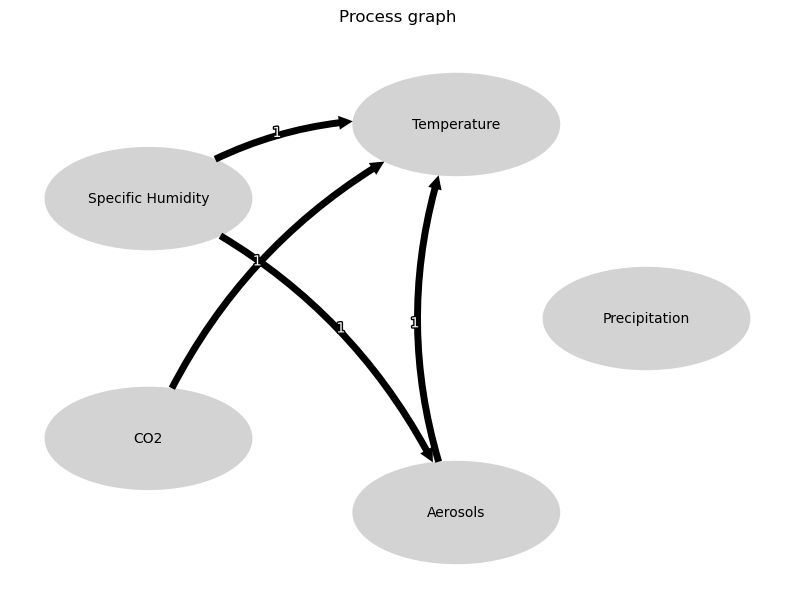


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





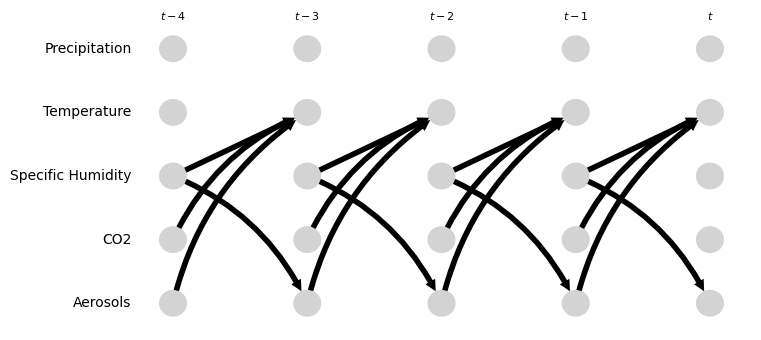

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.43 [-0.37, 1.47]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.05 [-2.11, -0.34]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.57 [0.46, 1.03]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.54 [0.25, 0.72]
Negative precipitation values in event 1: 0


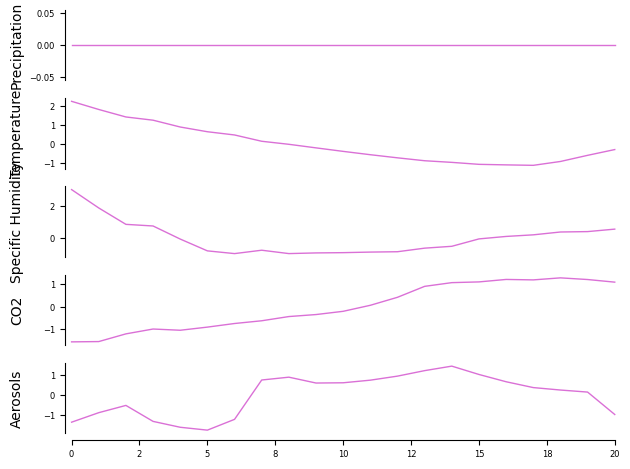

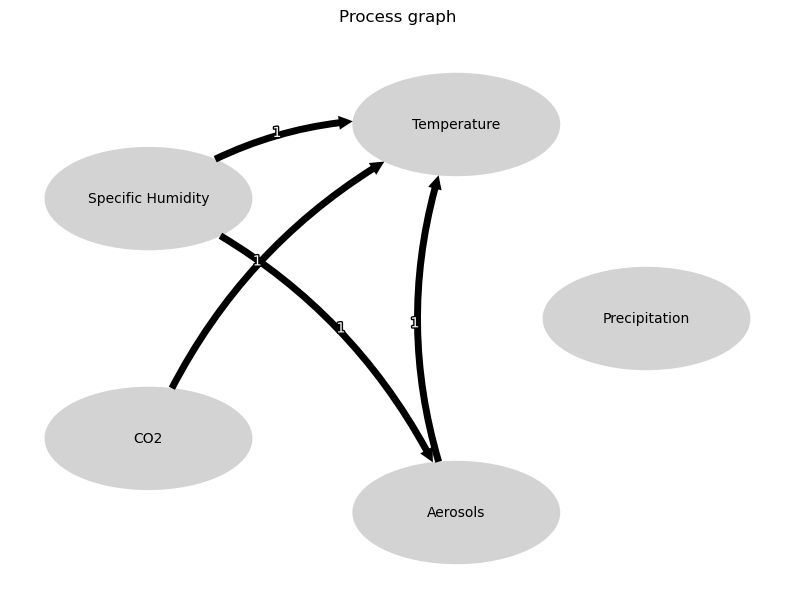


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





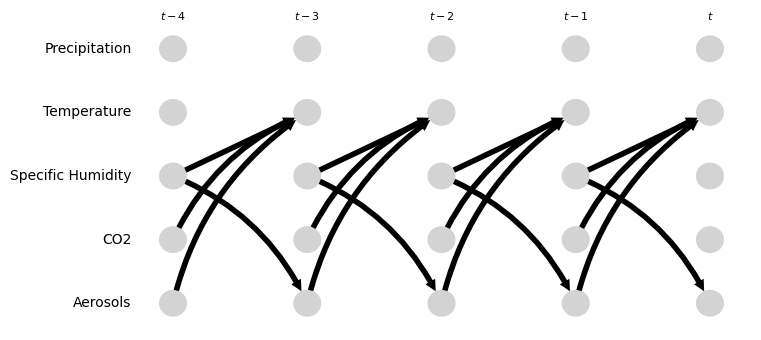

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.60 [-0.76, -0.42]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.15 [-0.28, -0.07]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.44 [0.16, 0.63]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.78 [-1.11, 0.01]
Negative precipitation values in event 2: 0


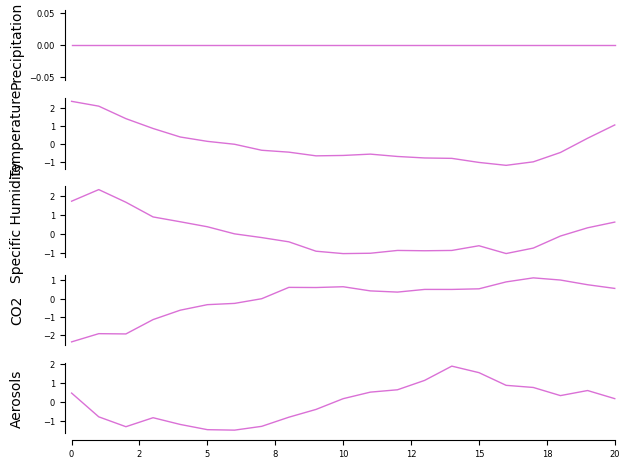

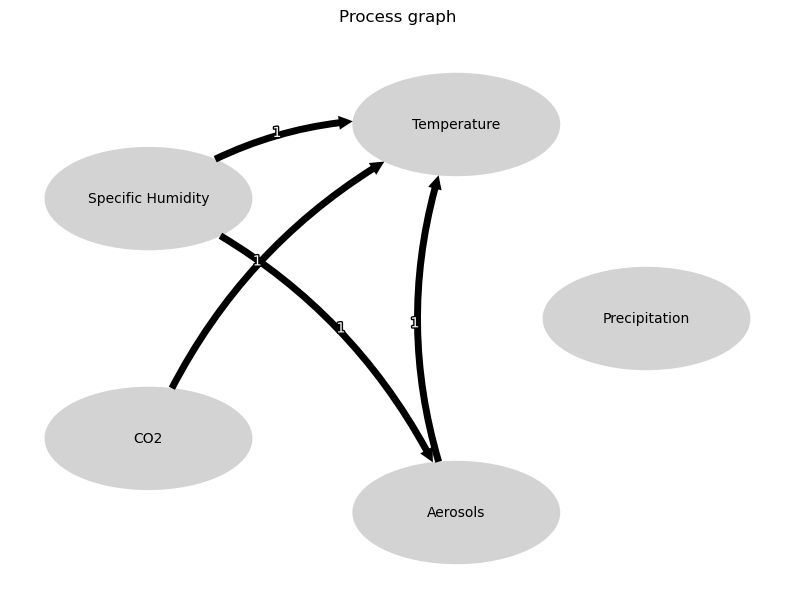


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





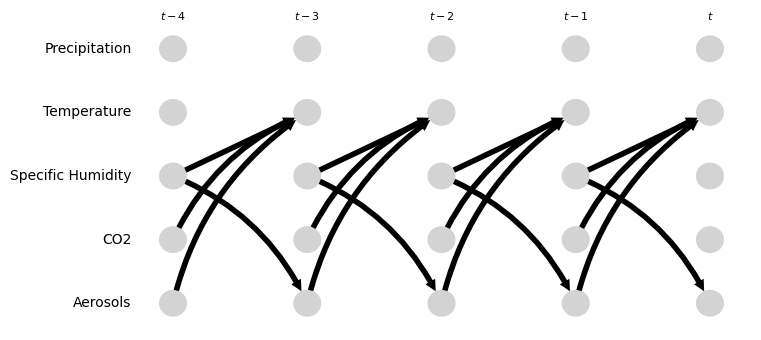

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.65 [-0.26, 0.81]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.06 [-0.31, 0.05]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.05 [-0.06, 0.99]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.38 [-2.12, -1.25]
Negative precipitation values in event 3: 0


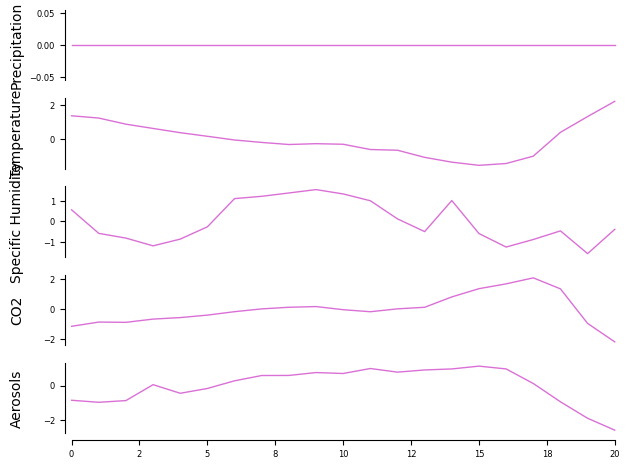

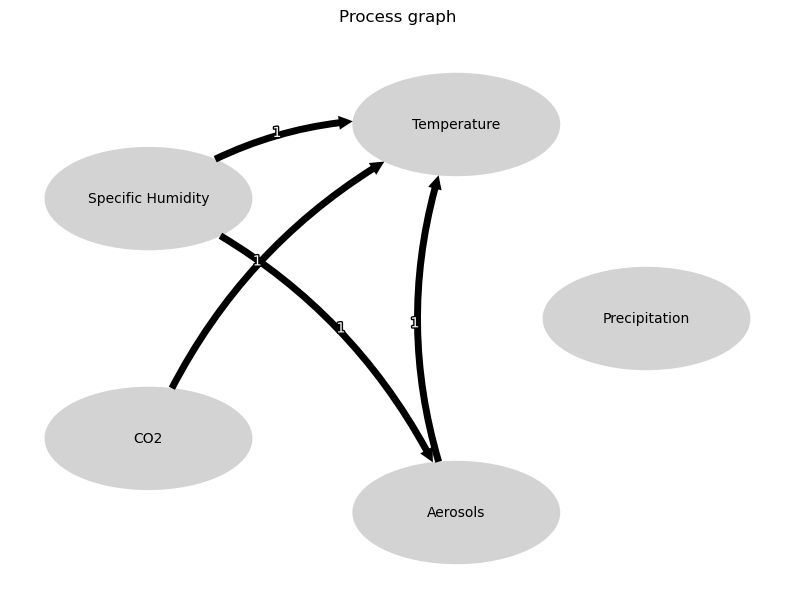


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





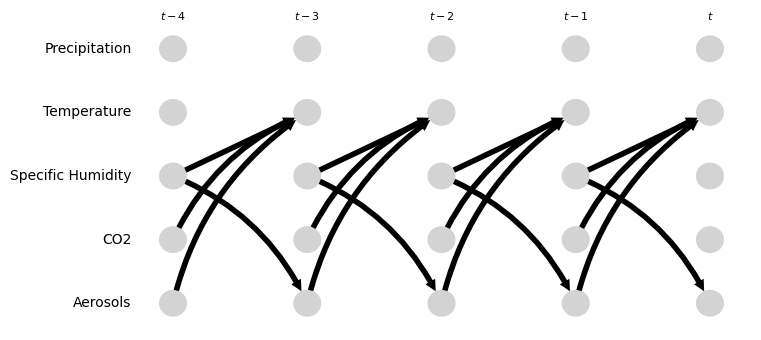

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.21 [-0.04, 0.42]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.36 [-1.55, -1.11]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.23 [0.09, 0.37]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.63 [0.18, 0.71]
Negative precipitation values in event 4: 0


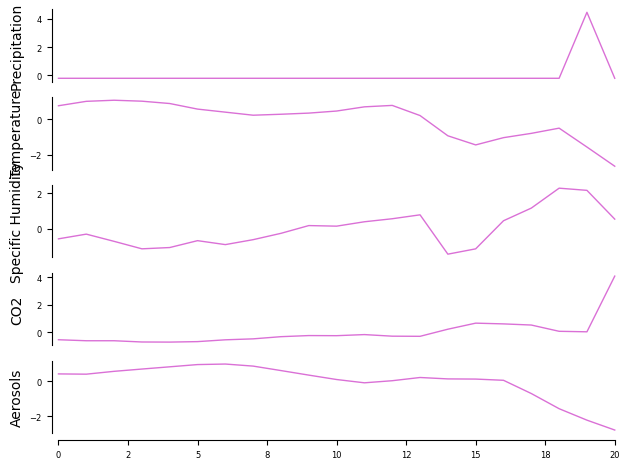

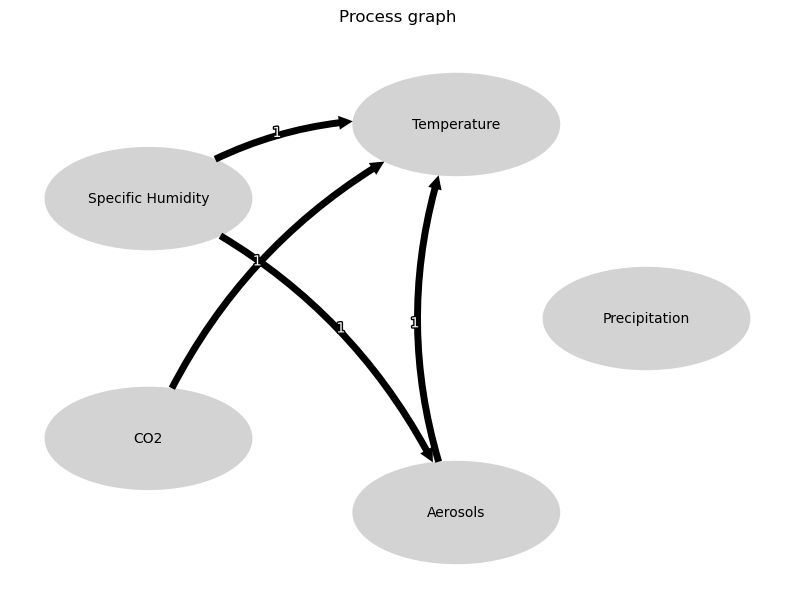


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





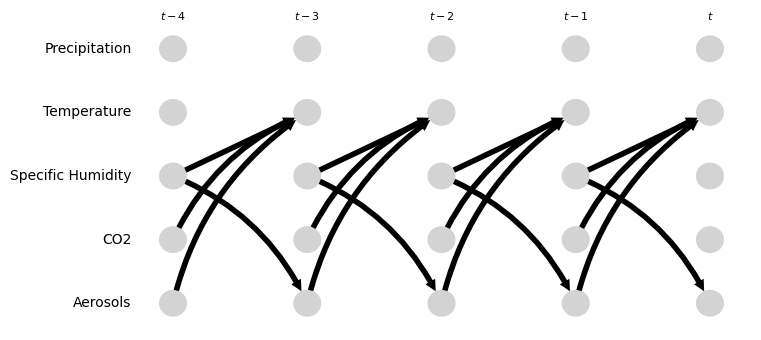

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.37 [-1.66, 0.10]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.22 [-1.55, 1.53]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.45 [-1.28, 0.71]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.86 [-1.00, -0.36]
Negative precipitation values in event 5: 0


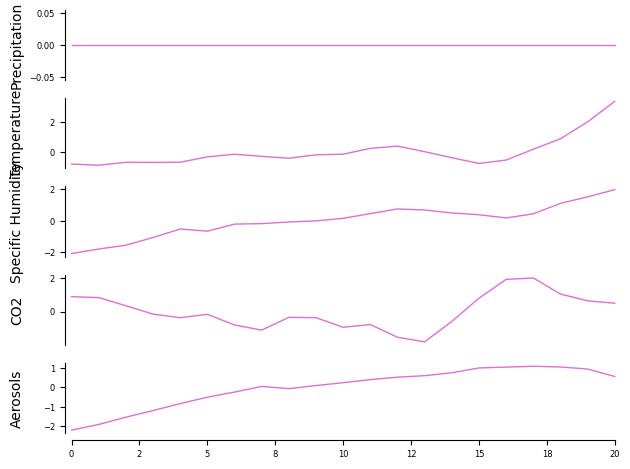

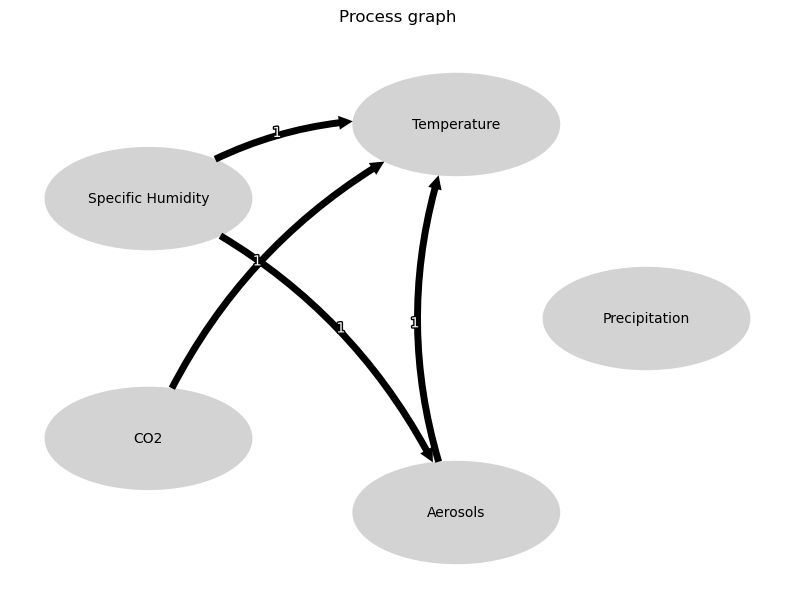


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





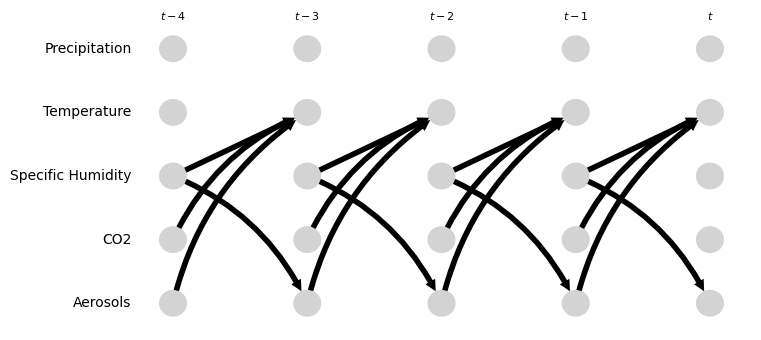

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.71 [0.31, 0.89]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.97 [-2.74, -0.46]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 2.74 [0.63, 3.05]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.62 [0.68, 1.23]
Negative precipitation values in event 6: 0


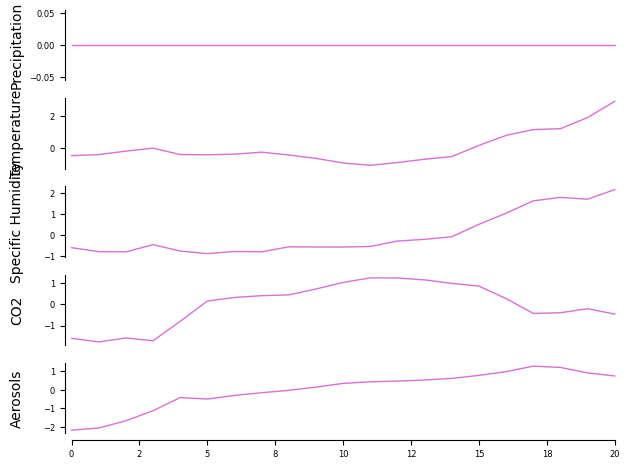

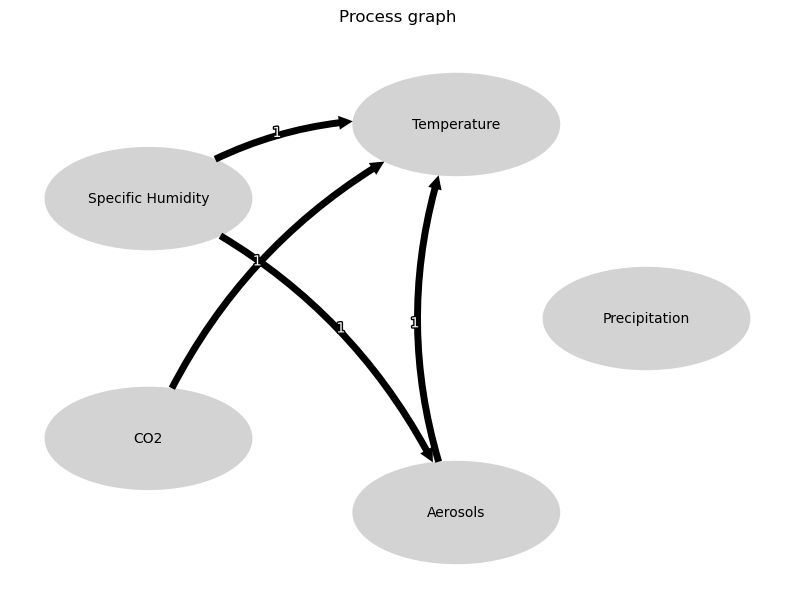


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





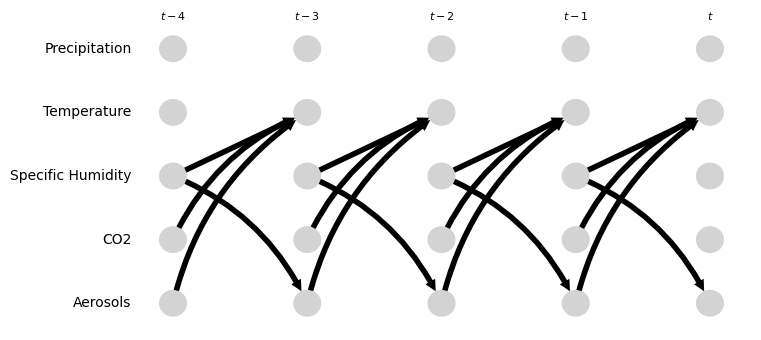

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.60 [-0.00, 0.92]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -2.53 [-3.15, -0.76]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 2.57 [1.31, 3.08]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.43 [0.36, 0.70]
Negative precipitation values in event 7: 0


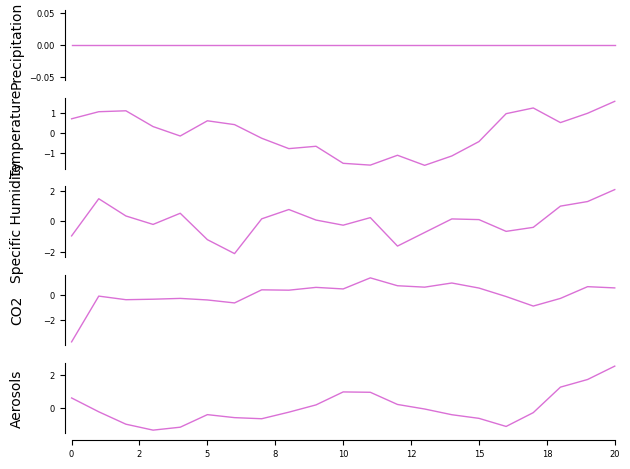

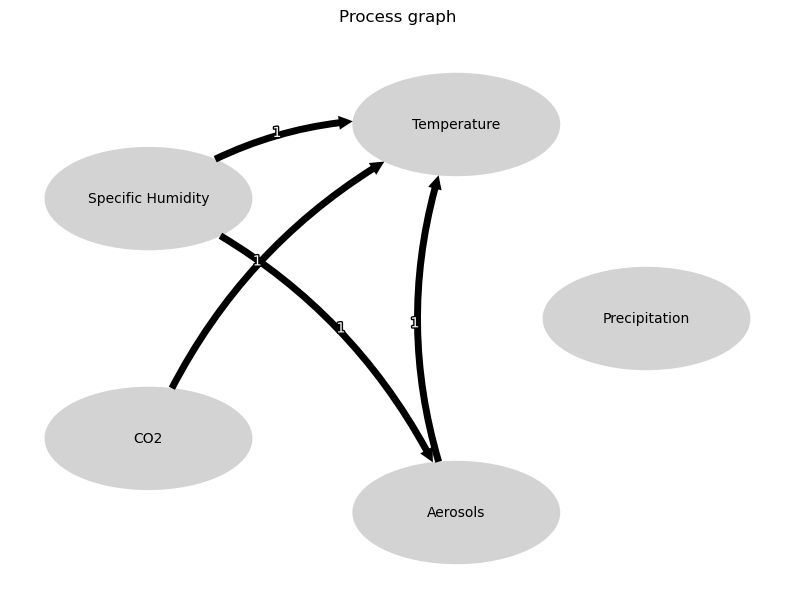


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





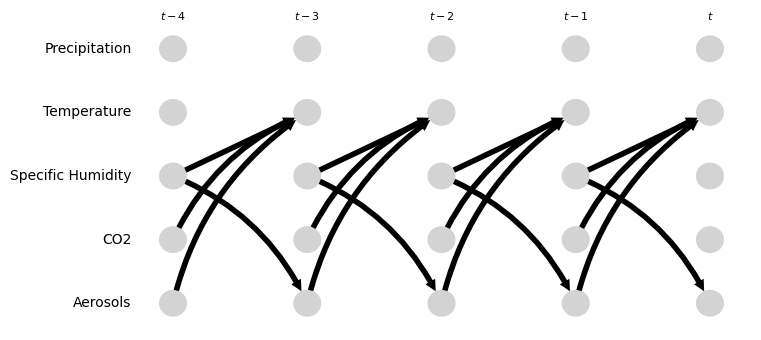

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.07 [-1.47, -0.31]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.09 [-1.07, -0.07]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.61 [0.02, 0.66]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.57 [-0.03, 0.65]
Negative precipitation values in event 8: 0


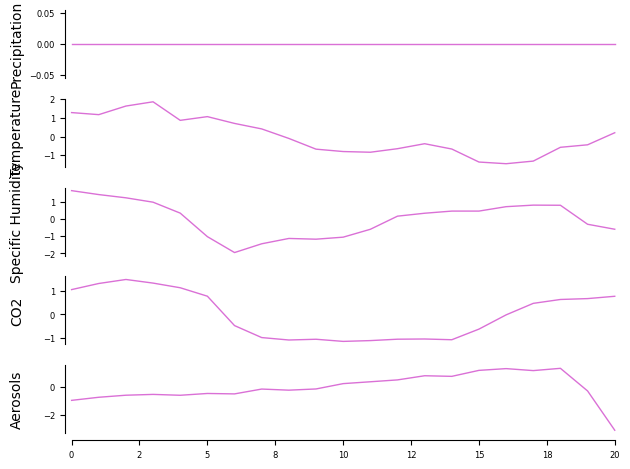

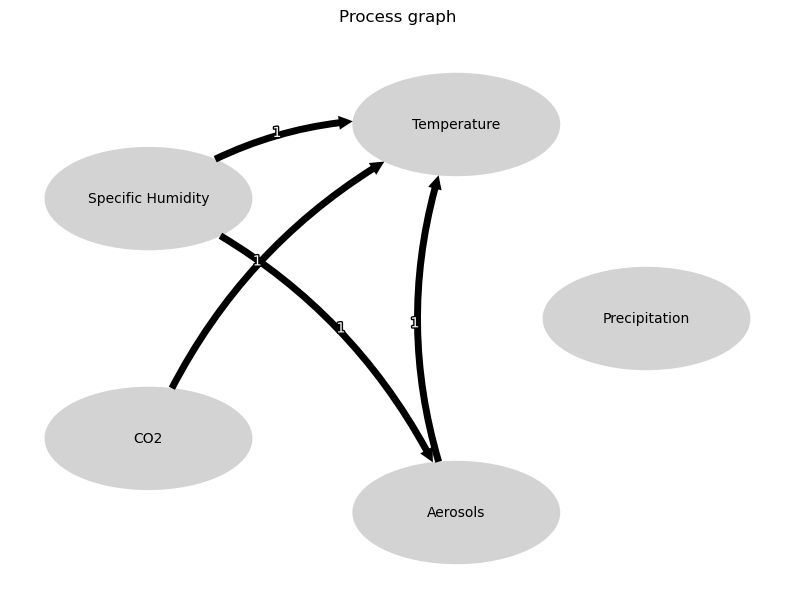


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





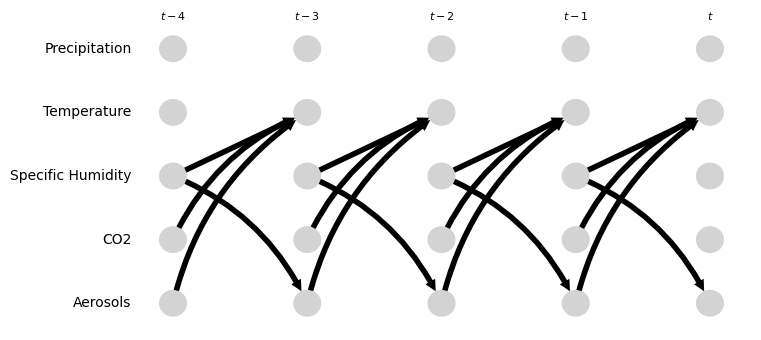

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.46 [0.22, 0.75]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.74 [-1.56, -0.22]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.01 [-0.43, 0.56]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.42 [0.20, 0.69]
Negative precipitation values in event 9: 0


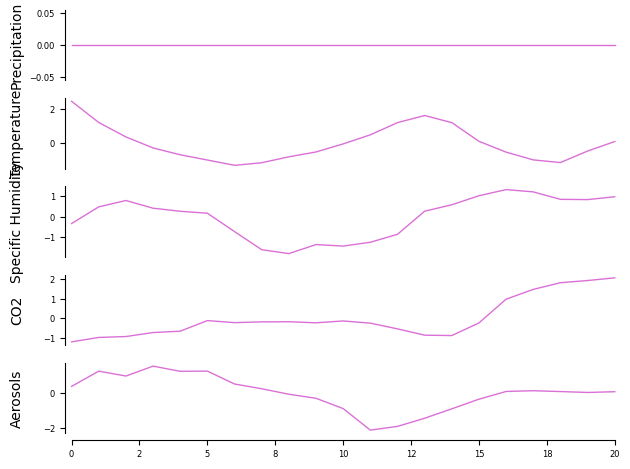

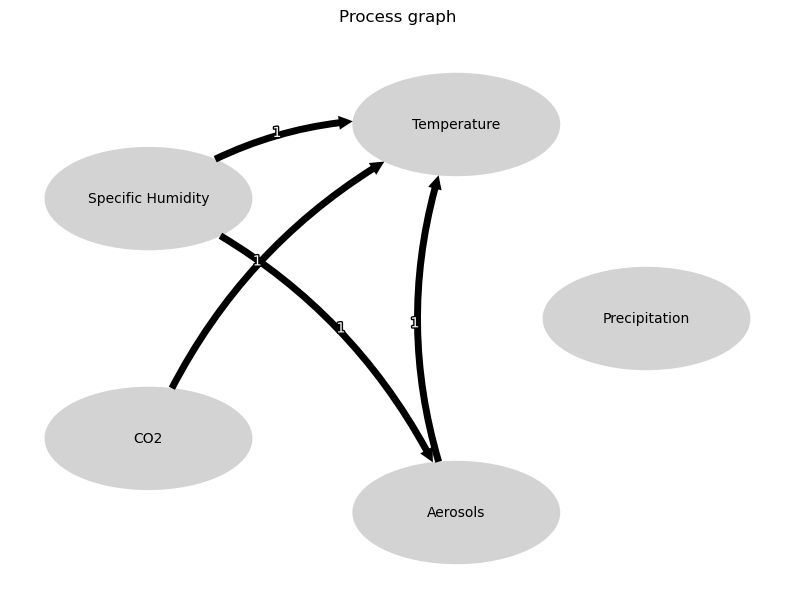


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





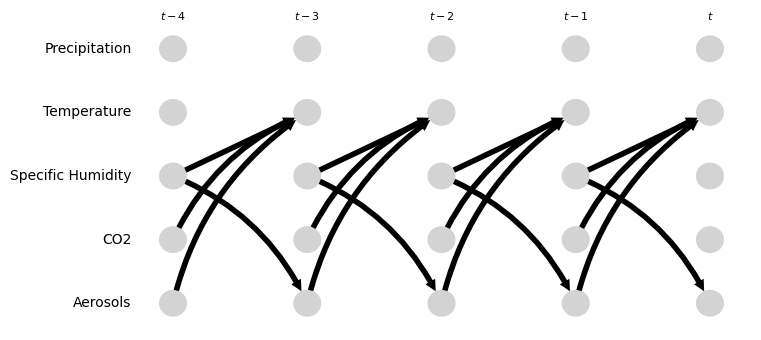

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.04 [-0.54, 0.08]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.83 [-1.02, -0.65]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.04 [-0.16, 0.07]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.43 [0.18, 0.73]
Negative precipitation values in event 10: 0


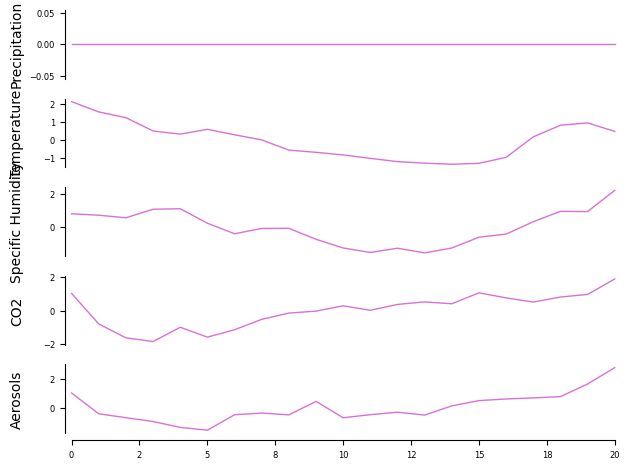

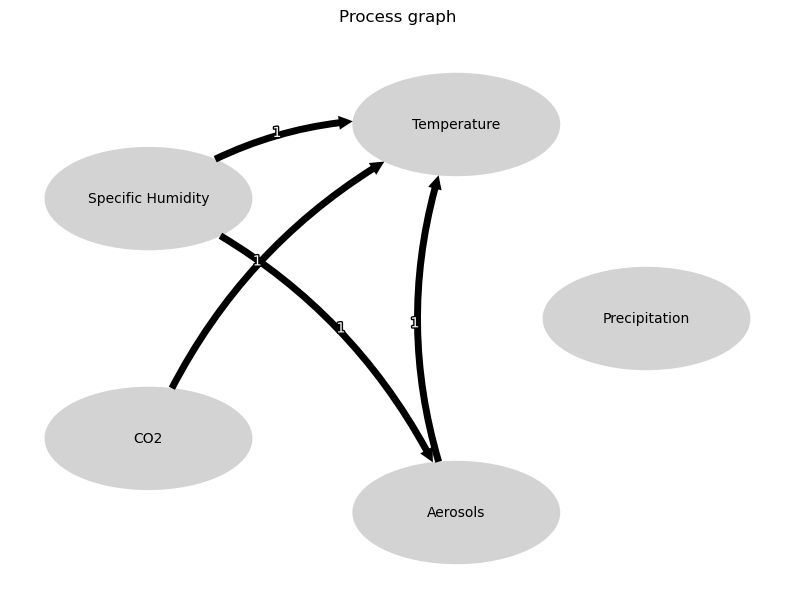


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





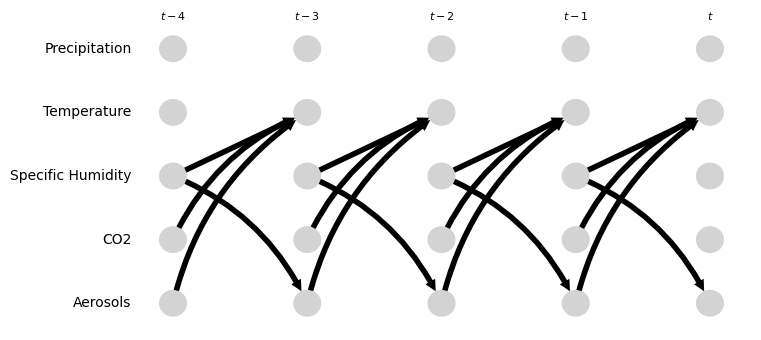

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.14 [-0.52, 0.27]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.17 [-0.05, 0.71]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.79 [0.58, 1.04]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.37 [-0.42, 0.71]
Negative precipitation values in event 11: 0


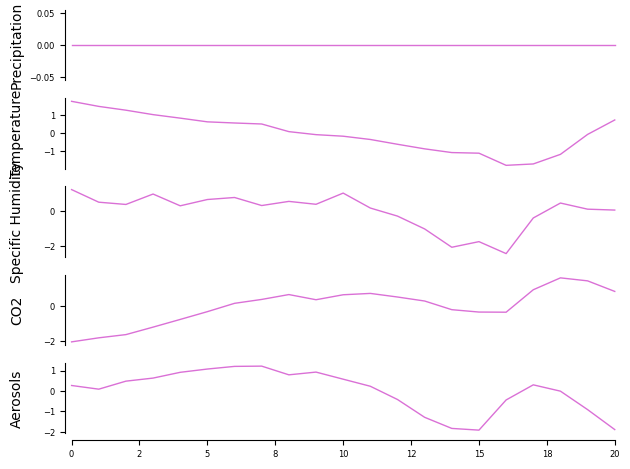

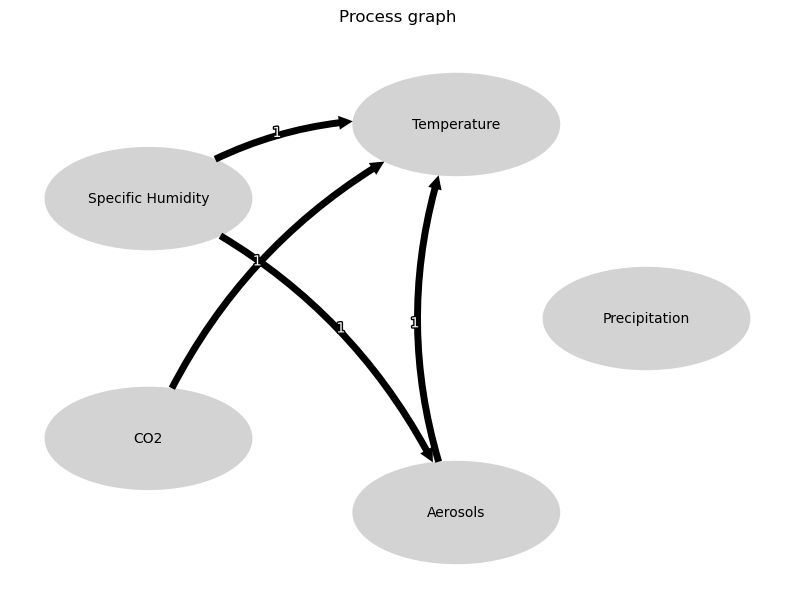


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





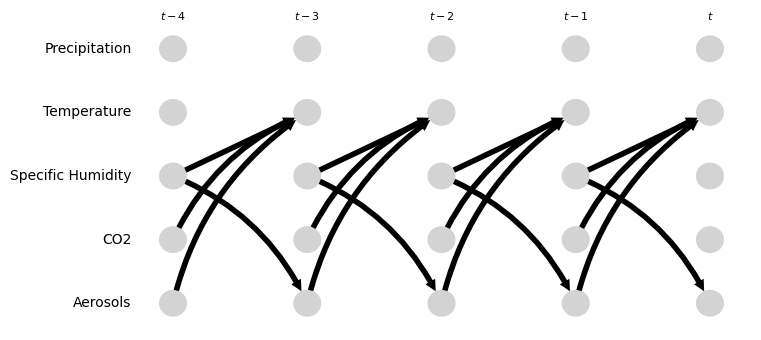

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.25 [-0.83, -0.06]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.09 [-0.12, 0.62]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.74 [0.06, 0.85]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.49 [0.18, 1.05]
Negative precipitation values in event 12: 0


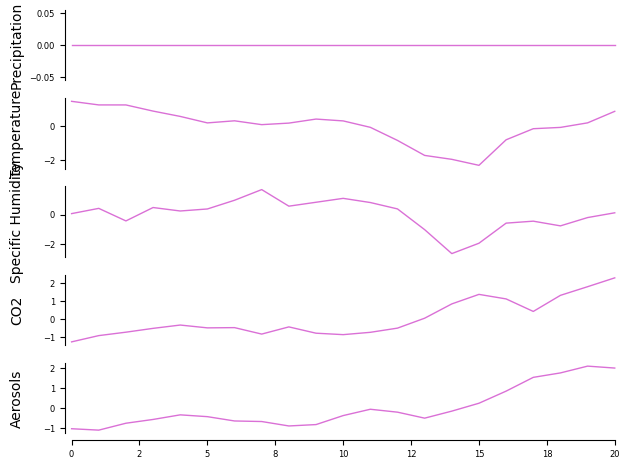

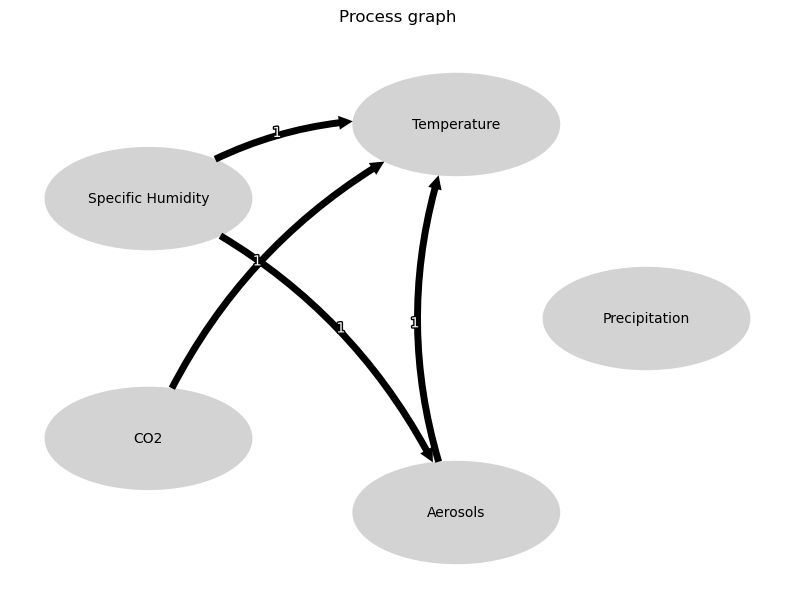


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





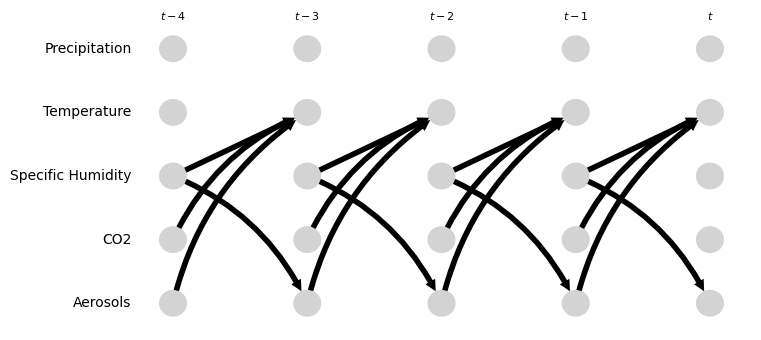

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.10 [0.27, 2.20]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.15 [-0.96, 0.23]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.04 [0.63, 1.62]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.47 [-1.01, -0.28]
Negative precipitation values in event 13: 0


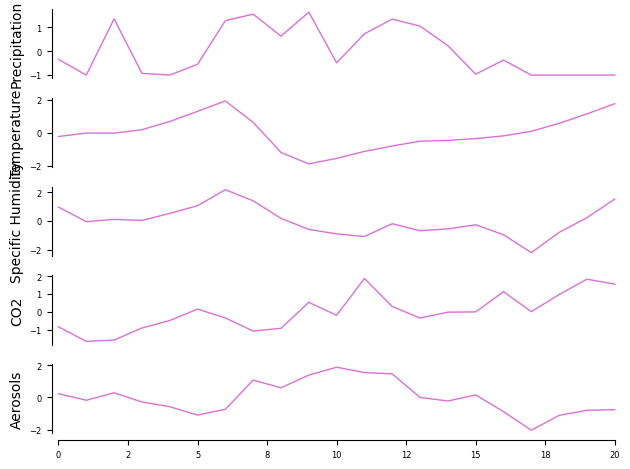

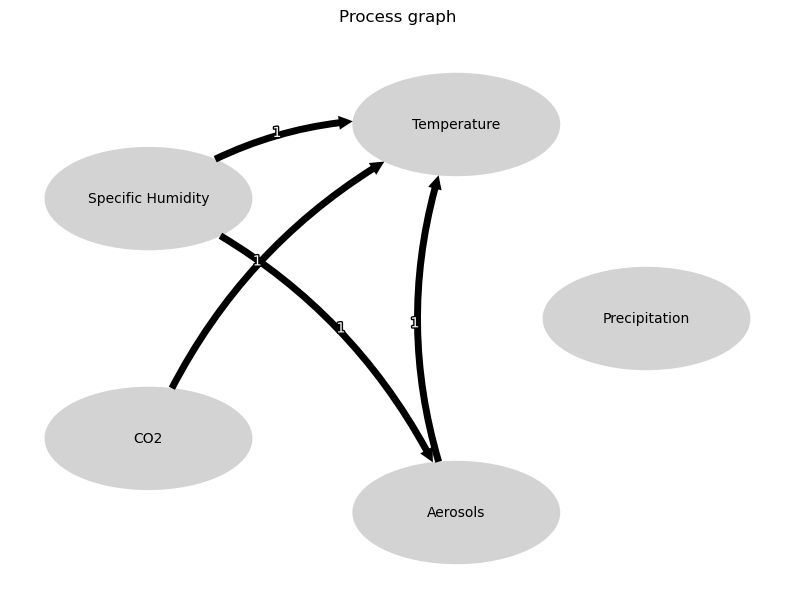


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





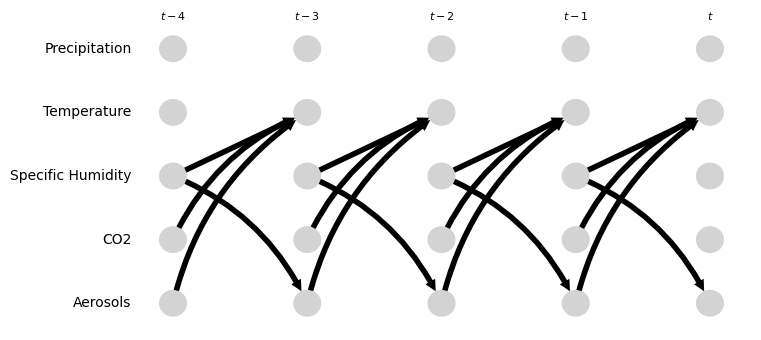

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.54 [0.08, 0.98]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.75 [-1.01, -0.54]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.39 [0.11, 0.75]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.19 [-0.19, 0.47]
Negative precipitation values in event 14: 0


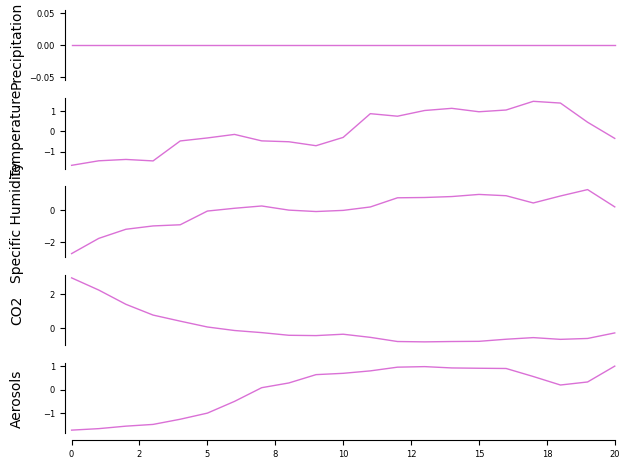

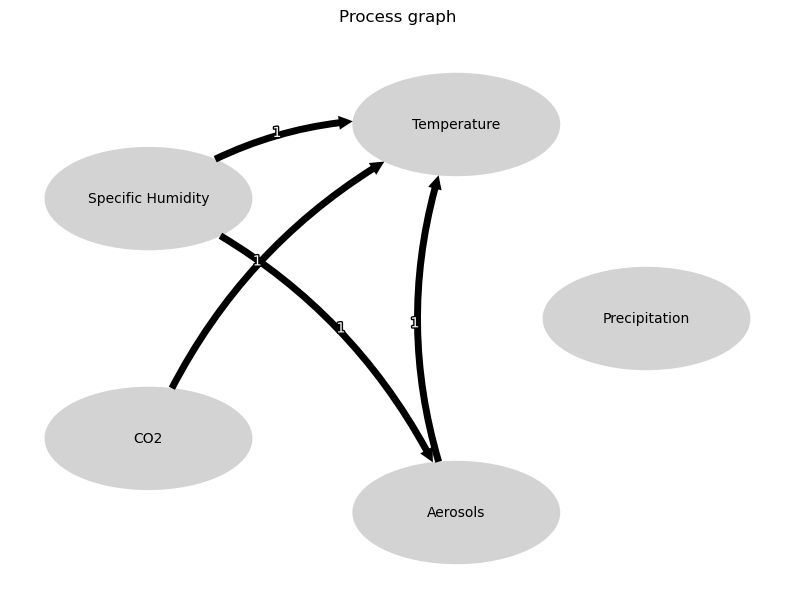


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





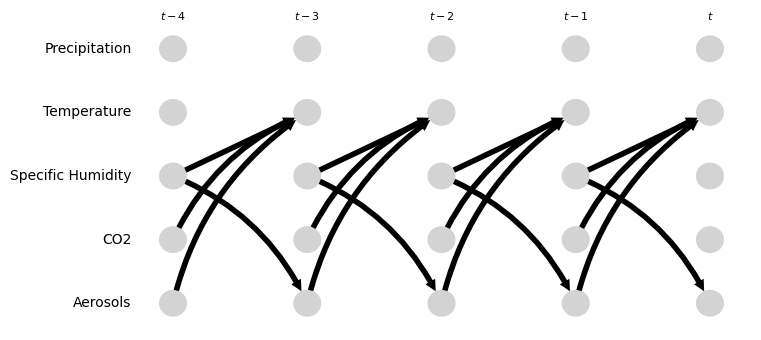

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.71 [-1.56, 7.98]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.88 [-0.23, 2.71]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.31 [-0.41, 3.07]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.70 [0.18, 1.01]
Negative precipitation values in event 15: 0


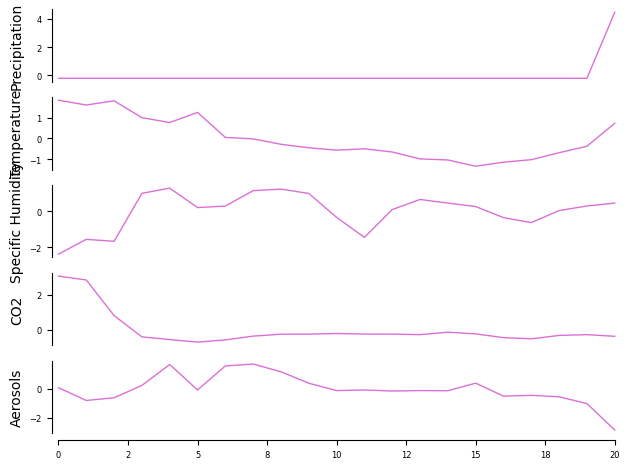

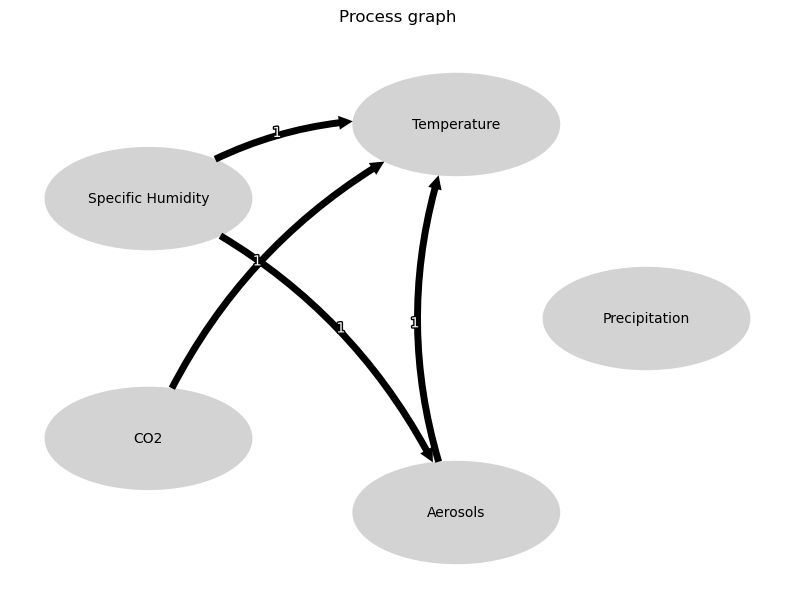


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





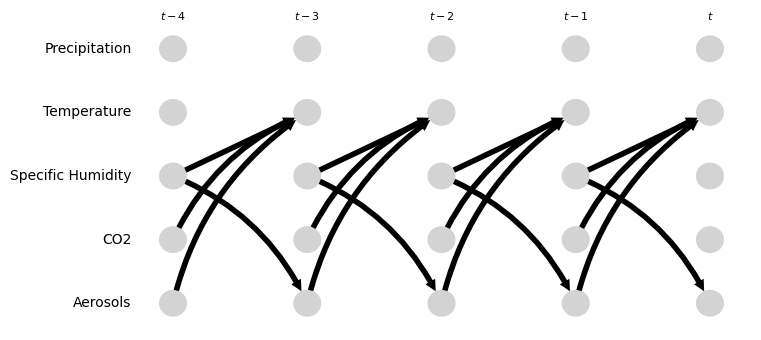

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -2.14 [-3.56, -0.94]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.01 [-0.18, 0.71]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.28 [-0.22, 0.88]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.31 [0.07, 0.64]
Negative precipitation values in event 16: 0


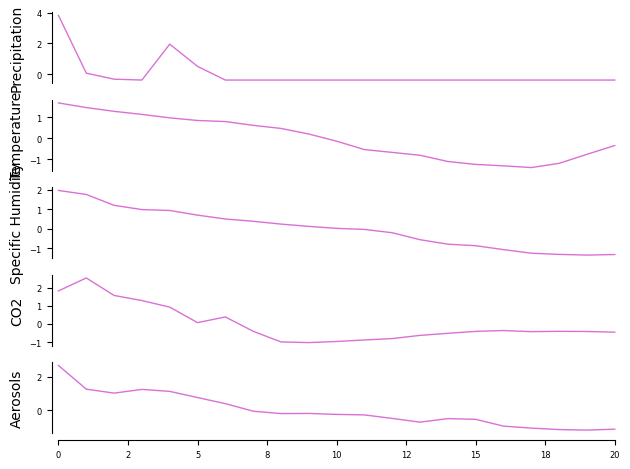

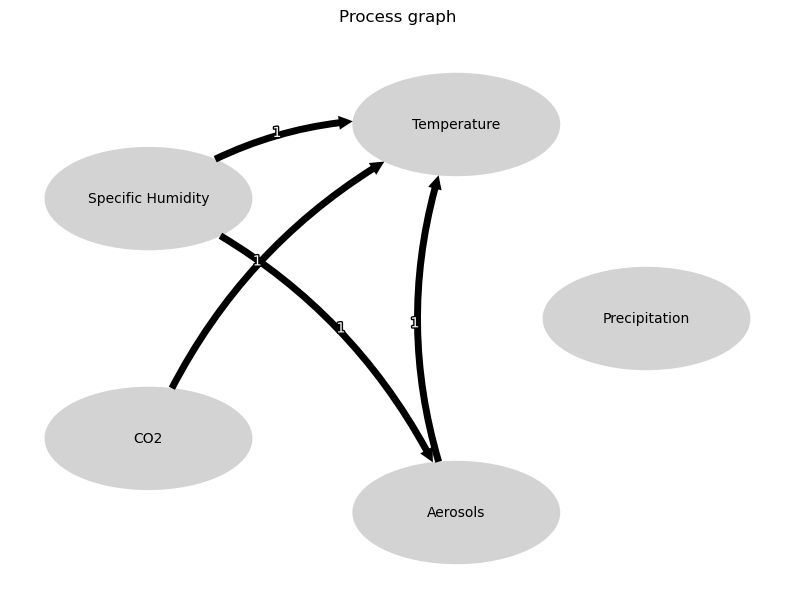


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





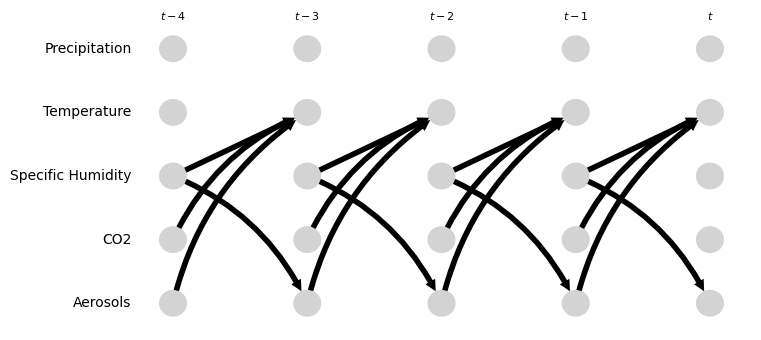

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.81 [0.27, 1.06]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.14 [-1.65, -0.03]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.62 [0.94, 2.01]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.71 [0.56, 0.81]
Negative precipitation values in event 17: 0


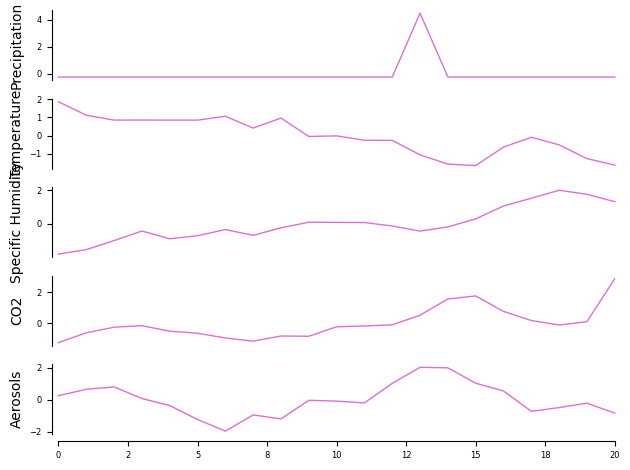

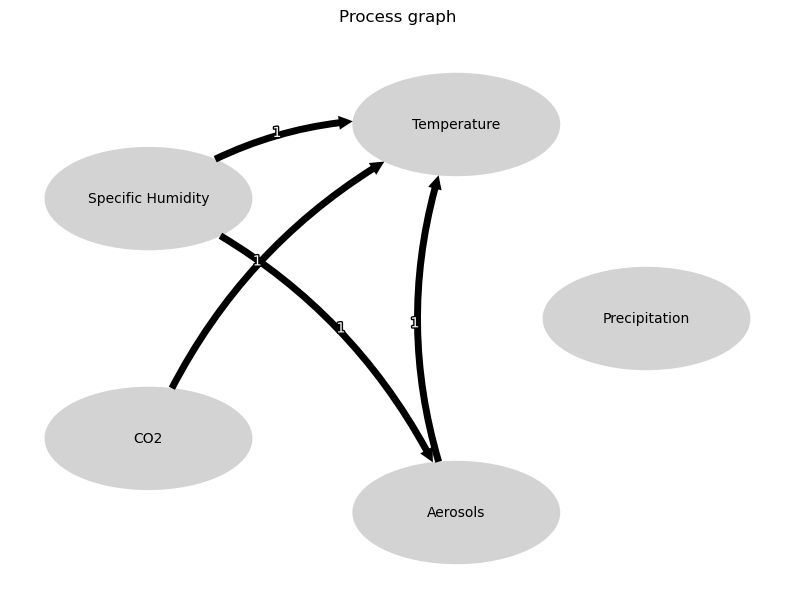


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





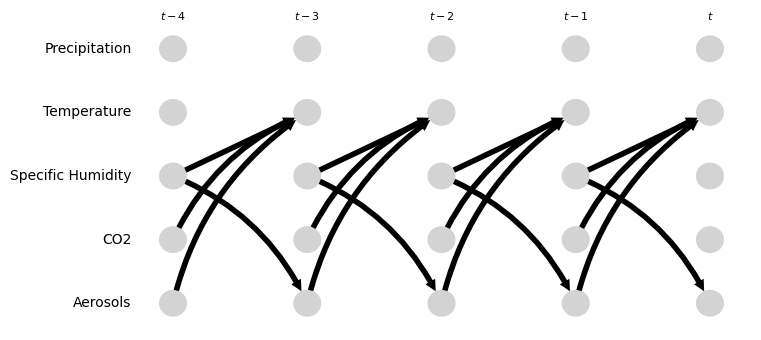

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.17 [-0.29, 0.49]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.64 [-0.88, -0.19]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.58 [-0.69, -0.15]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.05 [-0.48, 0.58]
Negative precipitation values in event 18: 0


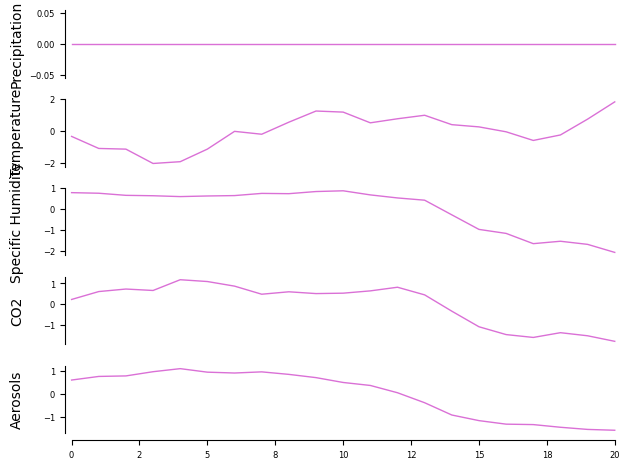

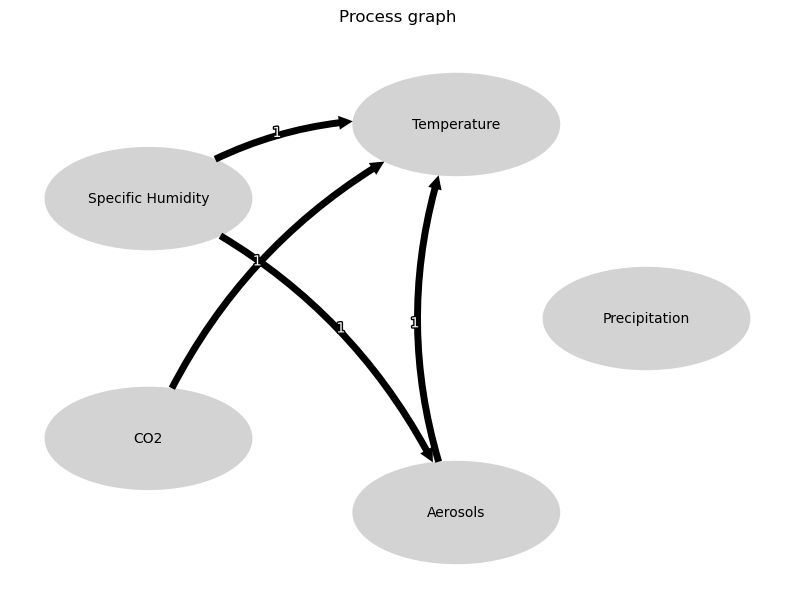


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





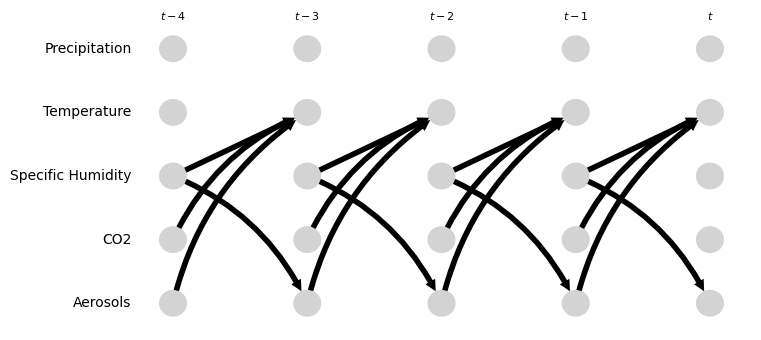

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.57 [-1.65, 0.44]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.35 [-1.12, 0.15]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.93 [0.30, 2.31]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.92 [0.81, 1.12]
Negative precipitation values in event 19: 0


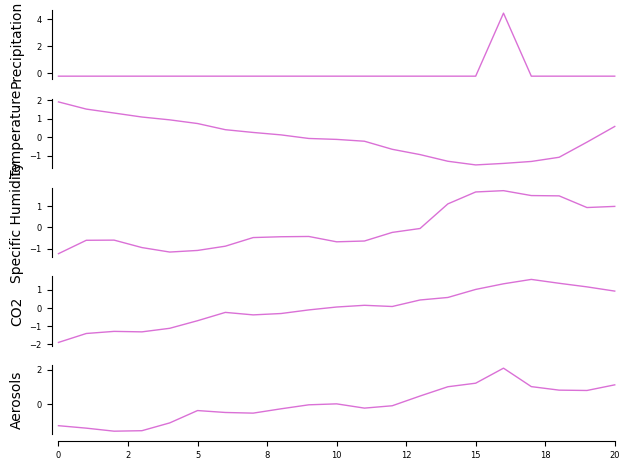

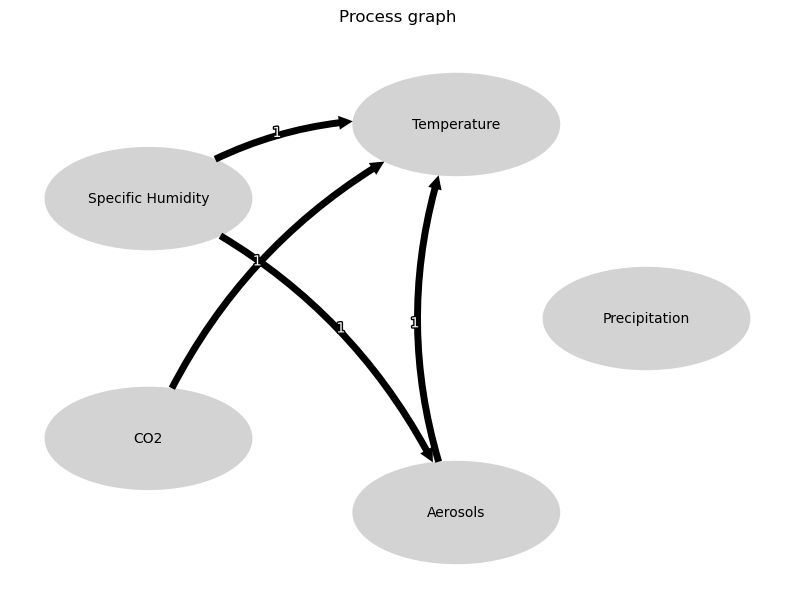


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





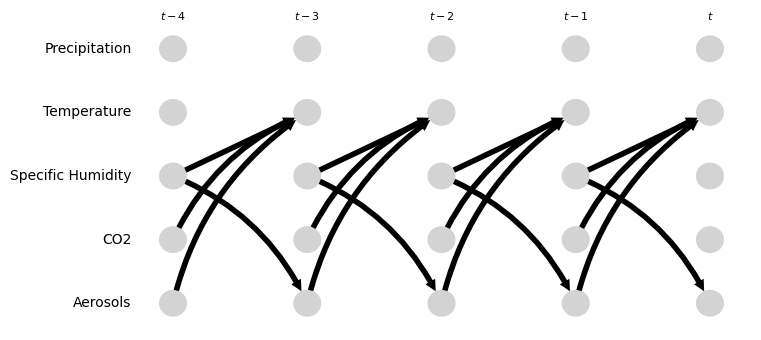

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.17 [-1.03, 0.45]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.87 [-1.67, -0.04]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.07 [-0.43, 0.67]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.64 [0.48, 0.82]
Negative precipitation values in event 20: 0


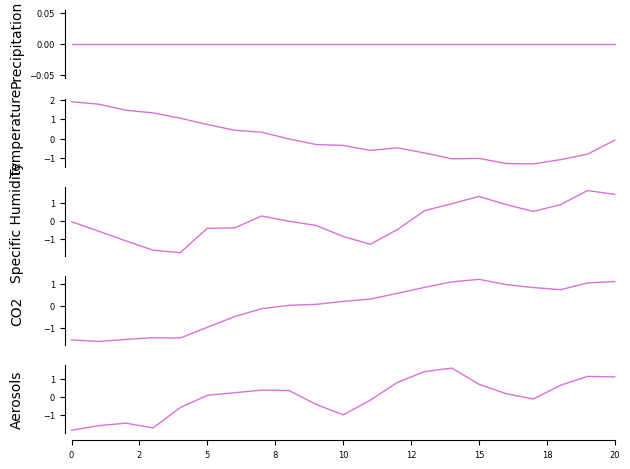

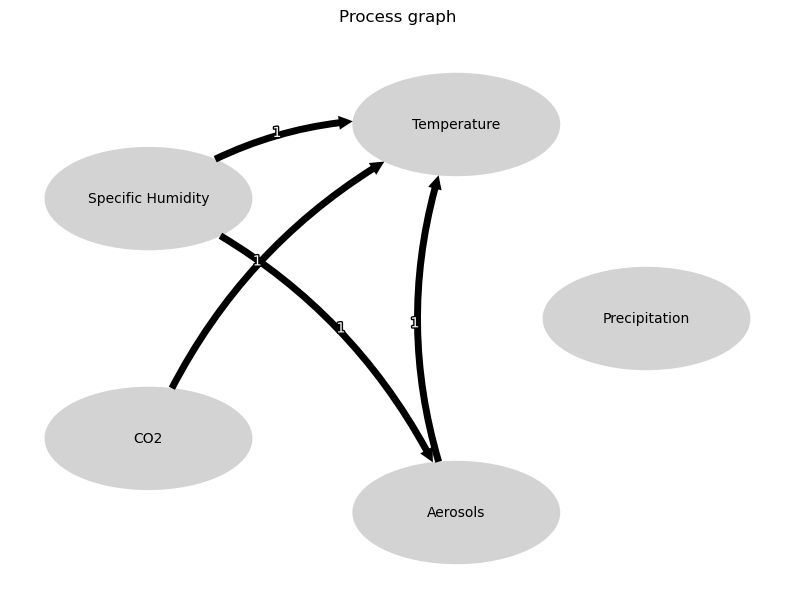


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





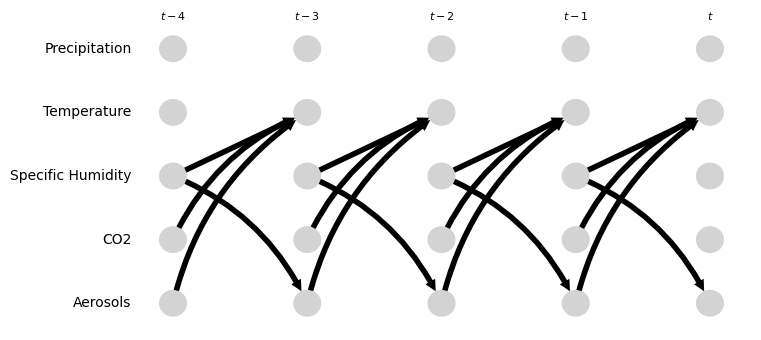

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.92 [-1.02, -0.77]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.12 [0.04, 0.22]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.14 [-0.09, 0.12]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.18 [-0.10, 0.45]
Negative precipitation values in event 21: 0


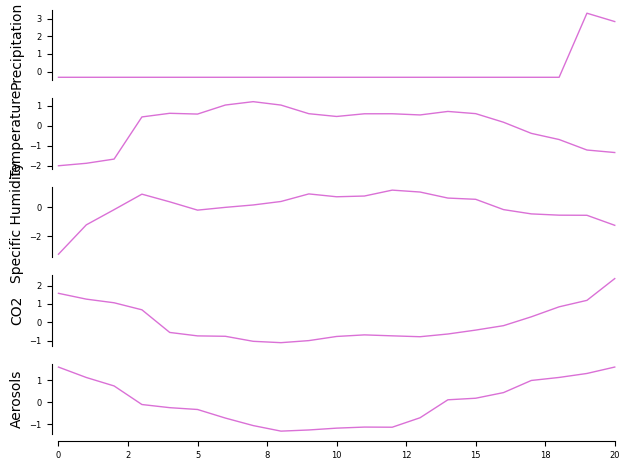

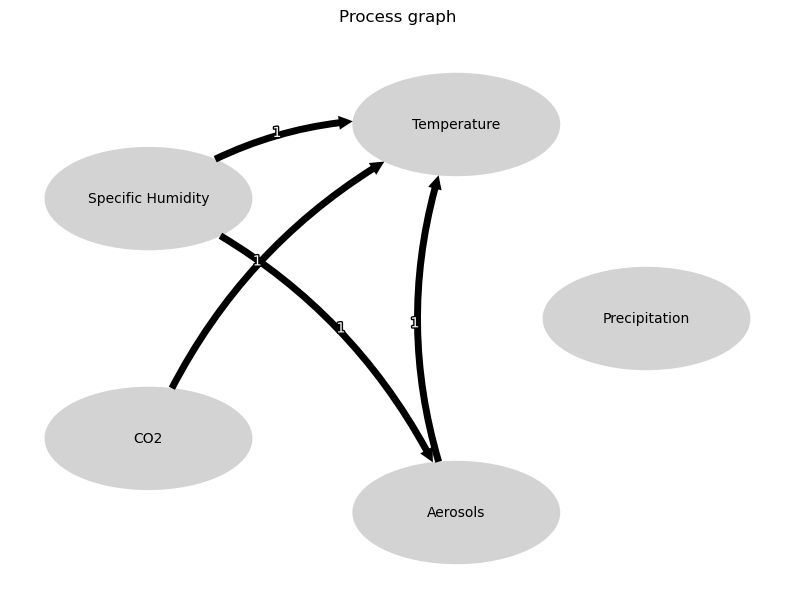


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





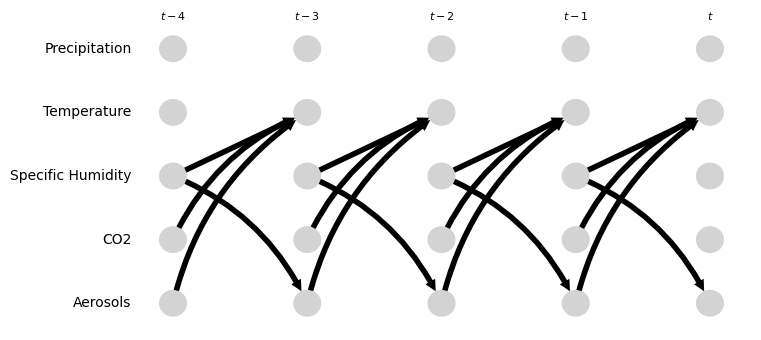

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.19 [-1.91, -0.84]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.01 [-0.26, 0.37]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.18 [-0.56, 0.13]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.05 [-1.39, -0.05]
Negative precipitation values in event 22: 0


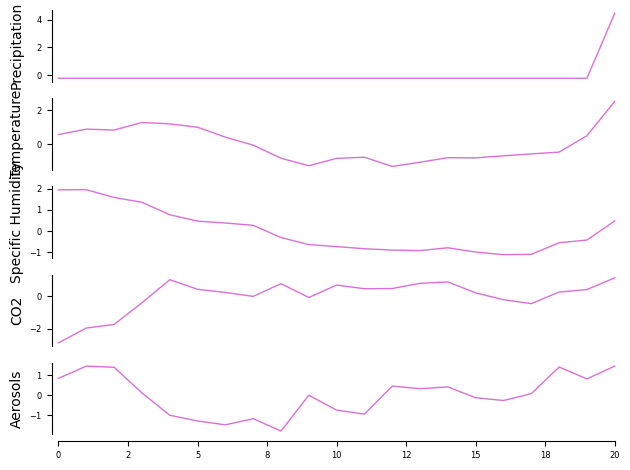

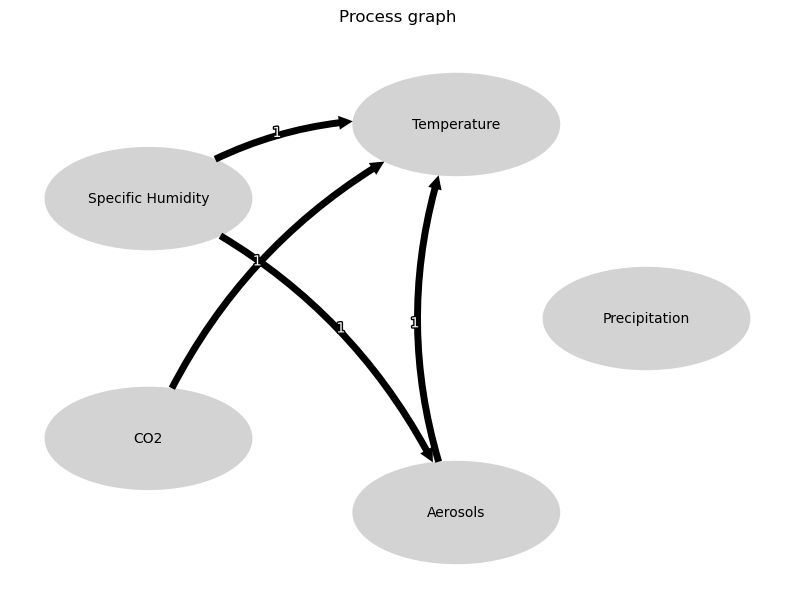


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





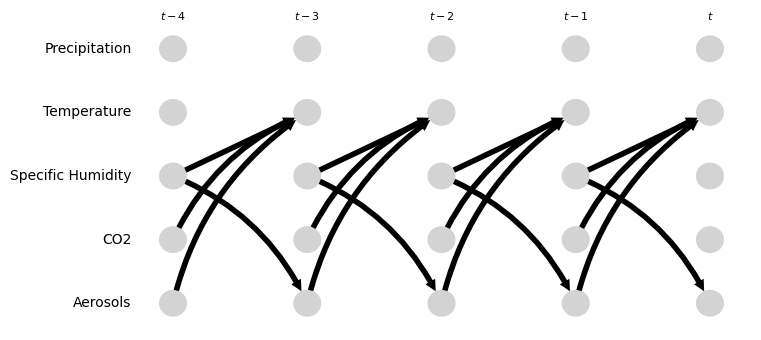

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.16 [-0.60, 0.30]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.83 [0.13, 0.61]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.41 [0.46, 1.44]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.12 [-1.52, -0.82]
Negative precipitation values in event 23: 0


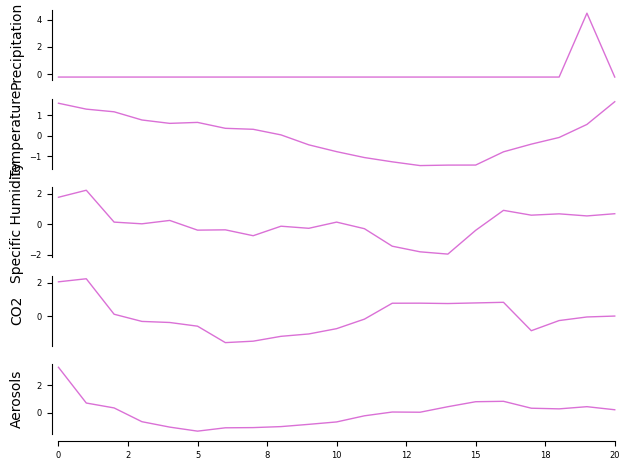

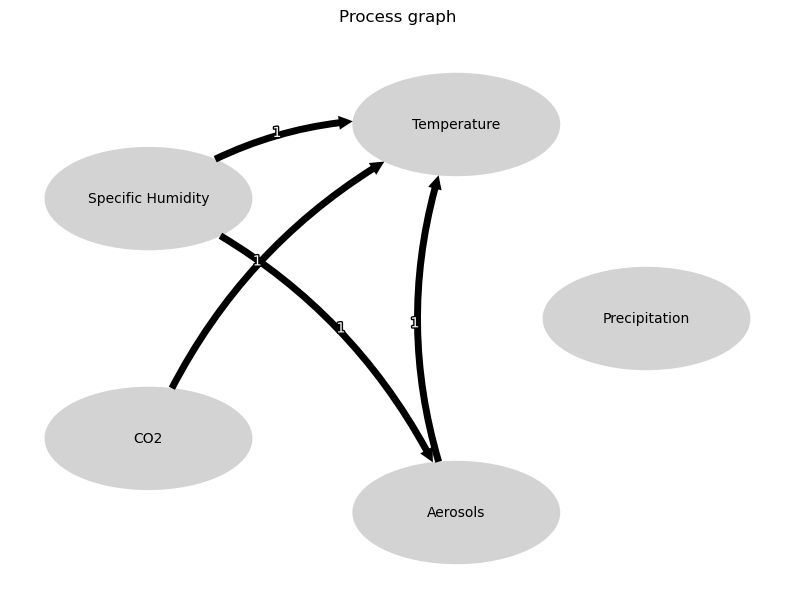


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





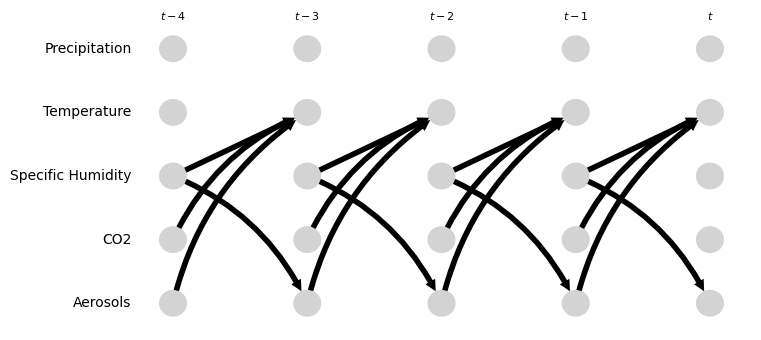

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.12 [-1.30, 0.35]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.16 [-0.78, 0.91]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.65 [-0.08, 0.88]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.11 [-0.46, 0.37]
Negative precipitation values in event 24: 0


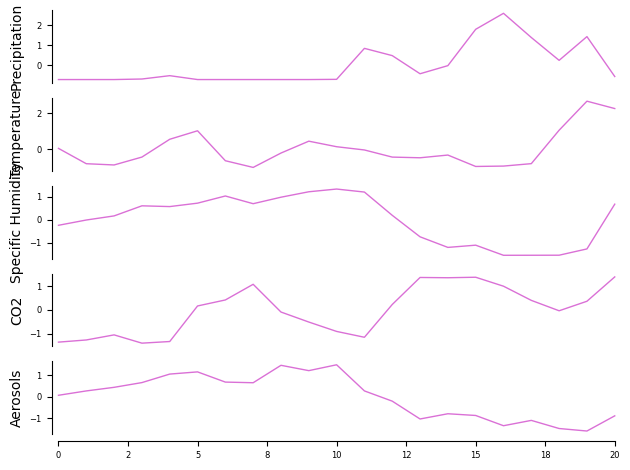

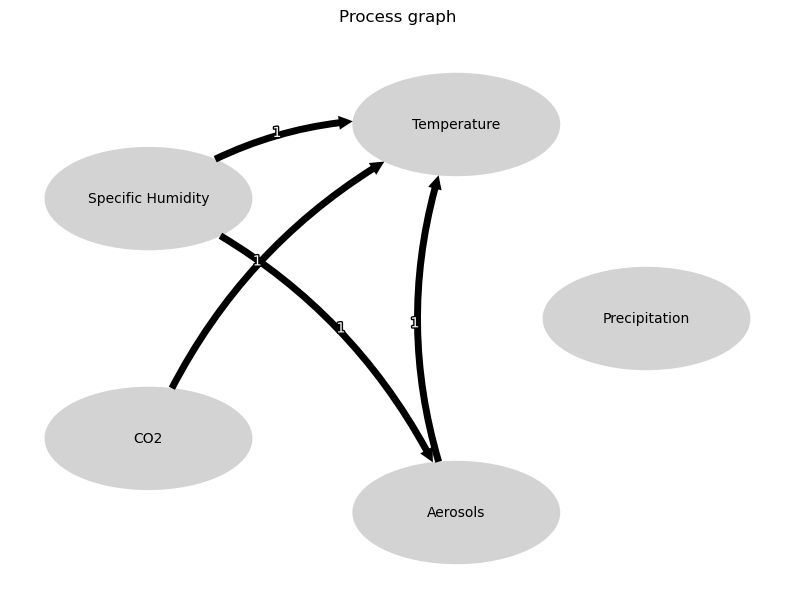


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





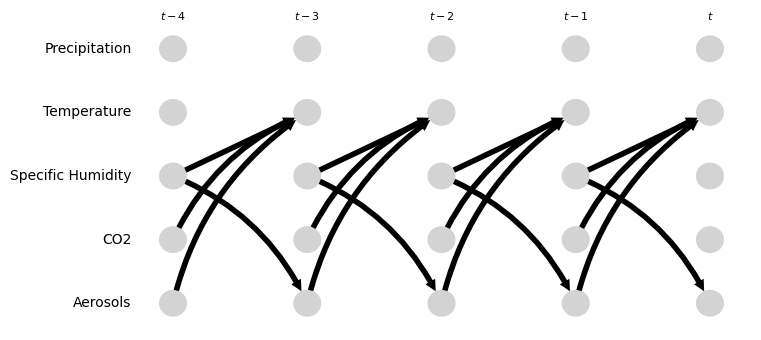

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.03 [-1.55, -0.36]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.02 [-0.81, 1.13]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.79 [-1.69, 0.09]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.81 [0.68, 0.99]
Negative precipitation values in event 25: 0


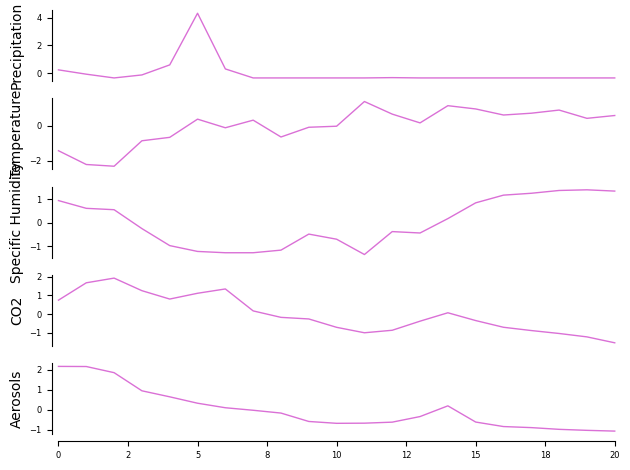

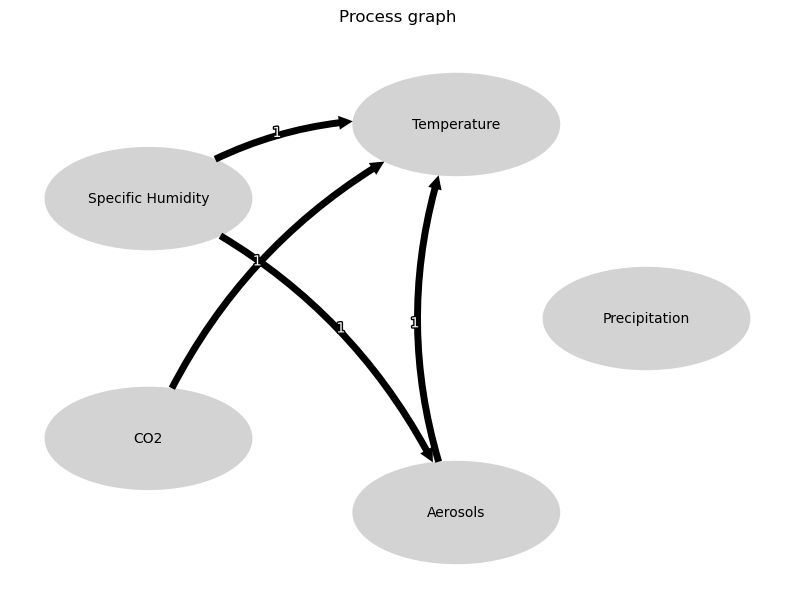


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





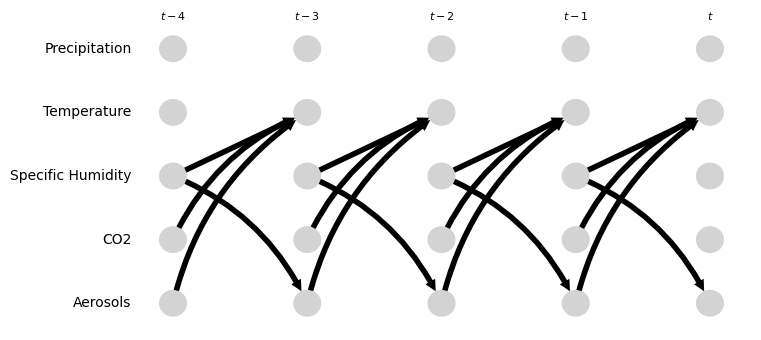

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.30 [-1.00, 0.28]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.27 [-0.92, 1.30]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.15 [-0.07, 0.50]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.31 [-0.39, -0.22]
Negative precipitation values in event 26: 0


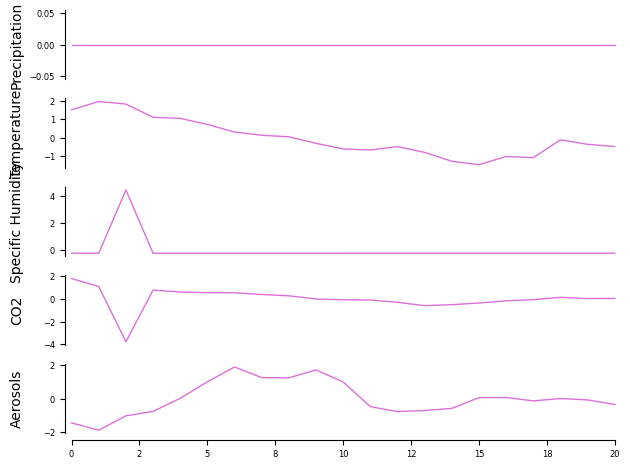

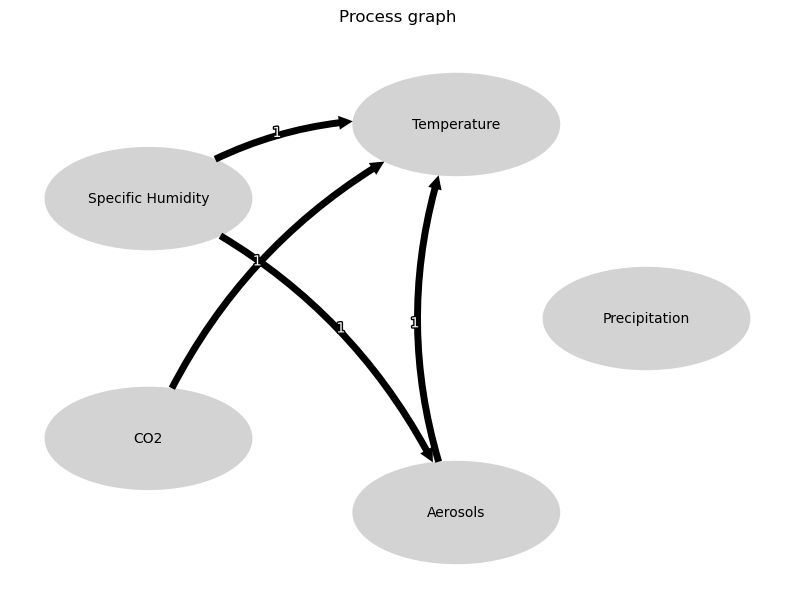


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





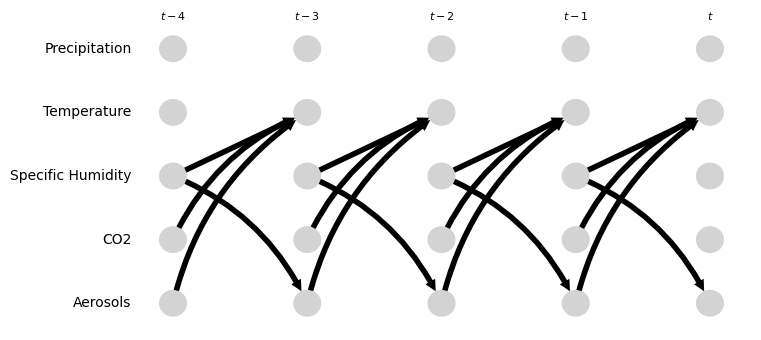

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.60 [1.01, 2.55]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.17 [-0.26, -0.10]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 74705.99 [-223472.00, 219728.43]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 629599.77 [475696.50, 910206.52]
Negative precipitation values in event 27: 0


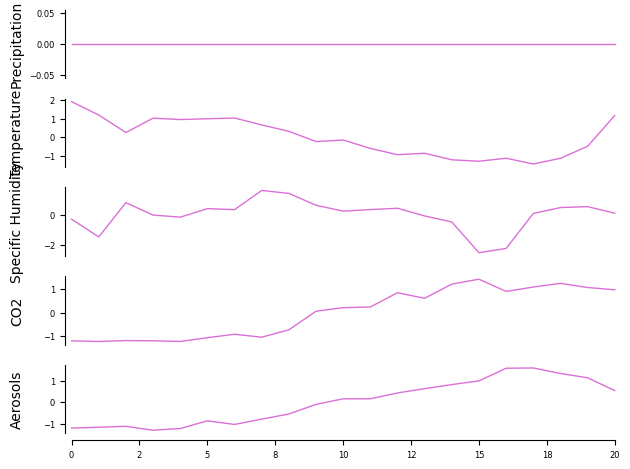

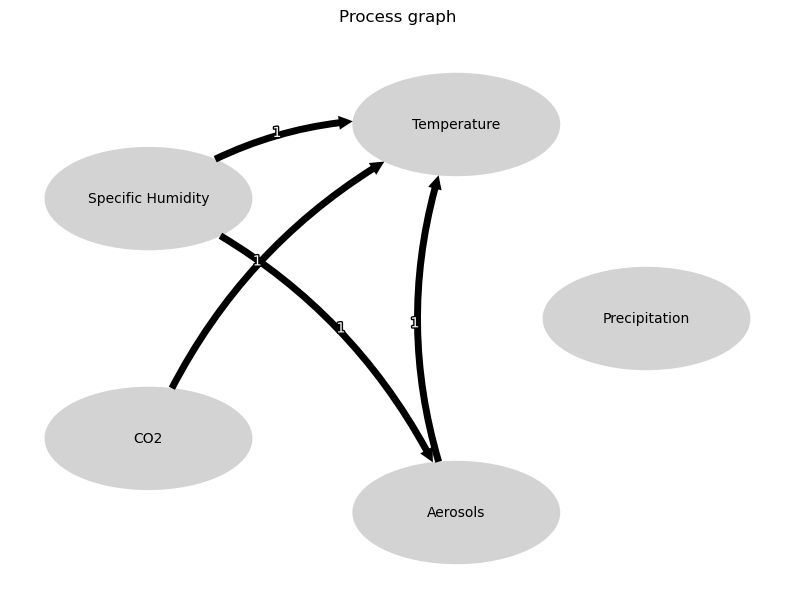


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





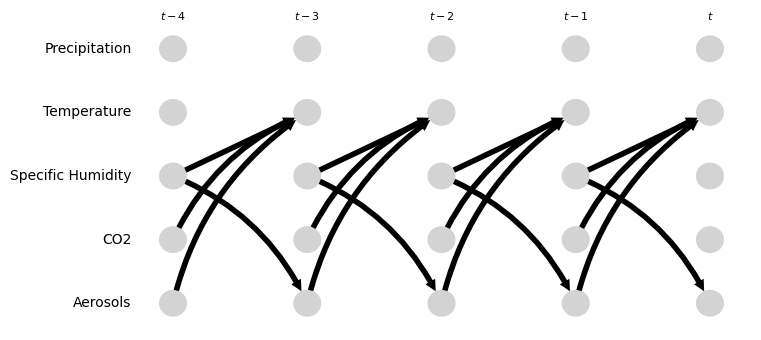

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.41 [-1.19, -0.26]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.14 [-0.72, 0.28]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.15 [-0.34, 0.23]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.48 [-0.65, -0.40]
Negative precipitation values in event 28: 0


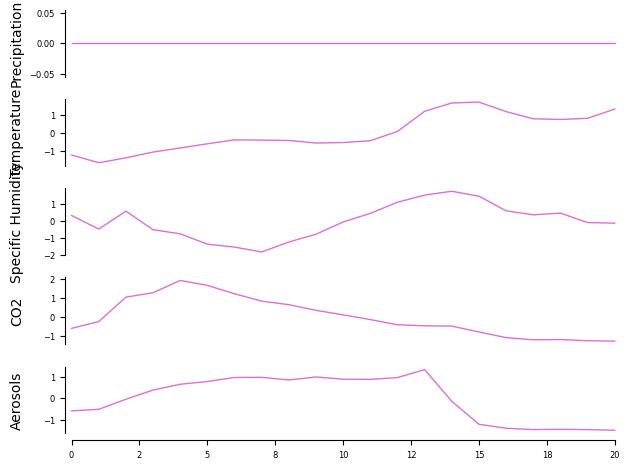

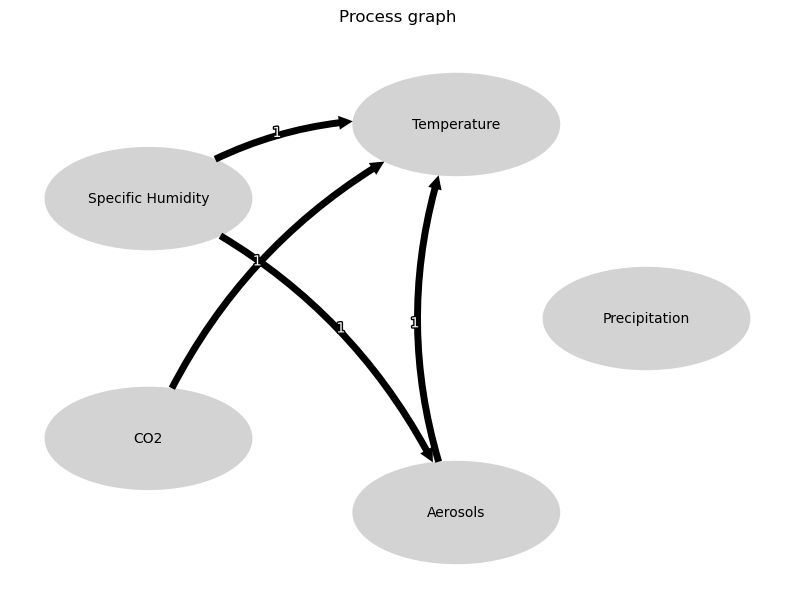


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





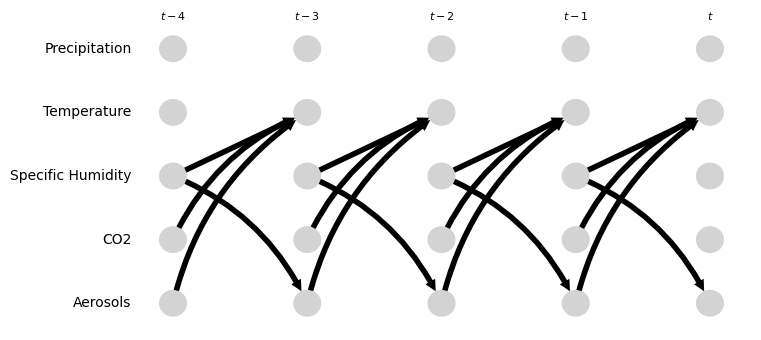

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.20 [-0.21, 0.38]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.06 [-0.33, 0.11]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.49 [0.36, 0.85]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.56 [-0.83, -0.37]
Negative precipitation values in event 29: 0


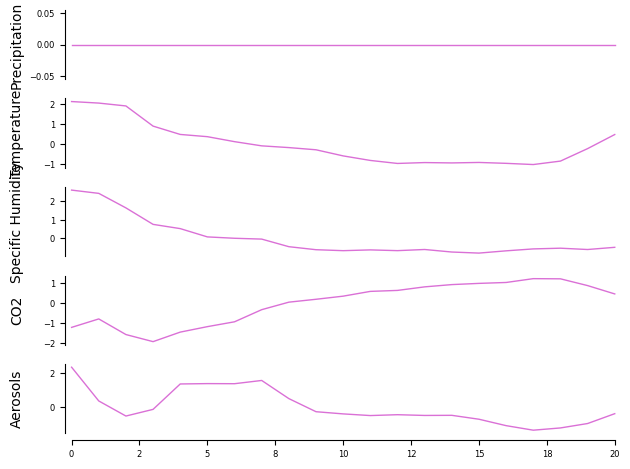

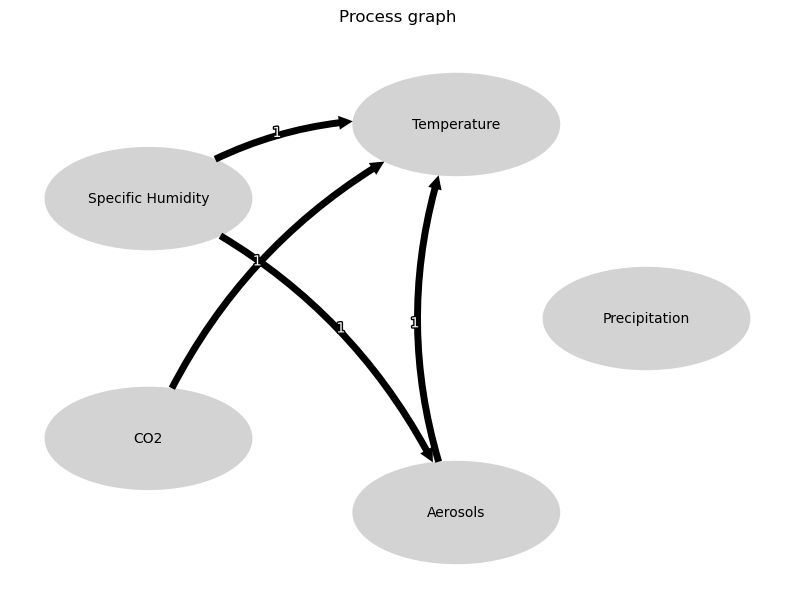


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





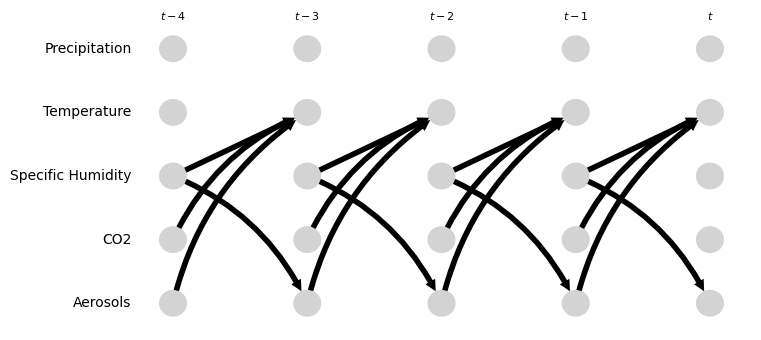

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.06 [-0.32, 0.39]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.14 [-0.25, 0.35]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.21 [0.21, 1.90]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 2.23 [1.88, 2.98]
Negative precipitation values in event 30: 0


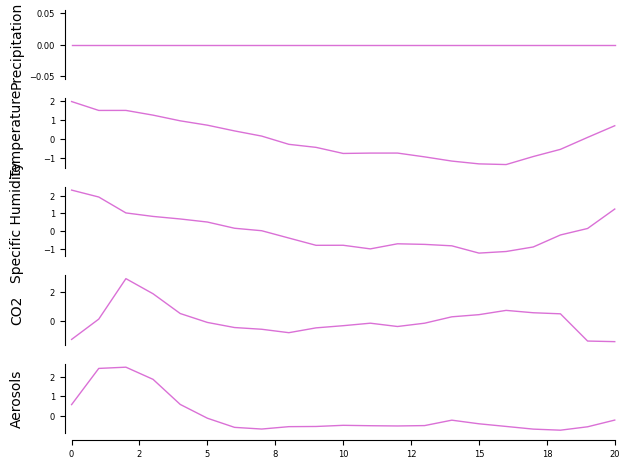

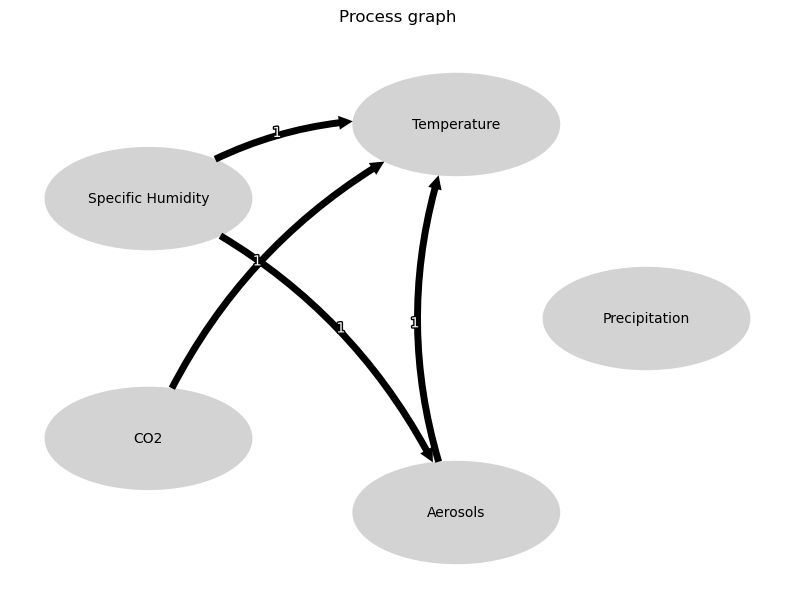


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





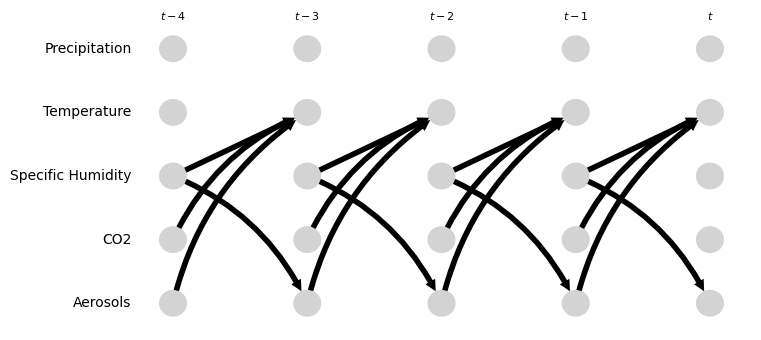

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.07 [0.02, 0.44]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.33 [-1.56, 0.06]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.13 [0.72, 1.31]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.10 [-0.09, 0.18]
Negative precipitation values in event 31: 0


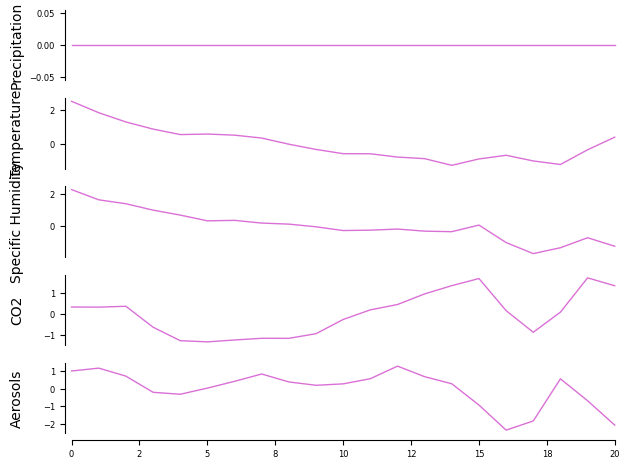

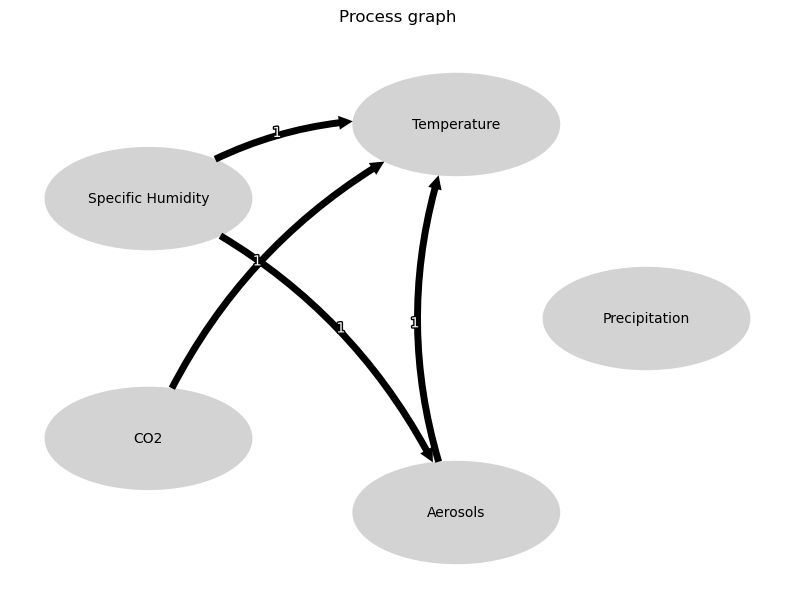


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





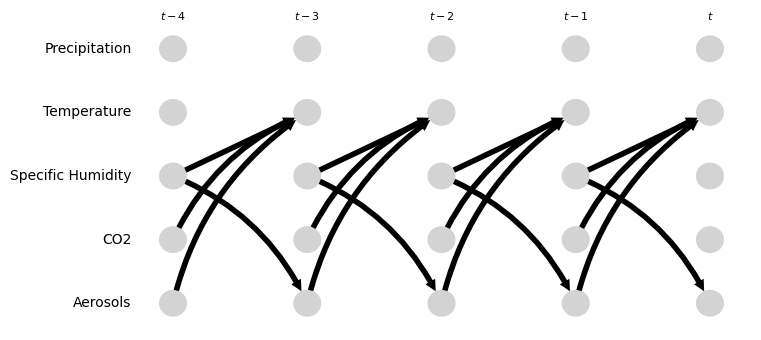

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.13 [-0.56, -0.20]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.08 [-0.32, 0.21]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.49 [-0.04, 0.98]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.42 [-0.20, 1.03]
Negative precipitation values in event 32: 0


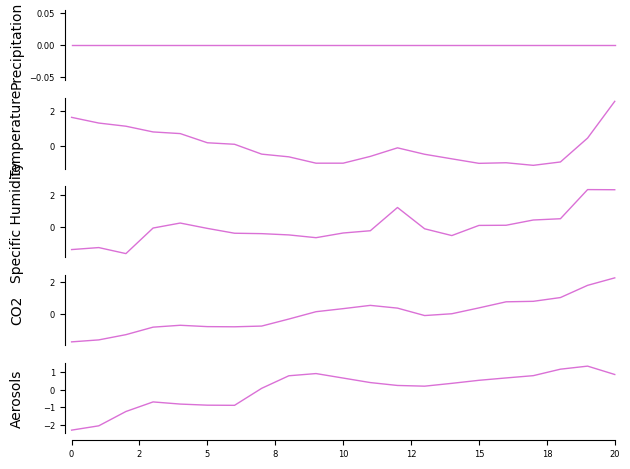

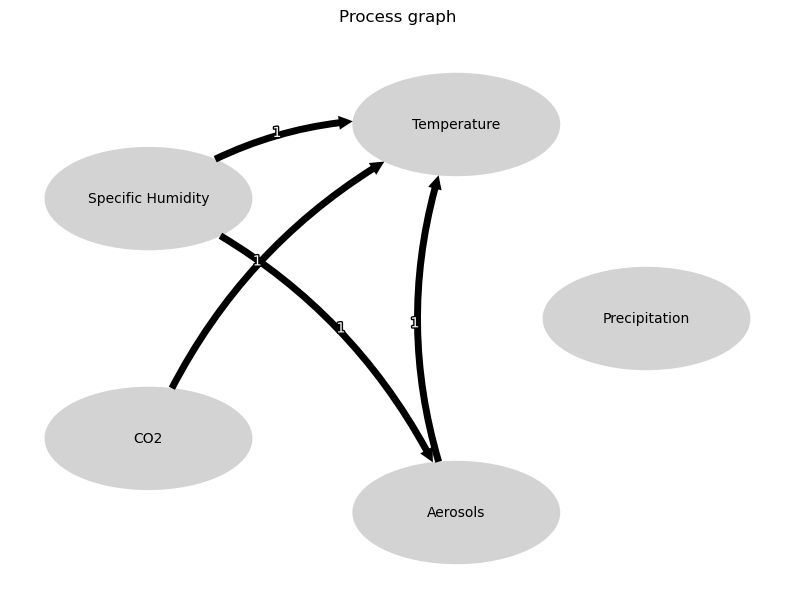


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





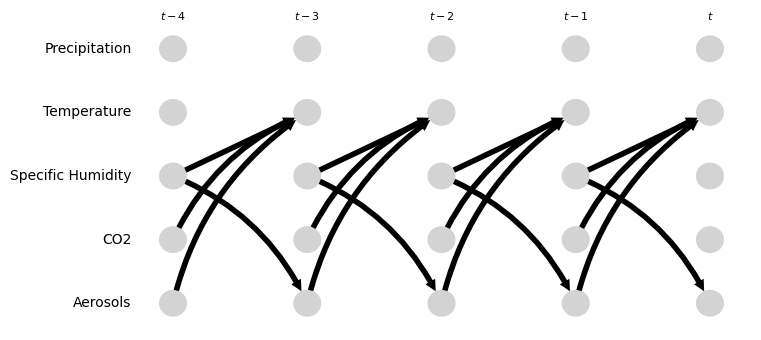

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.02 [-0.42, 0.64]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.18 [-0.99, 0.12]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.94 [-0.12, 1.08]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.11 [-0.35, 0.43]
Negative precipitation values in event 33: 0


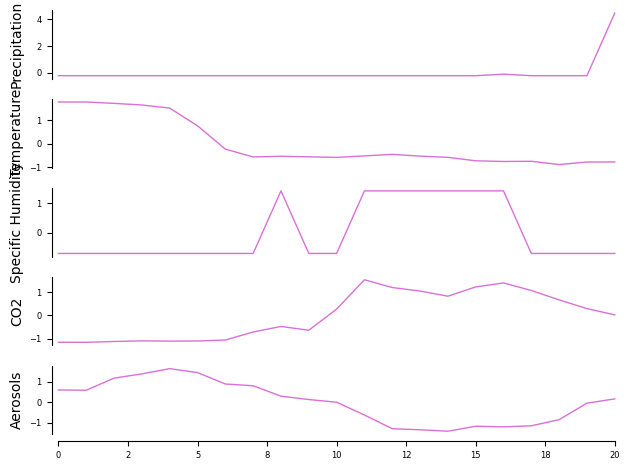

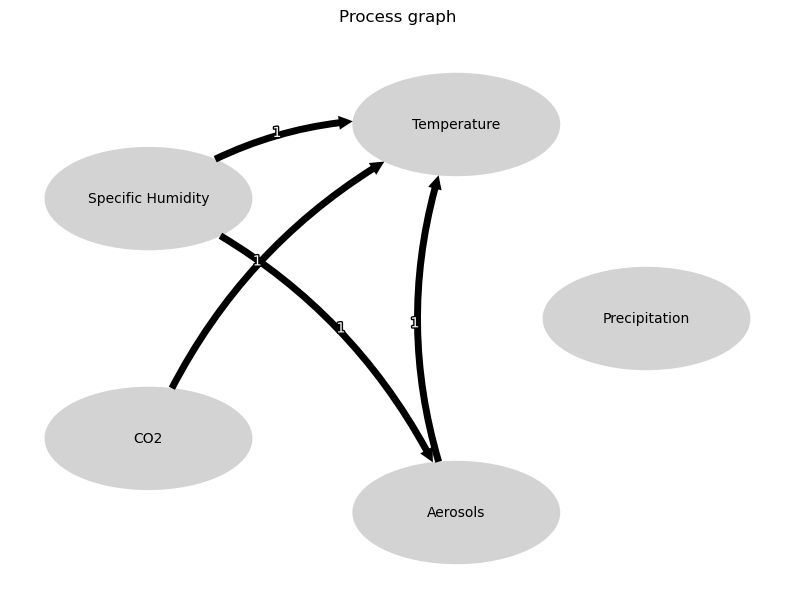


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





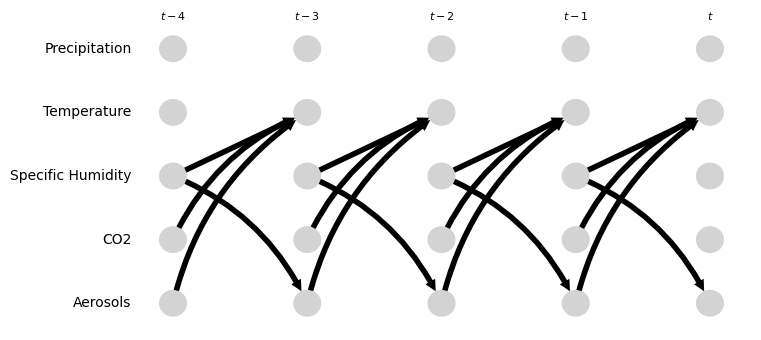

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.21 [0.01, 0.79]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.50 [0.17, 1.06]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.10 [-0.00, 0.20]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.61 [-0.79, -0.38]
Negative precipitation values in event 34: 0


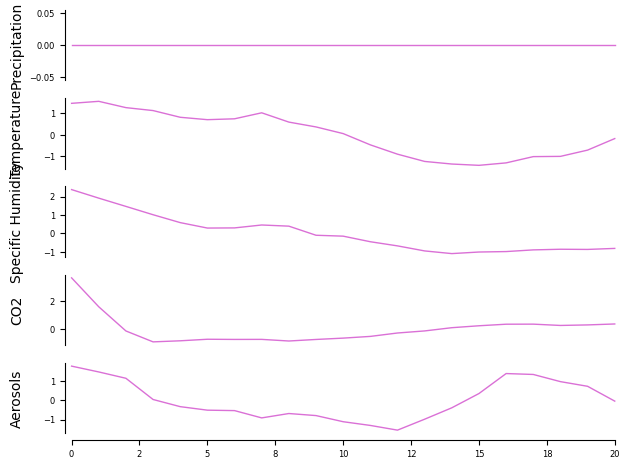

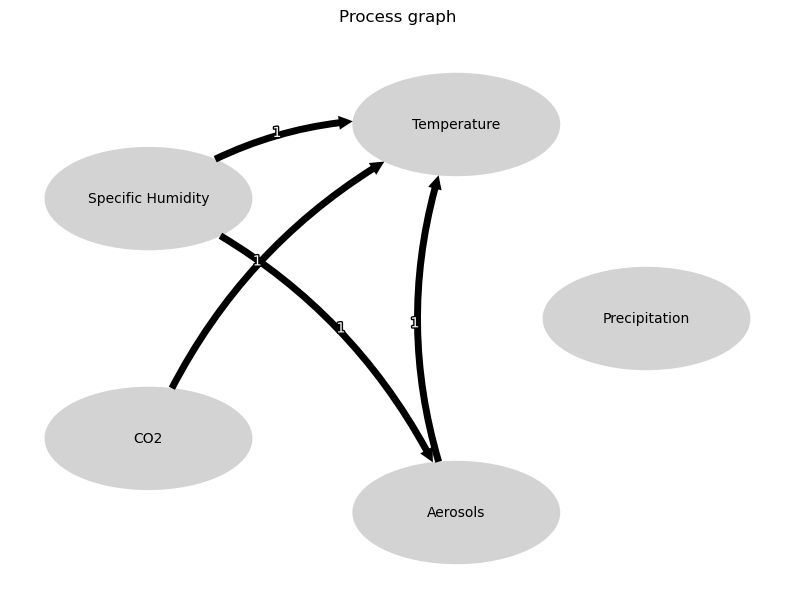


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





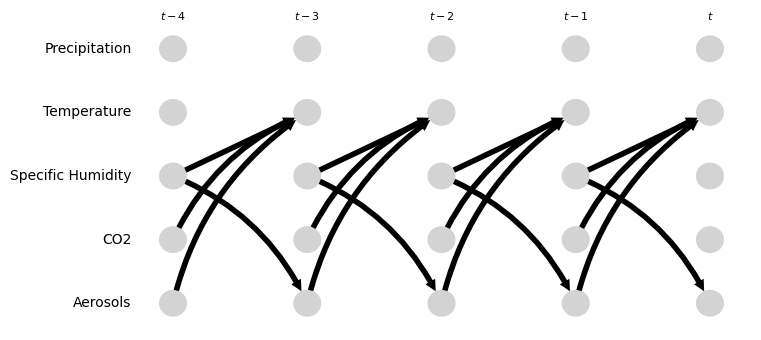

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.33 [-1.13, 0.37]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.20 [0.12, 0.46]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.62 [0.82, 1.76]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.95 [-1.40, -0.65]
Negative precipitation values in event 35: 0


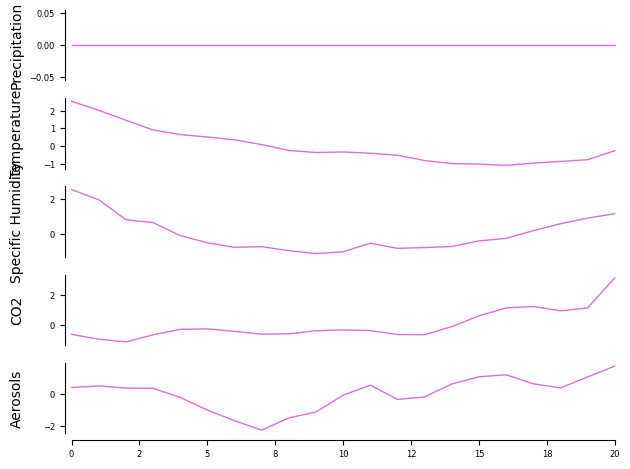

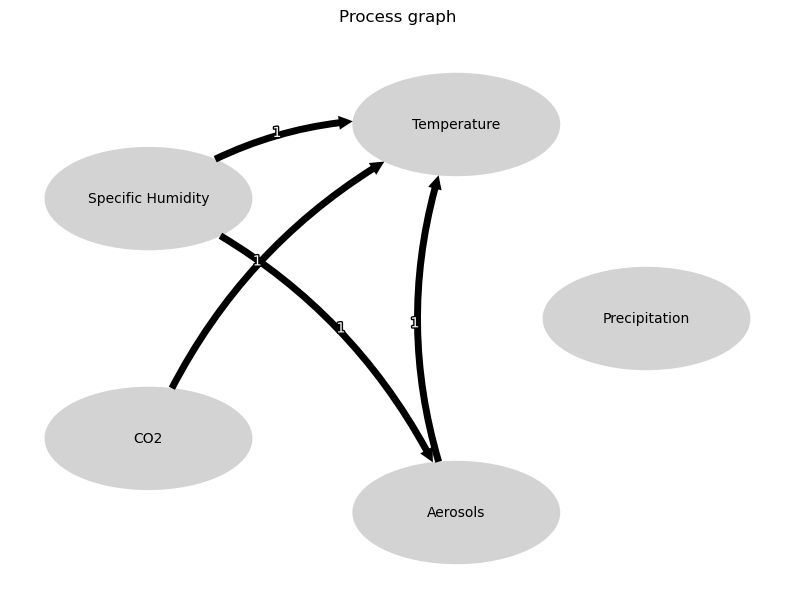


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





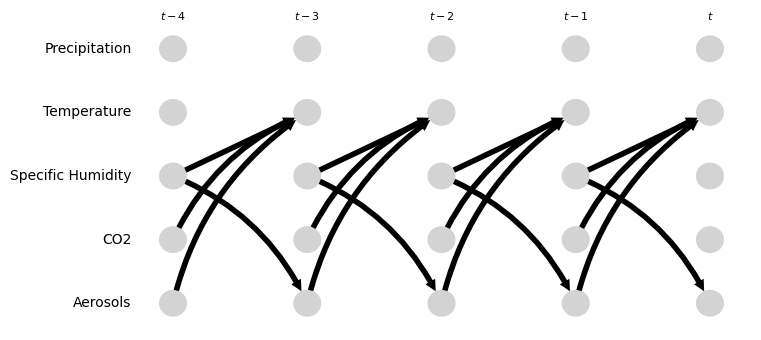

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.35 [-0.73, 0.35]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.28 [-0.50, -0.14]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.63 [-0.24, 1.24]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.92 [0.05, 1.24]
Negative precipitation values in event 36: 0


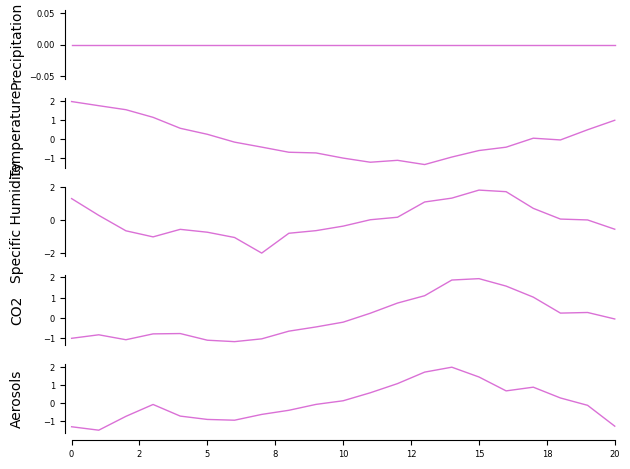

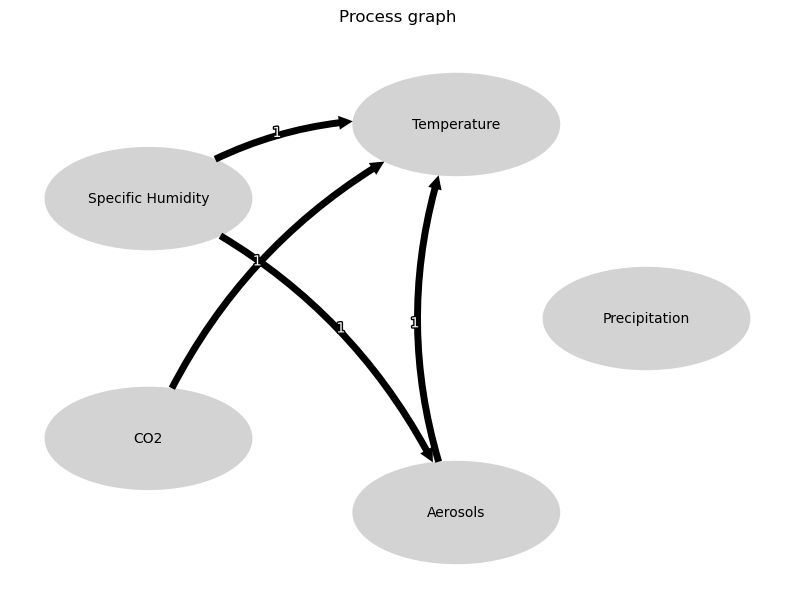


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





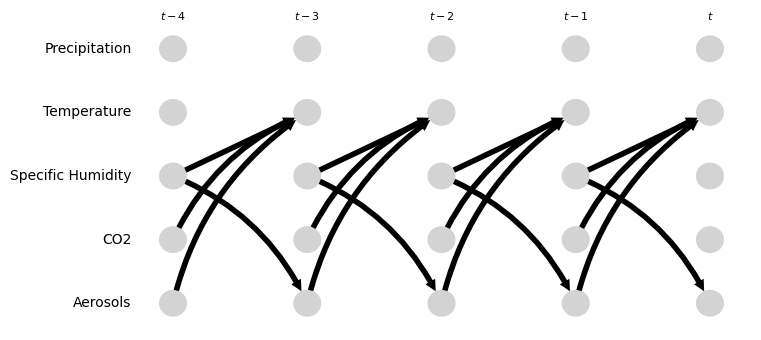

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.06 [-0.05, 2.91]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.37 [-2.58, -0.72]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.08 [-1.00, 0.90]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.56 [0.41, 0.84]
Negative precipitation values in event 37: 0


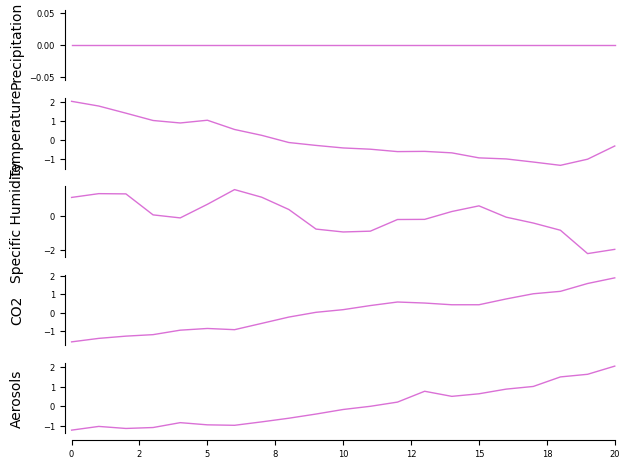

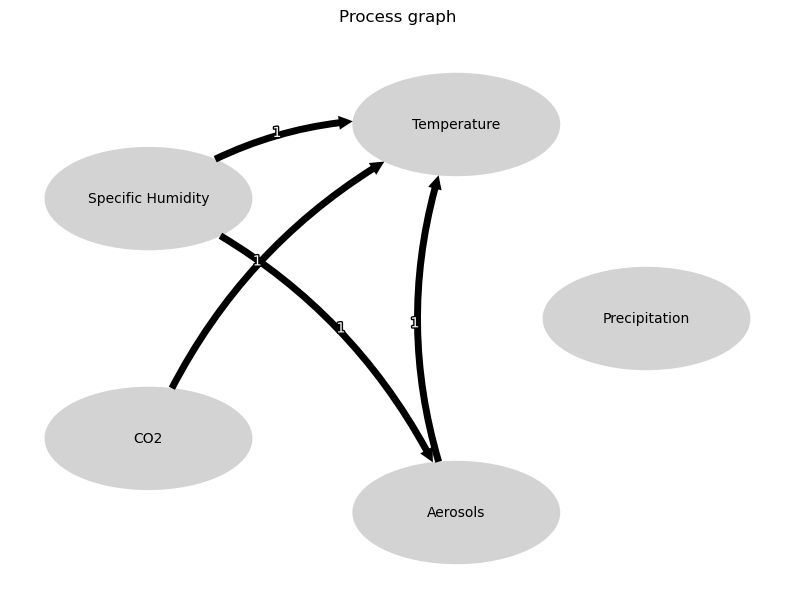


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





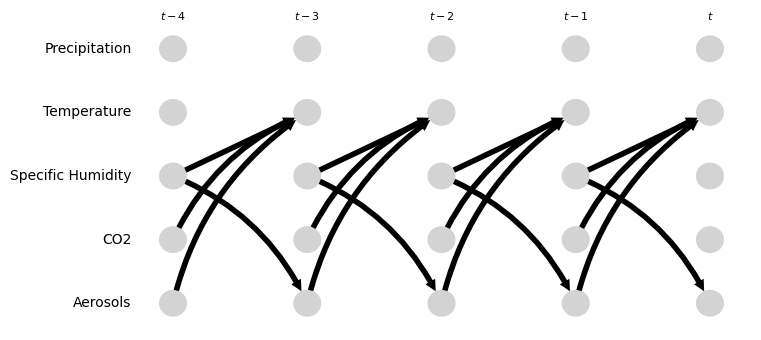

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.76 [-2.05, -0.64]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.62 [-0.17, 0.82]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.51 [-0.46, -0.12]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.66 [-0.89, -0.11]
Negative precipitation values in event 38: 0


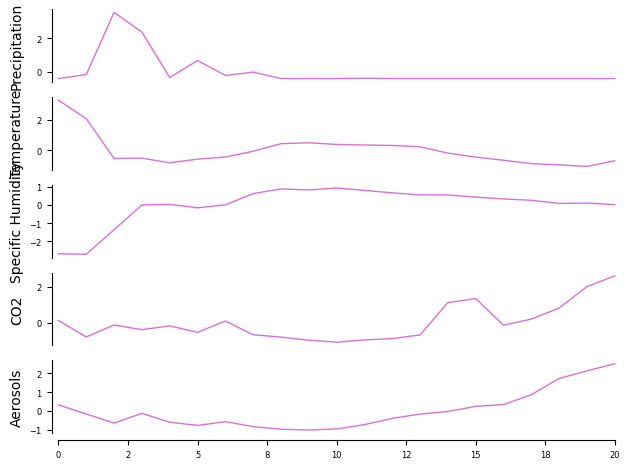

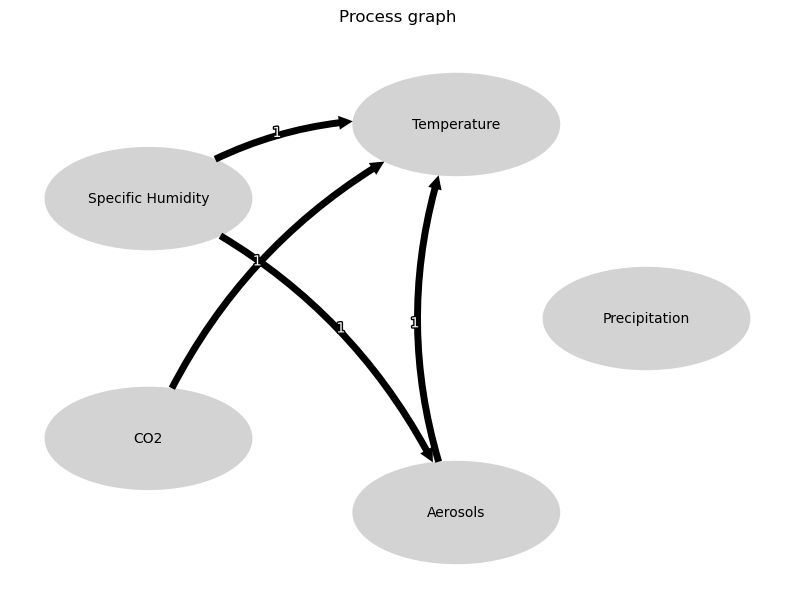


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





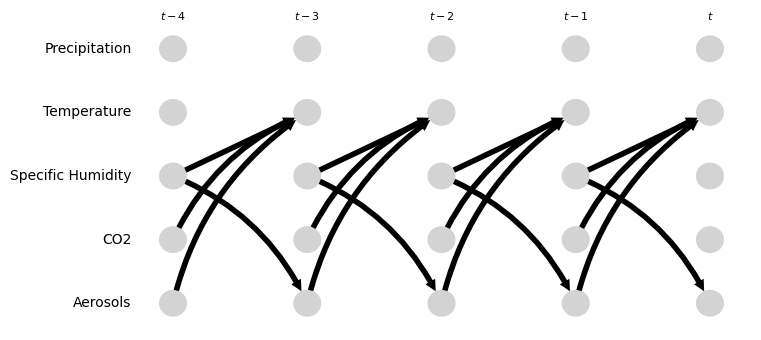

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.04 [-0.22, 0.34]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.28 [-0.66, -0.25]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.71 [0.13, 0.96]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.38 [-2.49, 0.08]
Negative precipitation values in event 39: 0


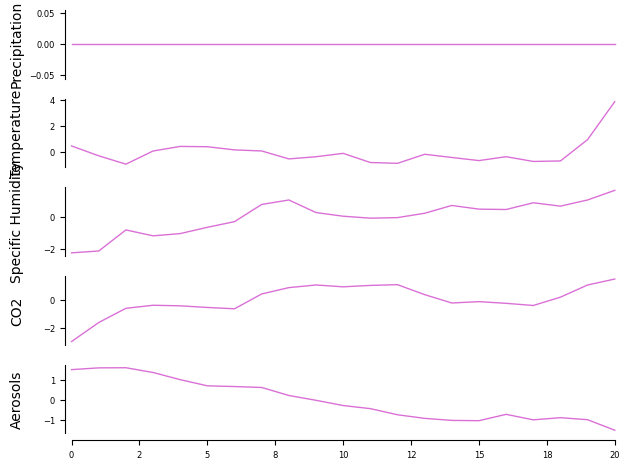

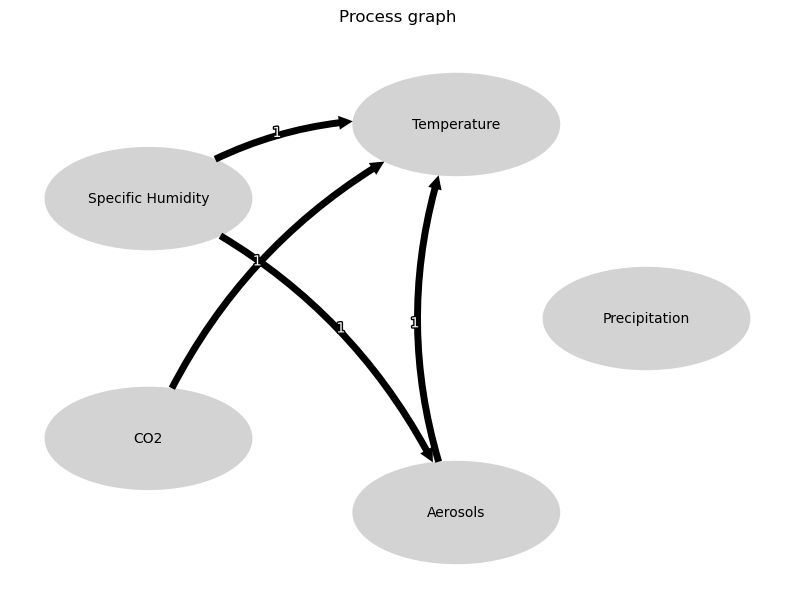


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





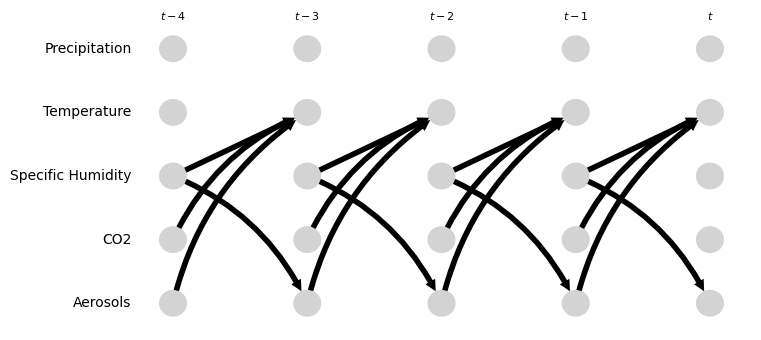

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.26 [-0.35, 0.08]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.03 [-0.21, 0.42]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.26 [-0.44, 0.39]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.72 [-1.02, 0.01]
Negative precipitation values in event 40: 0


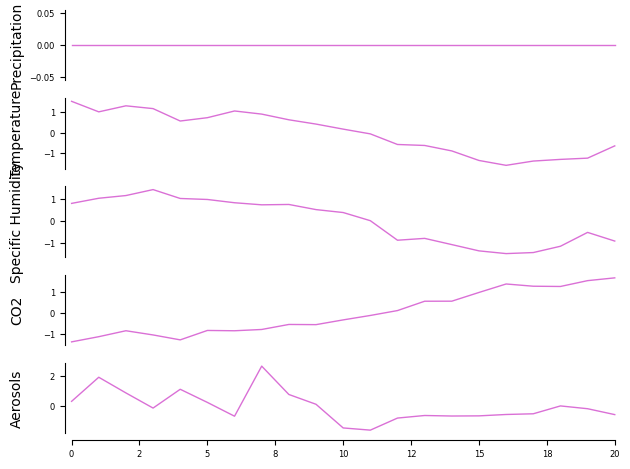

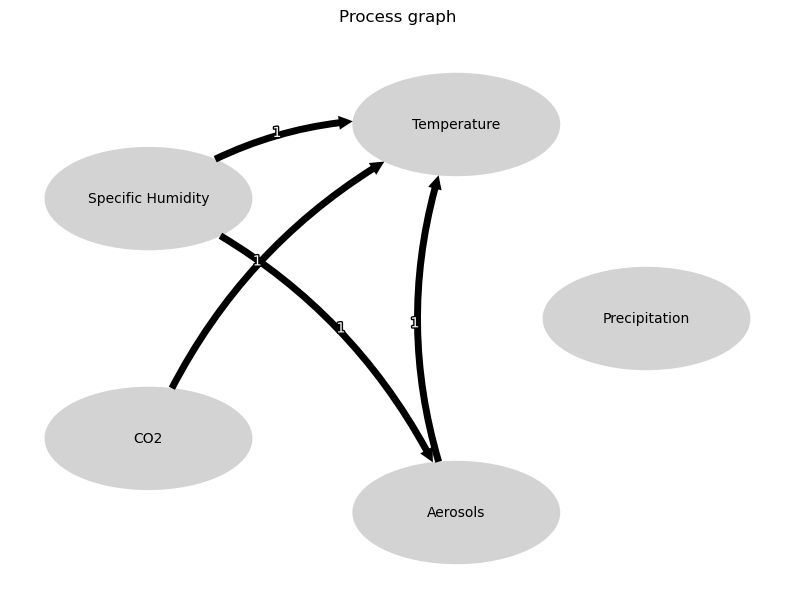


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





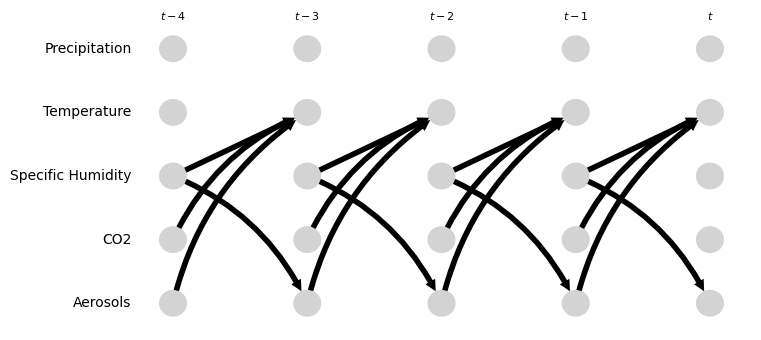

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.05 [-0.48, 0.47]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.07 [-0.06, 0.17]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.83 [0.38, 1.32]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.28 [-0.11, 0.70]
Negative precipitation values in event 41: 0


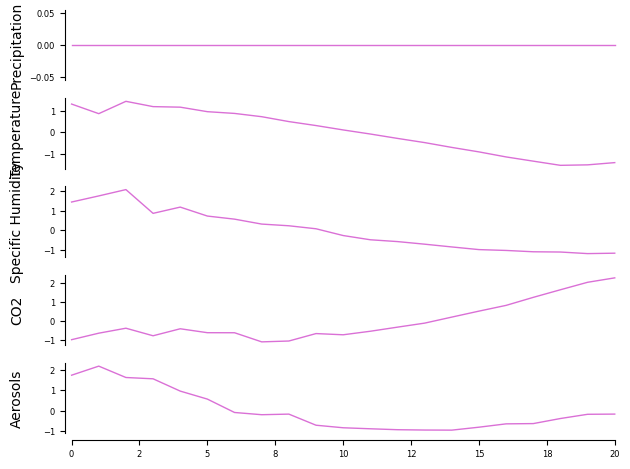

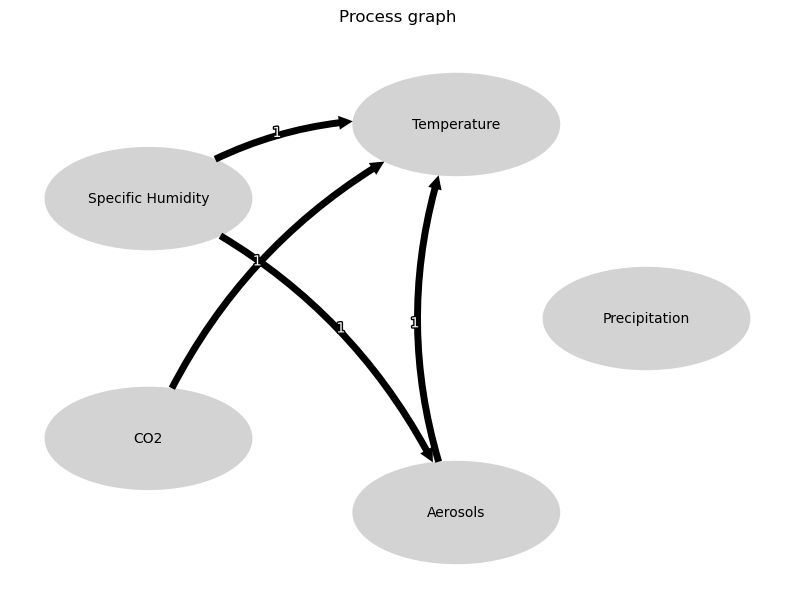


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





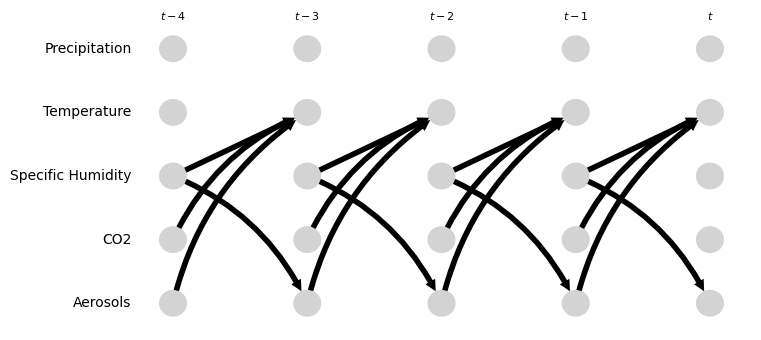

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.24 [-0.49, -0.08]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.00 [-0.48, 0.19]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.93 [0.65, 1.36]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.28 [0.03, 0.52]
Negative precipitation values in event 42: 0


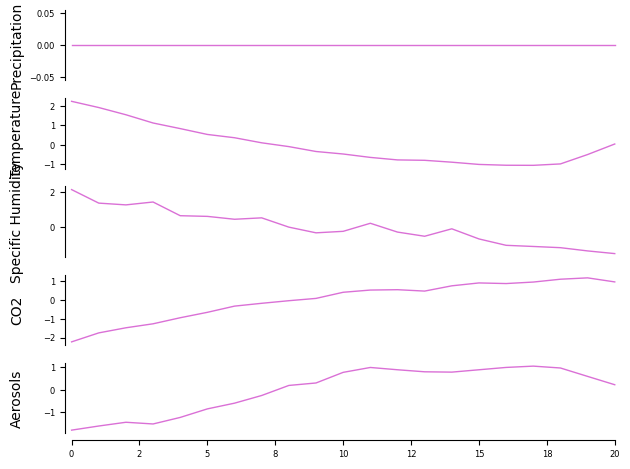

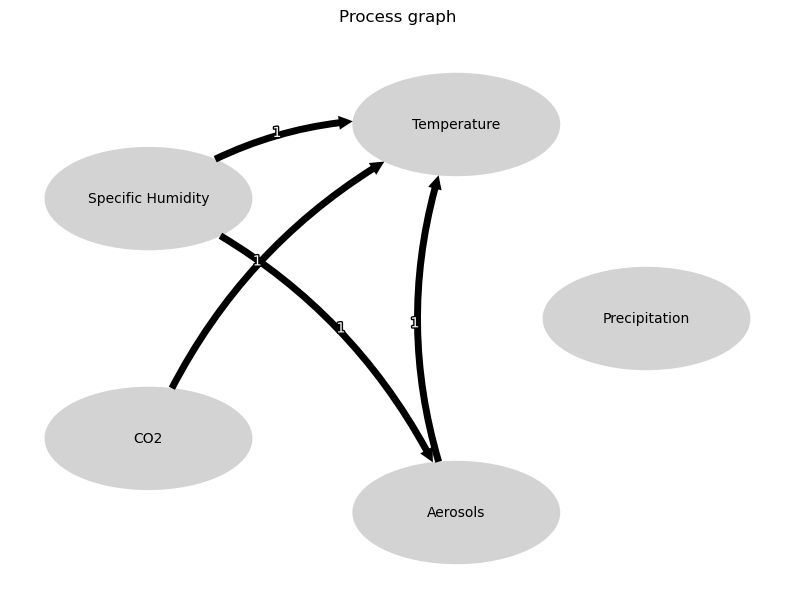


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





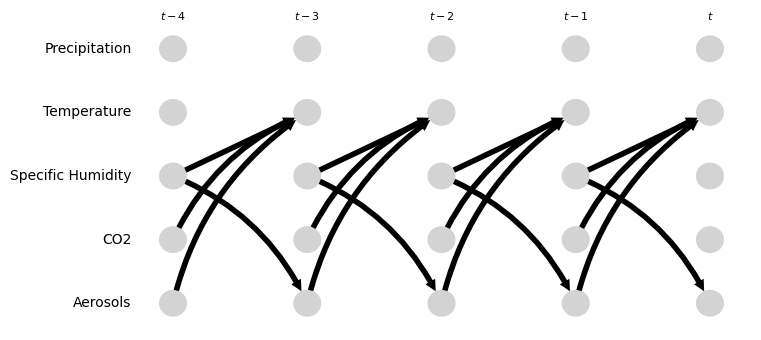

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.37 [-0.69, 0.55]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.00 [-1.04, -0.19]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.09 [-0.34, 0.17]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.54 [-1.01, -0.38]
Negative precipitation values in event 43: 0


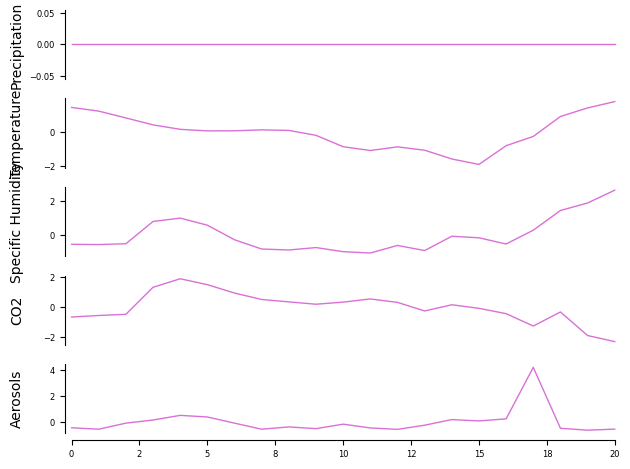

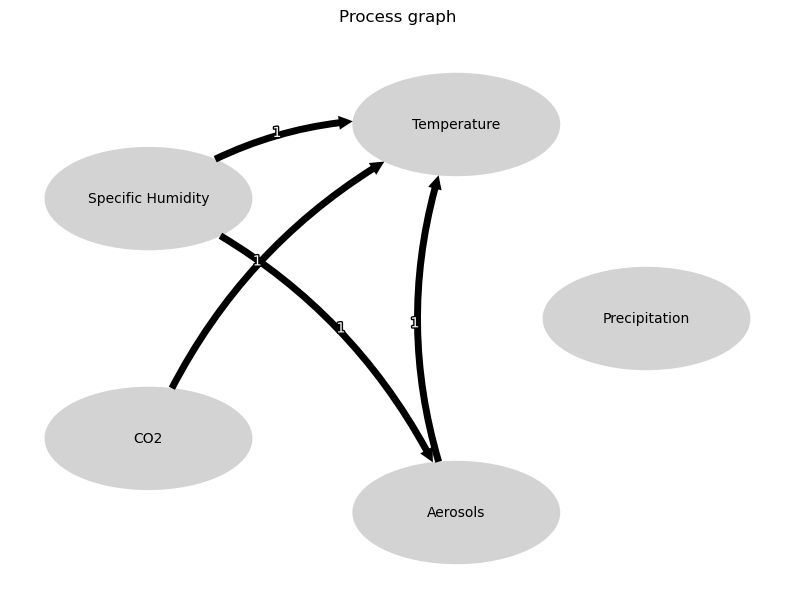


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





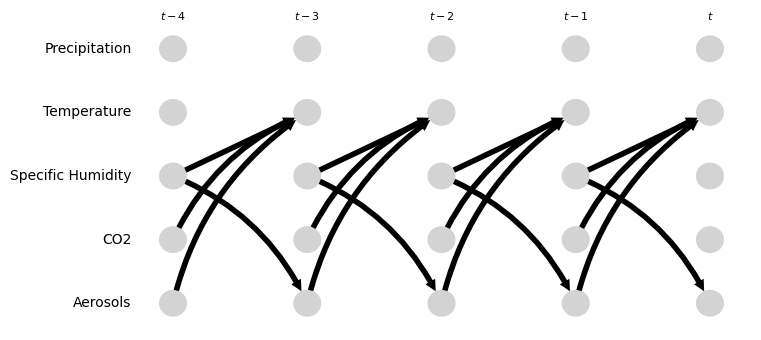

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.19 [-0.26, 1.46]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.07 [-1.60, 1.12]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.78 [-1.43, 0.97]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.15 [-0.35, 0.31]
Negative precipitation values in event 44: 0


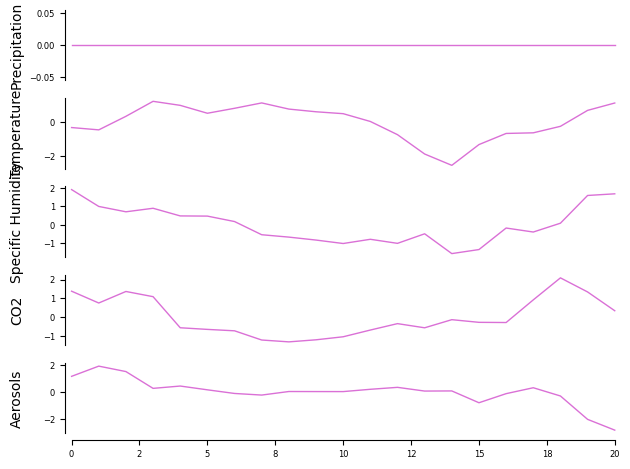

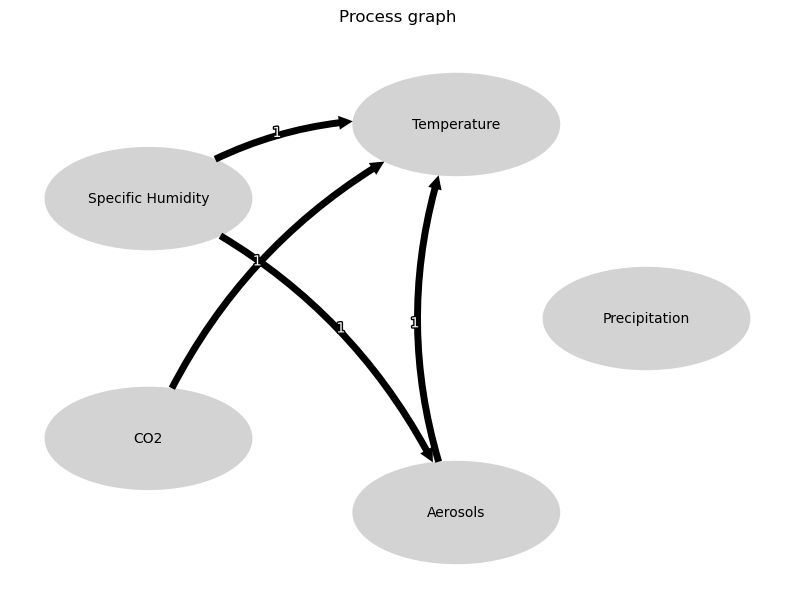


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





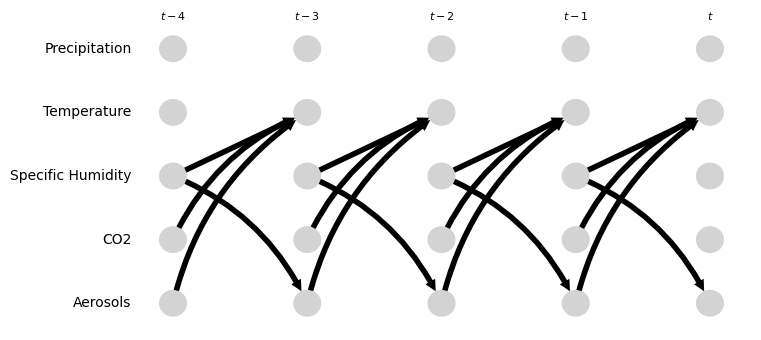

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.27 [-1.47, -0.07]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.26 [-2.39, -0.08]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.84 [0.75, 1.54]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.60 [-0.66, 0.31]
Negative precipitation values in event 45: 0


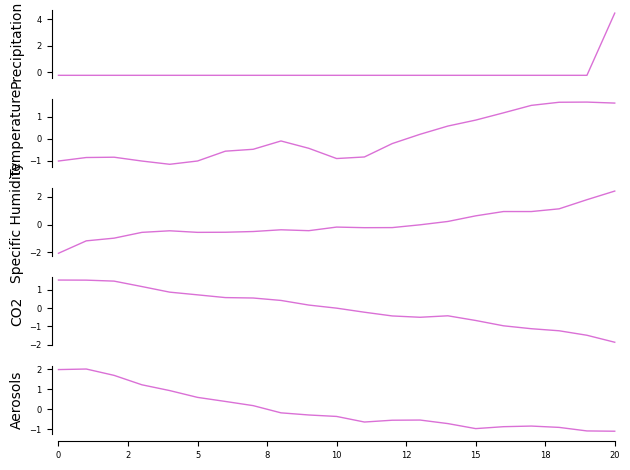

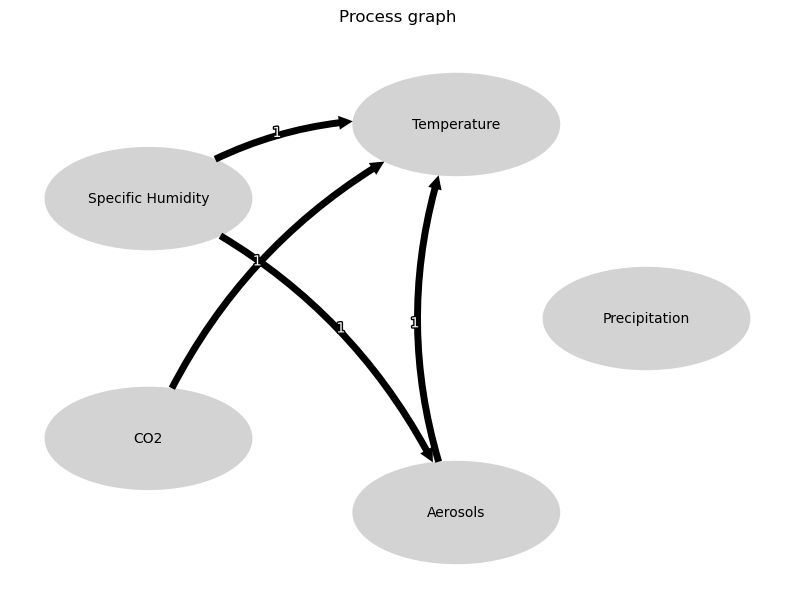


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





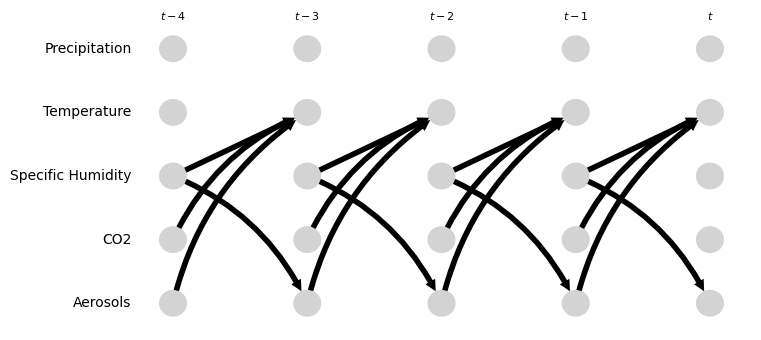

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.89 [-1.52, 0.48]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.19 [-0.50, 1.13]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.52 [0.53, 1.94]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.55 [-0.88, -0.49]
Negative precipitation values in event 46: 0


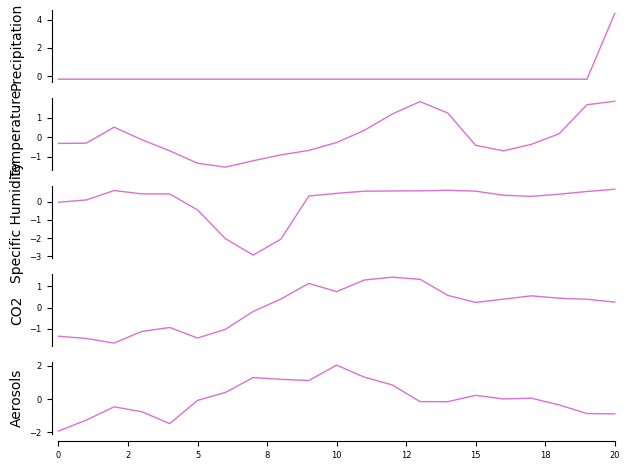

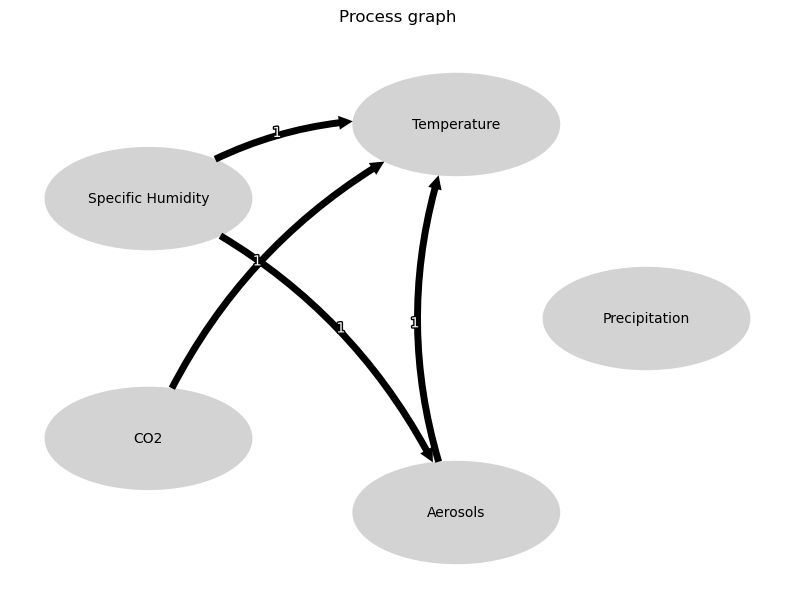


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





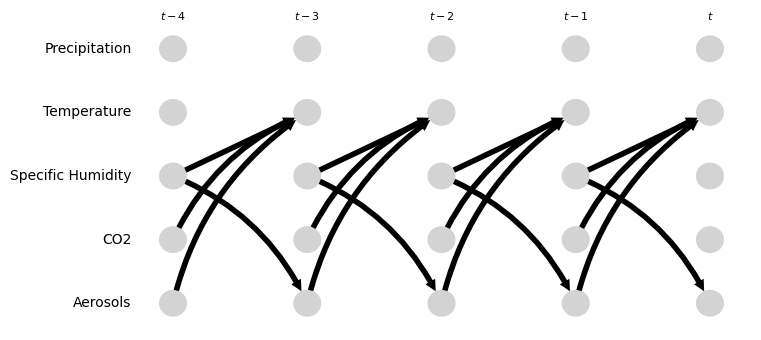

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.15 [0.64, 1.65]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.38 [-0.83, 0.18]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.01 [-0.36, 0.26]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.36 [-0.46, -0.19]
Negative precipitation values in event 47: 0


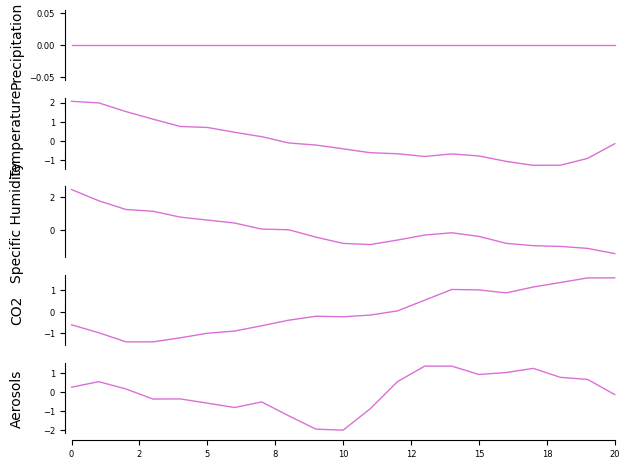

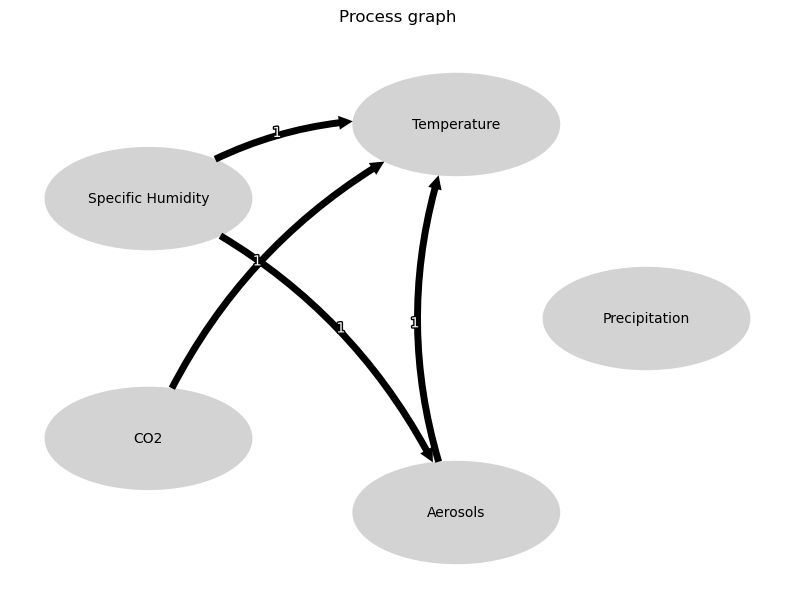


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





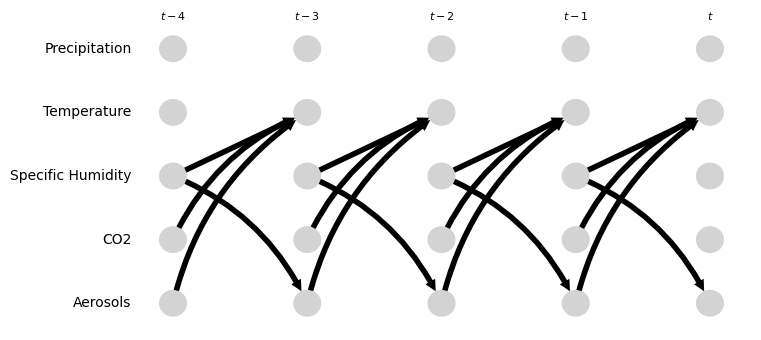

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.03 [-0.44, 0.04]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.17 [-0.14, 0.02]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.72 [0.46, 0.79]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.83 [-1.55, -0.53]
Negative precipitation values in event 48: 0


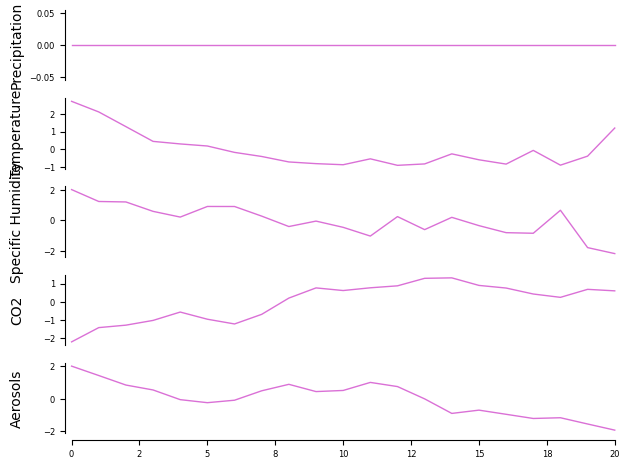

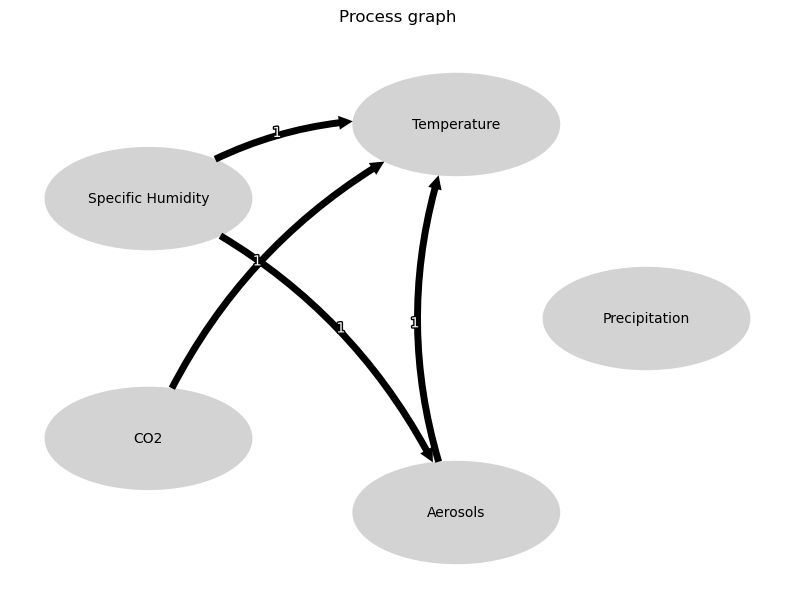


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





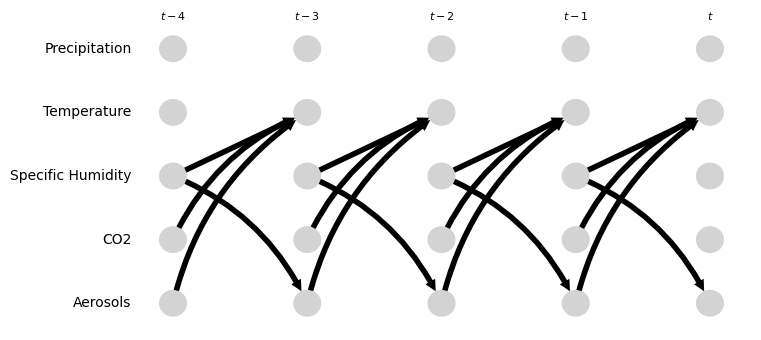

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.32 [-0.46, 0.09]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.33 [-0.40, -0.02]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.36 [-0.35, 0.24]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.41 [-0.40, 0.64]
Negative precipitation values in event 49: 0


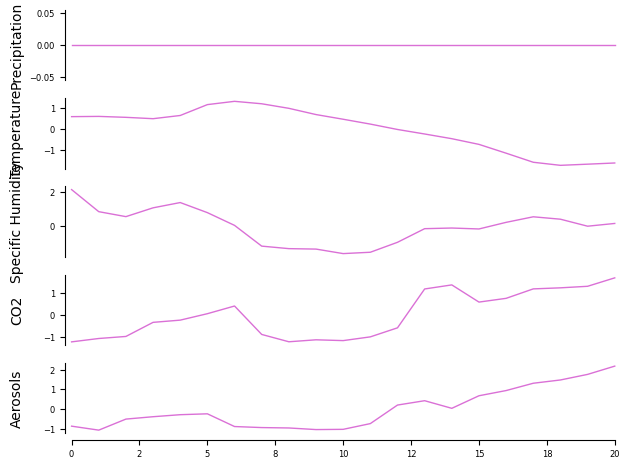

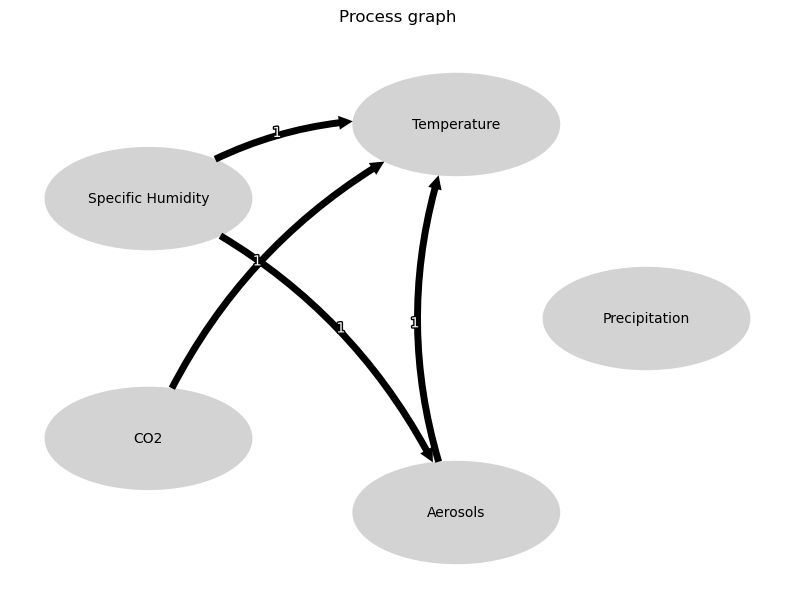


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





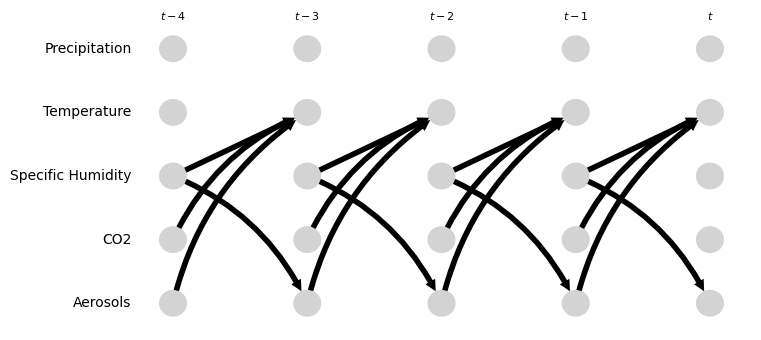

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.28 [-0.64, -0.01]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.11 [-1.52, -1.06]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.64 [0.50, 1.07]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.47 [0.07, 0.92]
Negative precipitation values in event 50: 0


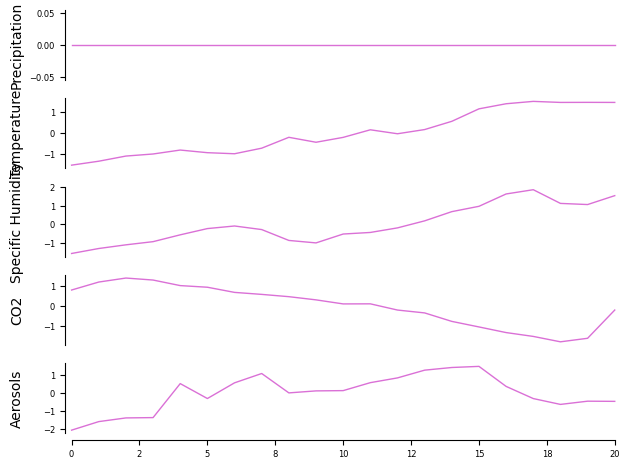

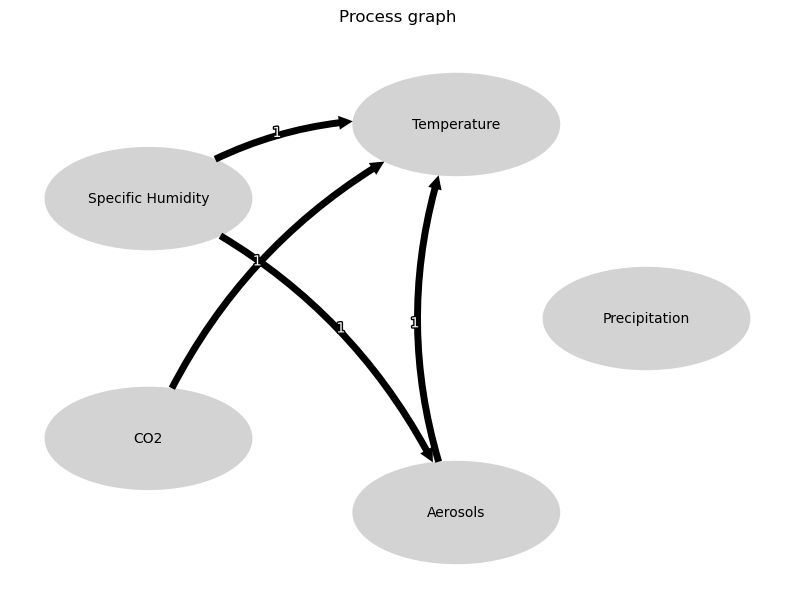


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





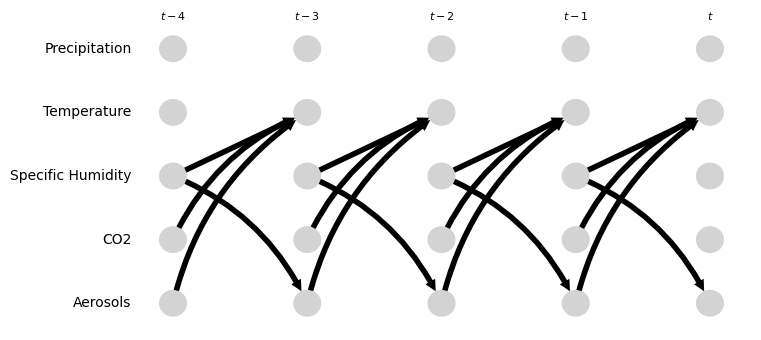

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.94 [-1.10, -0.80]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.23 [0.13, 0.29]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.01 [-0.14, 0.18]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.29 [-0.47, 0.06]
Negative precipitation values in event 51: 0


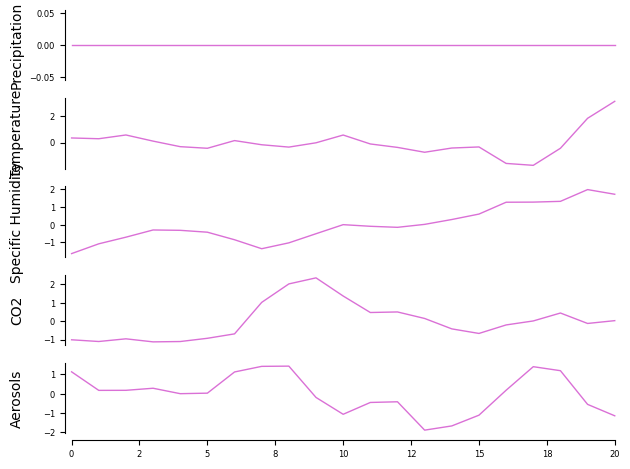

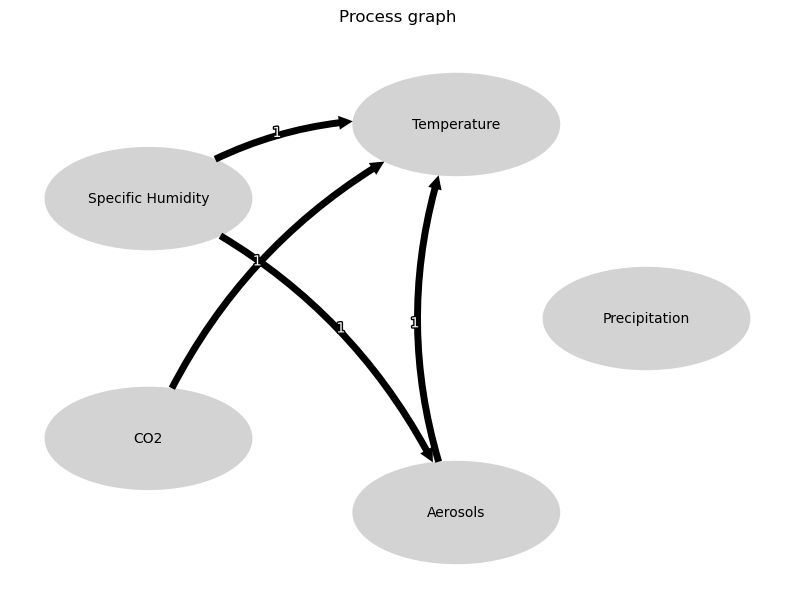


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





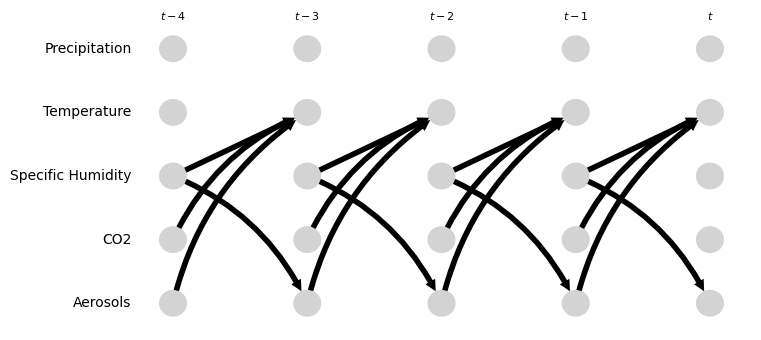

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.31 [-0.06, 0.49]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.16 [-0.25, 0.57]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.55 [-0.68, 0.63]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.17 [-0.75, 0.64]
Negative precipitation values in event 52: 0


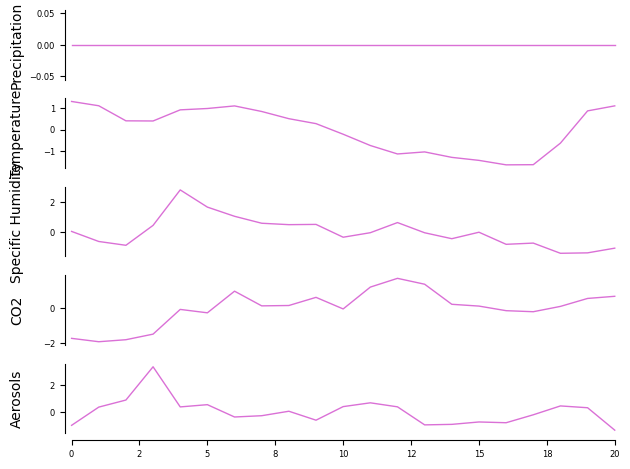

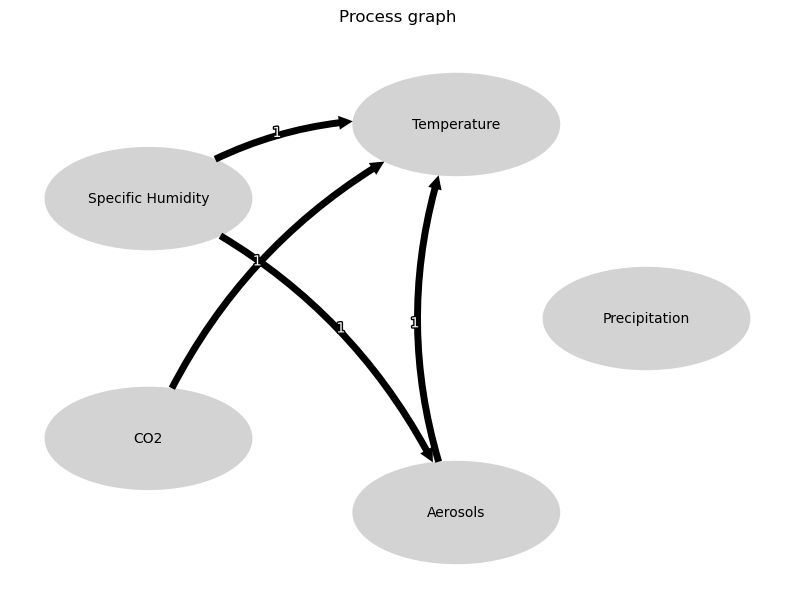


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





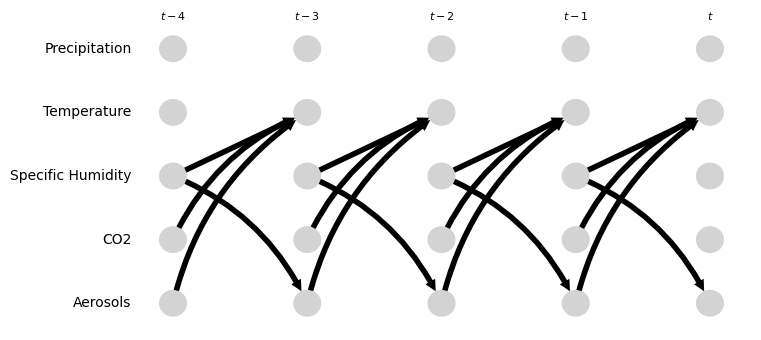

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.40 [-0.93, 0.51]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.84 [-0.01, 1.38]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.24 [0.16, 1.18]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.11 [-0.34, 0.20]
Negative precipitation values in event 53: 0


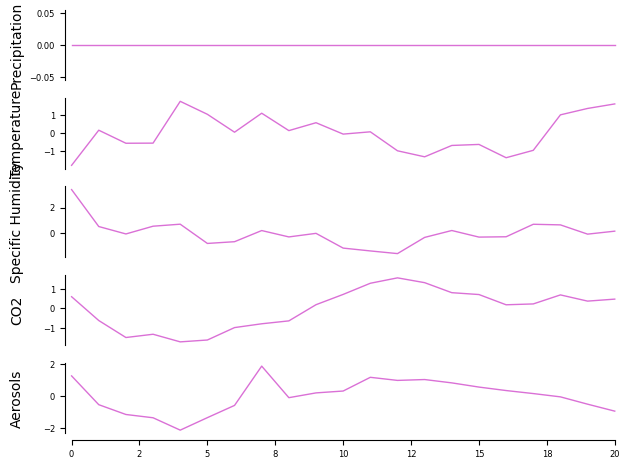

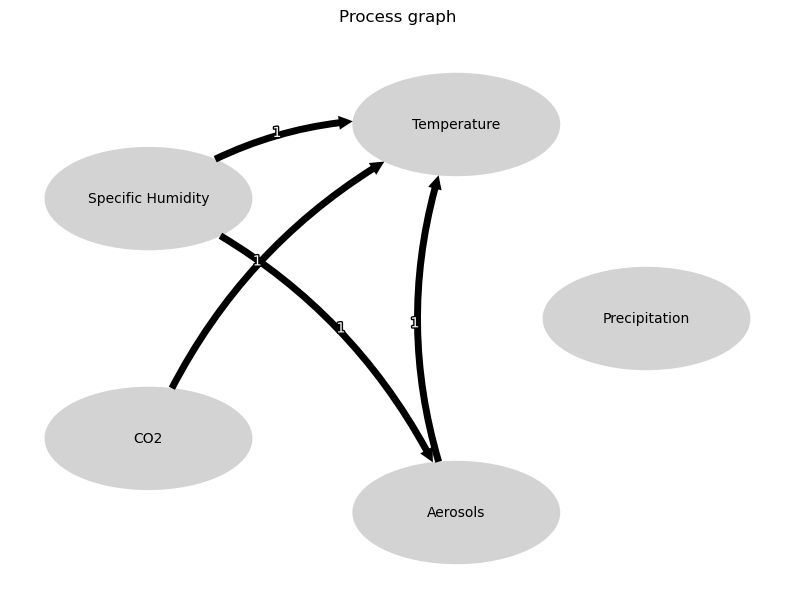


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





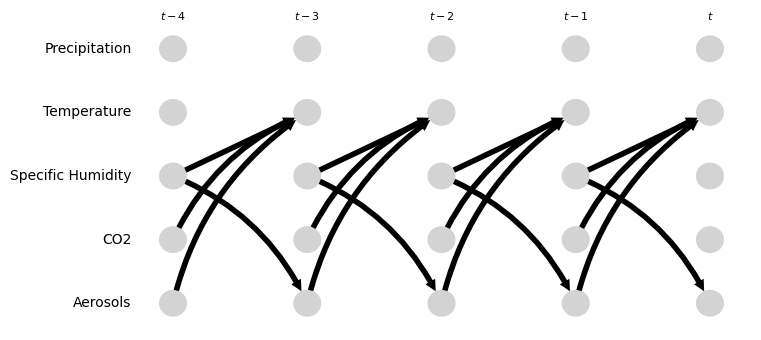

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.09 [-0.62, 0.47]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.39 [-1.46, -0.04]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.56 [-0.01, 0.83]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.75 [-1.09, -0.34]
Negative precipitation values in event 54: 0


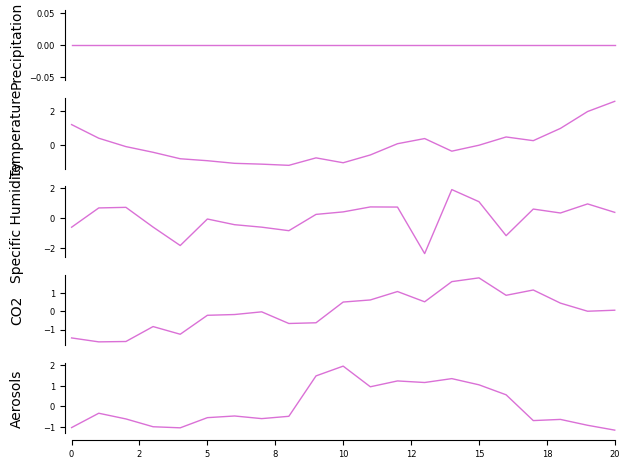

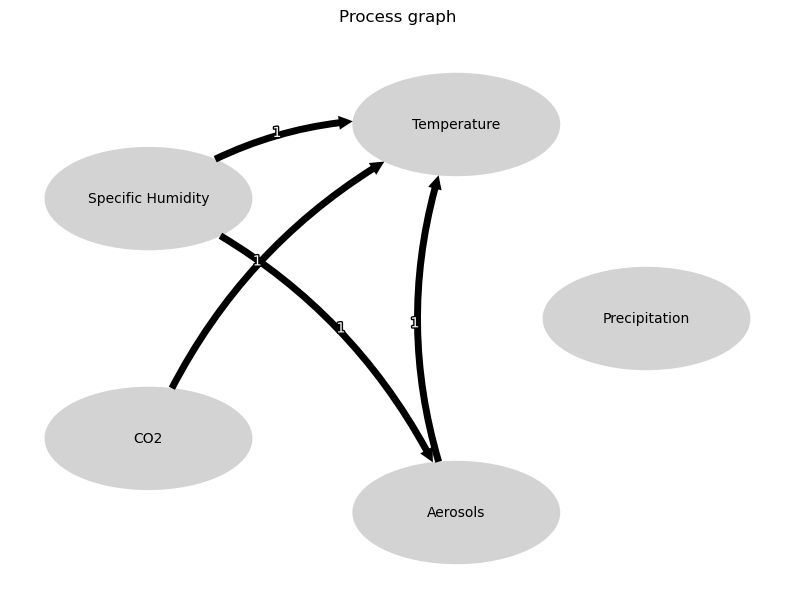


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





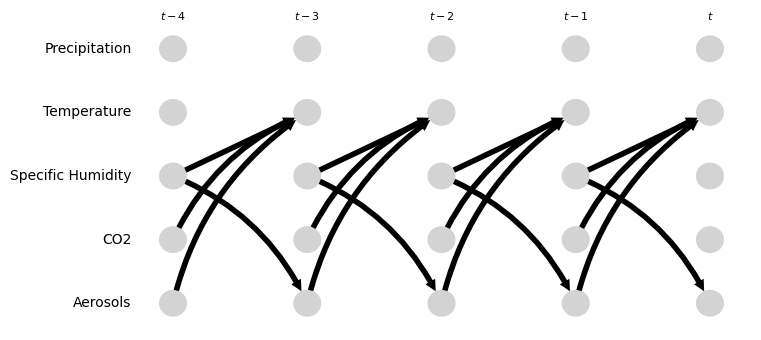

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.66 [0.31, 1.16]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.53 [-0.82, 0.07]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.28 [-0.19, 0.81]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.08 [-0.14, 0.61]
Negative precipitation values in event 55: 0


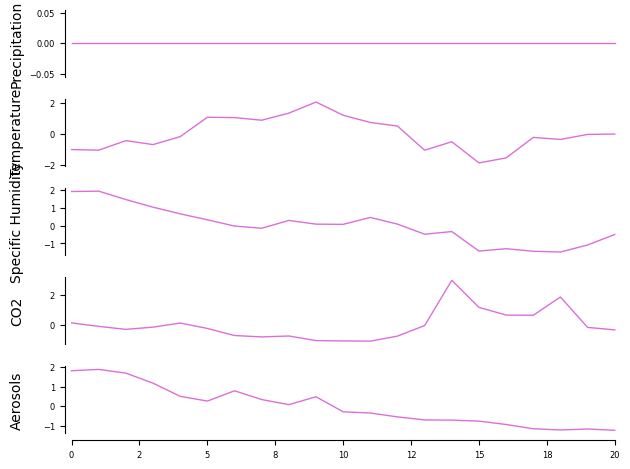

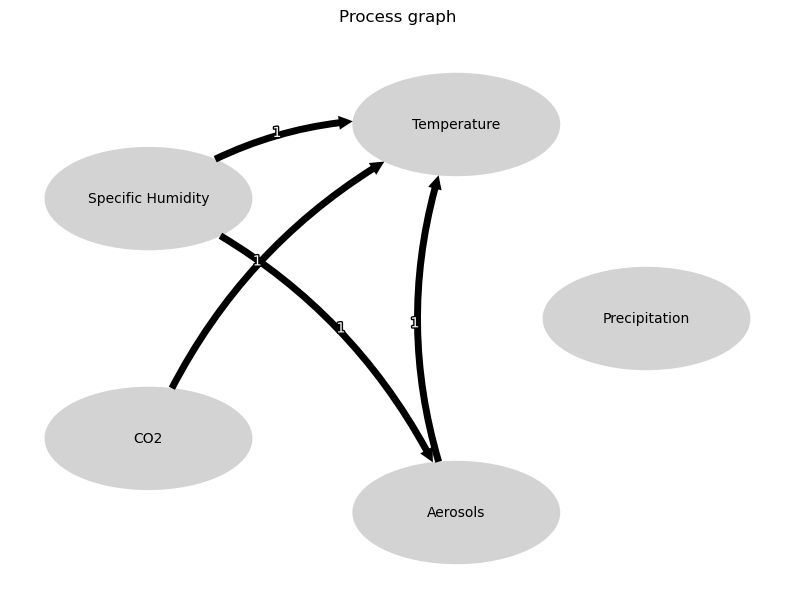


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





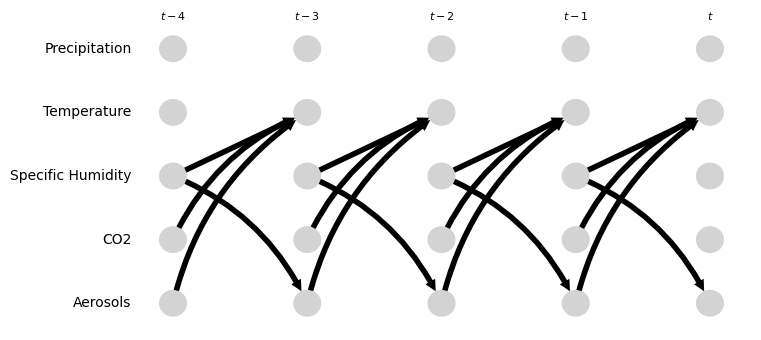

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.43 [-0.66, 0.34]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.88 [0.06, 1.74]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.20 [-0.78, 0.69]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.71 [0.50, 0.97]
Negative precipitation values in event 56: 0


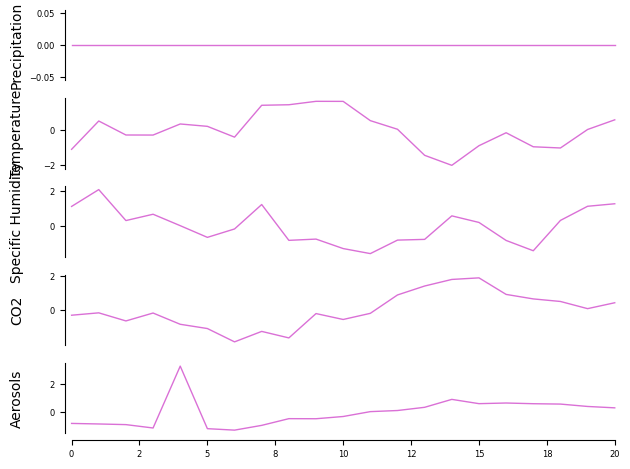

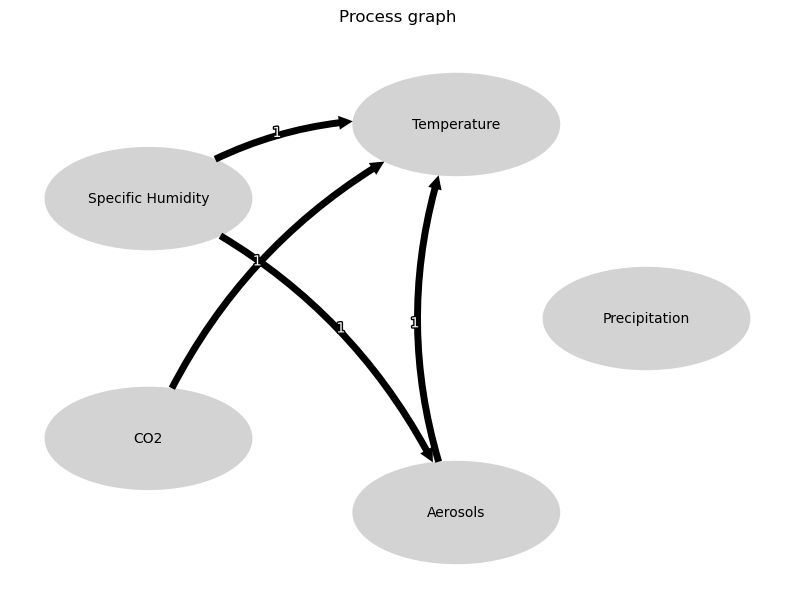


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





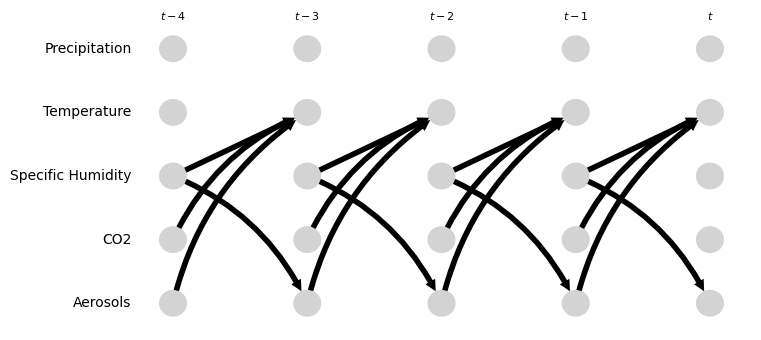

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.69 [-1.38, -0.42]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.11 [-0.33, 1.07]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.37 [0.08, 0.71]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.05 [-0.35, 0.16]
Negative precipitation values in event 57: 0


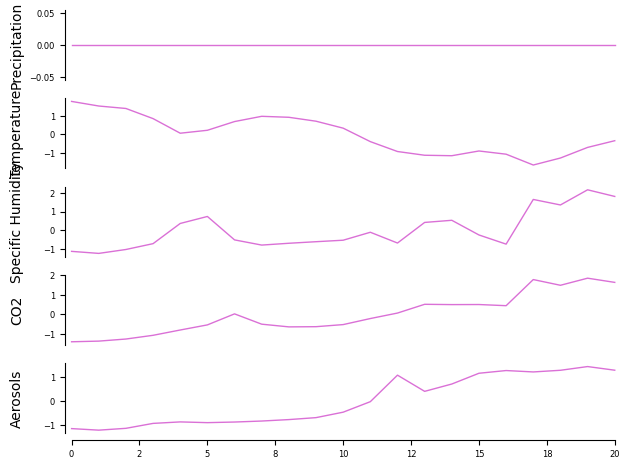

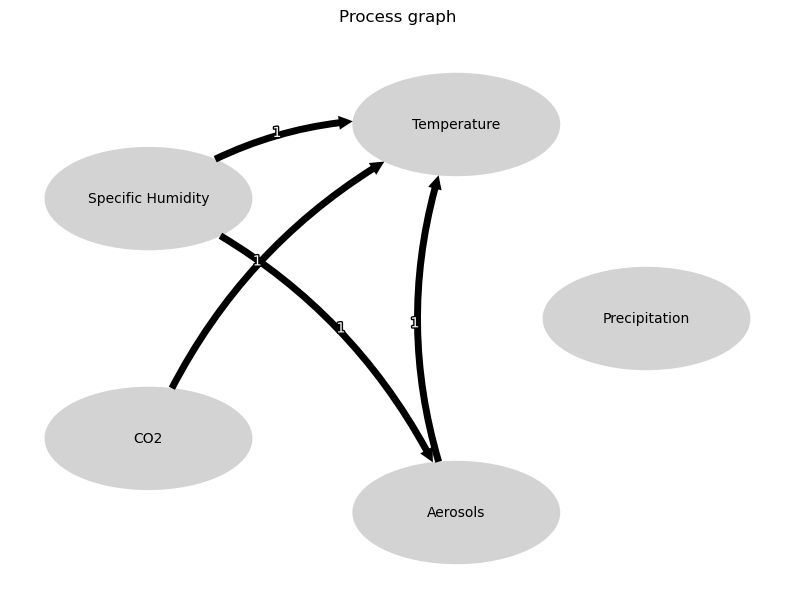


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





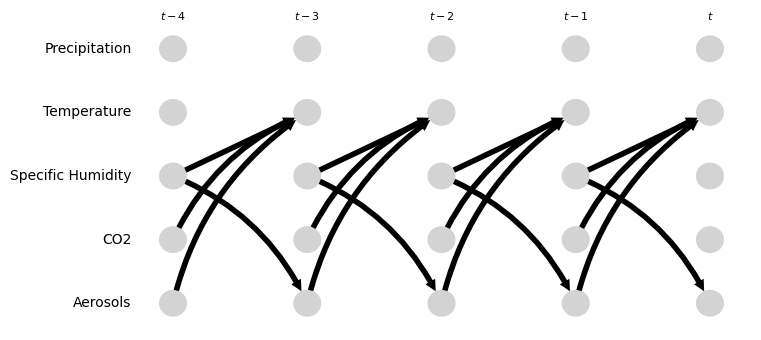

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.64 [-0.02, 1.22]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.22 [-1.48, -0.95]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.07 [-0.68, 0.06]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.48 [-0.02, 0.83]
Negative precipitation values in event 58: 0


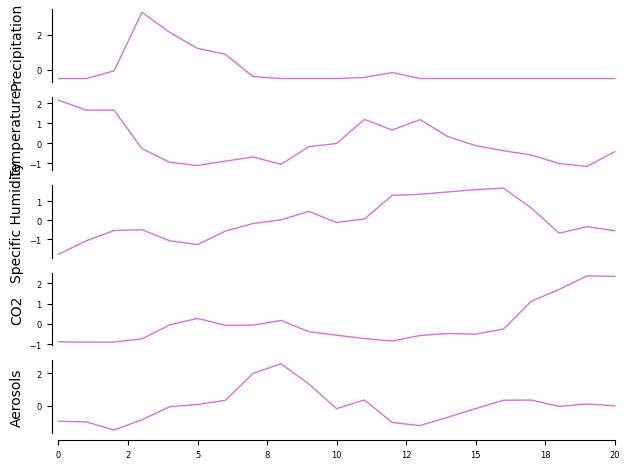

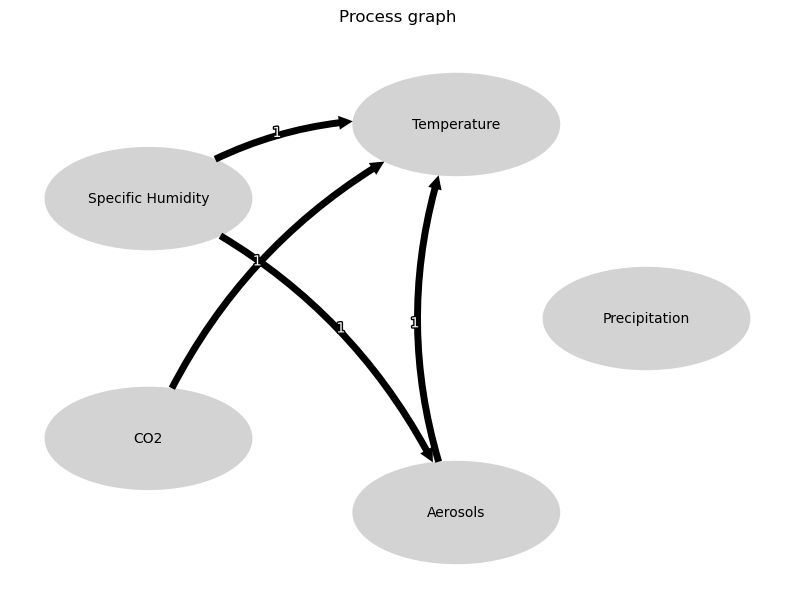


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





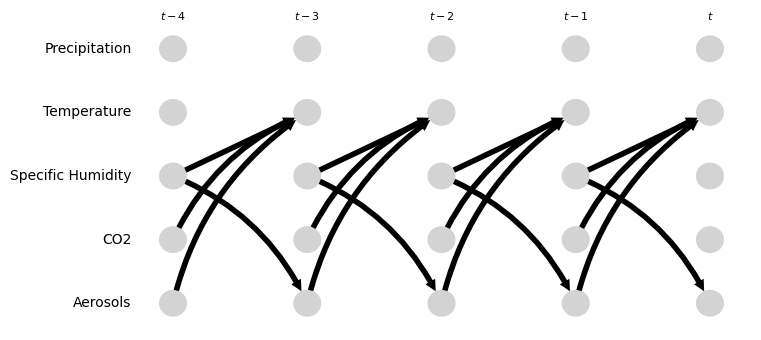

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.40 [-1.46, -0.47]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.17 [-0.44, 0.15]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.10 [-0.37, 0.26]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.36 [-0.85, -0.11]
Negative precipitation values in event 59: 0


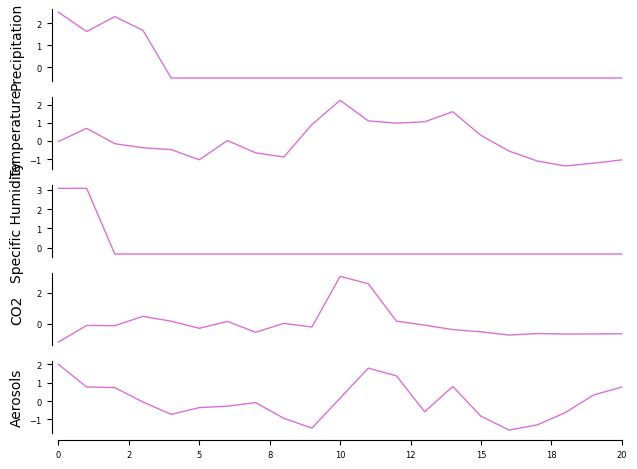

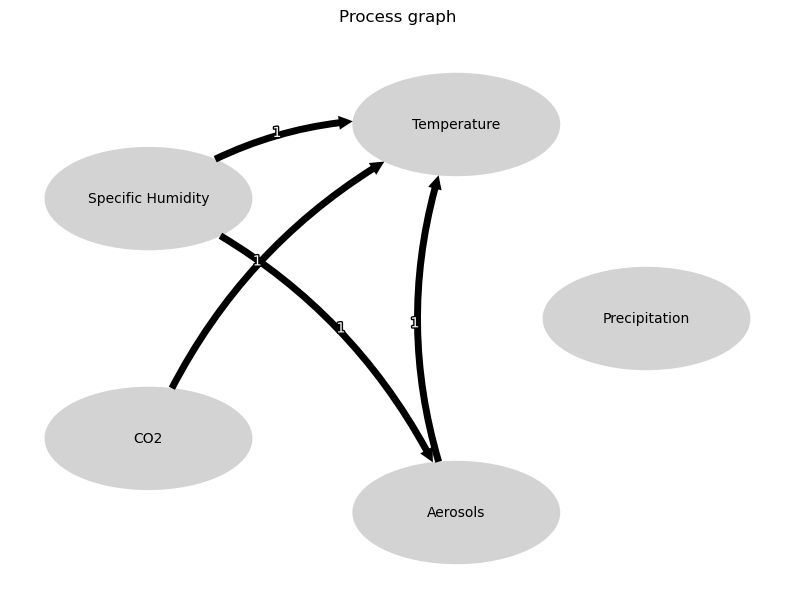


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





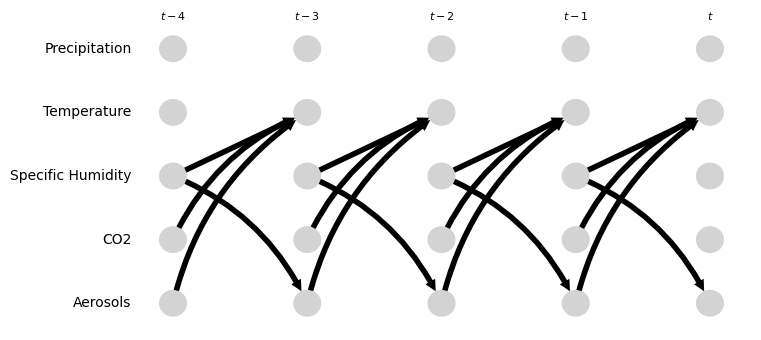

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.34 [0.09, 1.72]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.01 [-0.77, 0.54]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 180792.86 [23723.32, 283613.24]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 29954.31 [-104786.96, 203233.78]
Negative precipitation values in event 60: 0


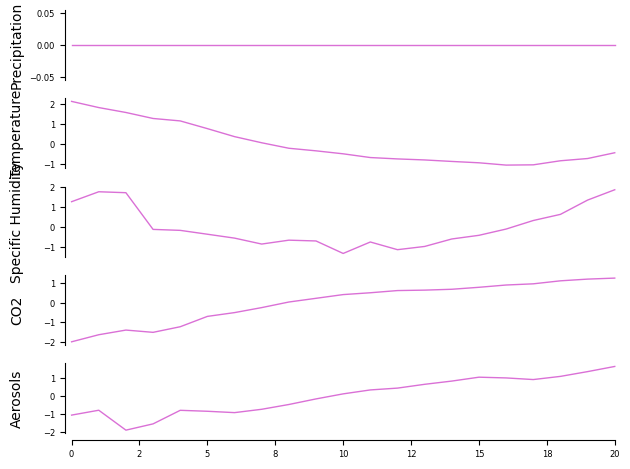

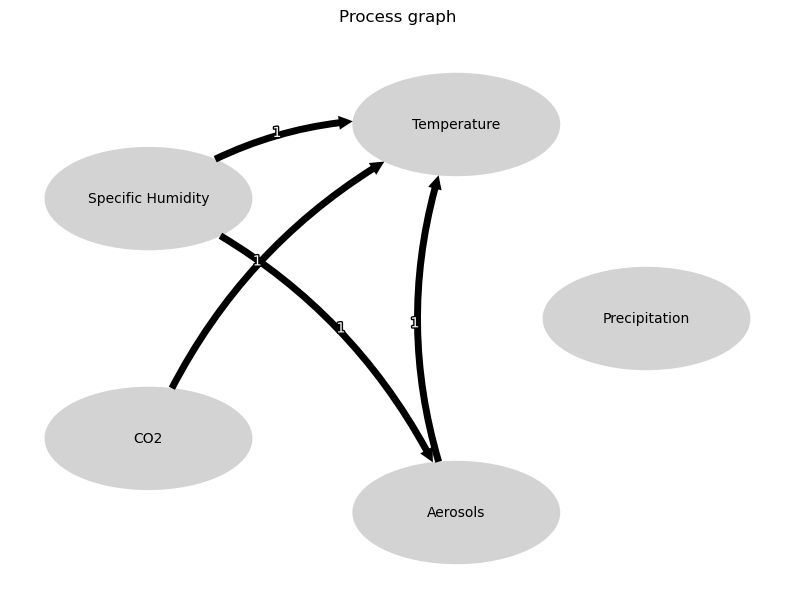


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





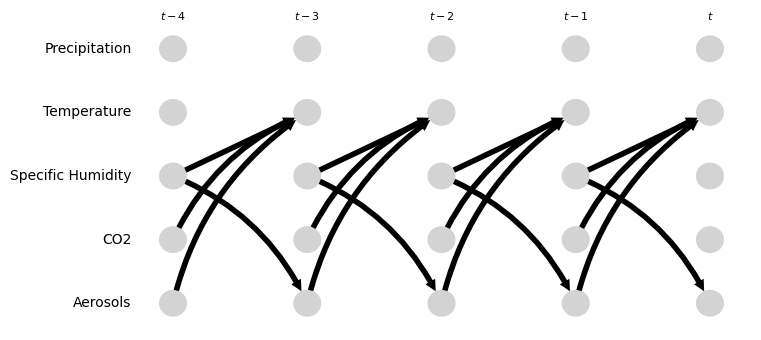

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.64 [-0.88, -0.10]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.14 [-0.45, 0.03]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.33 [0.07, 0.39]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.53 [-0.14, 0.86]
Negative precipitation values in event 61: 0


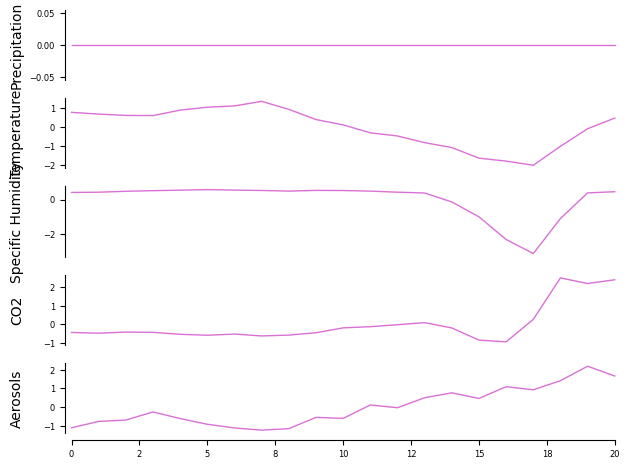

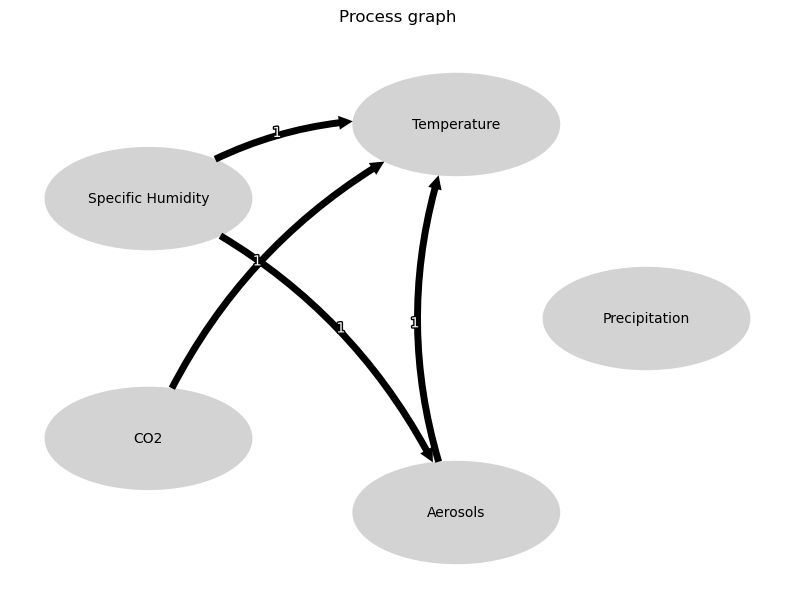


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





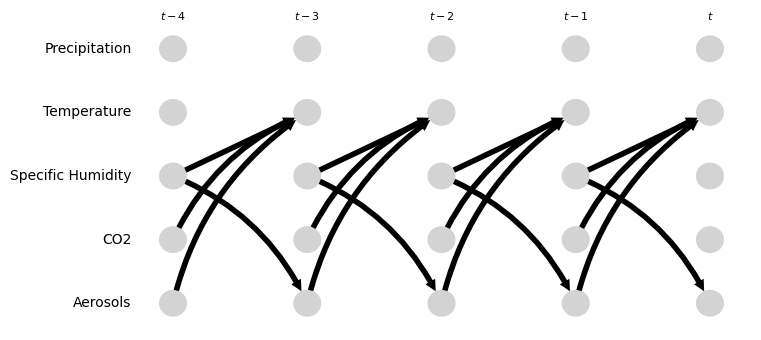

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.89 [-0.04, 0.97]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.10 [-1.88, -1.17]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.10 [-0.36, 0.17]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.58 [-1.28, -0.48]
Negative precipitation values in event 62: 0


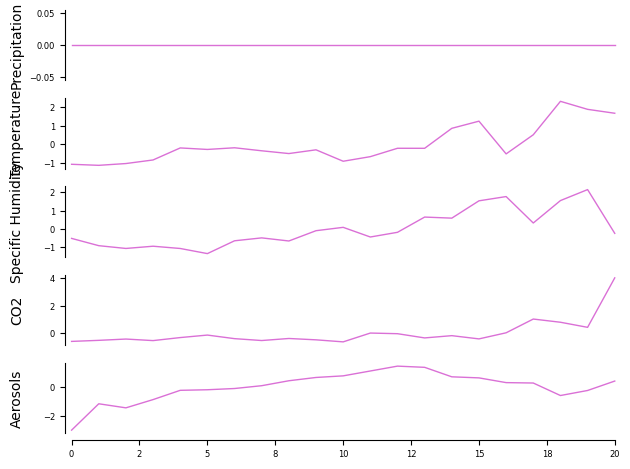

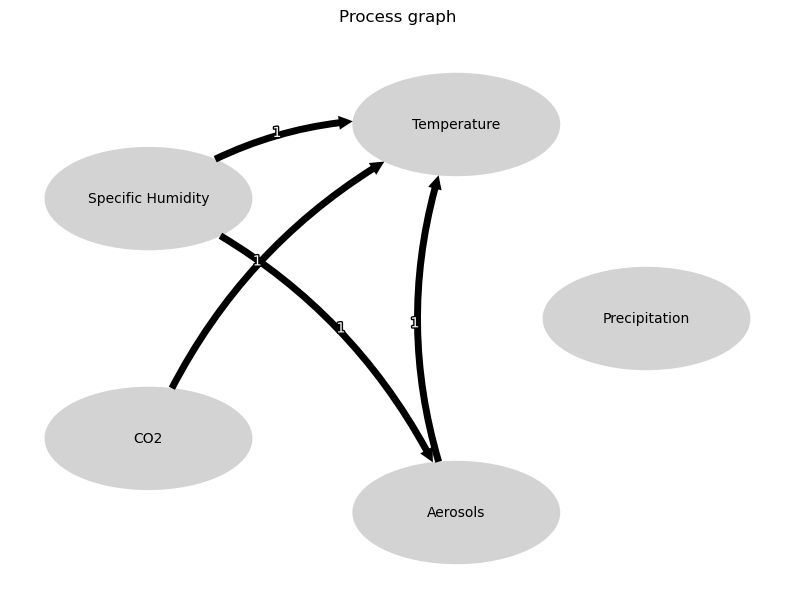


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





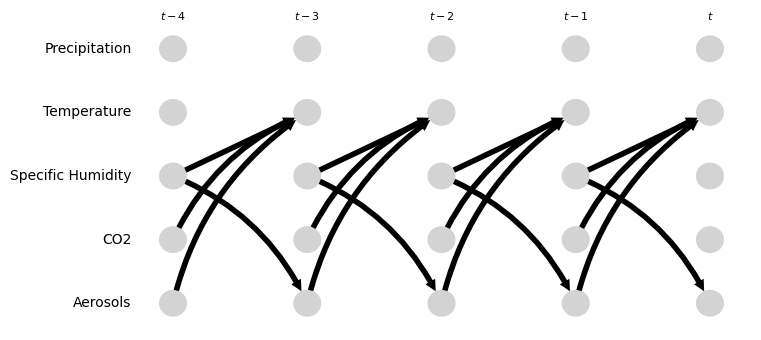

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.63 [1.09, 1.95]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.00 [-0.33, 0.67]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.23 [0.04, 0.48]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.05 [-0.32, 0.15]
Negative precipitation values in event 63: 0


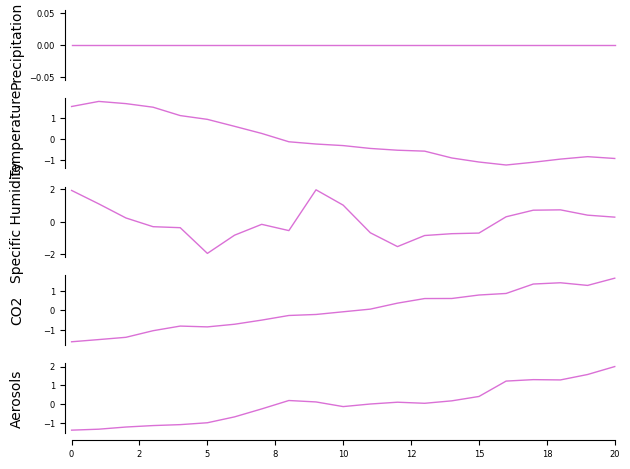

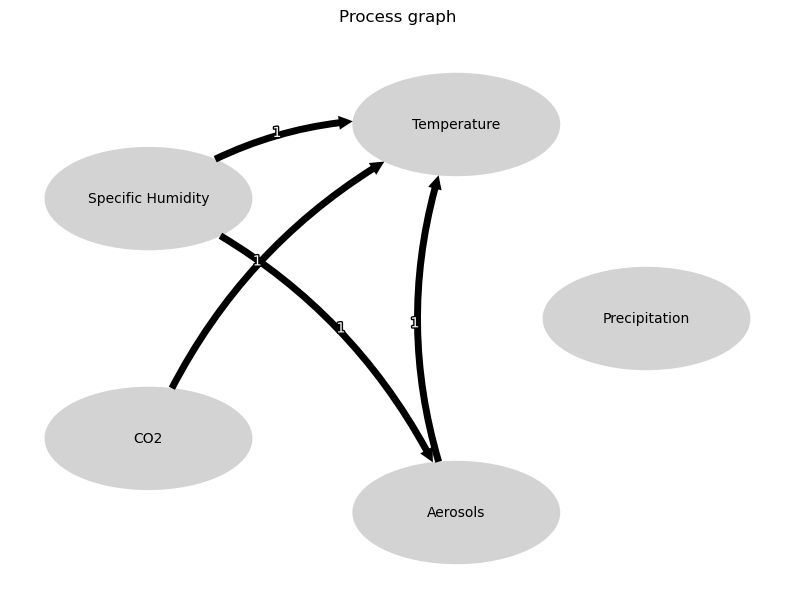


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





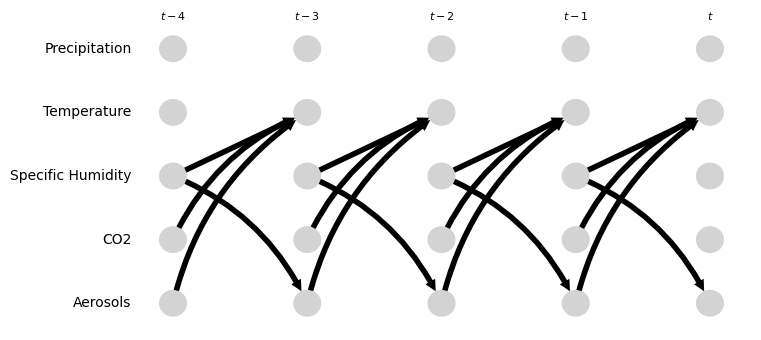

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.66 [-0.99, -0.07]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.05 [-0.62, 0.42]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.02 [-0.08, 0.25]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.31 [0.02, 0.63]
Negative precipitation values in event 64: 0


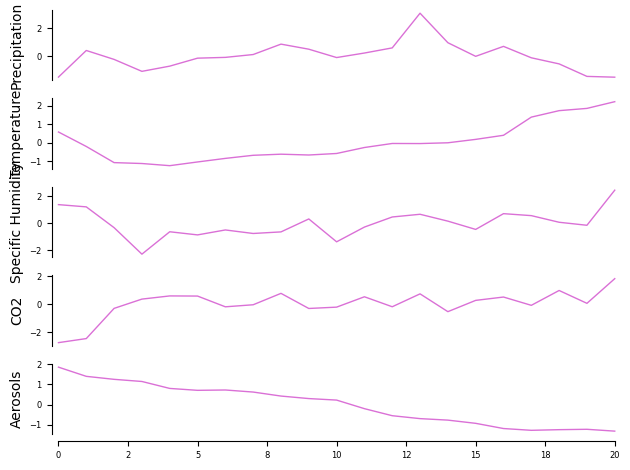

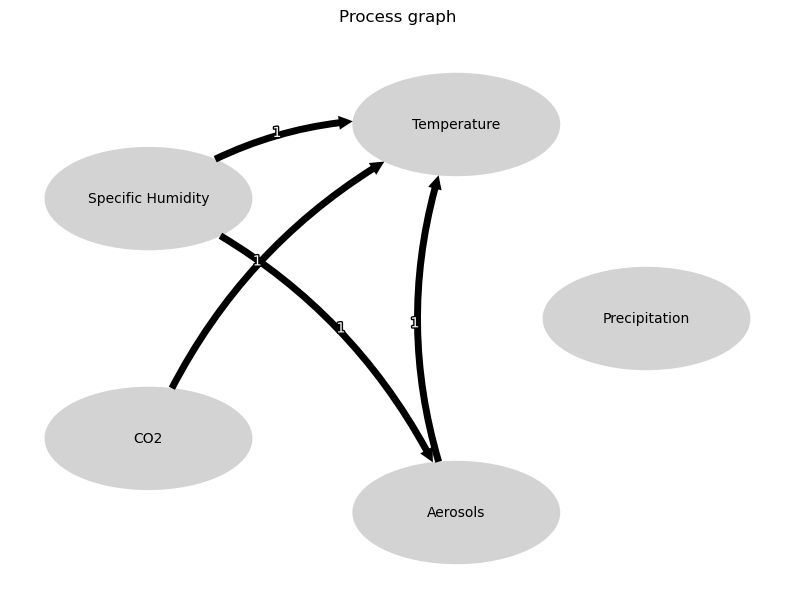


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





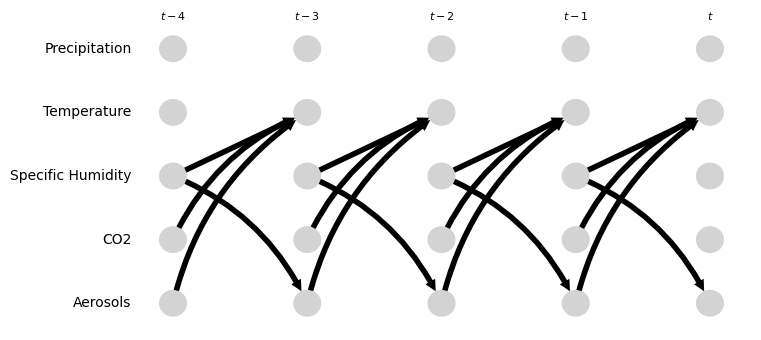

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.06 [-0.21, 0.57]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.33 [-1.50, -0.84]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.31 [-0.66, 0.33]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.77 [-1.20, -0.40]
Negative precipitation values in event 65: 0


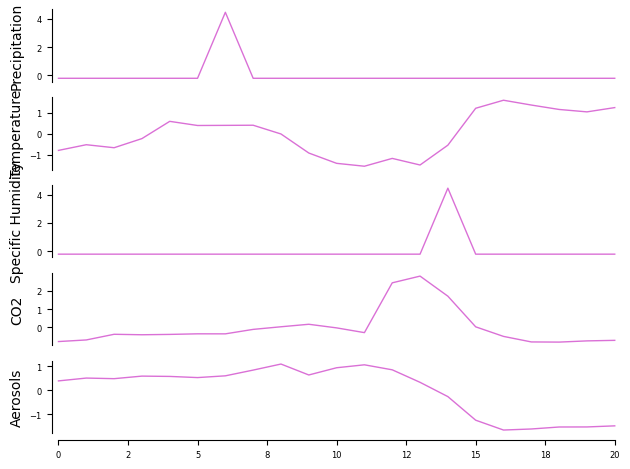

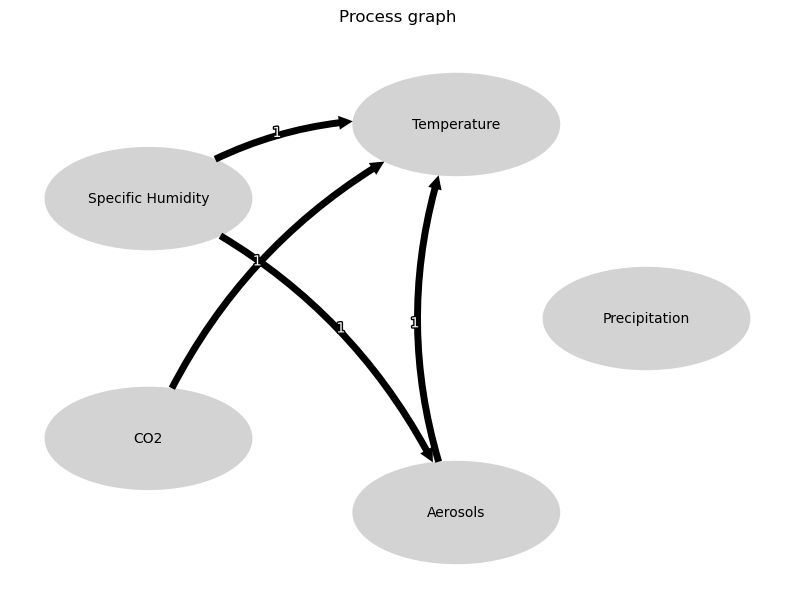


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





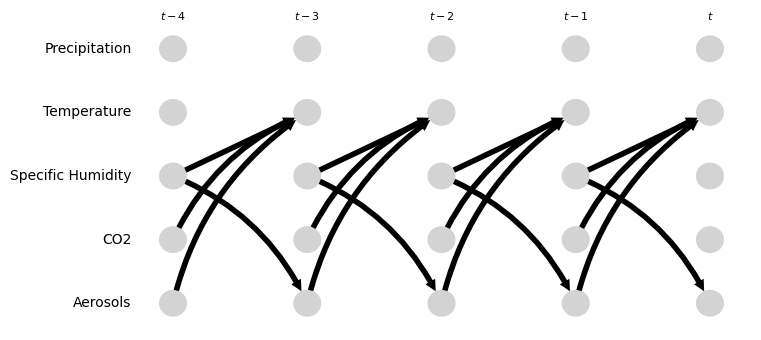

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.24 [-1.52, 0.12]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.76 [-1.32, -0.49]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.29 [0.25, 138527.43]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.25 [-0.35, 136139.13]
Negative precipitation values in event 66: 0


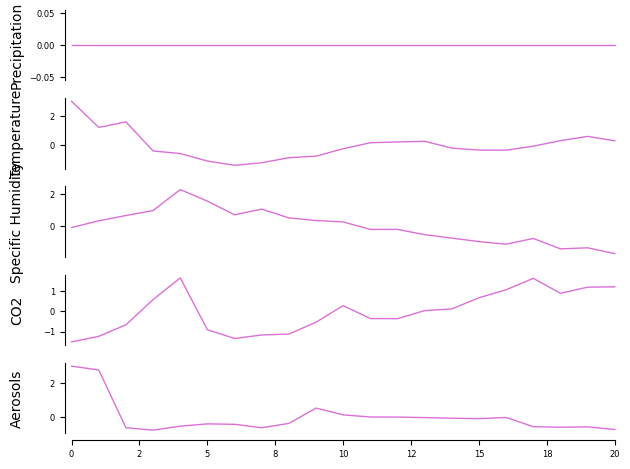

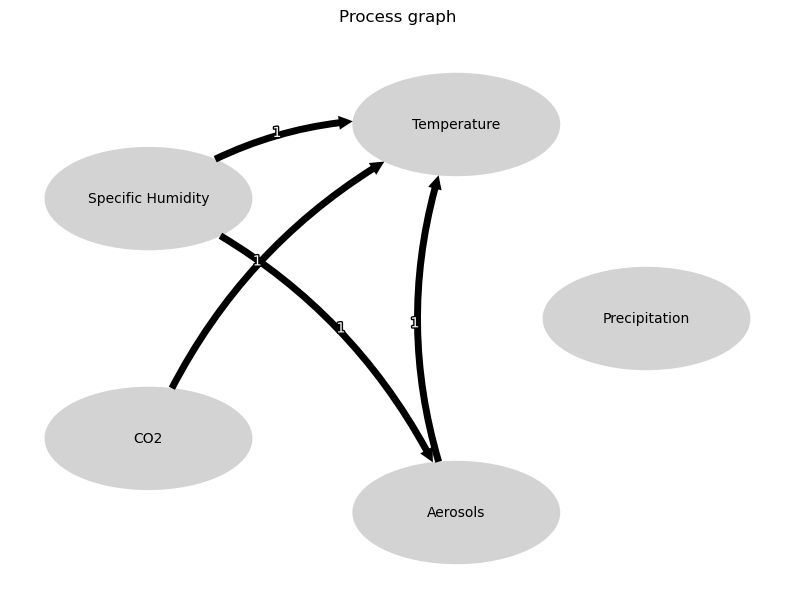


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





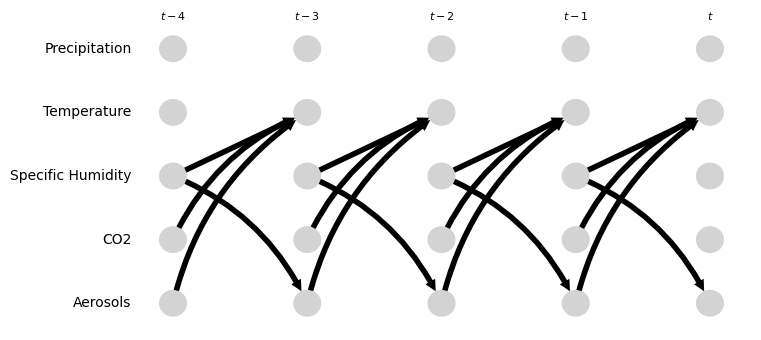

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.16 [-0.32, 0.44]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.33 [-0.03, 0.80]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.39 [-0.76, 0.04]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.05 [-0.10, 0.15]
Negative precipitation values in event 67: 0


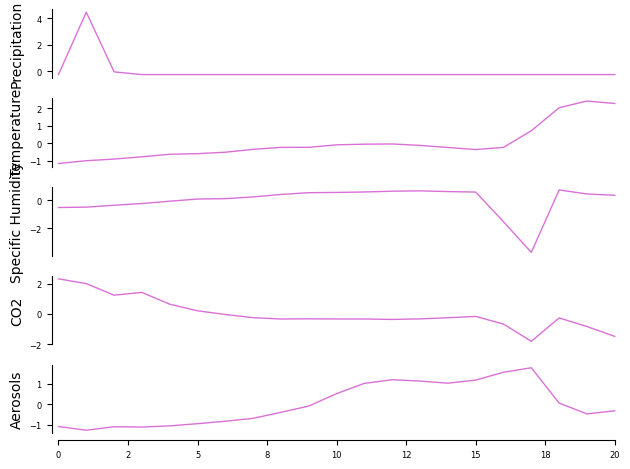

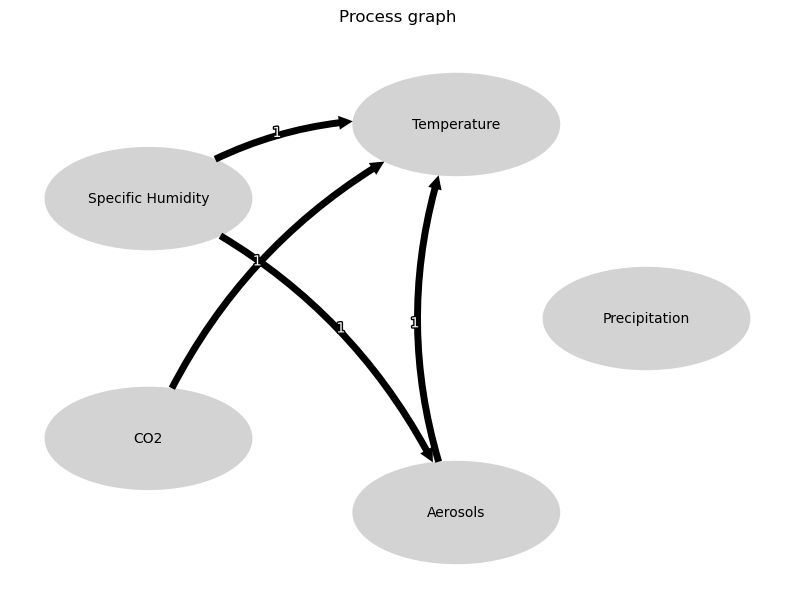


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





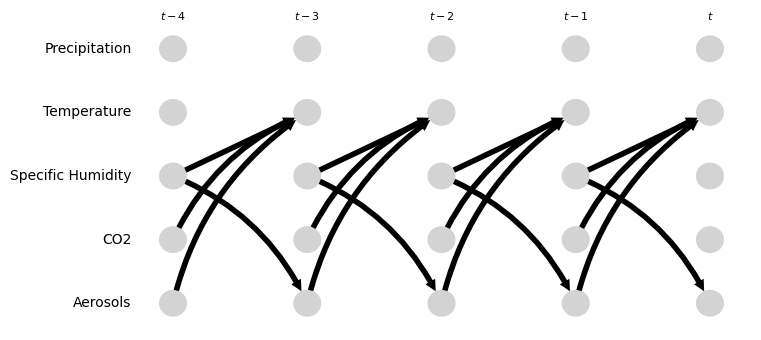

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.91 [-3.27, 1.56]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.34 [-1.35, 0.08]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.12 [-0.31, 6.68]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.03 [-0.42, 2.81]
Negative precipitation values in event 68: 0


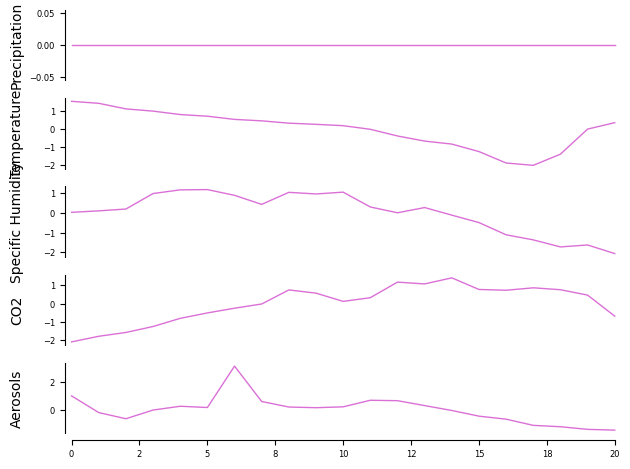

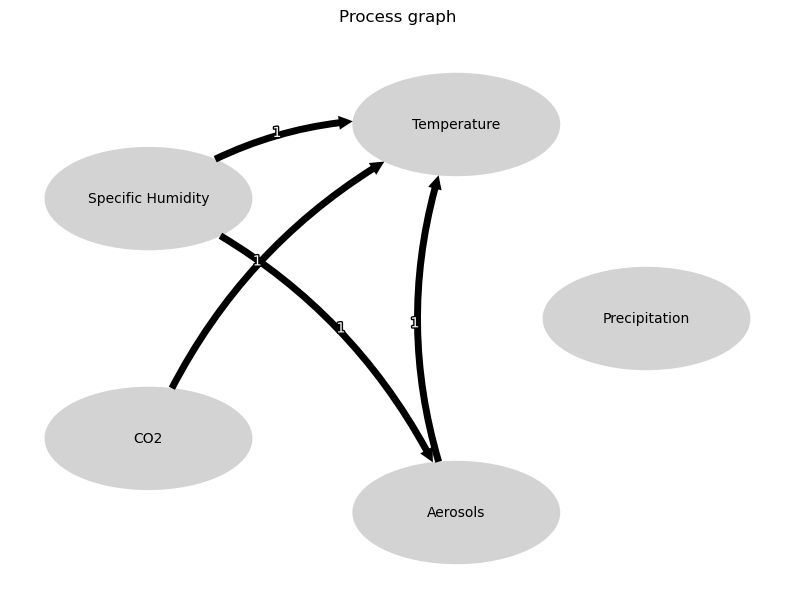


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





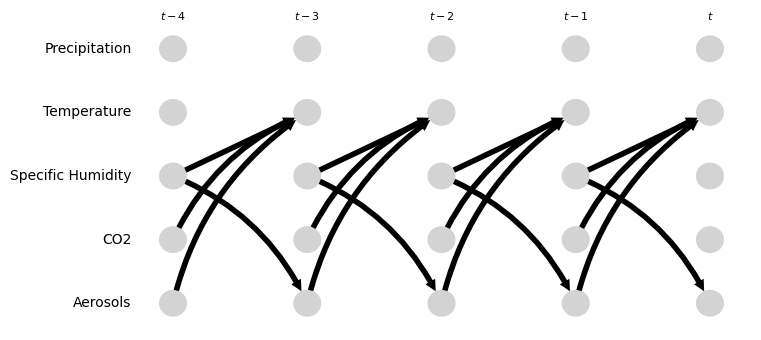

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.82 [-0.99, -0.29]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.03 [-0.21, 0.32]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.21 [-0.08, 0.92]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.89 [0.65, 1.33]
Negative precipitation values in event 69: 0


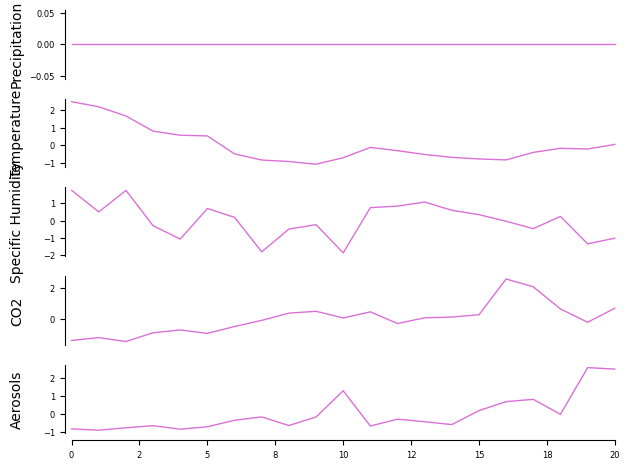

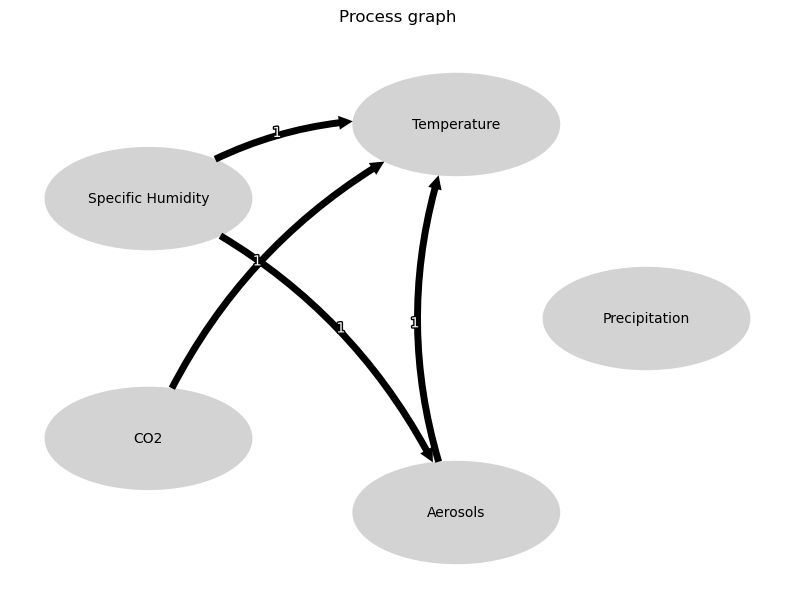


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





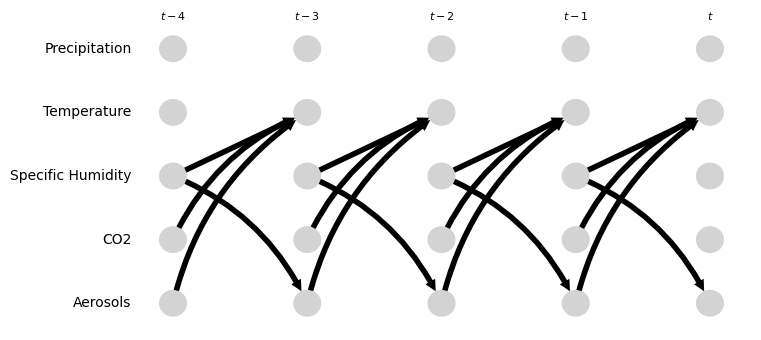

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.04 [-0.17, 0.26]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.13 [-0.49, 0.62]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.07 [-0.45, 0.24]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.02 [-0.25, 0.52]
Negative precipitation values in event 70: 0


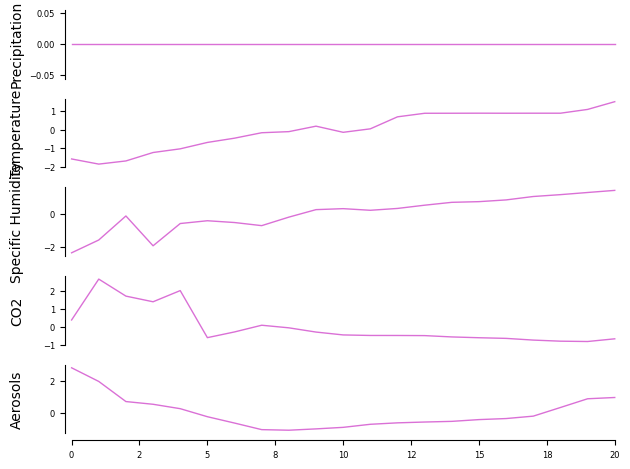

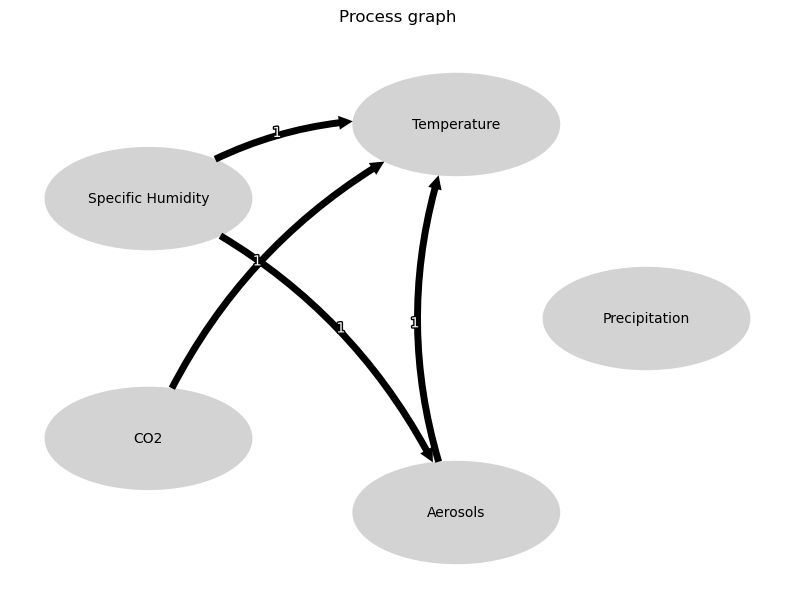


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





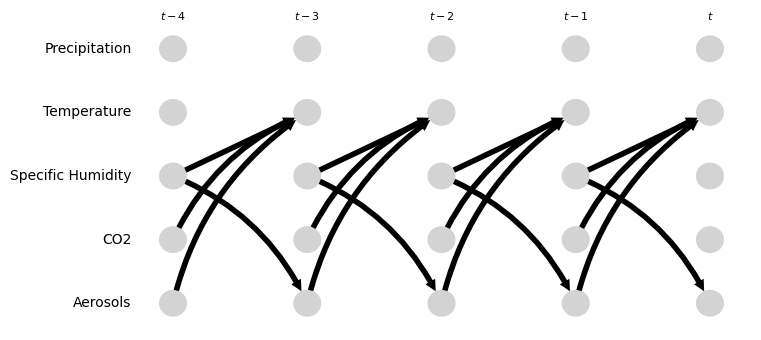

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.17 [-0.83, 1.96]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.02 [-0.52, 1.46]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.78 [0.01, 1.15]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.76 [0.32, 1.00]
Negative precipitation values in event 71: 0


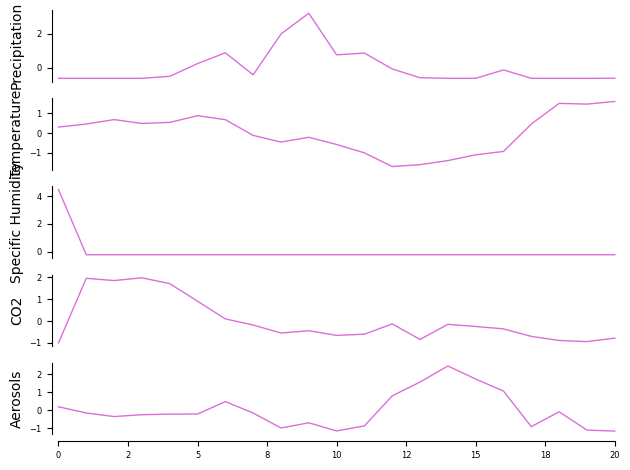

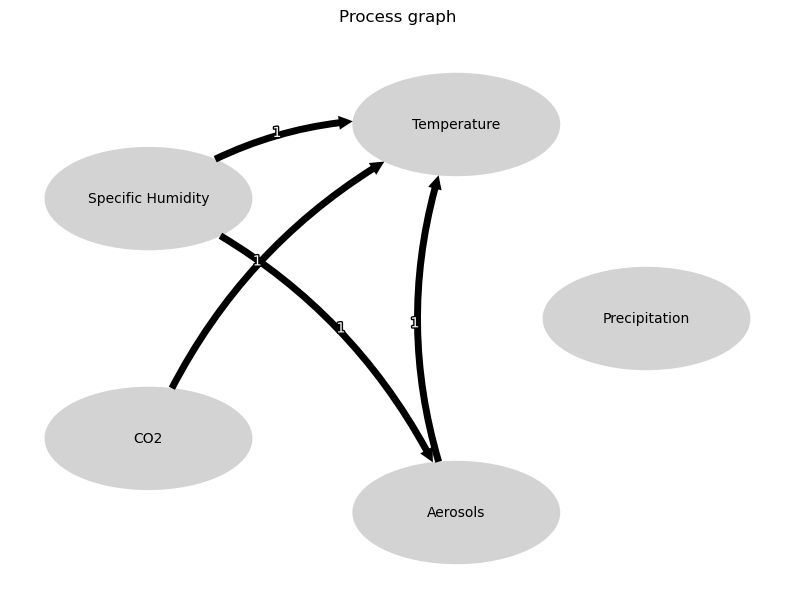


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





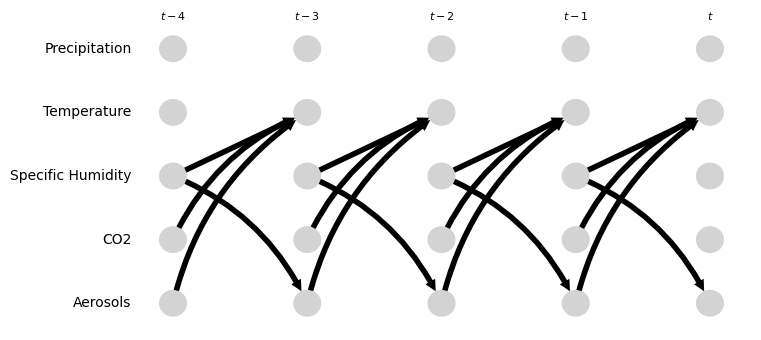

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.32 [-0.96, 1.45]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.47 [-0.93, 0.22]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 105553.22 [-166535.95, 503520.29]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -101785.46 [-395013.51, 209105.47]
Negative precipitation values in event 72: 0


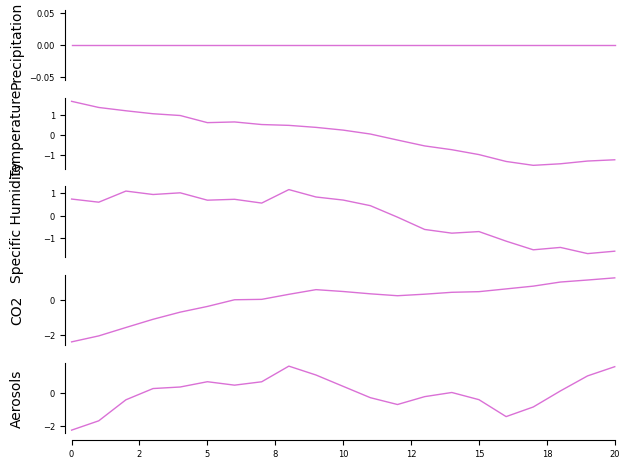

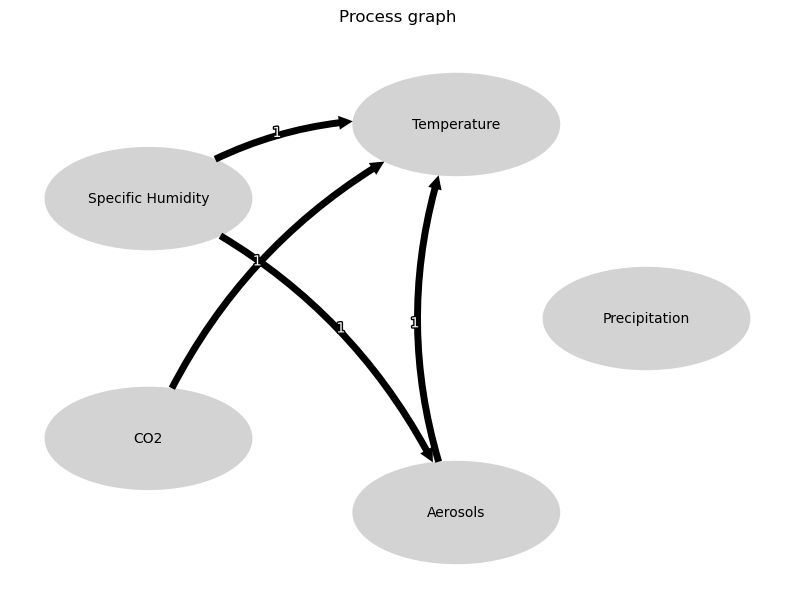


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





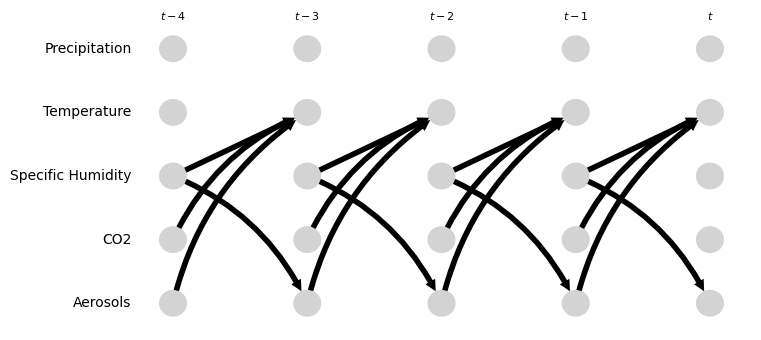

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.51 [-0.77, -0.26]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.30 [0.07, 0.38]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.47 [0.39, 0.68]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.13 [-0.03, 0.72]
Negative precipitation values in event 73: 0


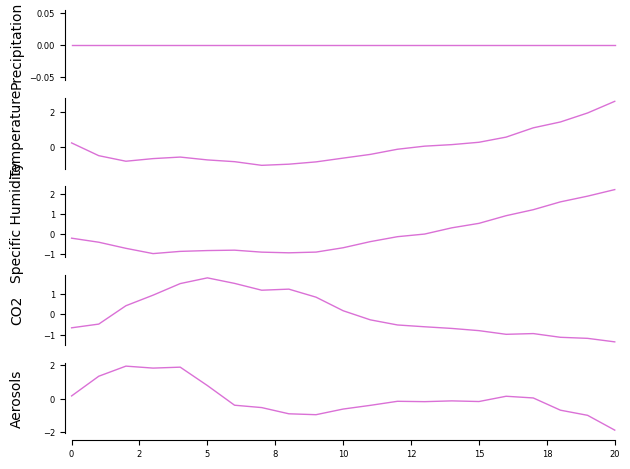

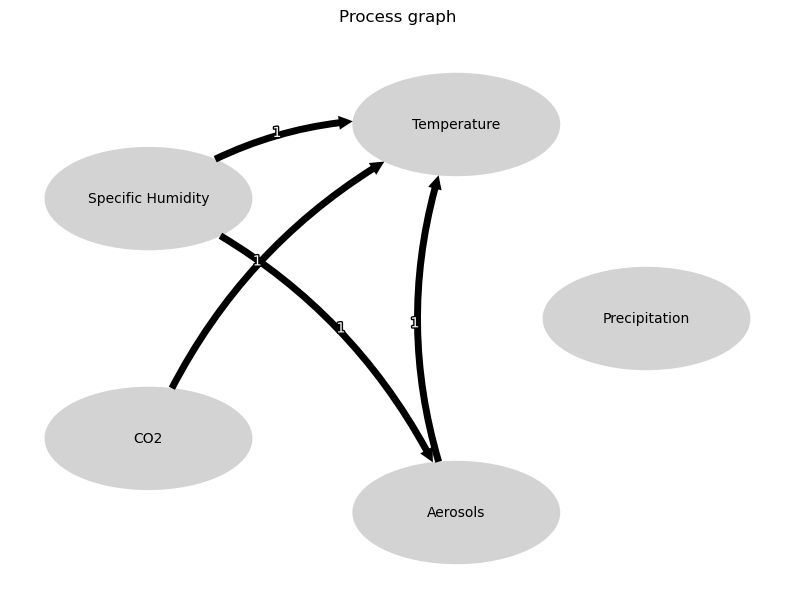


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





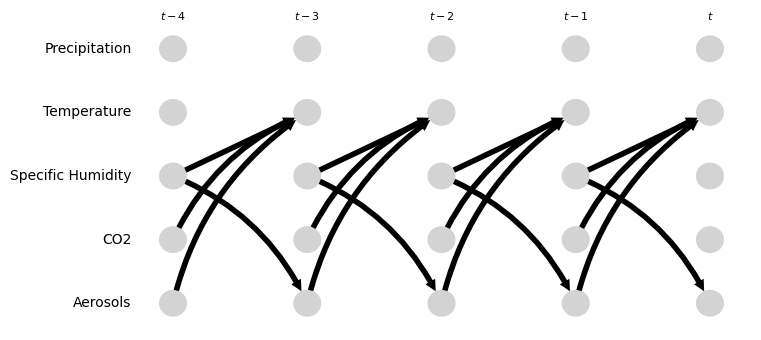

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.01 [-0.30, 0.02]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.05 [-0.48, 0.11]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.12 [0.76, 1.09]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.23 [-0.21, 0.32]
Negative precipitation values in event 74: 0


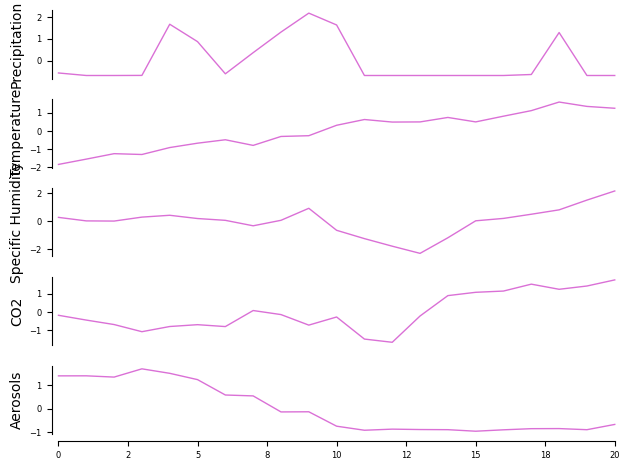

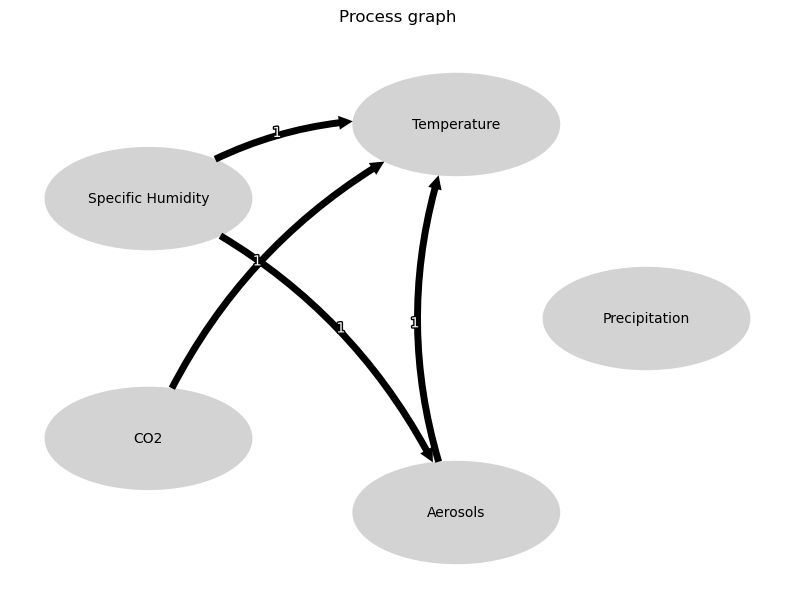


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





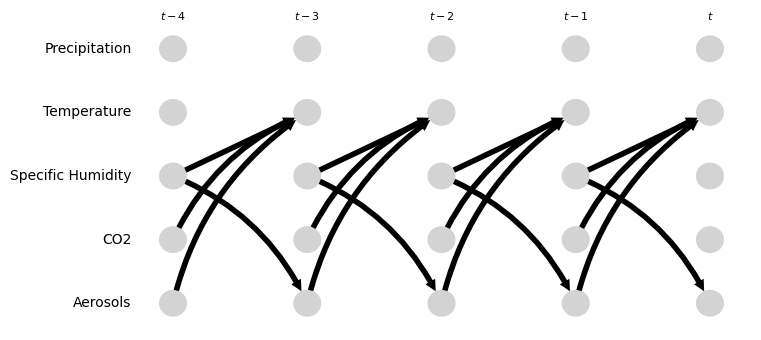

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.18 [0.05, 0.38]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.71 [-0.98, -0.45]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.12 [-0.04, 0.34]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.18 [0.06, 0.51]
Negative precipitation values in event 75: 0


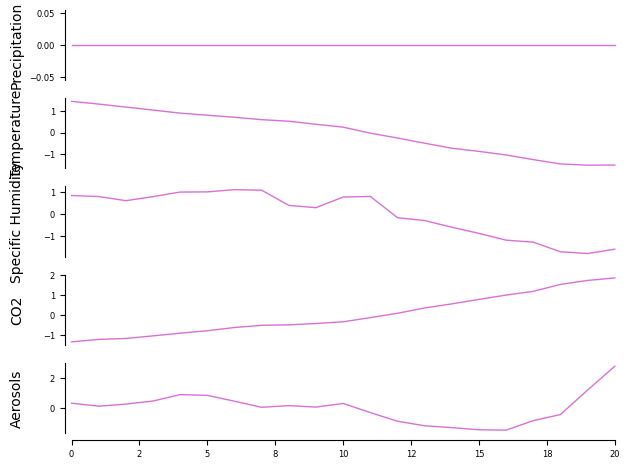

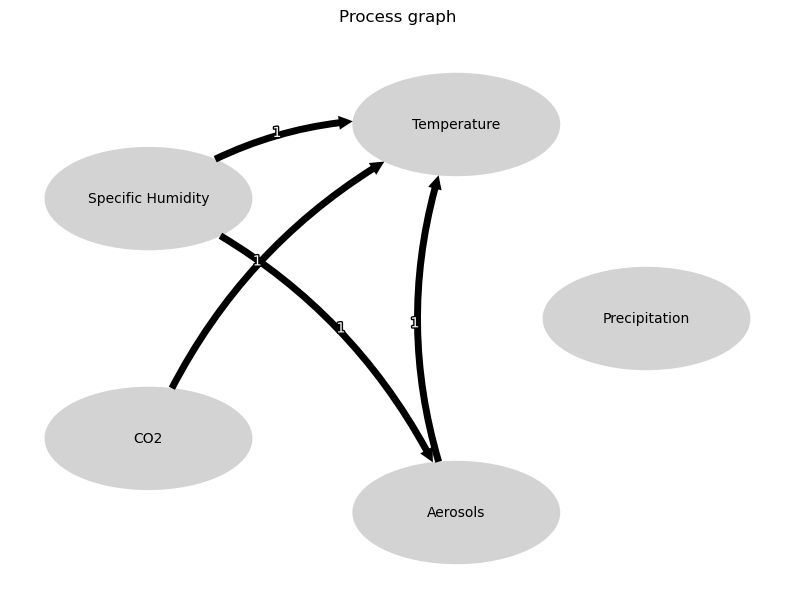


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





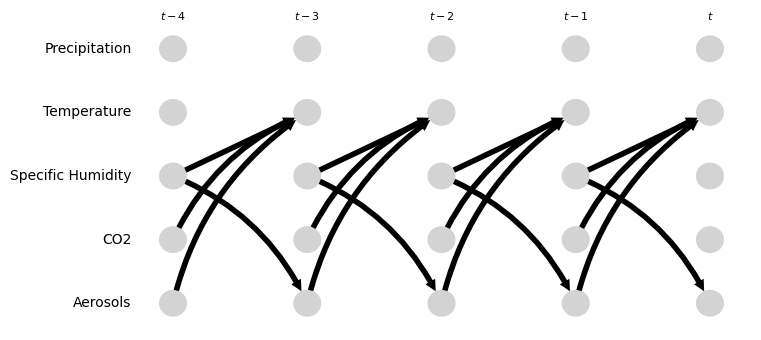

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.00 [-1.27, -0.62]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.18 [-0.00, 0.26]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.08 [-0.34, 0.21]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.14 [-0.24, 0.78]
Negative precipitation values in event 76: 0


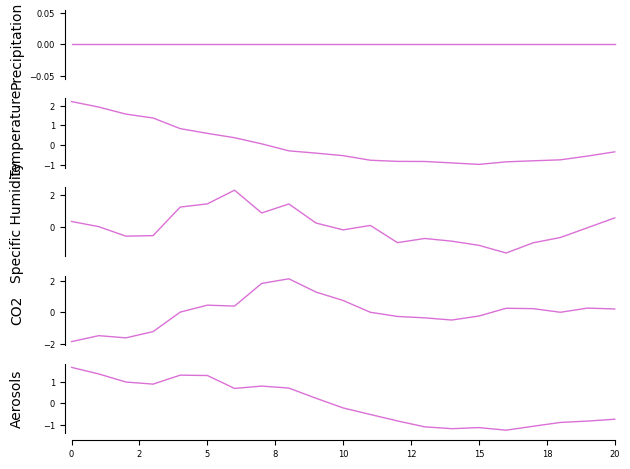

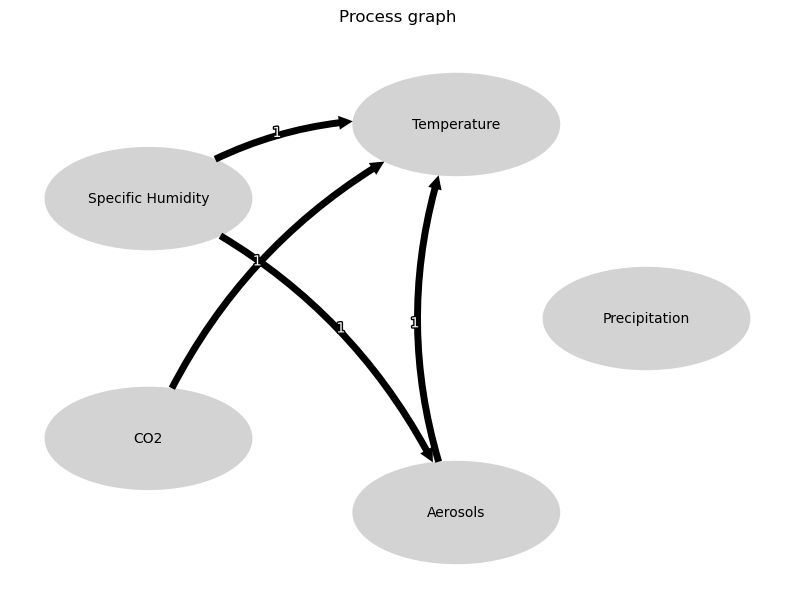


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





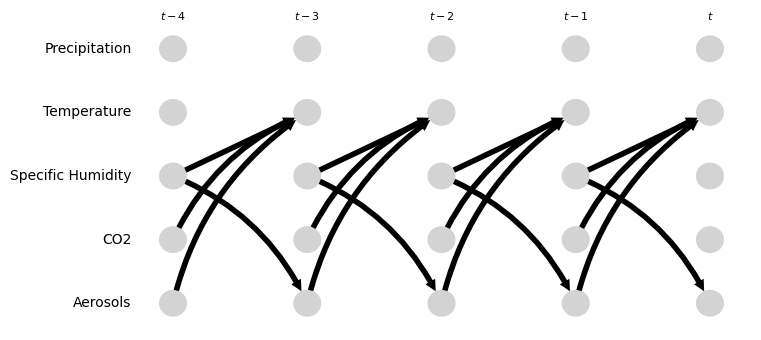

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.23 [-0.32, -0.05]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.51 [0.25, 0.93]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.03 [-0.35, 0.16]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.66 [0.56, 0.78]
Negative precipitation values in event 77: 0


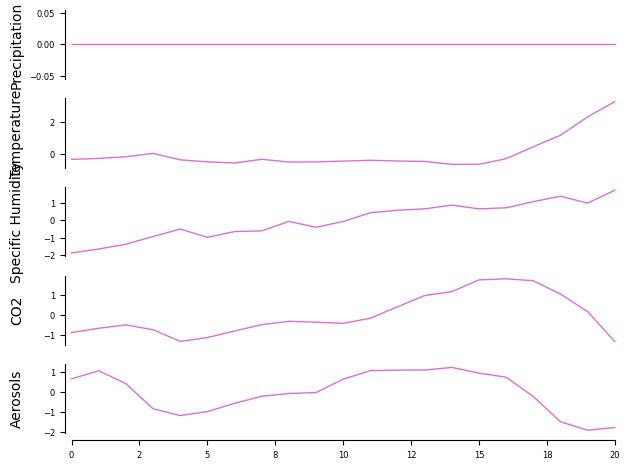

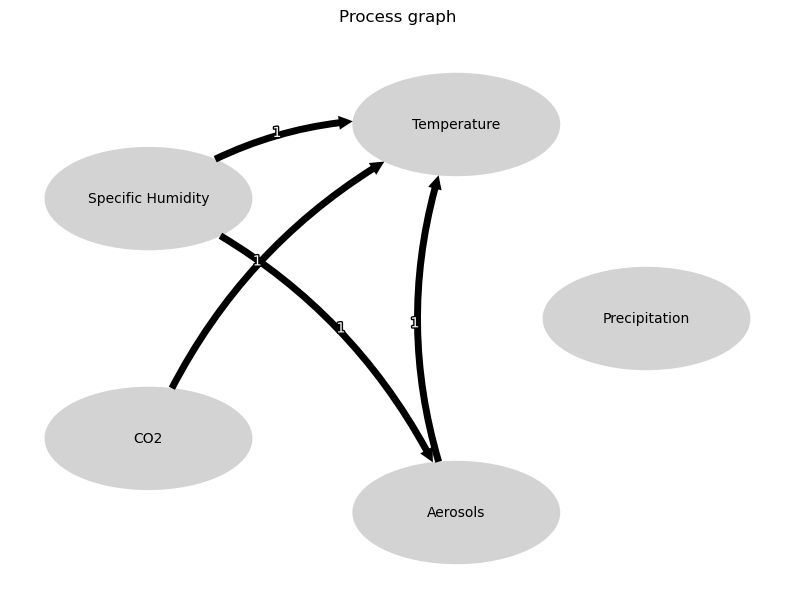


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





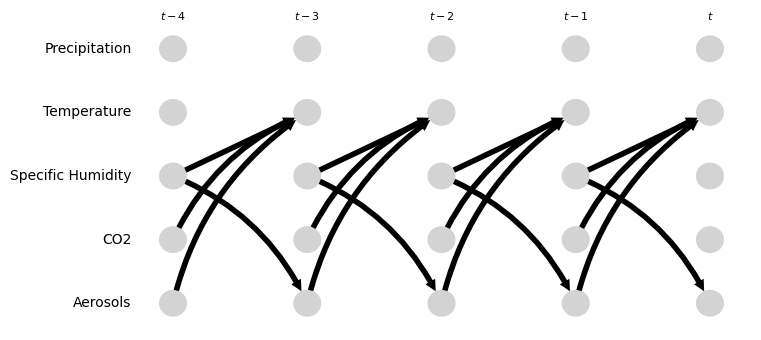

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.05 [-0.04, 0.55]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.88 [-0.89, -0.51]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.11 [0.02, 1.03]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.24 [-0.71, 0.62]
Negative precipitation values in event 78: 0


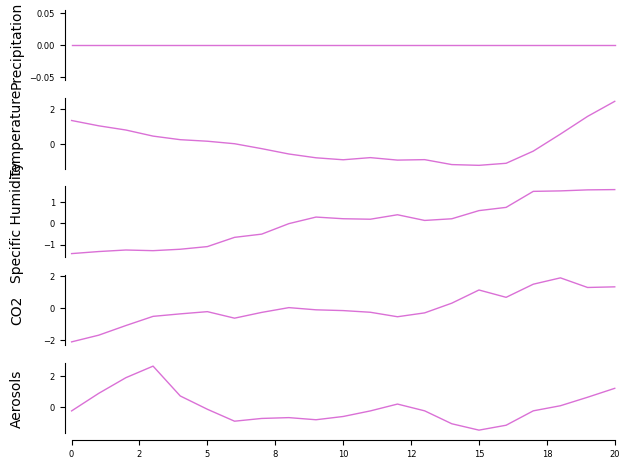

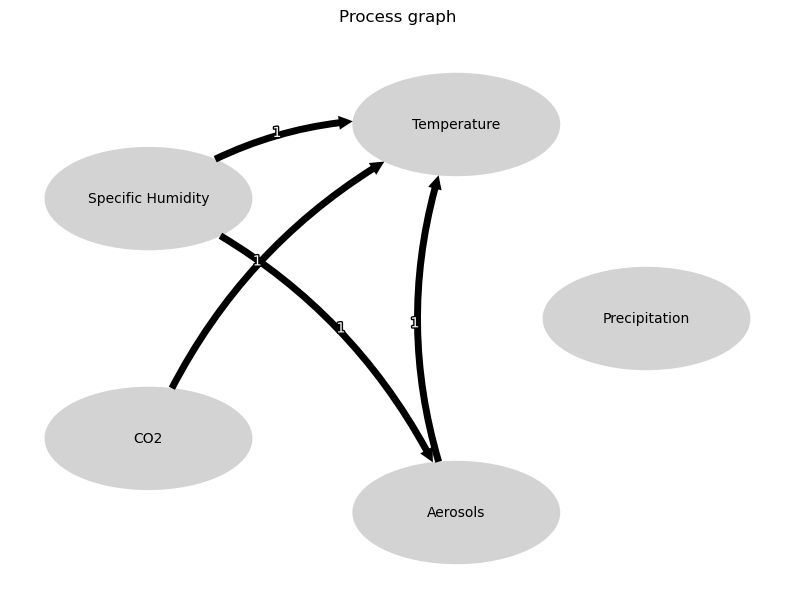


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





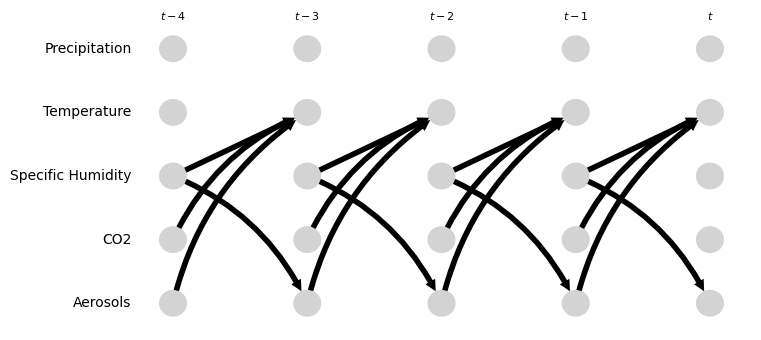

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.99 [0.27, 1.48]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.01 [0.05, 1.26]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.23 [-1.10, -0.02]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.45 [0.01, 0.59]
Negative precipitation values in event 79: 0


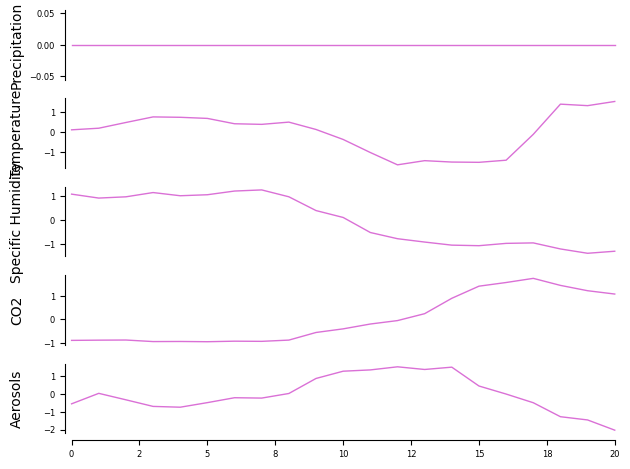

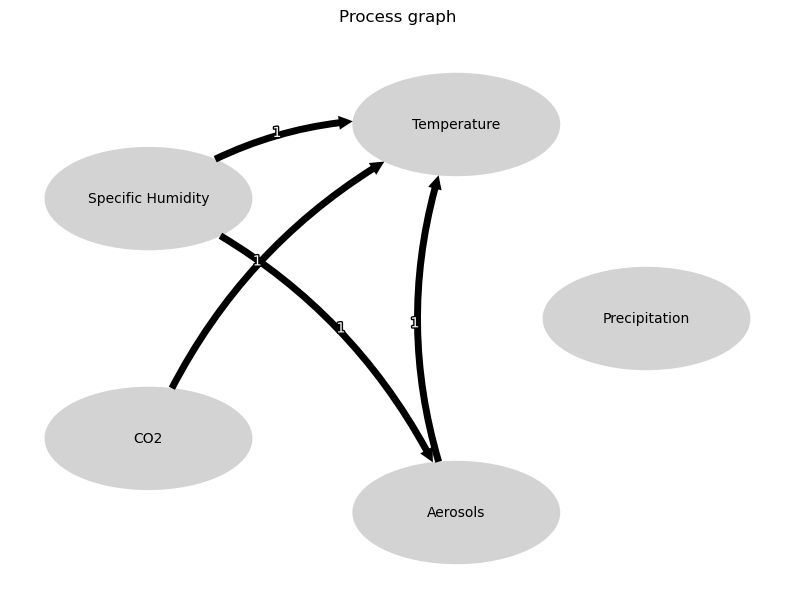


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





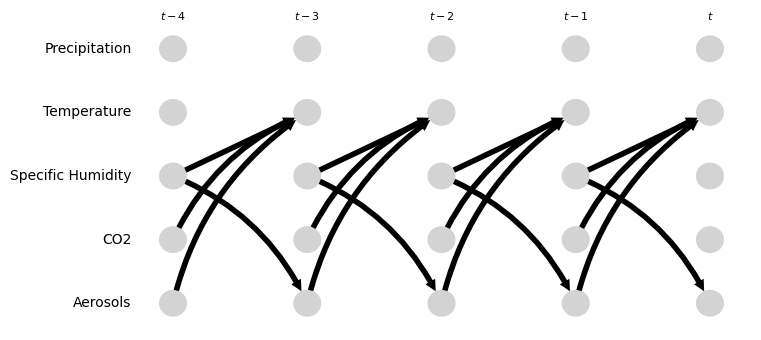

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.12 [-0.59, 1.01]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.01 [-1.18, -0.56]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.20 [-0.30, 1.03]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.24 [-0.30, 0.41]
Negative precipitation values in event 80: 0


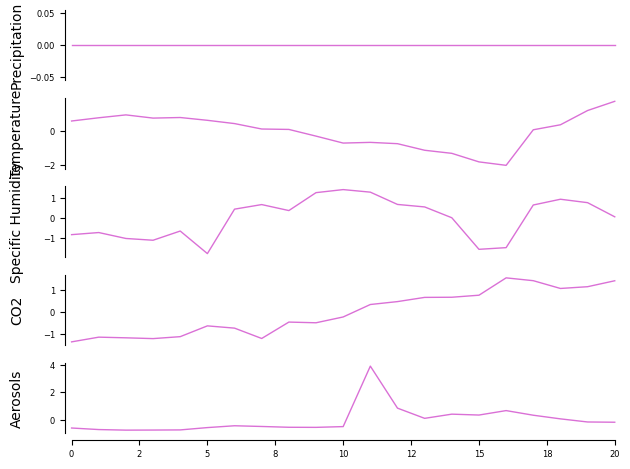

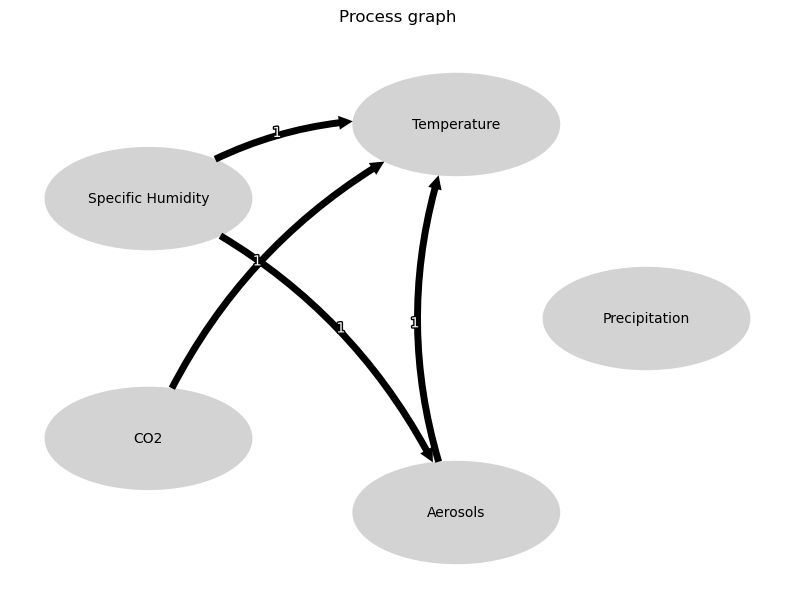


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





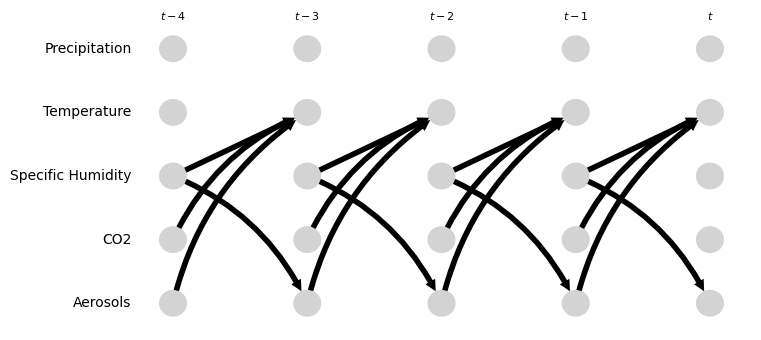

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.15 [-0.69, 1.11]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.33 [-2.62, 0.04]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.14 [-0.40, 0.56]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.25 [-0.18, 0.76]
Negative precipitation values in event 81: 0


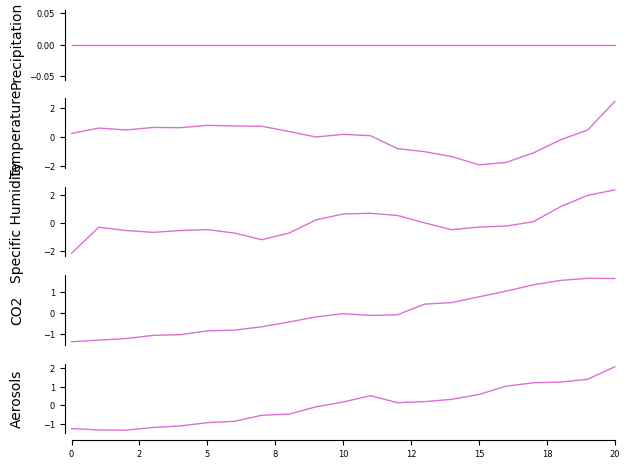

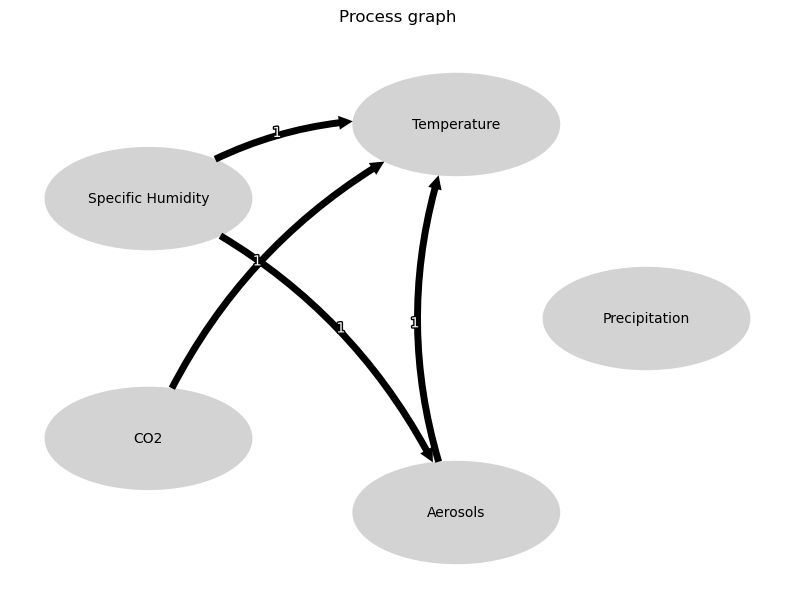


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





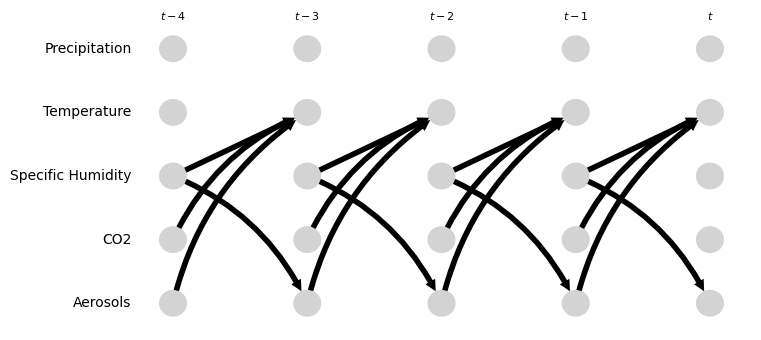

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.45 [-2.73, 1.79]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -2.59 [-2.96, 1.85]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.23 [-0.31, 1.48]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.73 [0.31, 0.95]
Negative precipitation values in event 82: 0


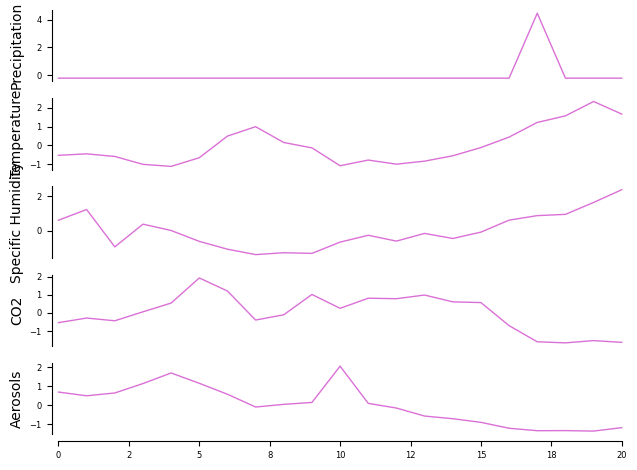

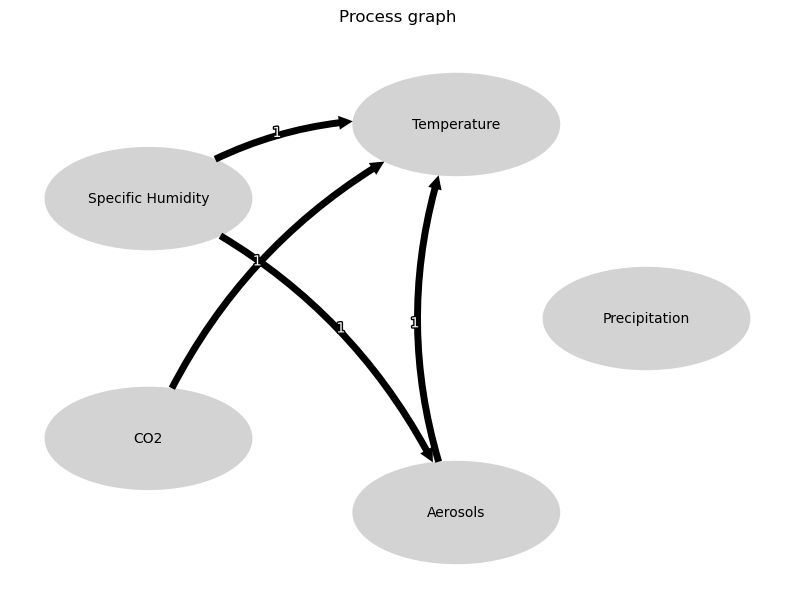


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





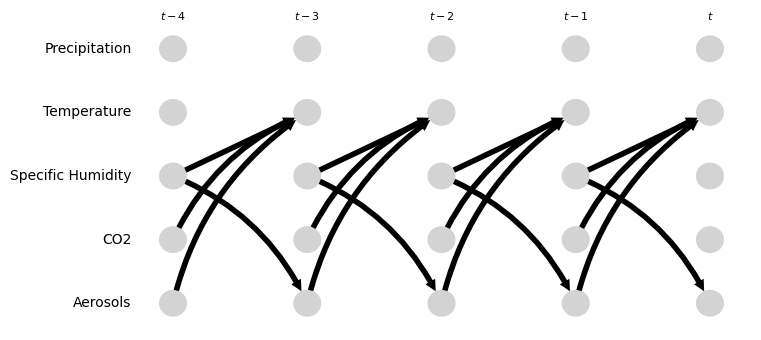

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.35 [-0.83, 0.06]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.21 [-0.41, 0.89]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.36 [-0.06, 1.02]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.73 [-1.30, -0.45]
Negative precipitation values in event 83: 0


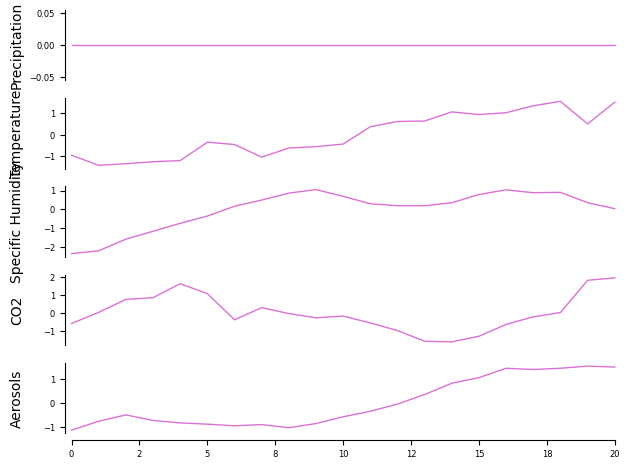

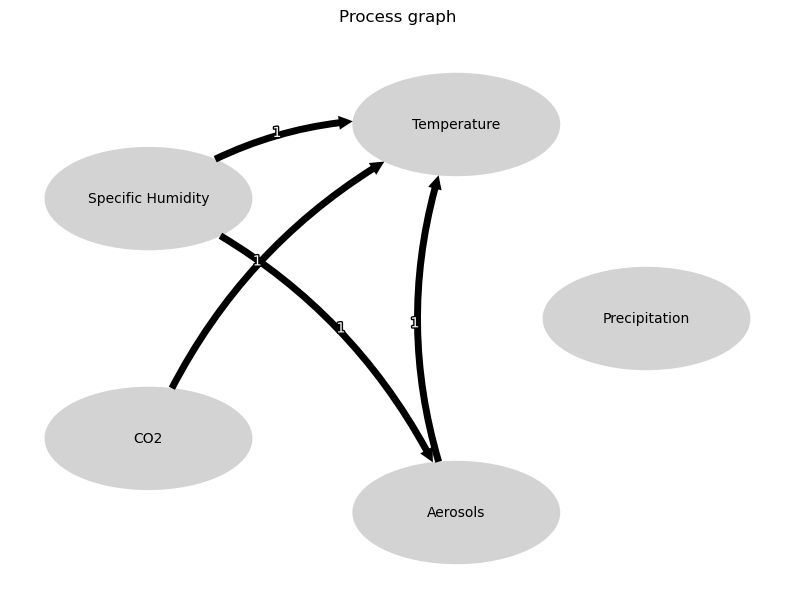


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





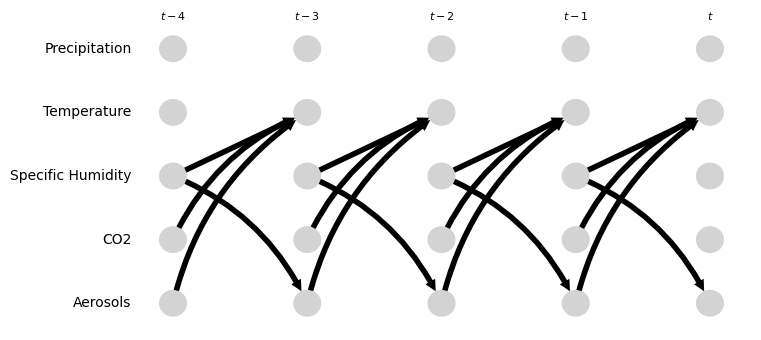

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.13 [-0.48, 0.05]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.75 [0.45, 0.93]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.20 [-0.43, 0.35]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.90 [0.18, 1.56]
Negative precipitation values in event 84: 0


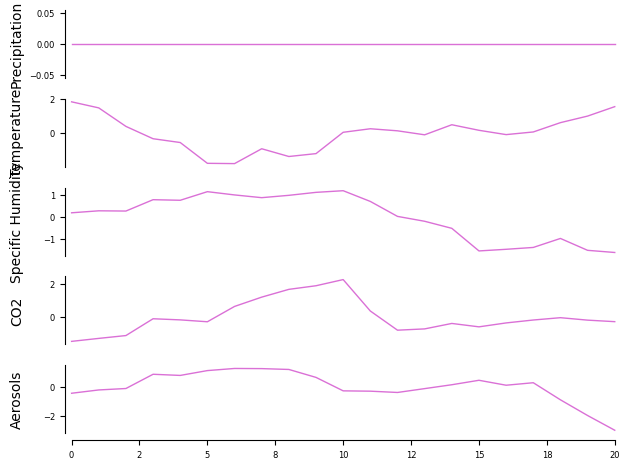

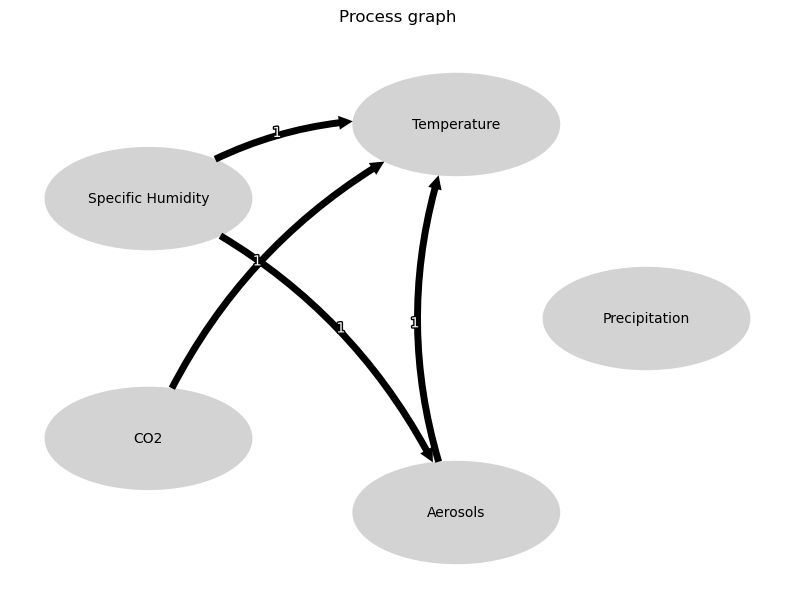


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





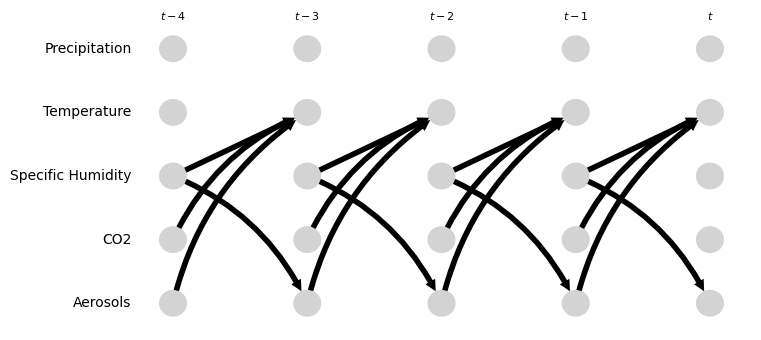

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.33 [0.13, 0.61]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.78 [-1.29, -0.73]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.44 [-0.65, -0.23]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.61 [0.11, 0.77]
Negative precipitation values in event 85: 0


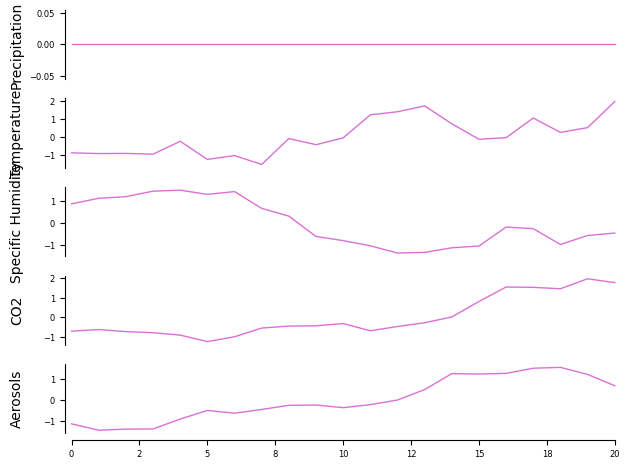

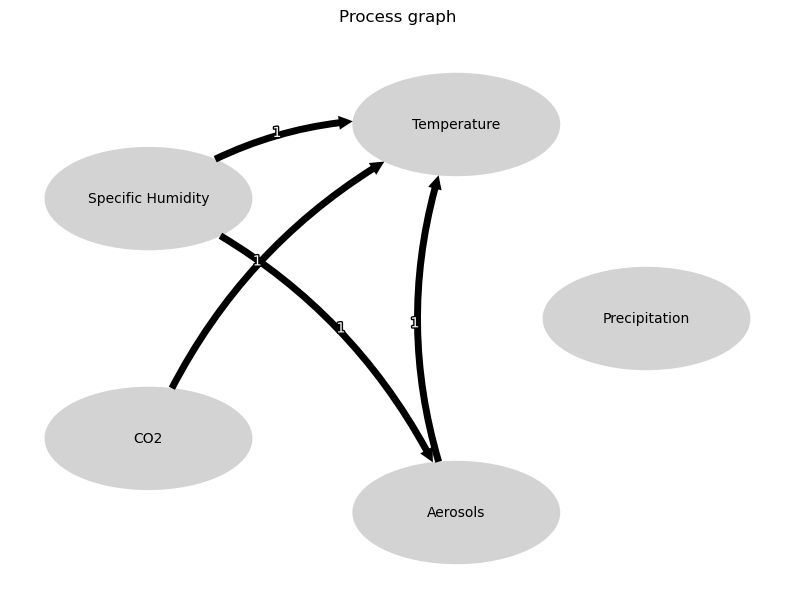


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





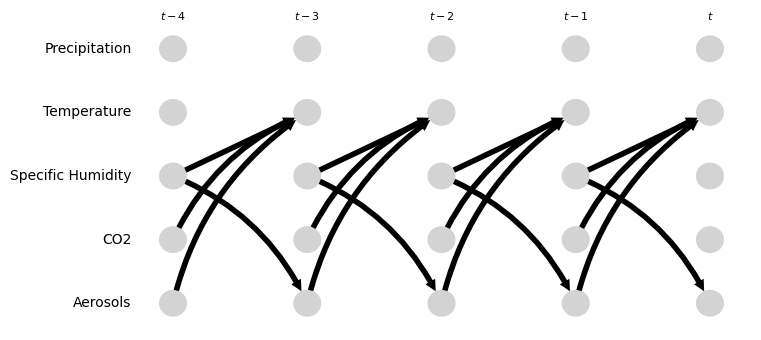

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.16 [0.31, 1.35]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.36 [-1.82, -0.59]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.01 [-1.27, -0.67]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.53 [-0.72, -0.34]
Negative precipitation values in event 86: 0


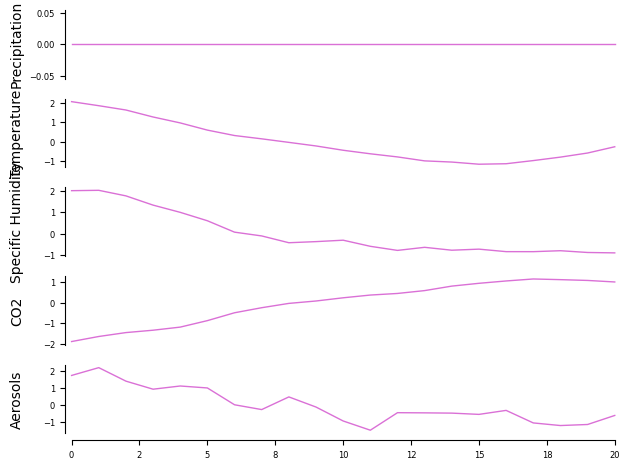

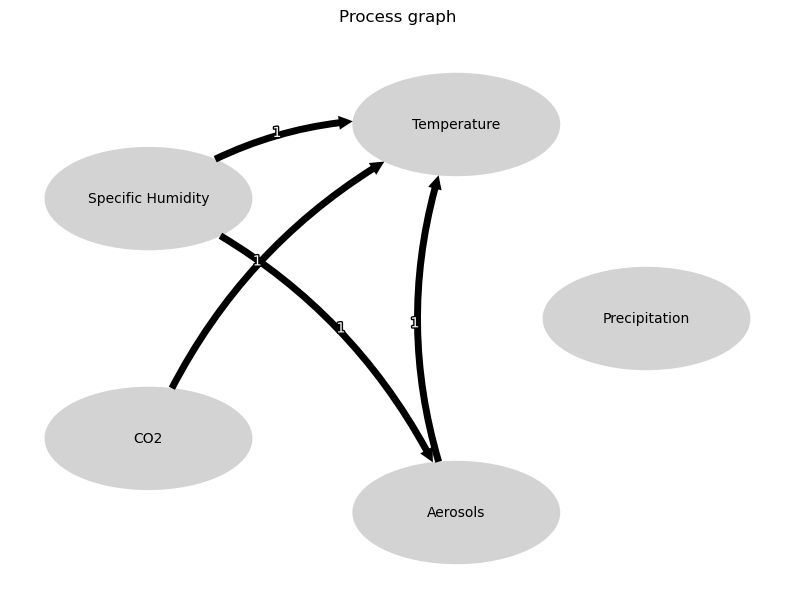


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





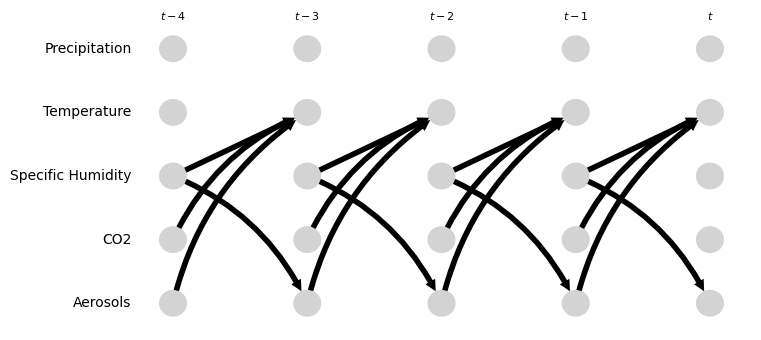

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.11 [-0.66, 0.35]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.07 [-0.30, 0.14]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.78 [0.10, 1.44]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.80 [0.45, 1.03]
Negative precipitation values in event 87: 0


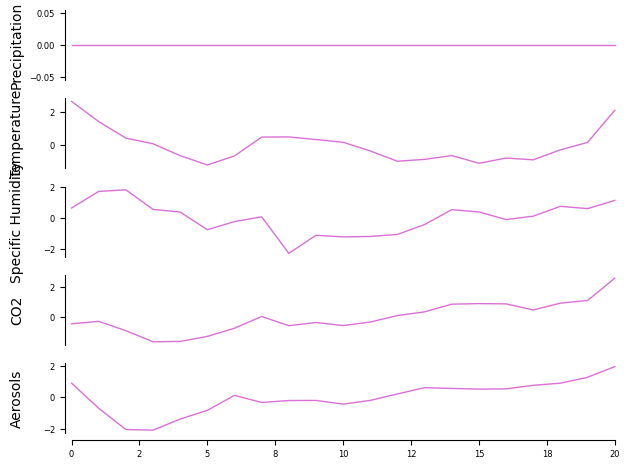

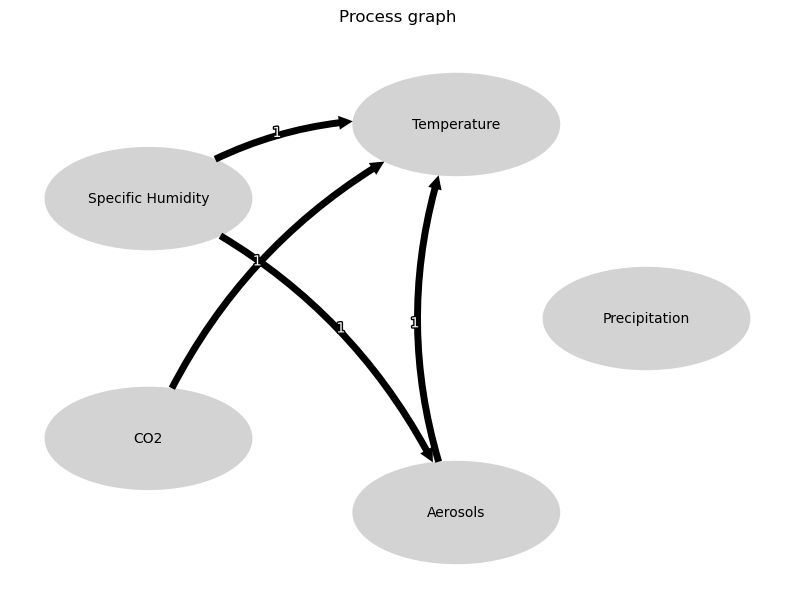


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





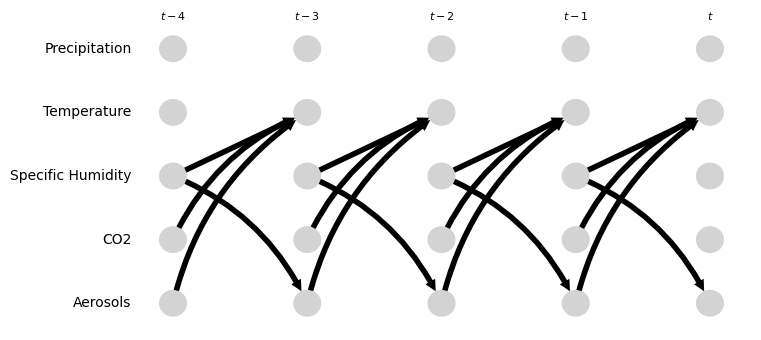

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.88 [-1.21, 0.51]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.44 [-1.05, 1.70]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.03 [-0.37, 0.47]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.38 [0.01, 0.46]
Negative precipitation values in event 88: 0


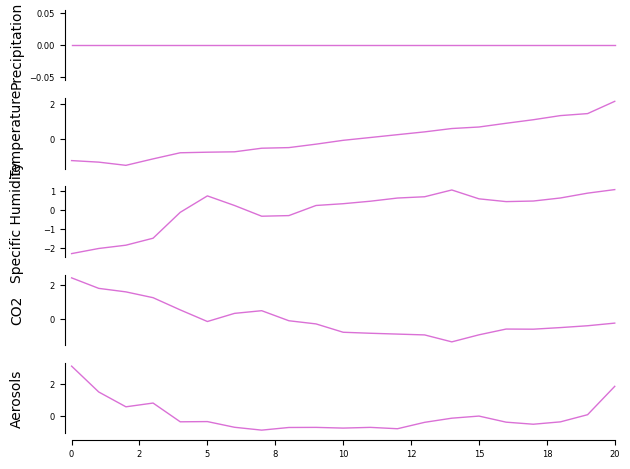

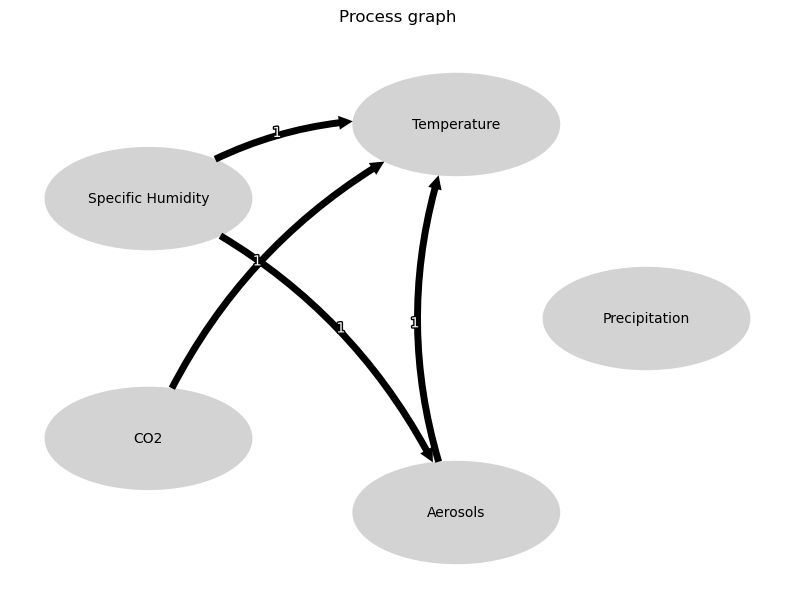


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





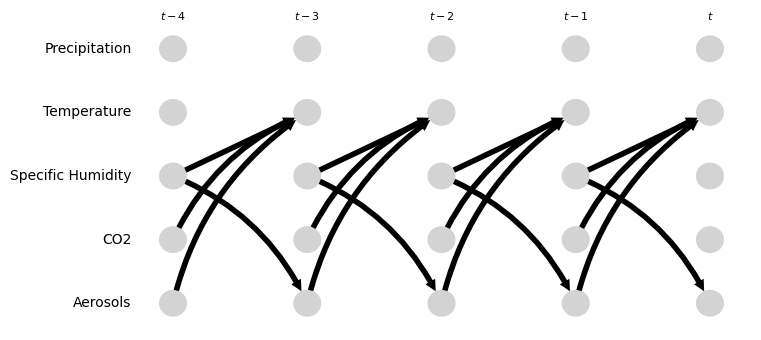

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.61 [-1.62, 0.02]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.24 [0.14, 2.27]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.13 [-1.53, 0.91]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.84 [0.16, 0.67]
Negative precipitation values in event 89: 0


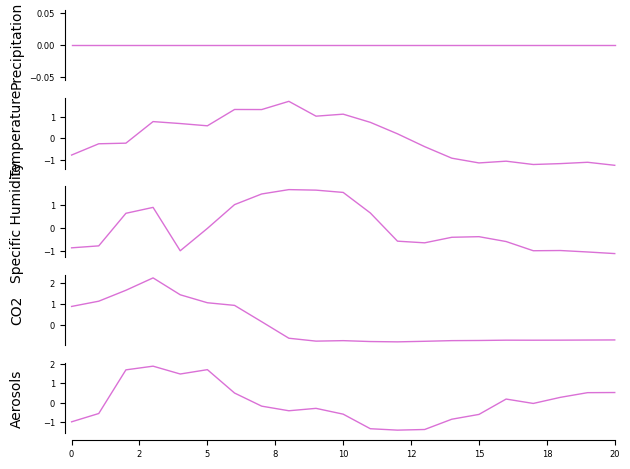

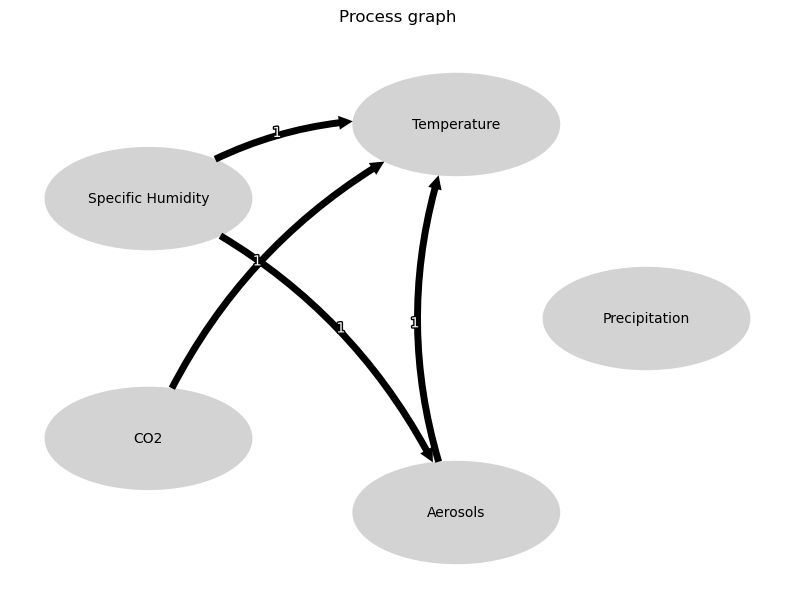


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





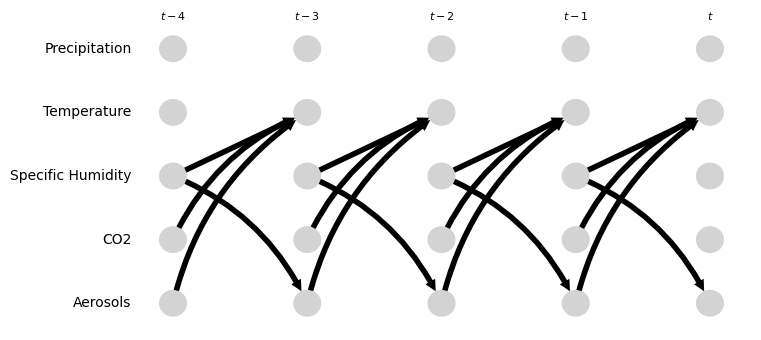

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.86 [0.56, 1.24]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.04 [-0.30, 0.29]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.82 [0.73, 0.95]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.38 [-0.64, -0.04]
Negative precipitation values in event 90: 0


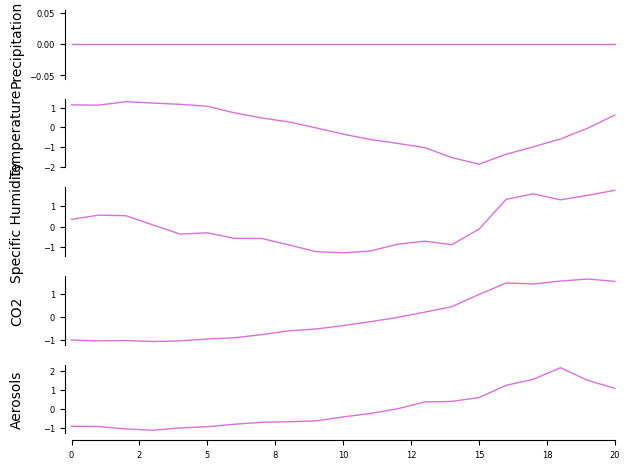

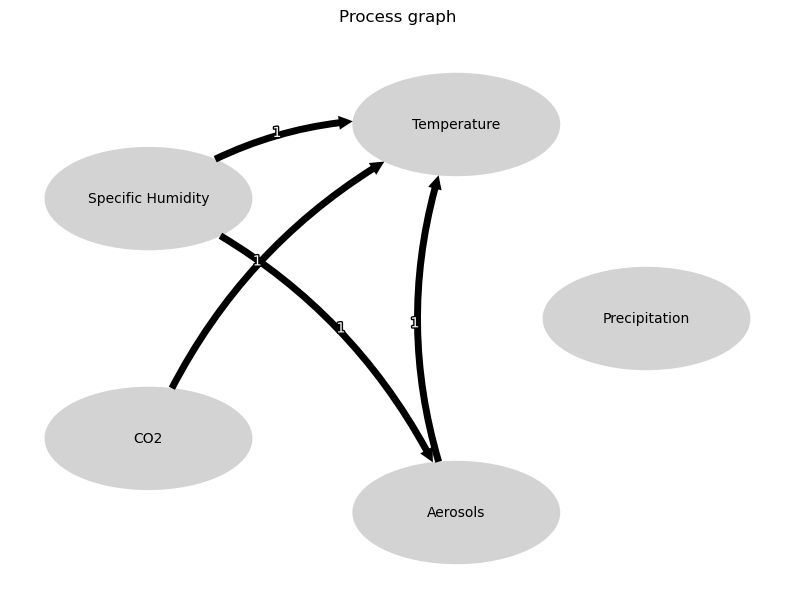


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





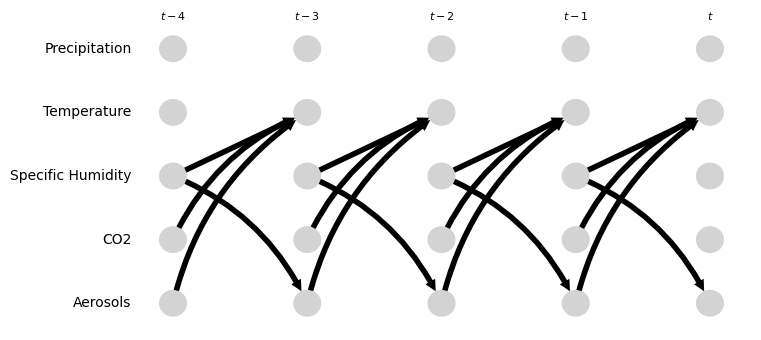

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.39 [-2.78, 0.15]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.11 [-1.65, 1.34]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.10 [0.70, 1.19]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.72 [0.61, 0.96]
Negative precipitation values in event 91: 0


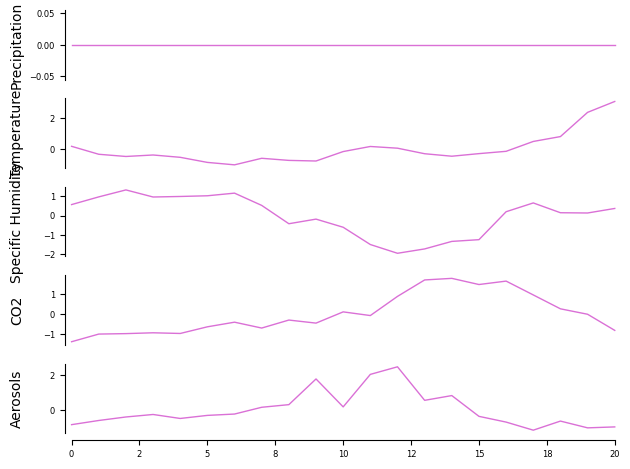

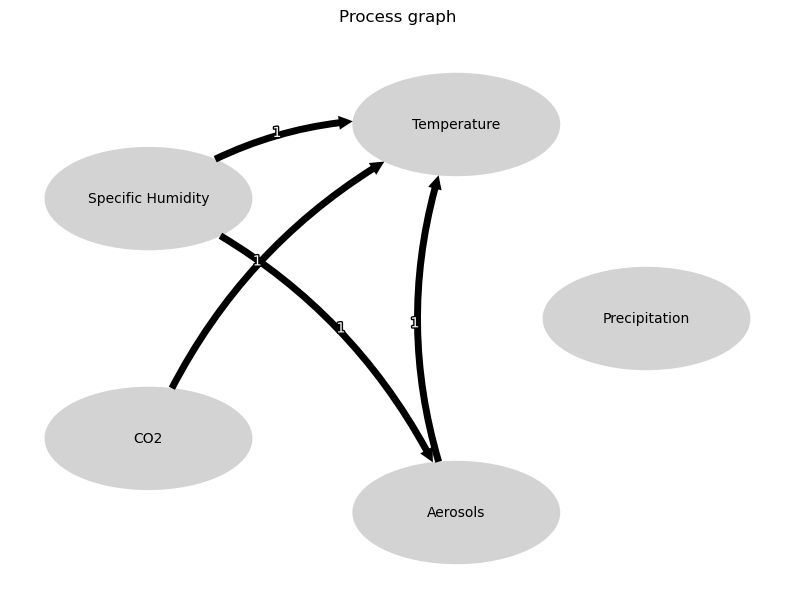


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





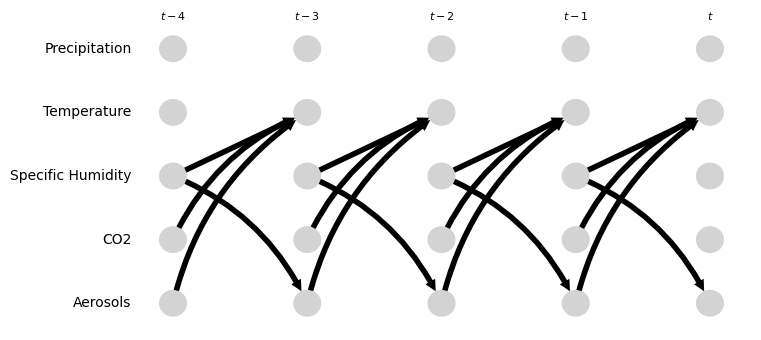

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.21 [-0.37, 0.63]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.79 [-1.26, 0.24]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.62 [-1.24, 0.48]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.46 [-0.81, -0.12]
Negative precipitation values in event 92: 0


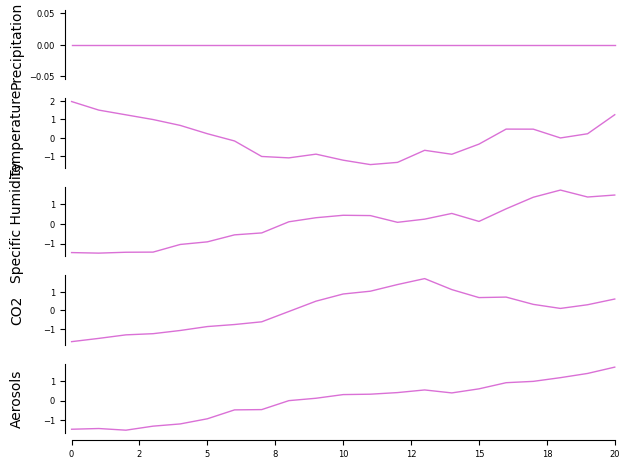

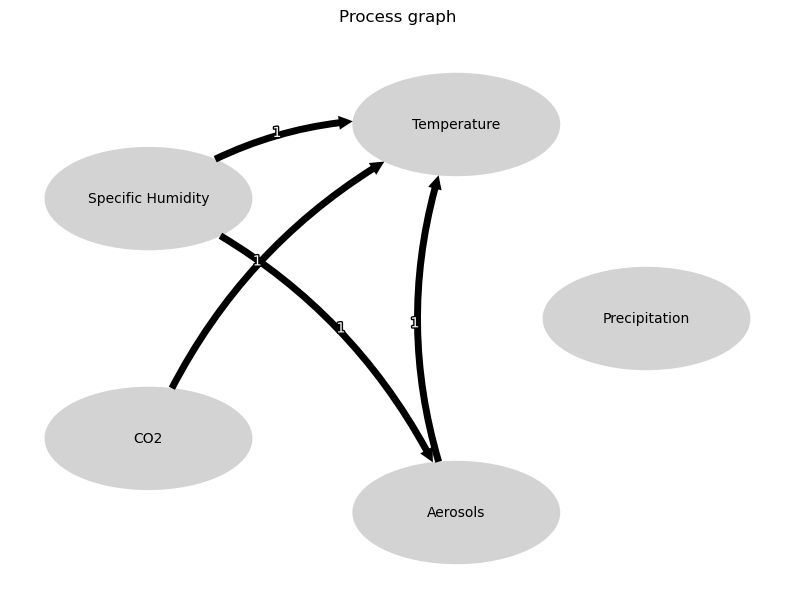


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





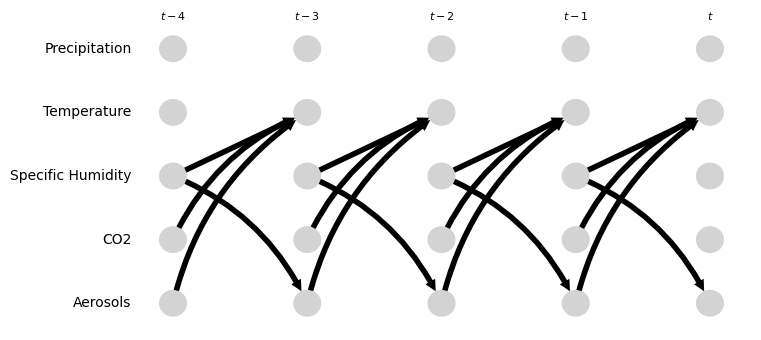

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.87 [-1.19, -0.15]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 2.22 [0.12, 3.20]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.19 [-2.06, 0.28]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.86 [0.69, 0.90]
Negative precipitation values in event 93: 0


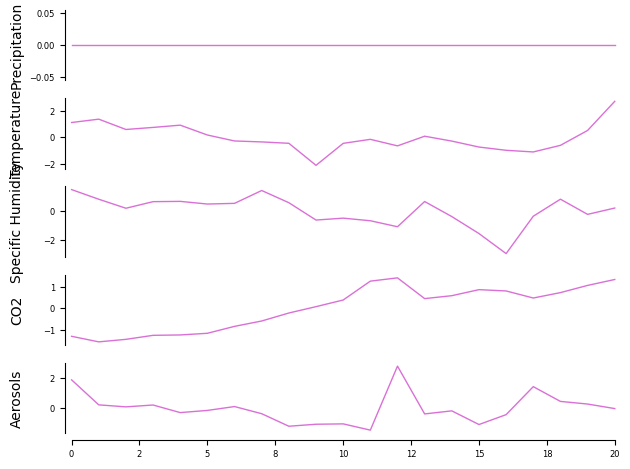

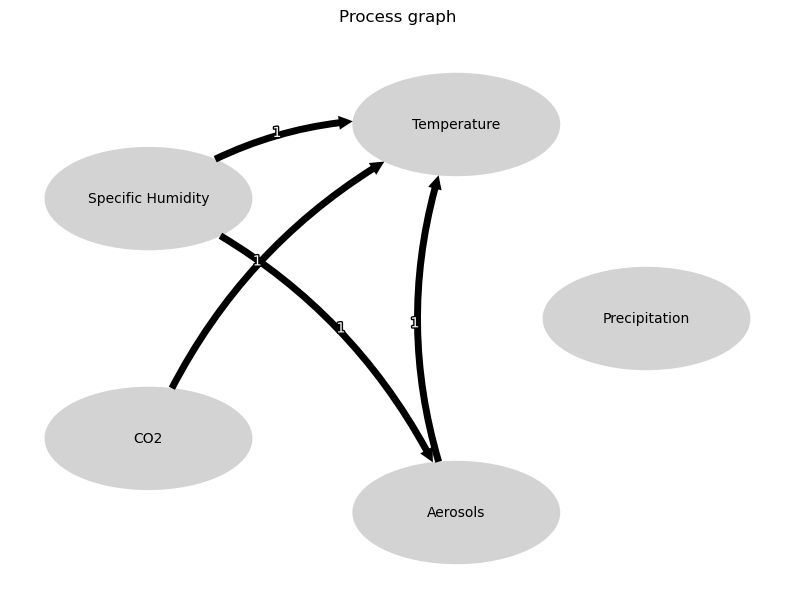


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





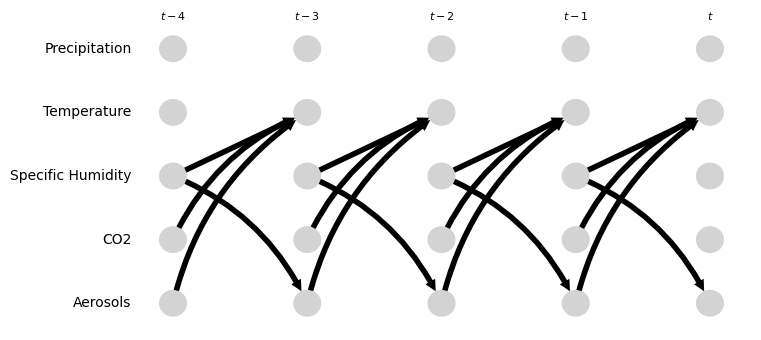

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.39 [-0.28, 0.38]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.26 [0.10, 0.62]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.34 [-0.17, 0.43]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.36 [-0.57, 0.14]
Negative precipitation values in event 94: 0


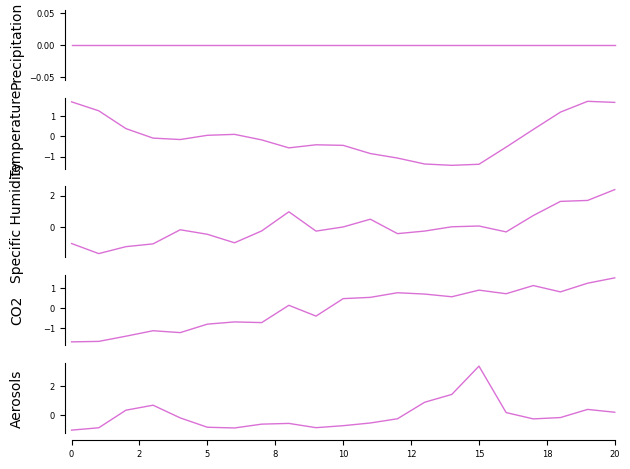

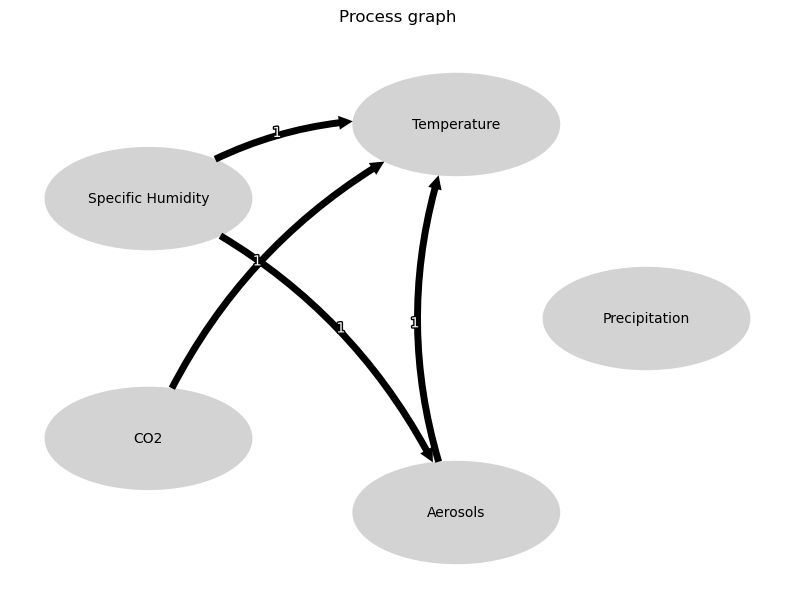


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





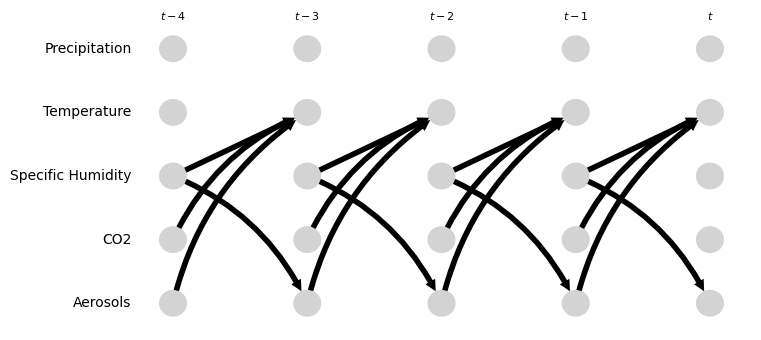

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.24 [-0.76, 0.59]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.10 [-0.76, 0.17]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.01 [-0.10, 1.32]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.08 [-0.58, 0.56]
Negative precipitation values in event 95: 0


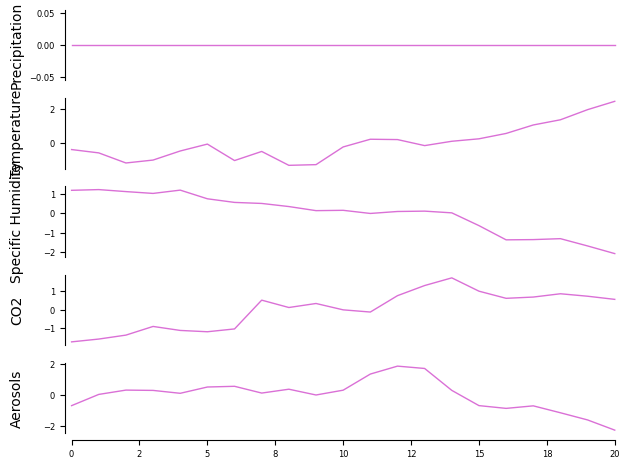

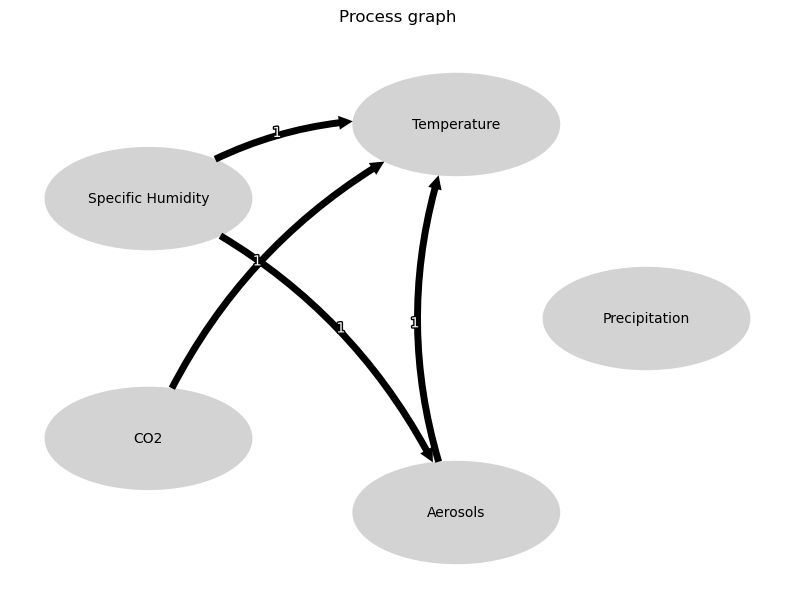


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





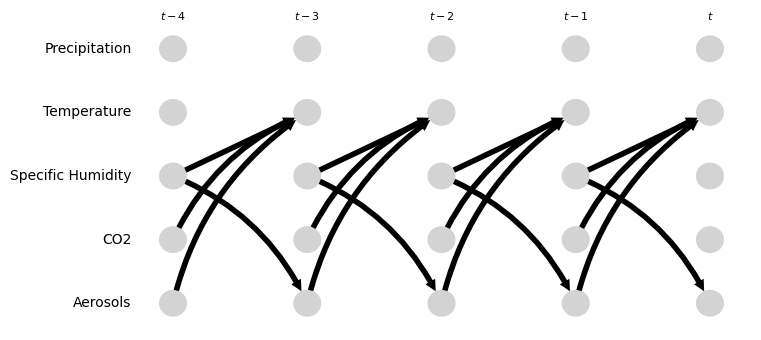

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.10 [-0.48, 0.15]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.06 [-0.31, 0.35]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.10 [-1.70, -0.51]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.98 [0.58, 1.18]
Negative precipitation values in event 96: 0


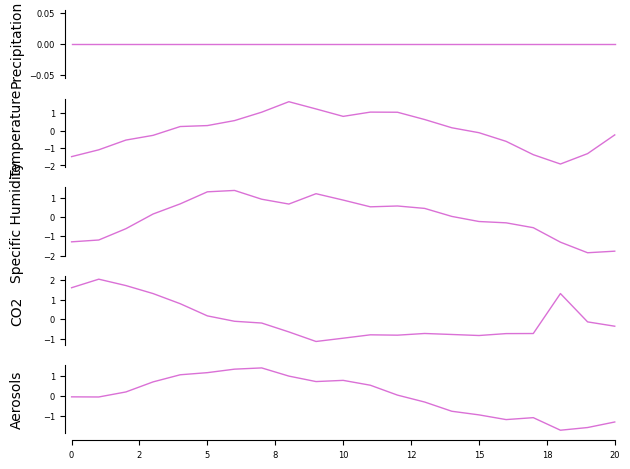

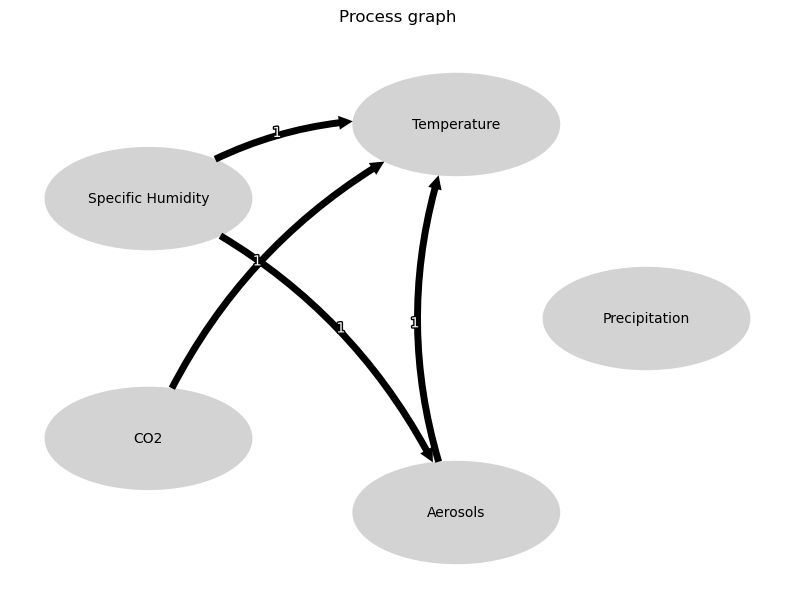


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





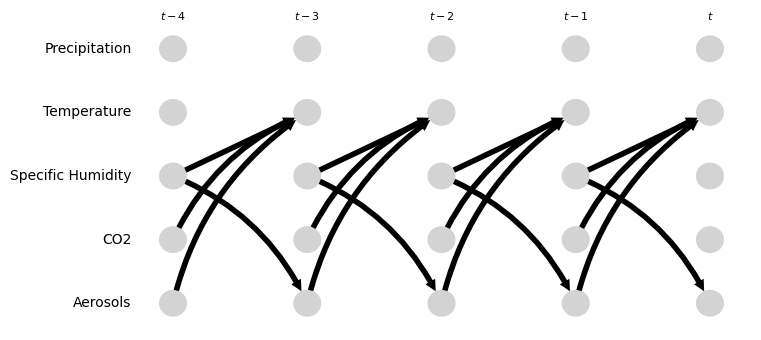

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.39 [-0.93, 0.13]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.33 [0.49, 1.52]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.70 [-0.93, 0.73]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.04 [1.12, 1.73]
Negative precipitation values in event 97: 0


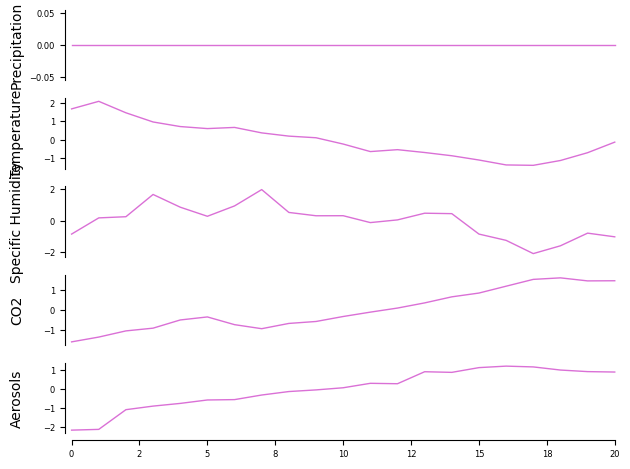

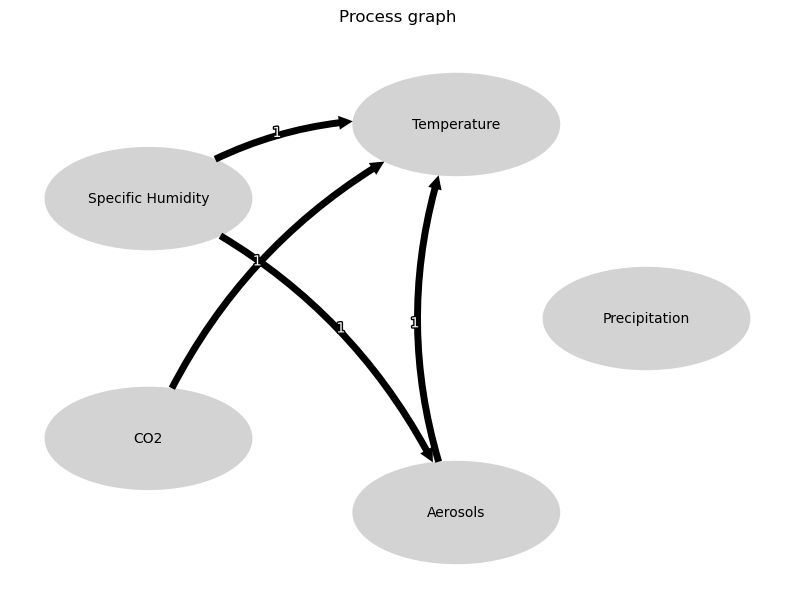


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





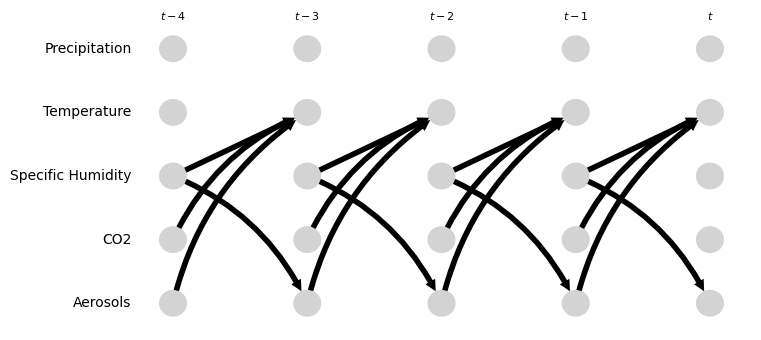

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.70 [0.03, 0.79]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.47 [-1.60, -1.02]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.19 [-0.11, 0.28]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.41 [-0.59, -0.29]
Negative precipitation values in event 98: 0


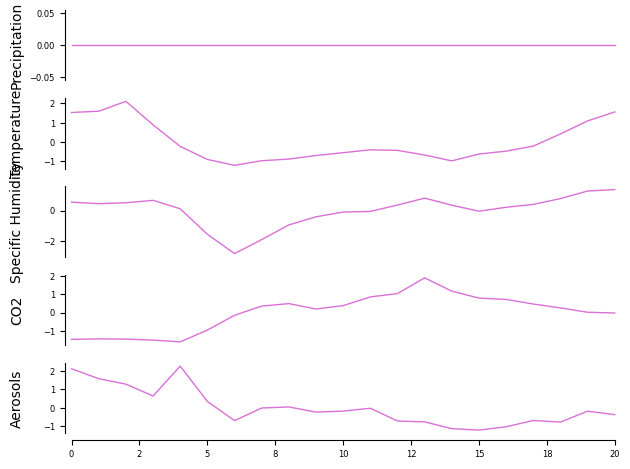

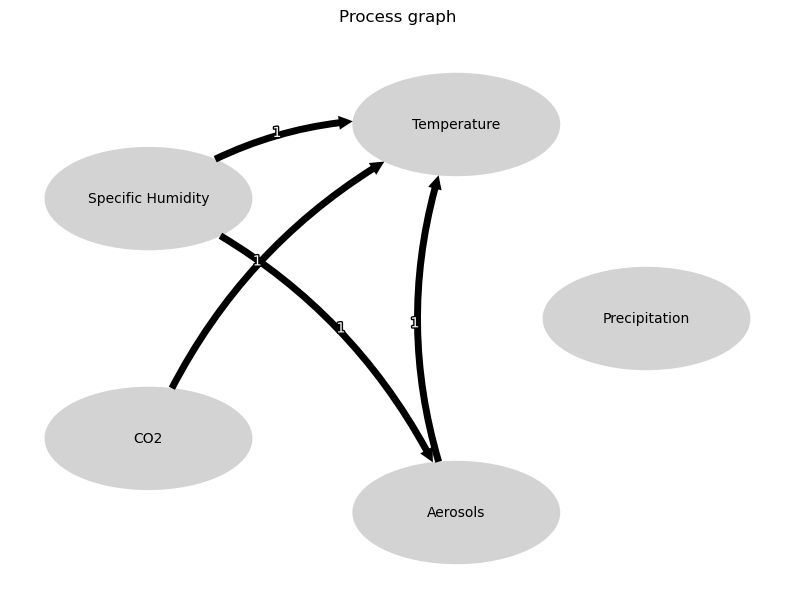


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





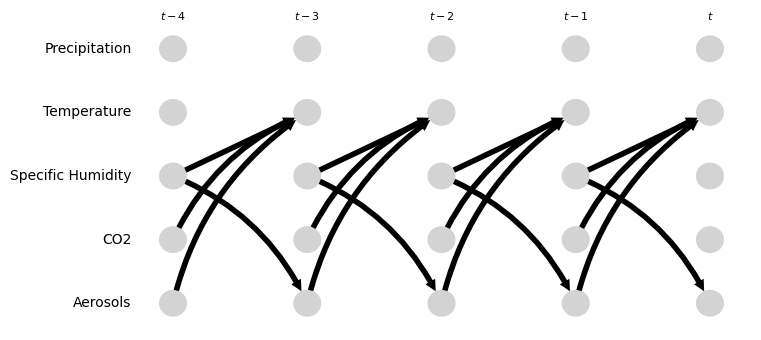

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.74 [-1.08, -0.02]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.67 [-0.84, -0.00]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.55 [0.18, 0.71]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.17 [-0.38, -0.06]
Negative precipitation values in event 99: 0


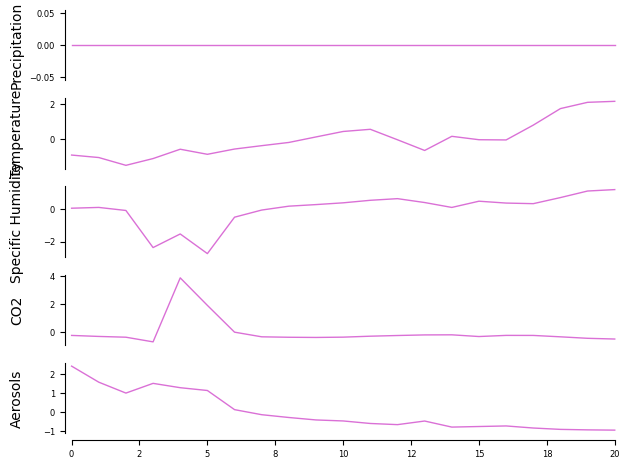

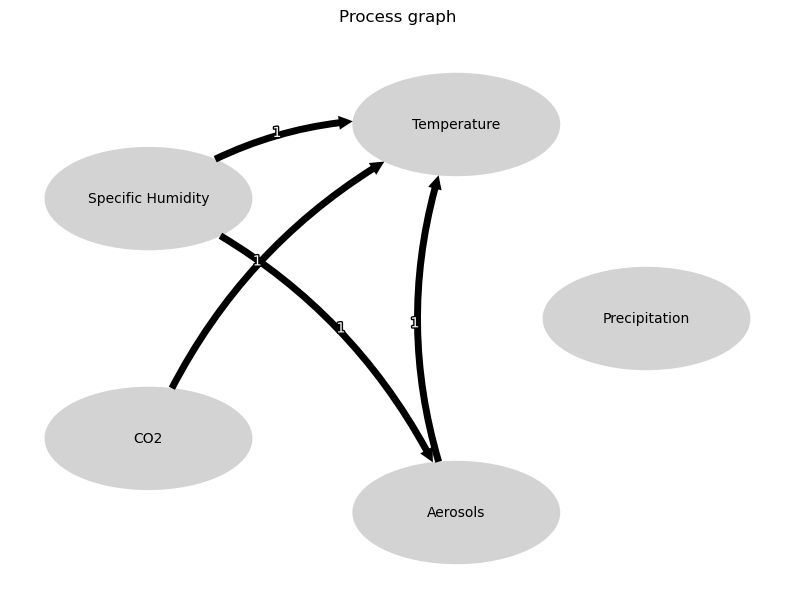


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





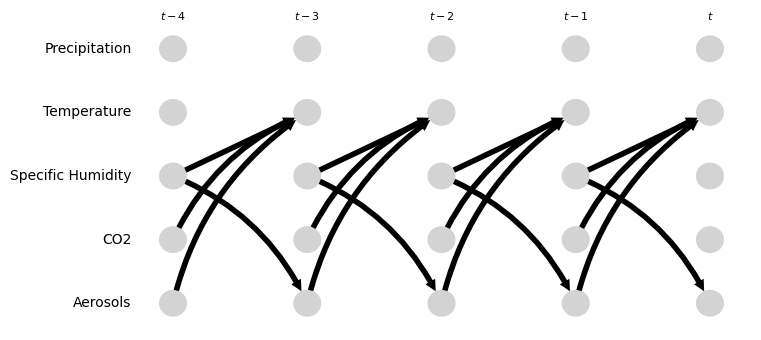

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.36 [-2.01, 1.69]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.75 [-4.65, -0.34]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.23 [-3.58, 1.53]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.43 [-0.86, -0.26]
Negative precipitation values in event 100: 0


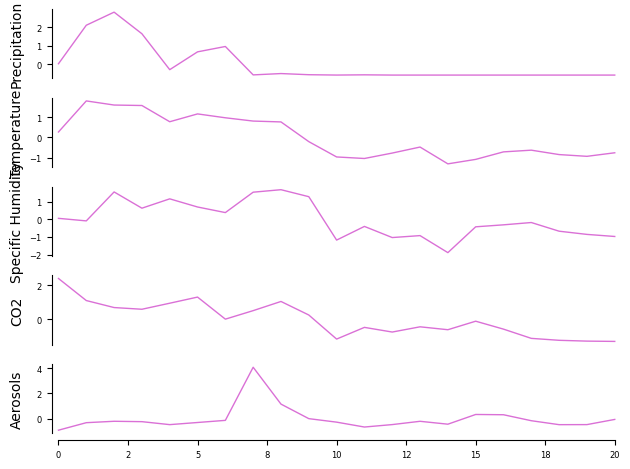

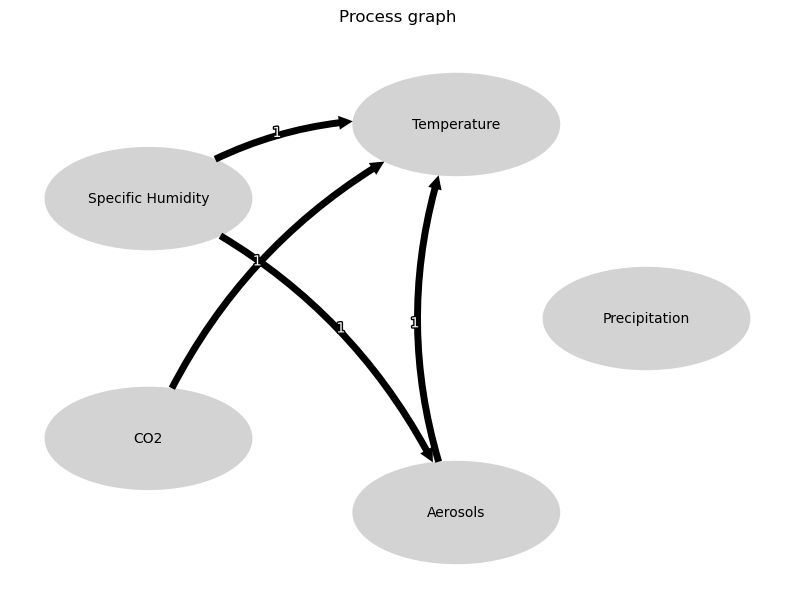


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





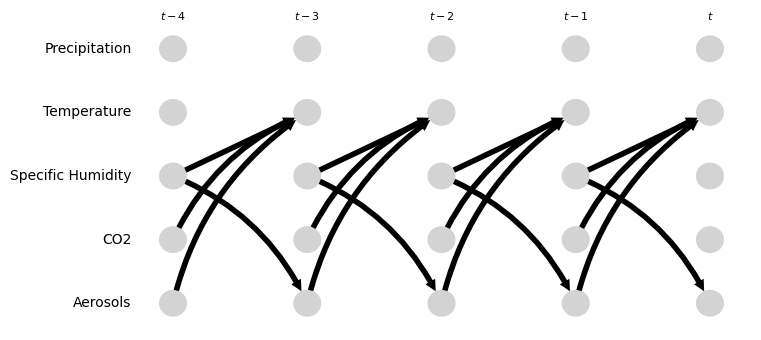

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.56 [0.02, 1.04]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.02 [-0.95, 0.27]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.13 [-0.38, 0.70]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.23 [-0.03, 0.60]
Negative precipitation values in event 101: 0


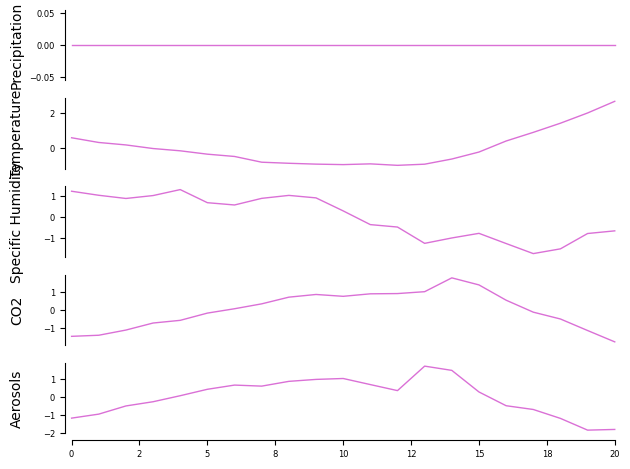

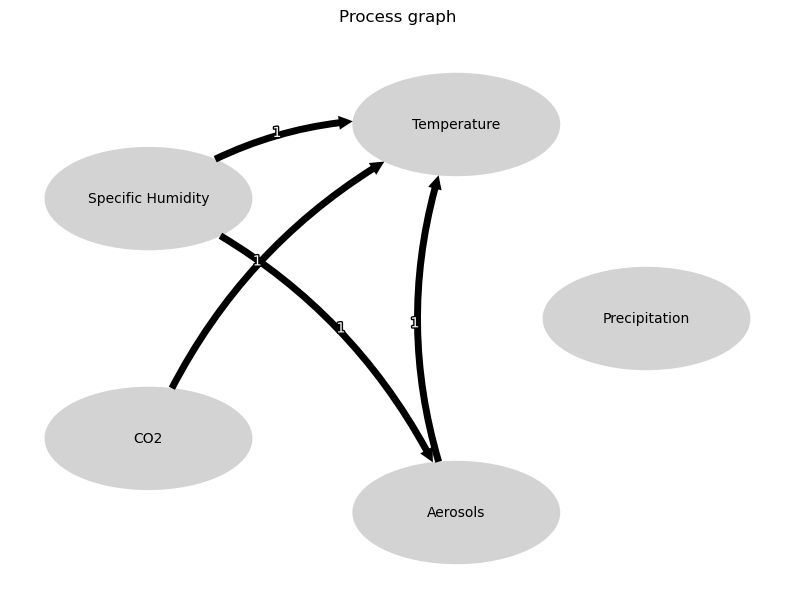


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





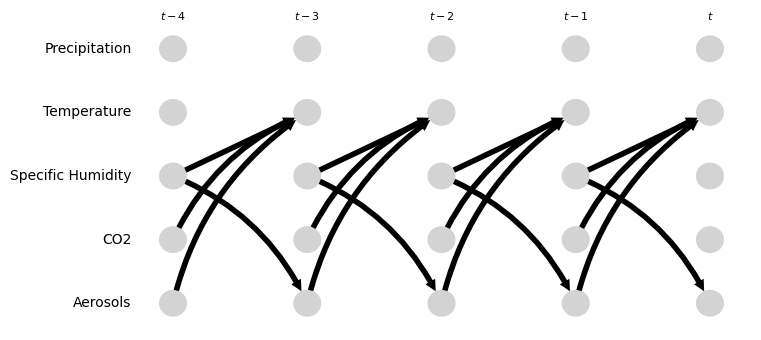

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.19 [-0.71, 0.37]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.77 [-1.51, -0.33]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.49 [-0.62, 0.03]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.61 [0.18, 0.90]
Negative precipitation values in event 102: 0


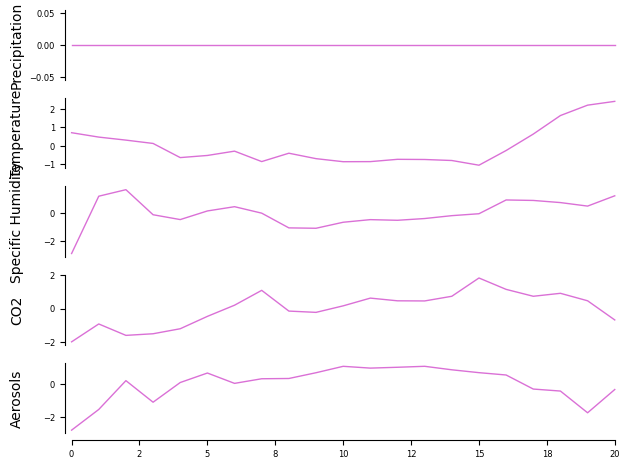

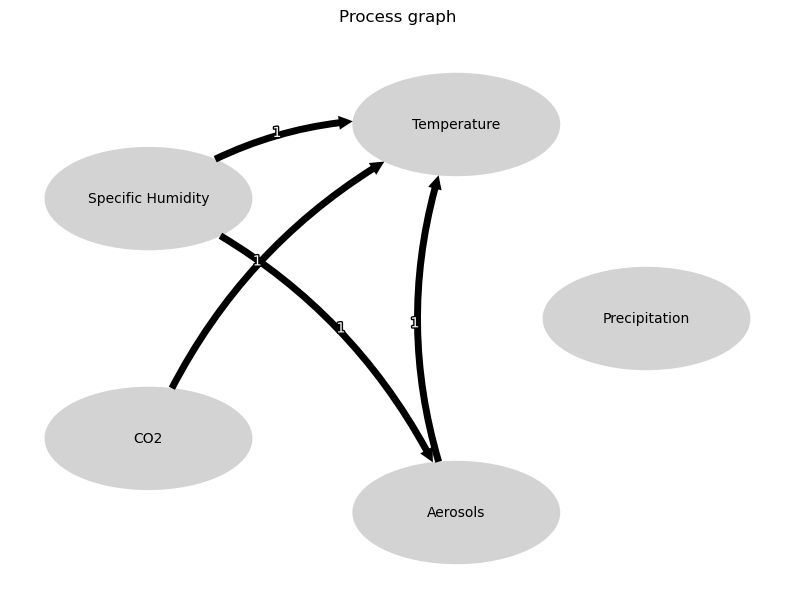


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





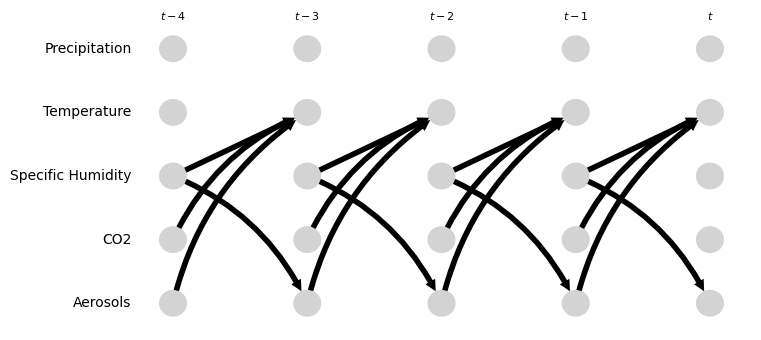

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.24 [-0.07, 0.63]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.05 [-1.72, -0.19]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.54 [-0.07, 0.79]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.92 [-1.39, -0.54]
Negative precipitation values in event 103: 0


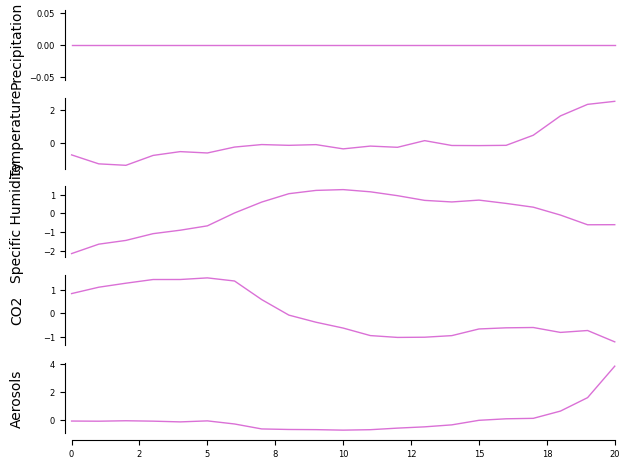

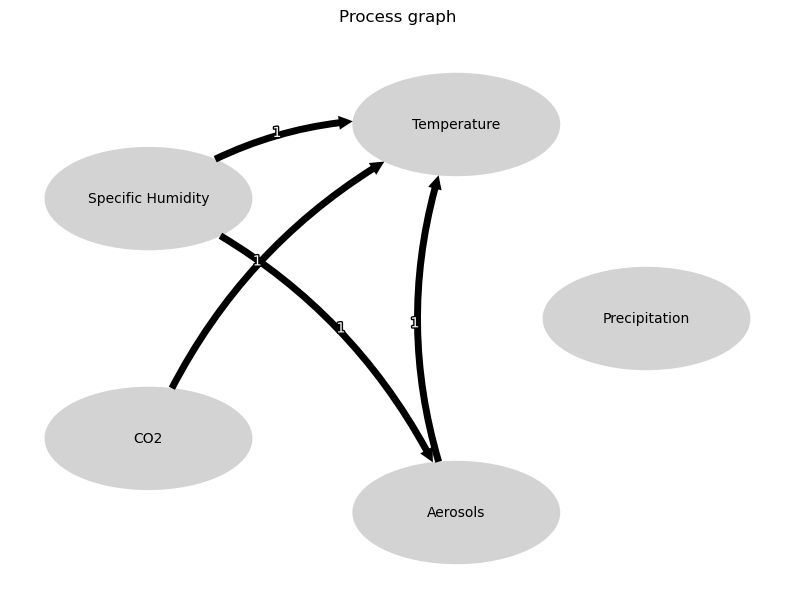


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





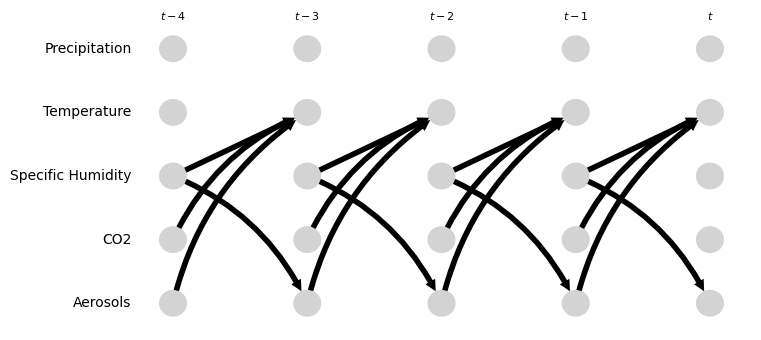

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.14 [-0.40, 0.20]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.62 [0.73, 3.13]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.36 [-0.34, 1.24]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.93 [-0.97, -0.14]
Negative precipitation values in event 104: 0


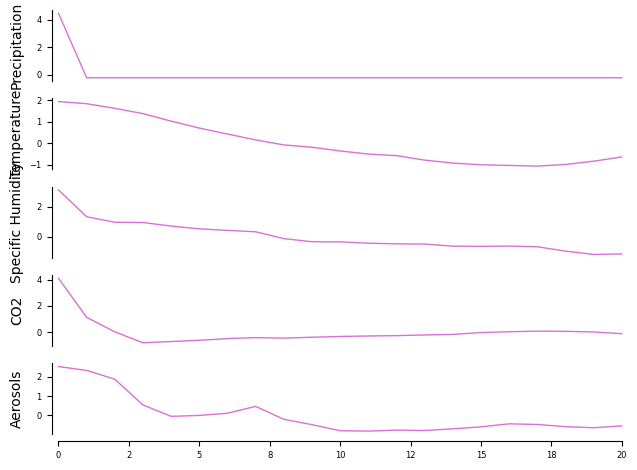

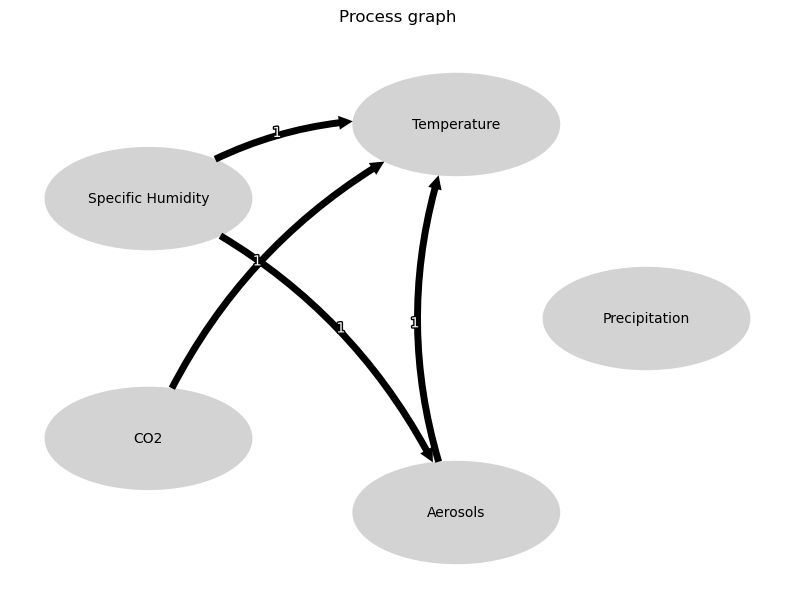


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





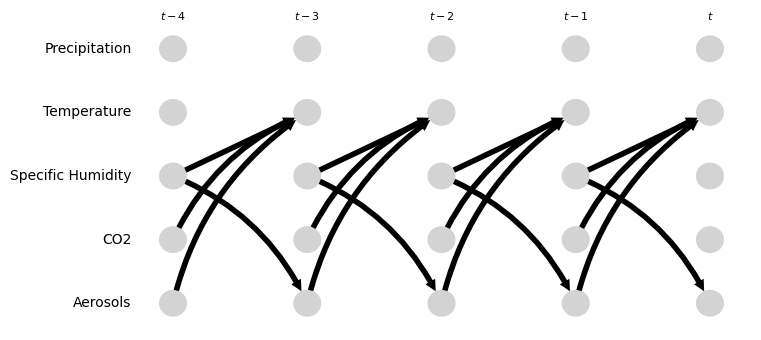

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.92 [-1.94, -0.40]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.55 [-0.27, 0.81]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.19 [-0.20, 1.16]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.50 [0.41, 0.81]
Negative precipitation values in event 105: 0


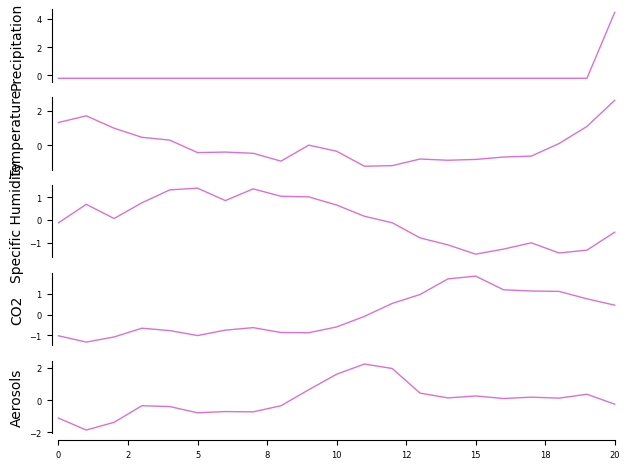

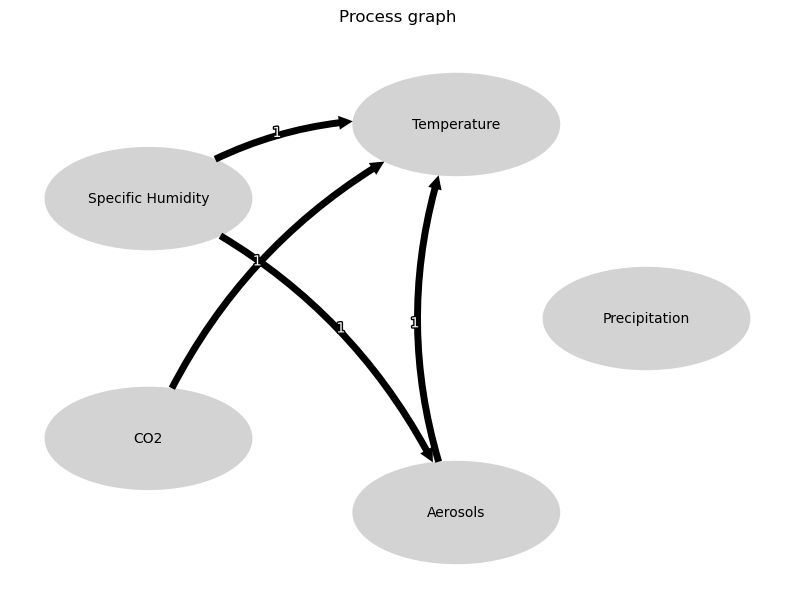


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





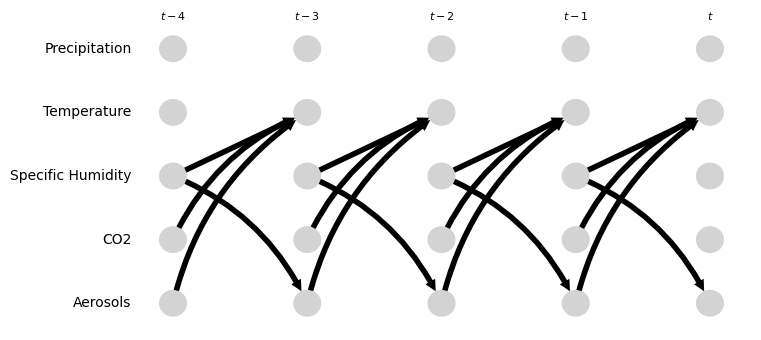

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -2.11 [-1.75, -0.33]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.41 [-0.47, -0.12]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -2.17 [-1.79, -0.28]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.00 [-0.24, 0.27]
Negative precipitation values in event 106: 0


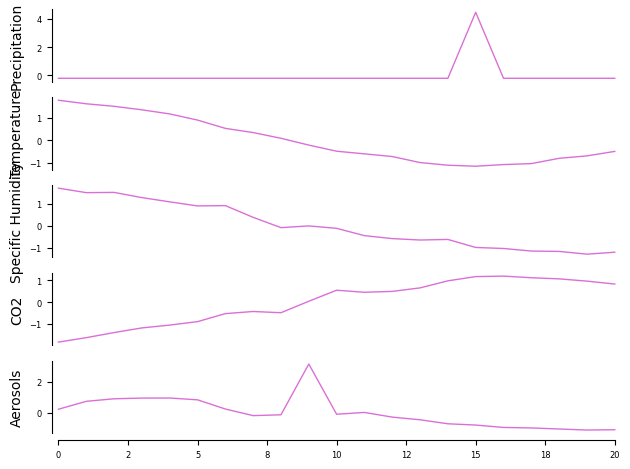

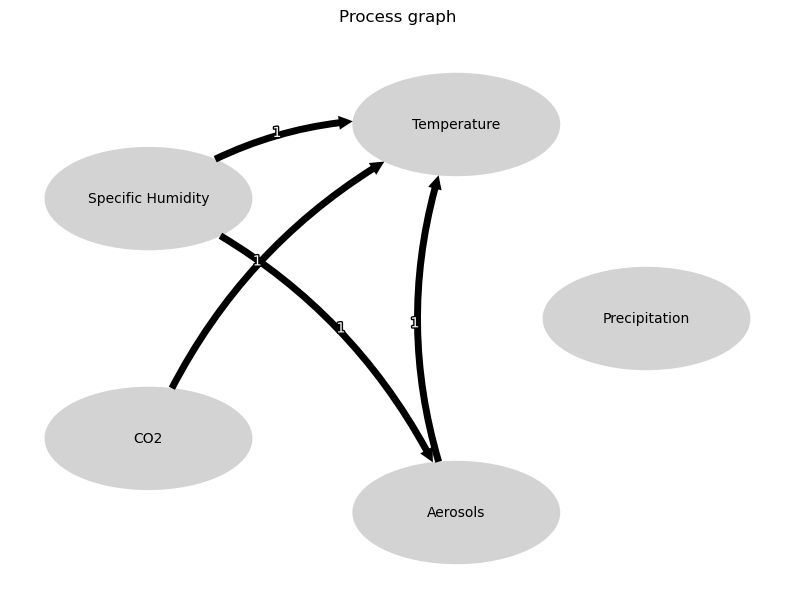


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





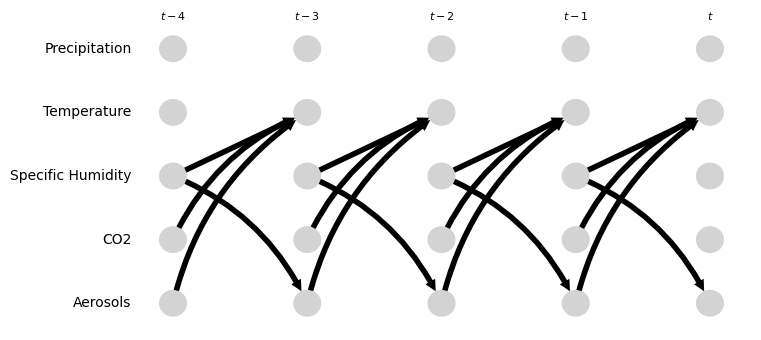

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.68 [-1.14, -0.22]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.09 [-0.53, -0.00]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.14 [-0.13, 0.70]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.74 [0.44, 1.16]
Negative precipitation values in event 107: 0


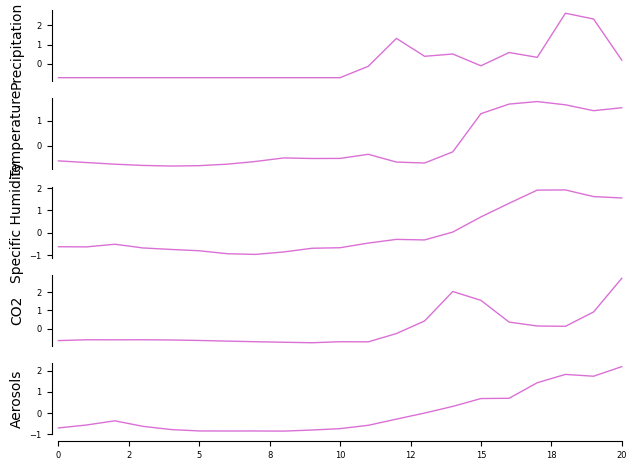

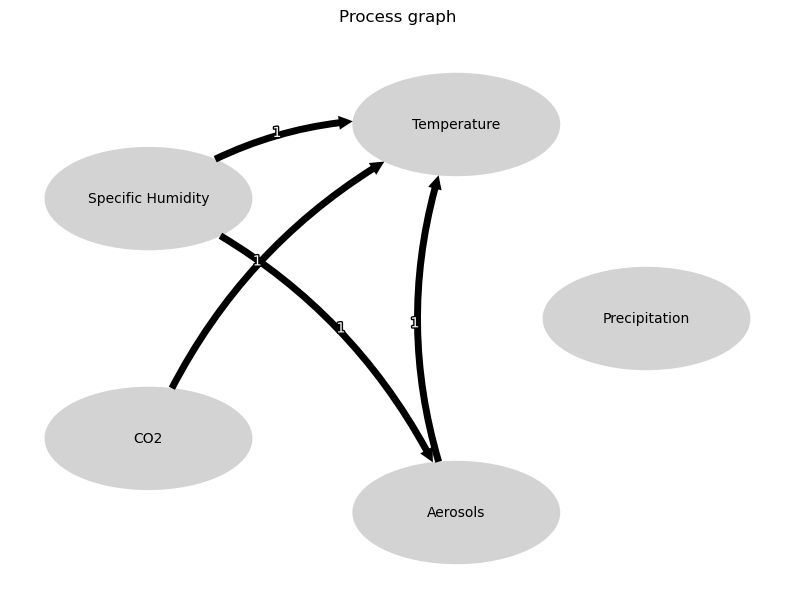


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





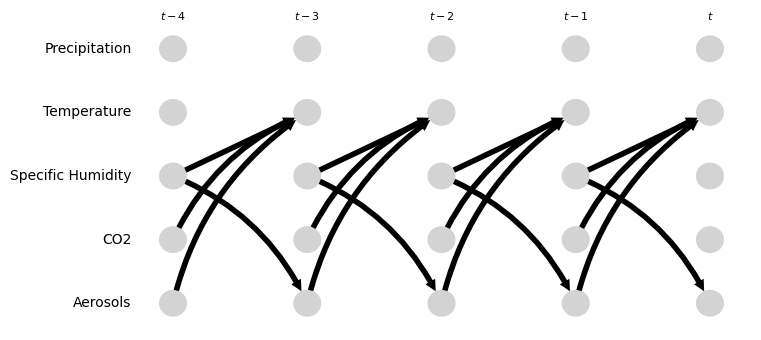

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.66 [0.14, 1.06]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.99 [-1.69, 0.08]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.51 [0.51, 2.03]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.01 [0.90, 1.03]
Negative precipitation values in event 108: 0


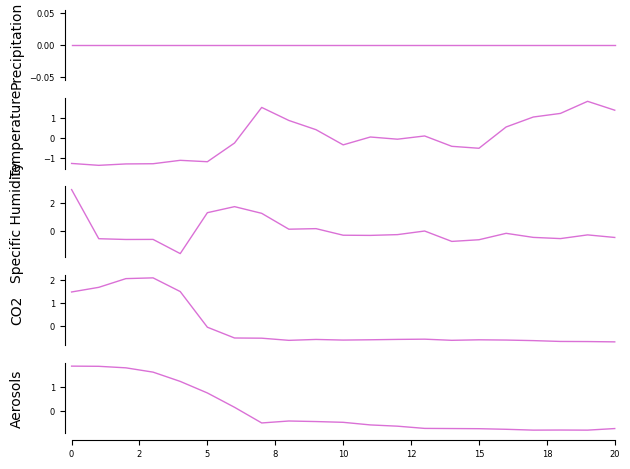

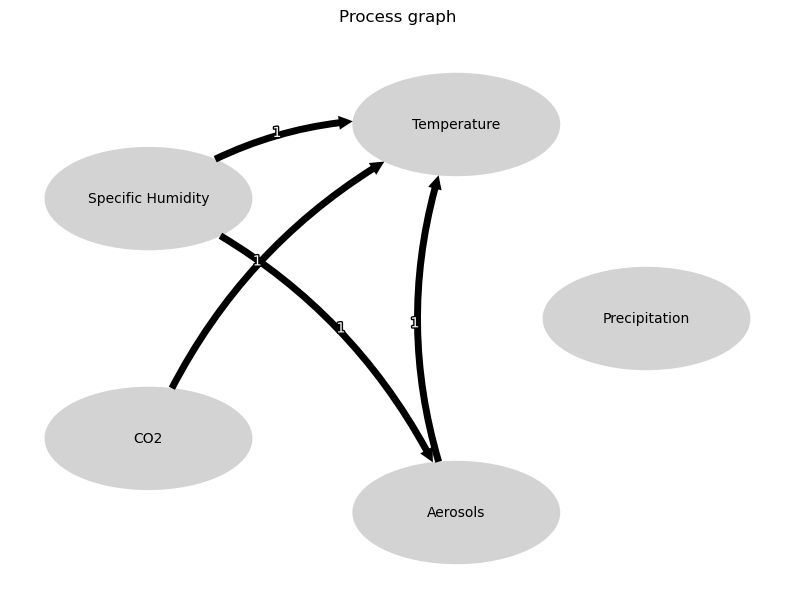


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





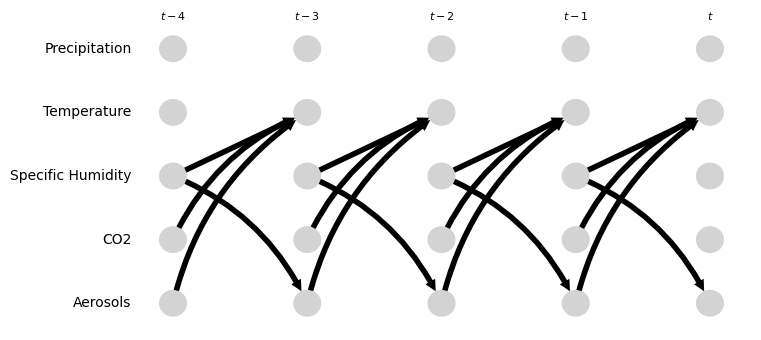

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.41 [-16.96, 5.00]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.05 [-5.00, 0.49]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.49 [0.03, 2.02]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.02 [-0.32, 0.37]
Negative precipitation values in event 109: 0


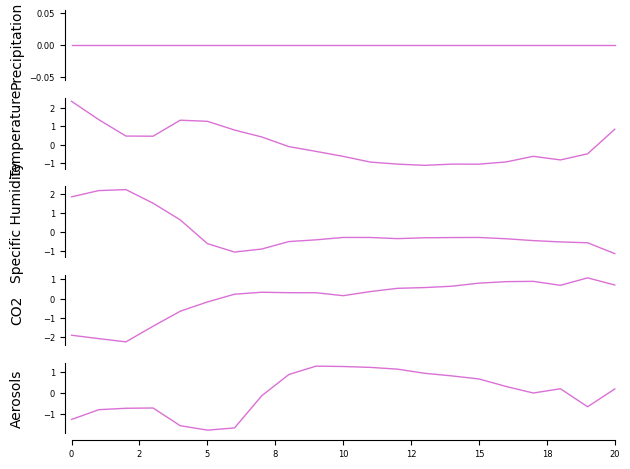

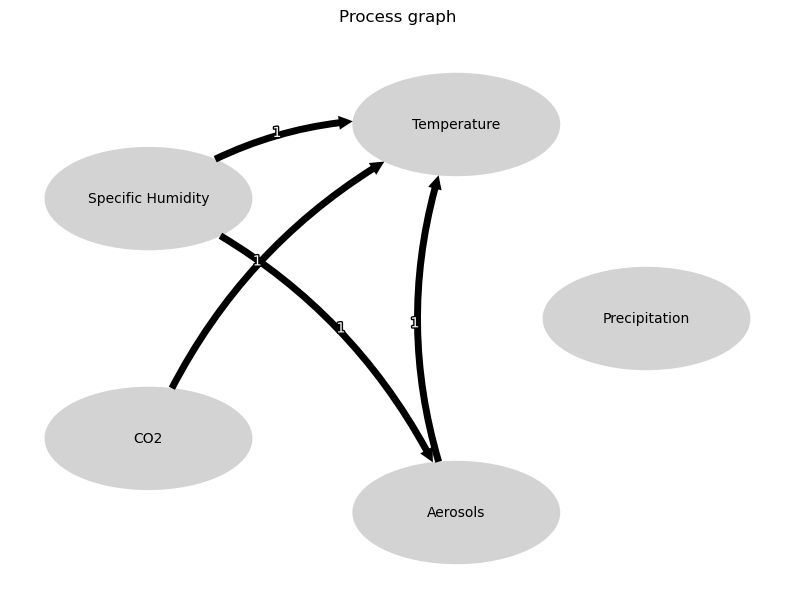


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





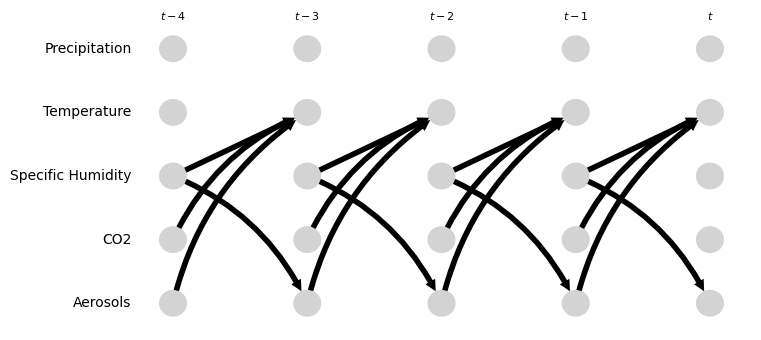

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.21 [-1.04, -0.17]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.62 [-0.56, -0.12]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.20 [-1.48, 0.18]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.74 [-1.55, 2.37]
Negative precipitation values in event 110: 0


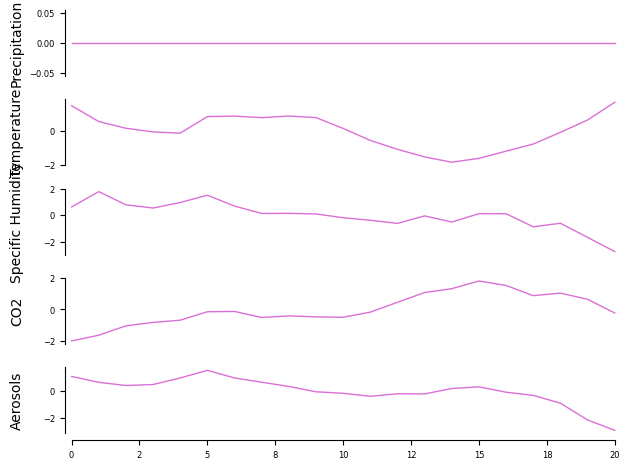

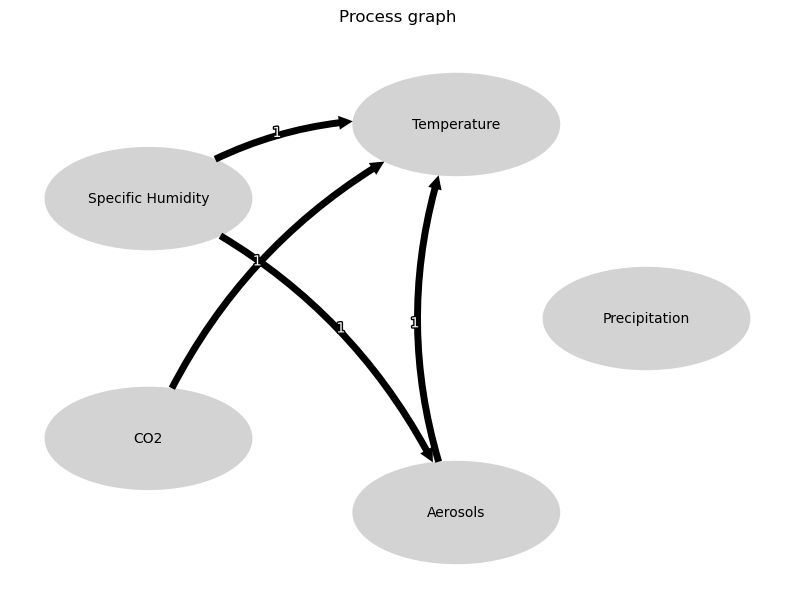


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





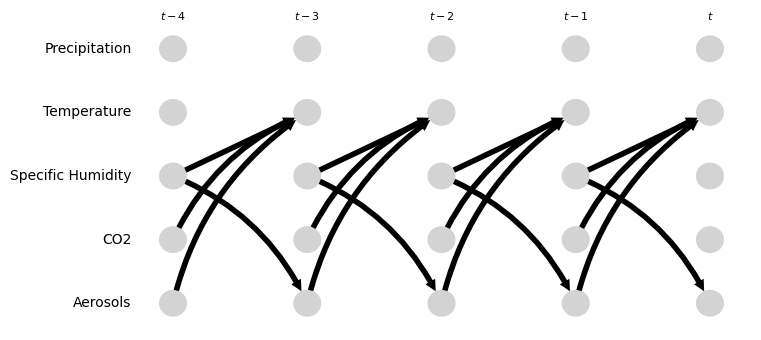

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.69 [-0.87, -0.13]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.95 [-1.43, 1.90]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.88 [-0.75, 1.81]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.19 [0.58, 1.39]
Negative precipitation values in event 111: 0


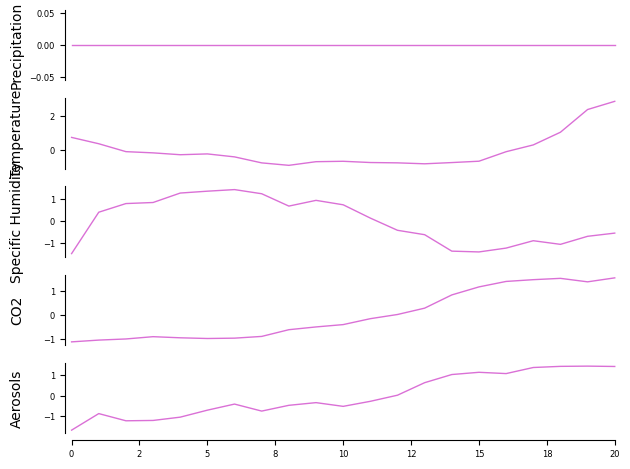

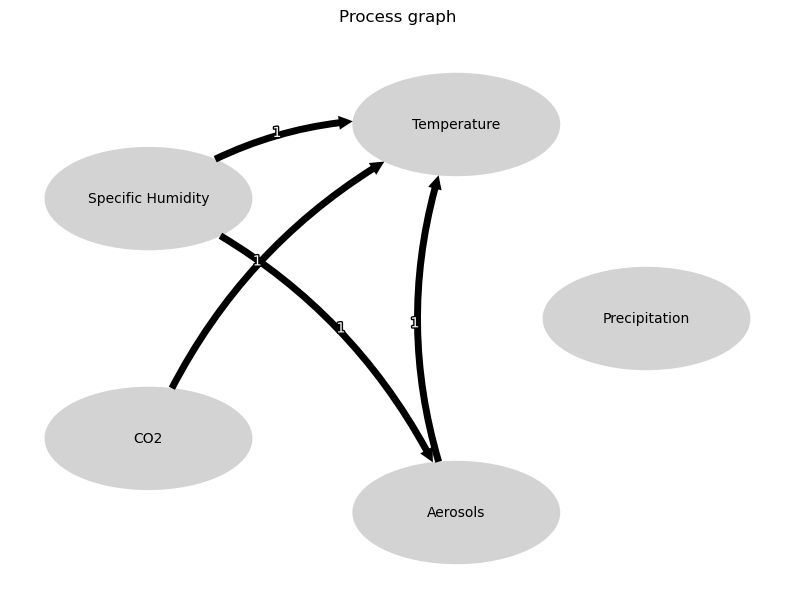


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





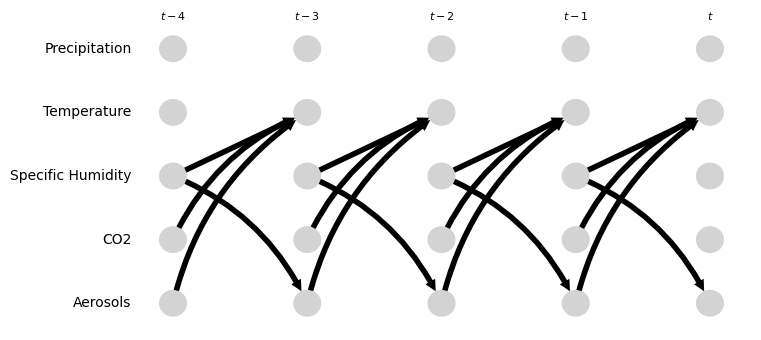

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 2.29 [1.07, 3.03]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.44 [-0.62, 1.30]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.79 [0.75, 2.03]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.78 [-0.87, -0.68]
Negative precipitation values in event 112: 0


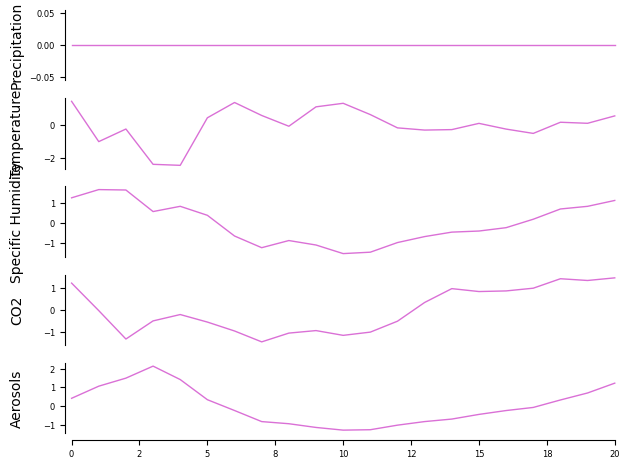

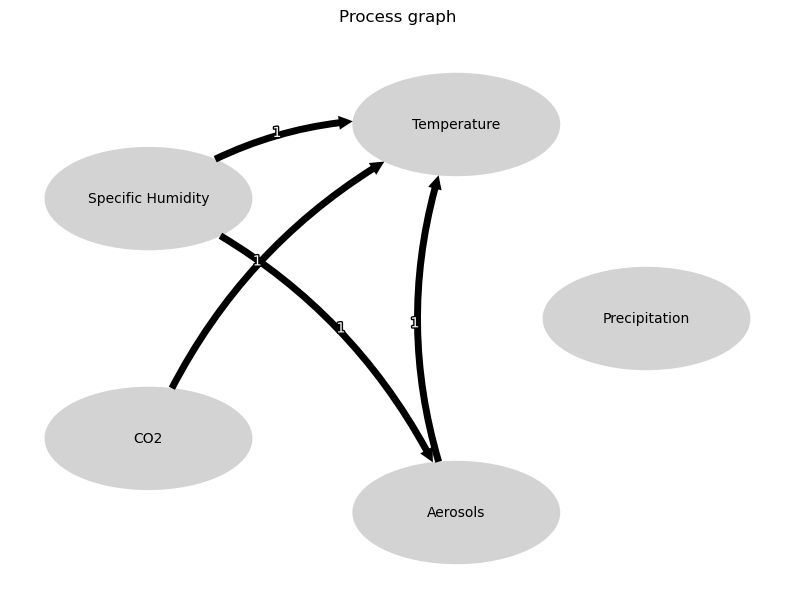


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





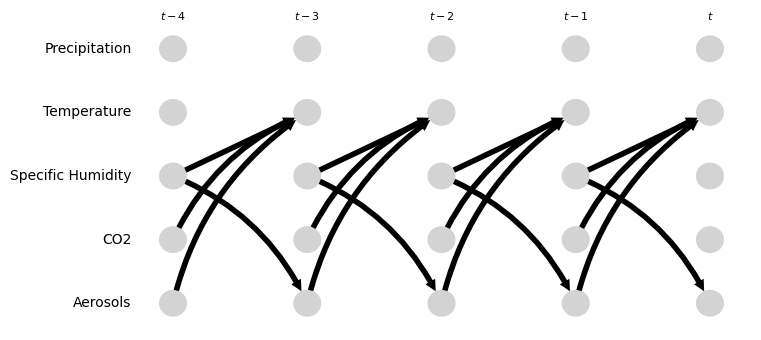

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.87 [-1.14, -0.67]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.50 [-2.83, -0.60]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 2.21 [1.35, 3.43]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.86 [0.65, 0.90]
Negative precipitation values in event 113: 0


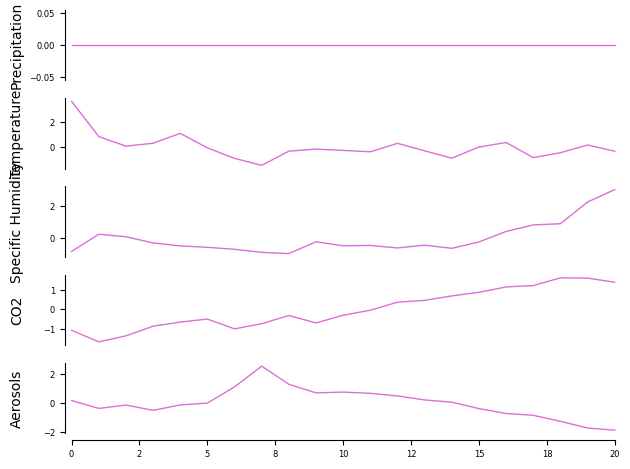

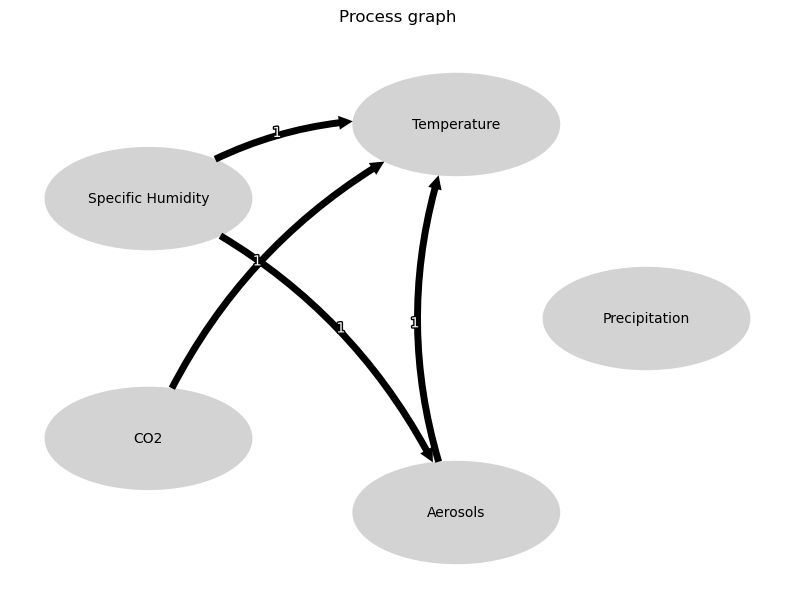


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





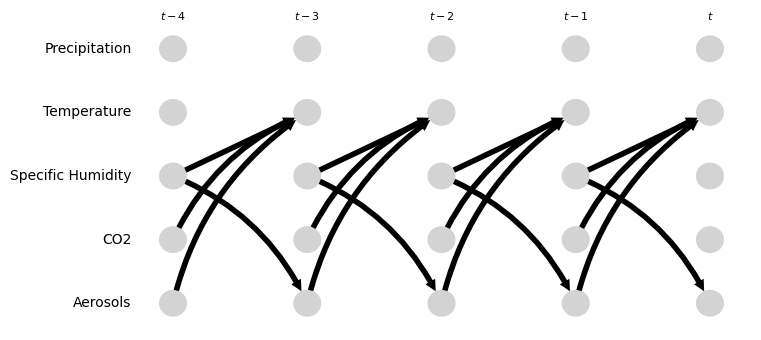

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.34 [-0.06, 0.96]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.05 [-0.46, 0.44]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.18 [-0.84, 0.32]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.09 [-1.85, -1.17]
Negative precipitation values in event 114: 0


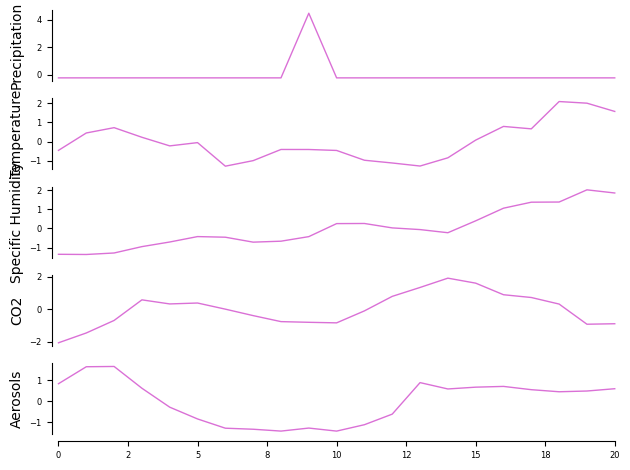

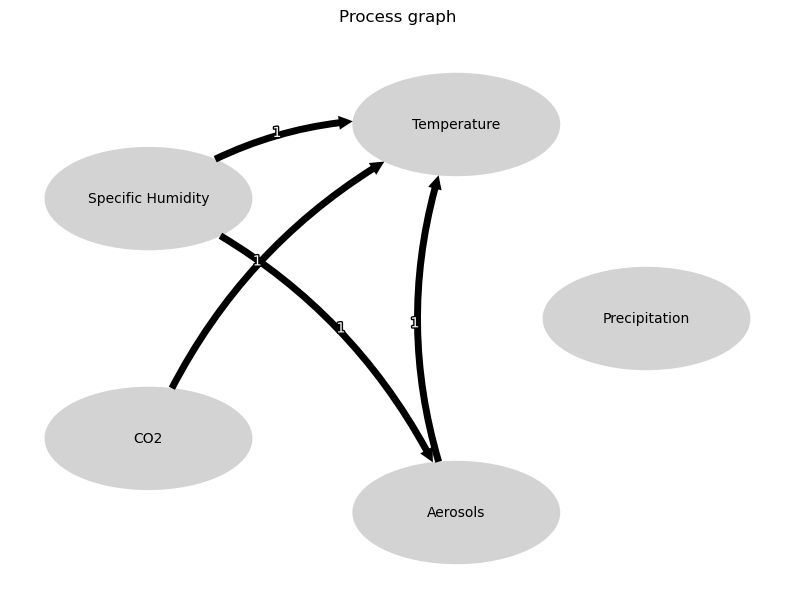


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





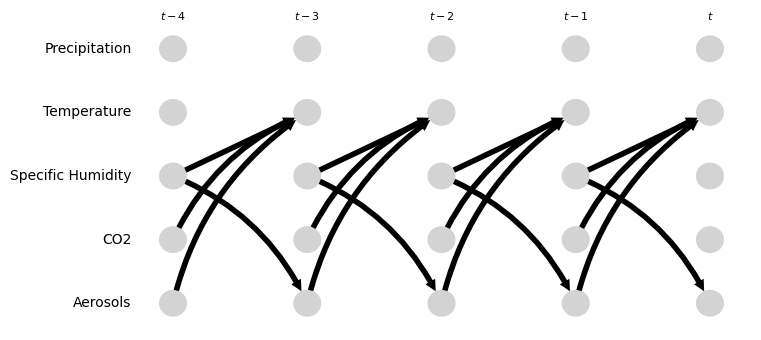

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.50 [-1.70, -0.19]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.92 [0.30, 2.51]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.46 [-0.36, 1.07]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.72 [0.64, 1.12]
Negative precipitation values in event 115: 0


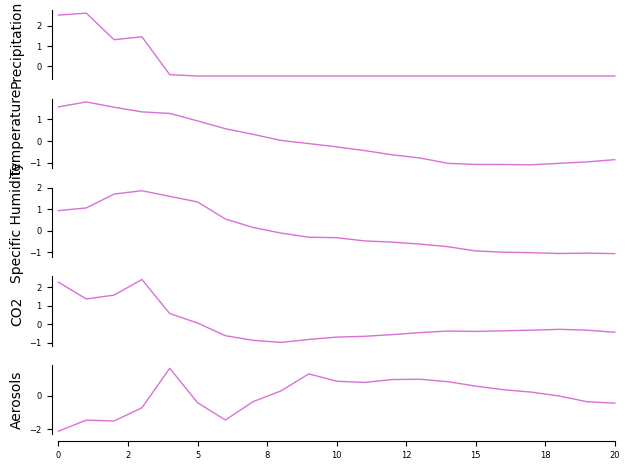

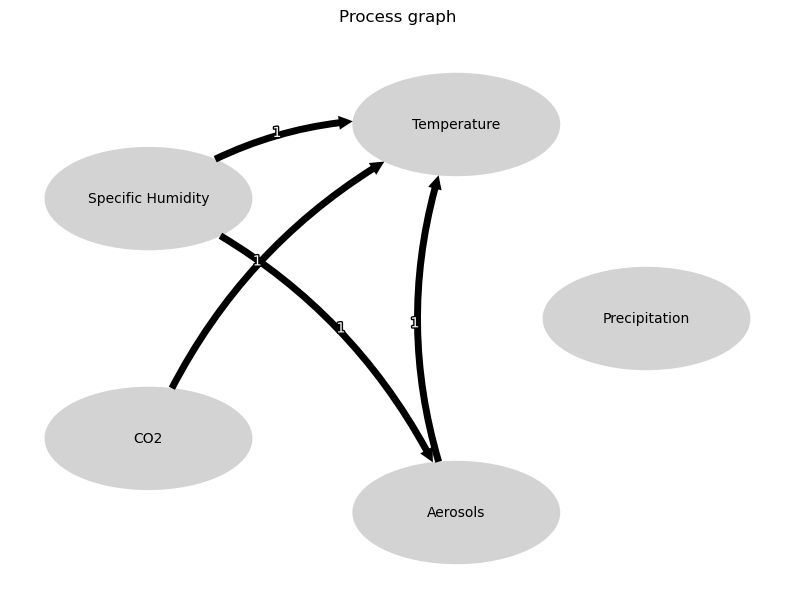


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





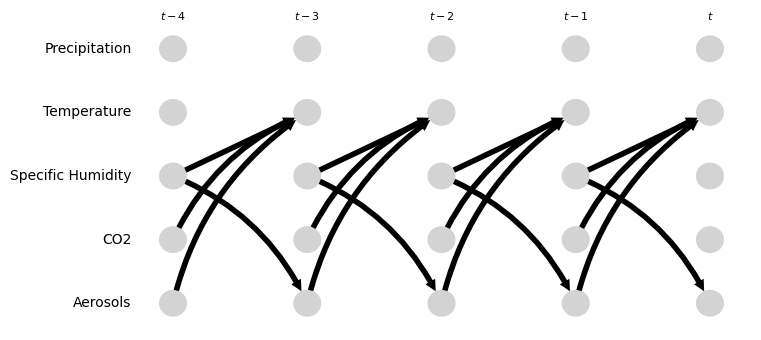

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.21 [-0.88, -0.11]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.05 [-0.25, 0.04]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.79 [0.42, 0.90]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.38 [-0.78, 0.00]
Negative precipitation values in event 116: 0


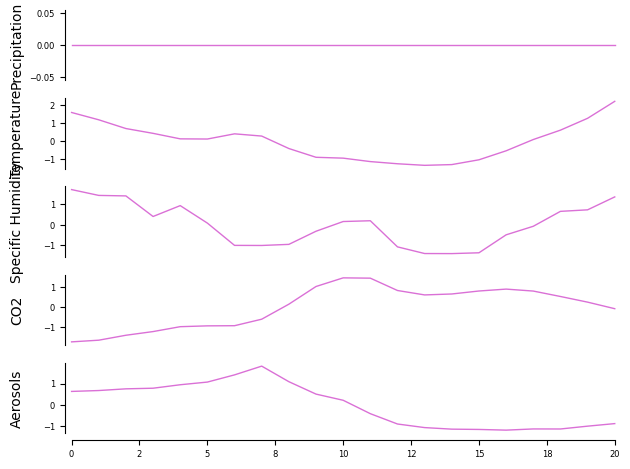

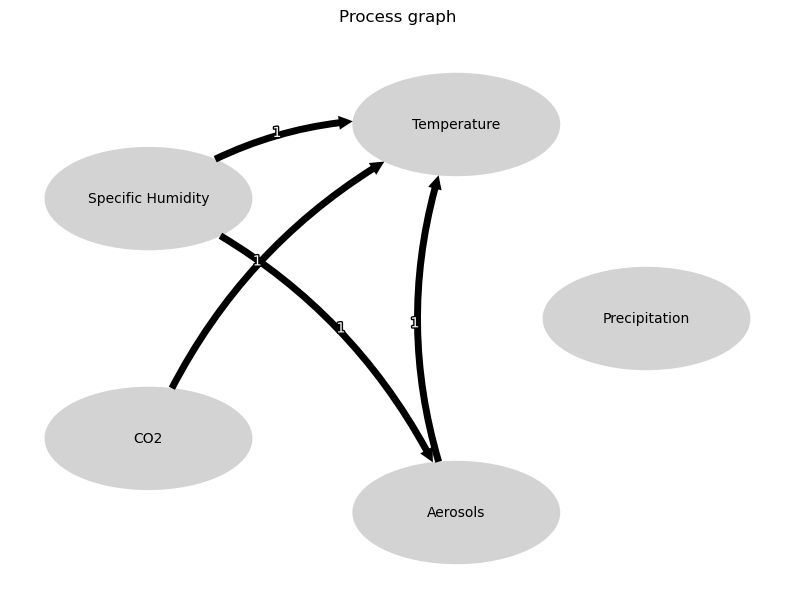


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





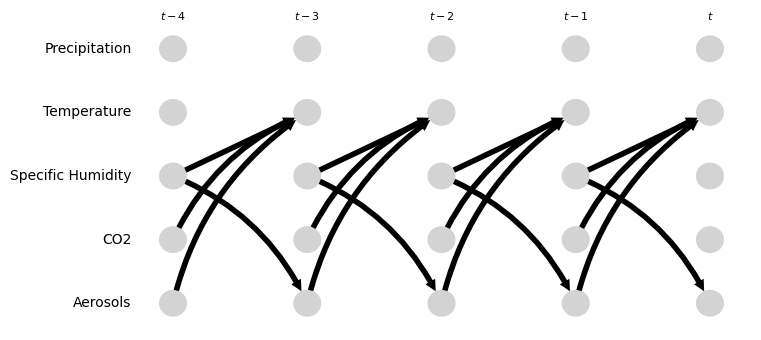

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.95 [-1.35, -0.56]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.57 [-0.71, -0.19]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.71 [0.19, 1.04]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.12 [-0.52, 0.73]
Negative precipitation values in event 117: 0


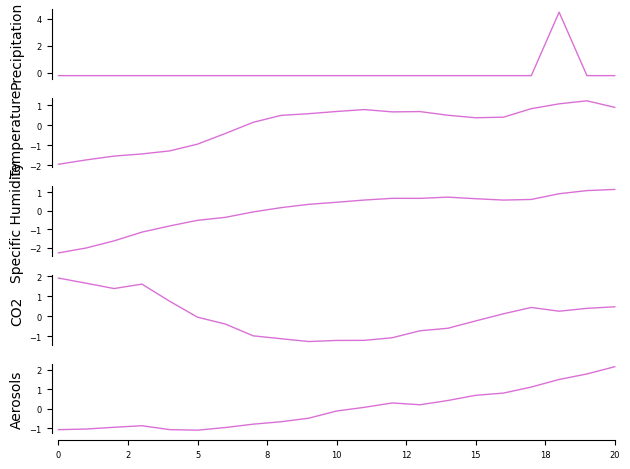

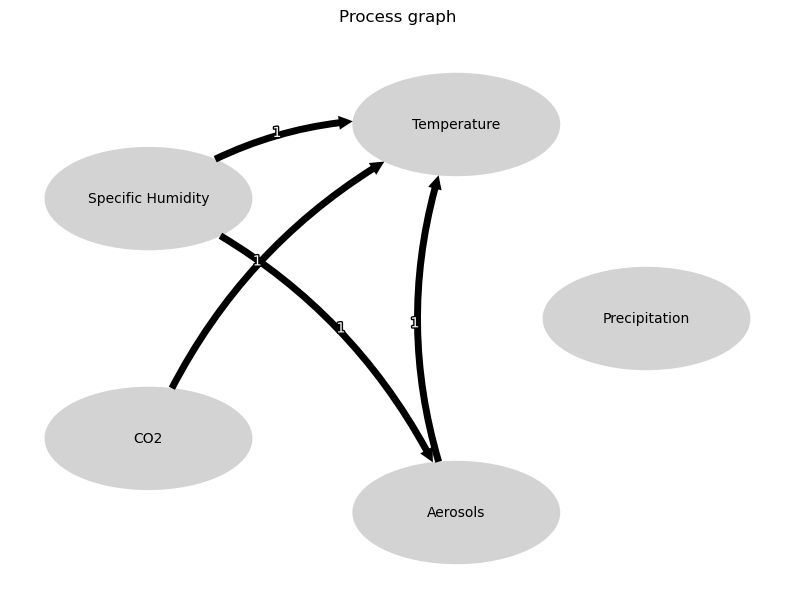


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





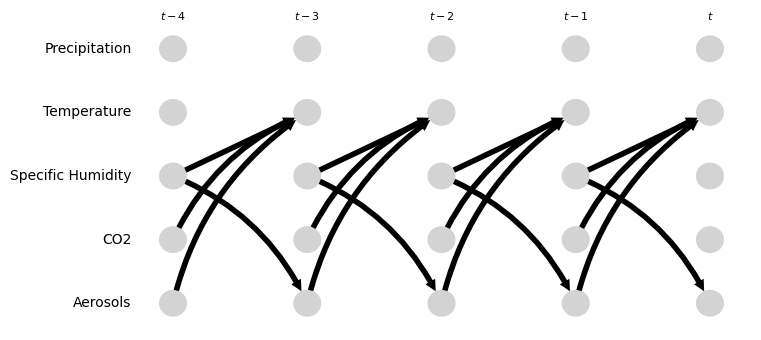

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.16 [-1.75, -0.44]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.72 [0.54, 2.79]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.88 [-3.47, 0.01]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.62 [1.26, 1.94]
Negative precipitation values in event 118: 0


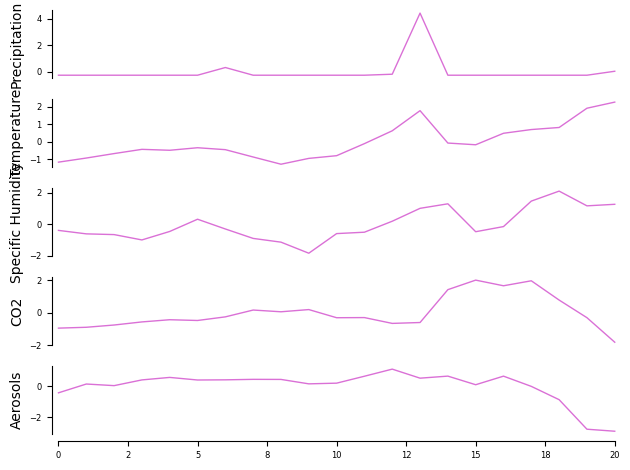

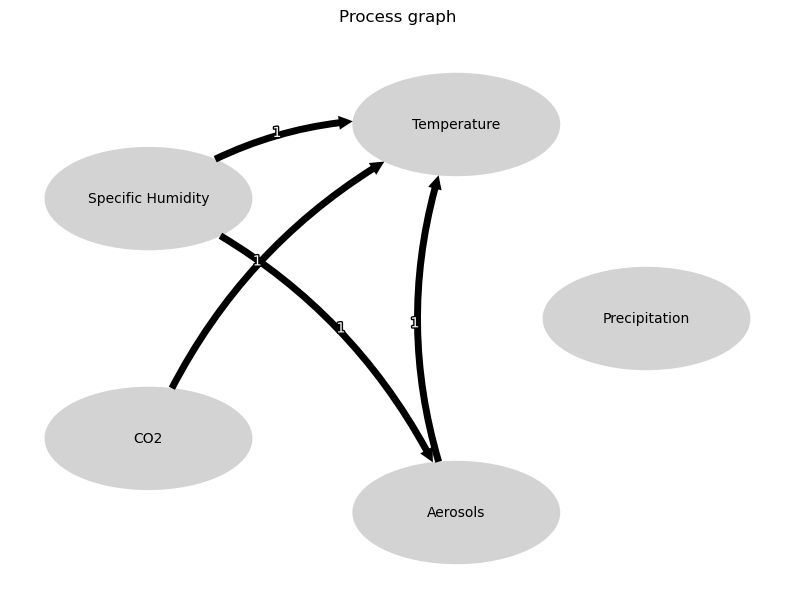


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





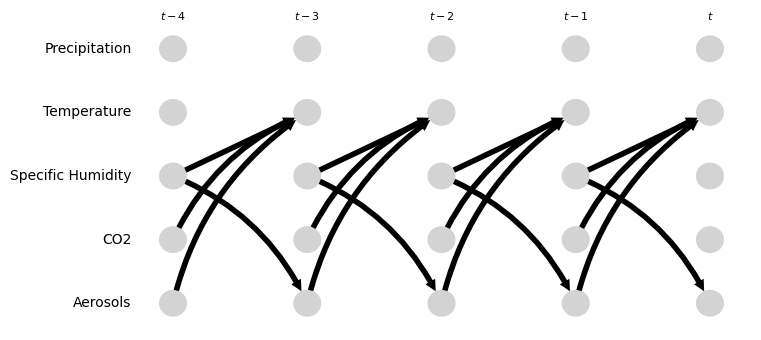

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.02 [-0.22, 0.48]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.41 [-0.96, 1.98]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.50 [0.11, 0.91]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.69 [-0.96, -0.05]
Negative precipitation values in event 119: 0


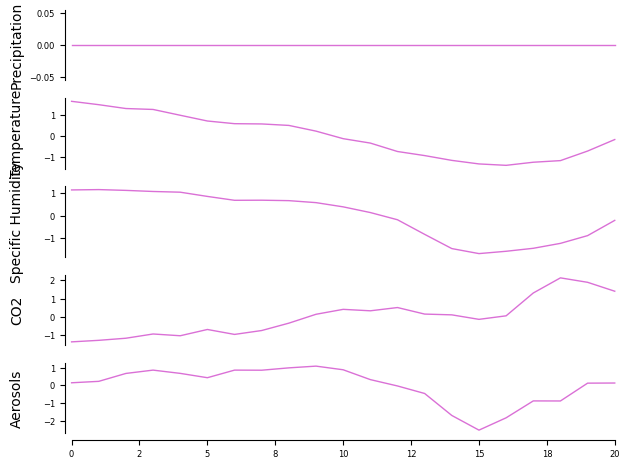

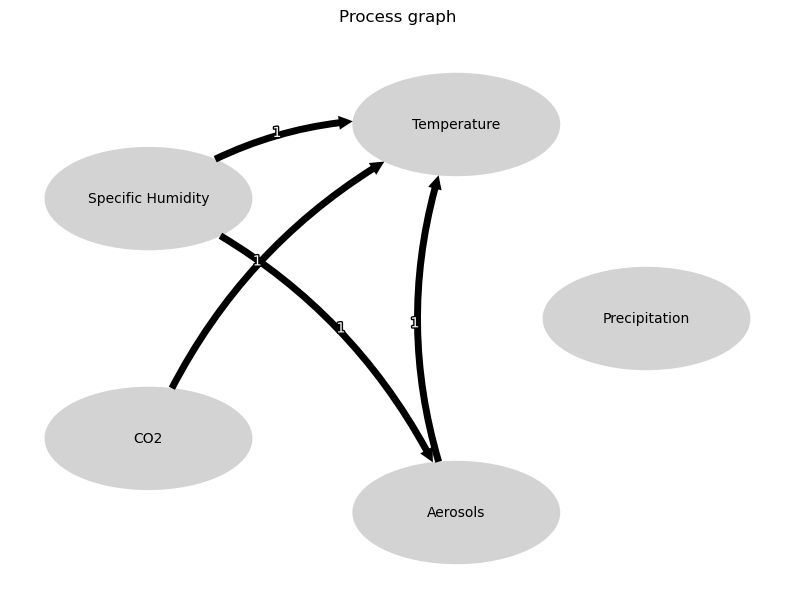


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





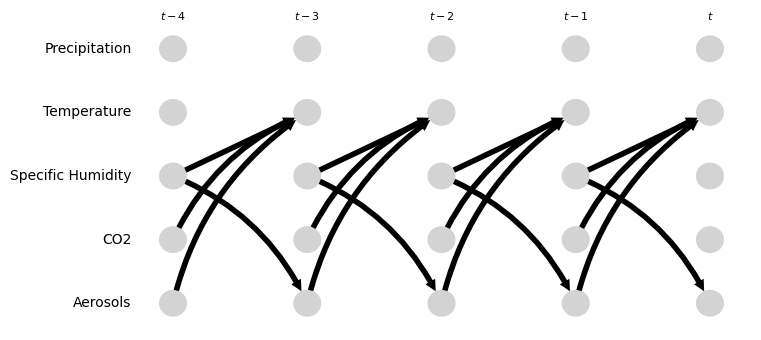

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.05 [-0.72, 0.20]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.02 [-0.56, 0.40]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.73 [0.04, 1.36]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.92 [0.71, 1.25]
Negative precipitation values in event 120: 0


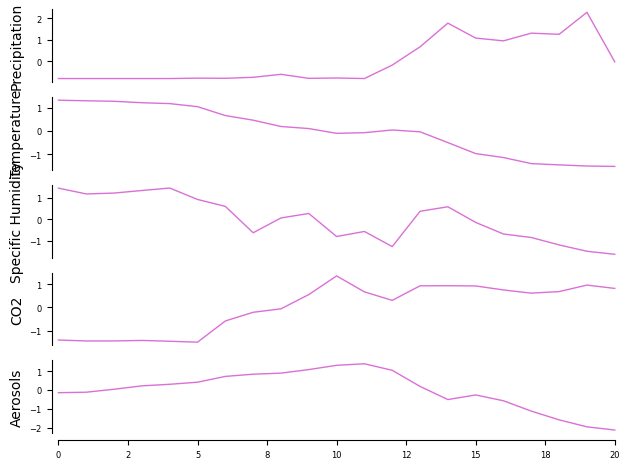

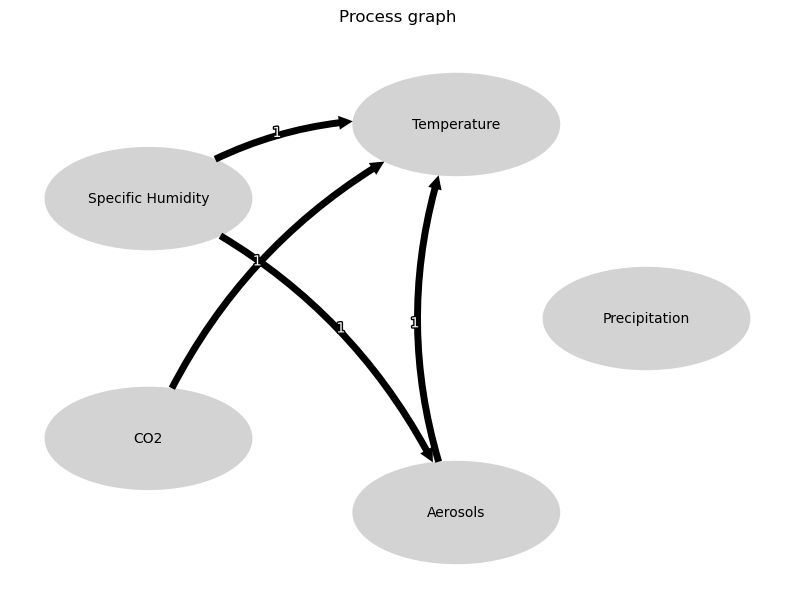


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





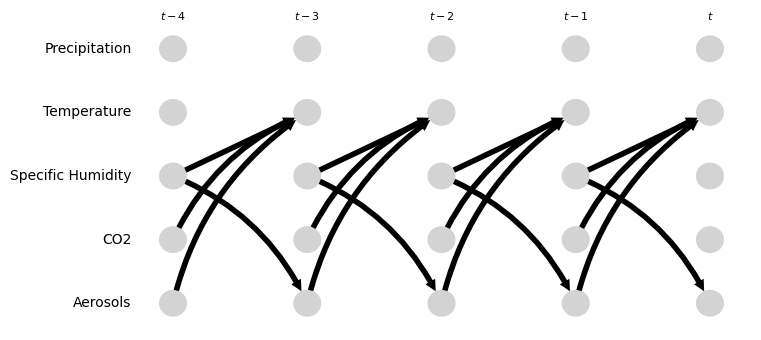

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.52 [-0.66, -0.38]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.51 [0.49, 0.71]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.08 [0.04, 0.25]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.64 [0.02, 1.02]
Negative precipitation values in event 121: 0


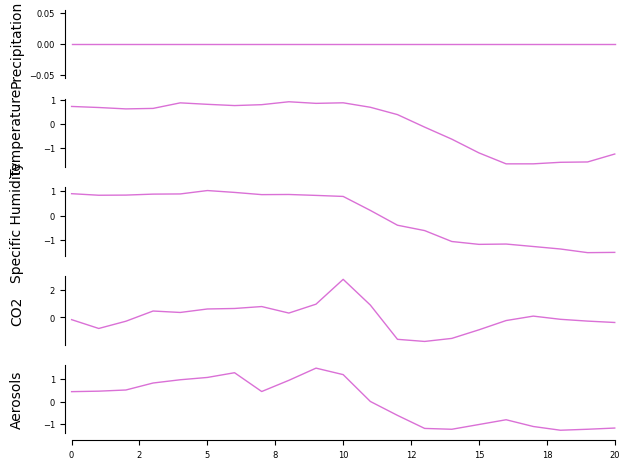

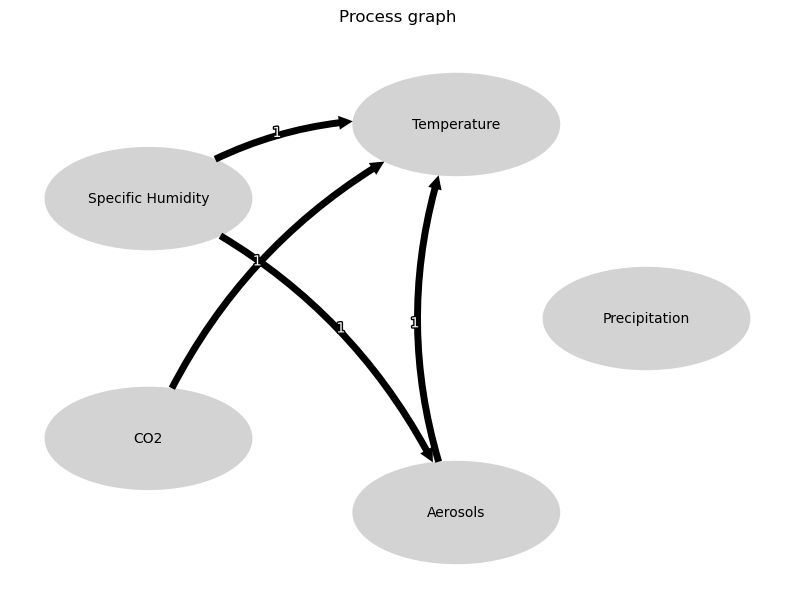


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





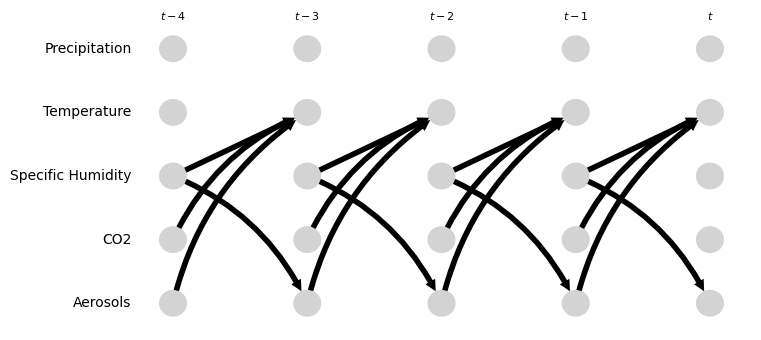

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.00 [-0.12, 0.10]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.22 [-0.54, 0.00]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.27 [1.13, 1.66]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.97 [0.85, 1.20]
Negative precipitation values in event 122: 0


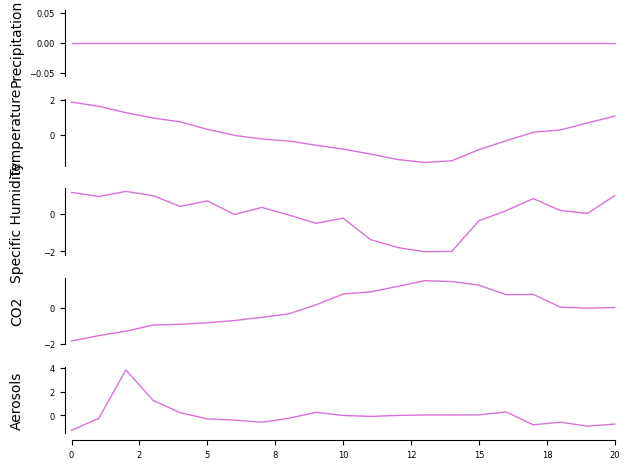

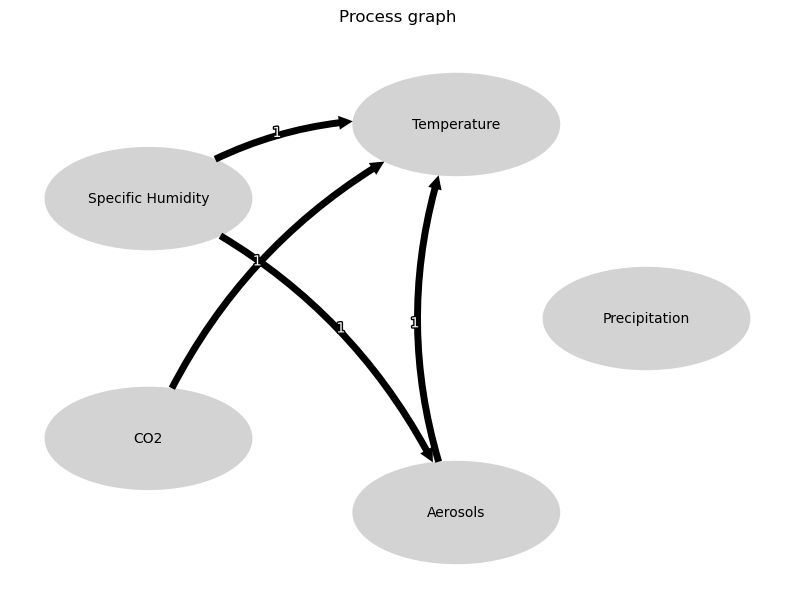


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





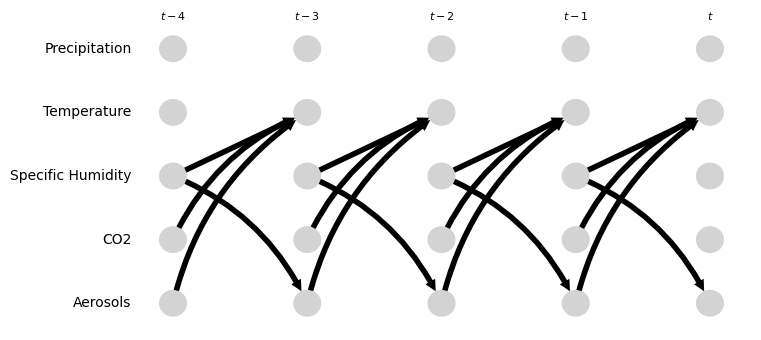

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.03 [-0.19, 0.49]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.54 [-1.23, 0.46]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.57 [0.31, 0.94]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.23 [-0.31, -0.15]
Negative precipitation values in event 123: 0


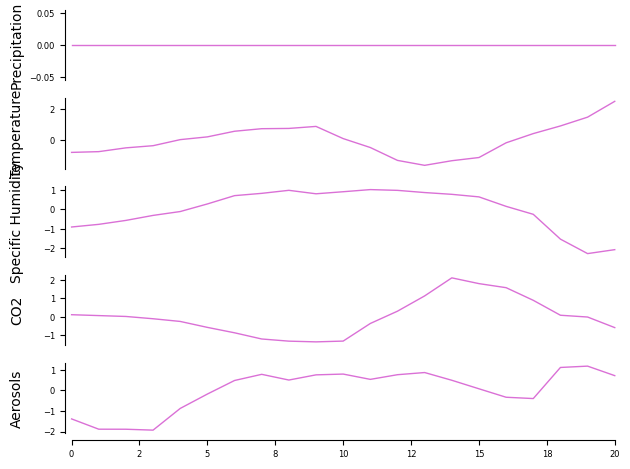

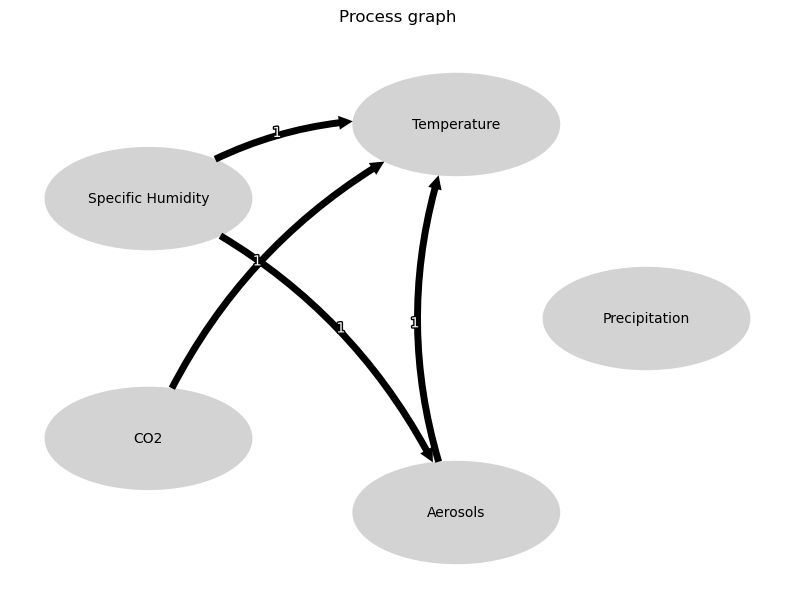


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





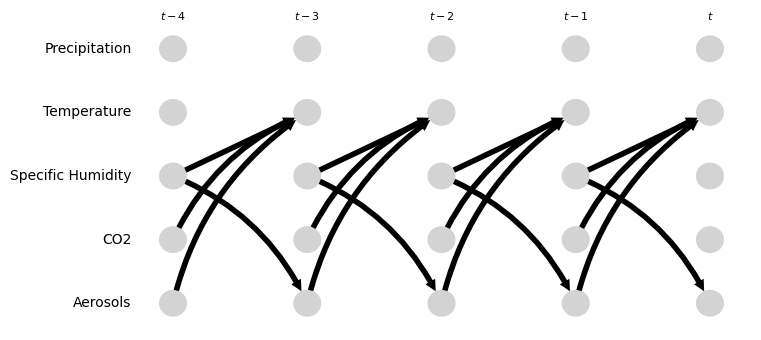

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.39 [-0.71, -0.17]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.35 [-1.28, 0.81]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.98 [-2.79, -0.38]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.10 [-0.30, 0.82]
Negative precipitation values in event 124: 0


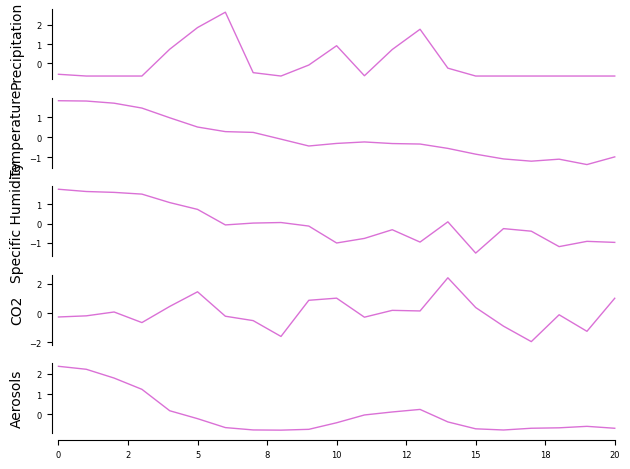

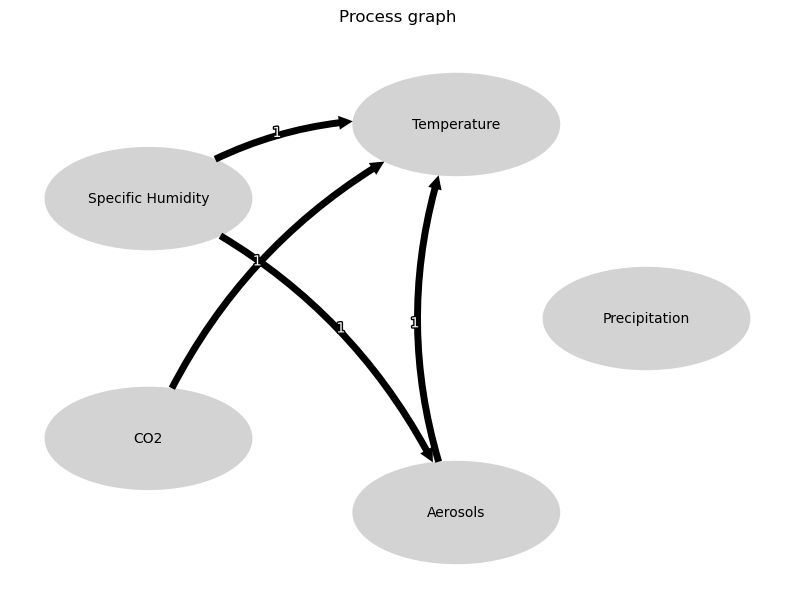


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





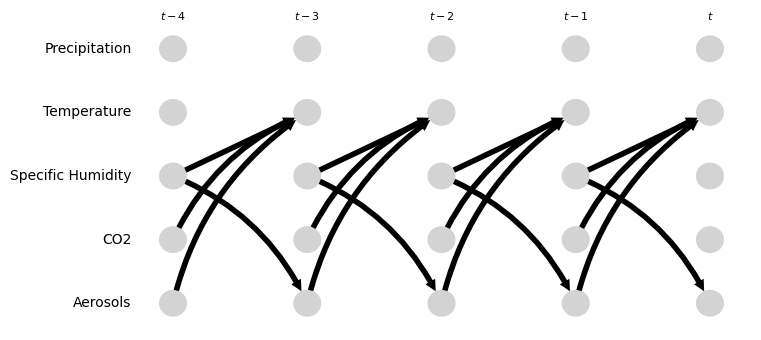

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.04 [-0.16, 0.28]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.41 [-0.01, 0.77]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.49 [0.32, 0.72]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.03 [-0.28, 0.11]
Negative precipitation values in event 125: 0


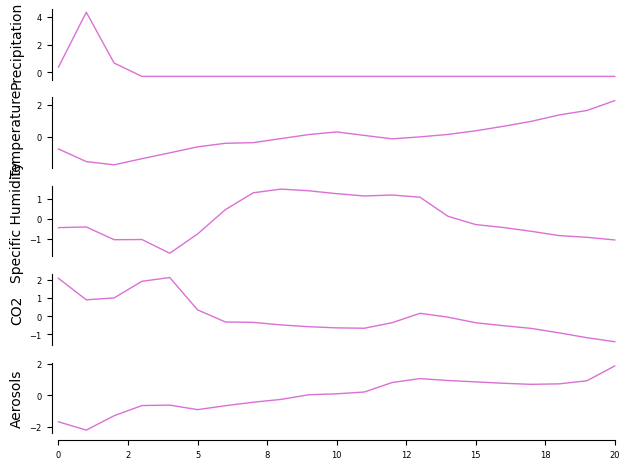

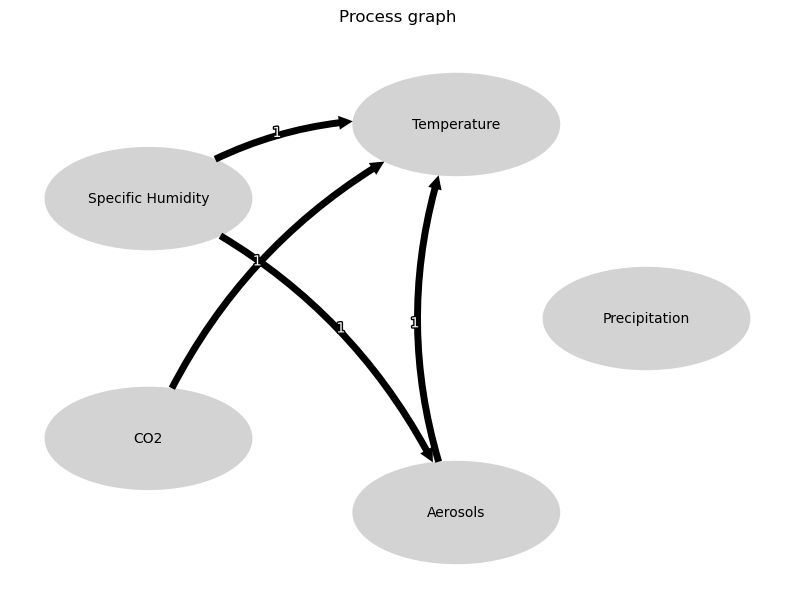


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





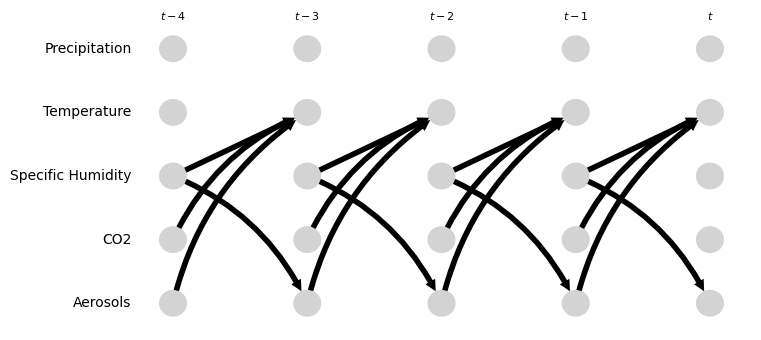

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.75 [-1.19, -0.40]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.41 [0.24, 0.55]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.46 [-0.50, -0.25]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.01 [-0.27, 0.40]
Negative precipitation values in event 126: 0


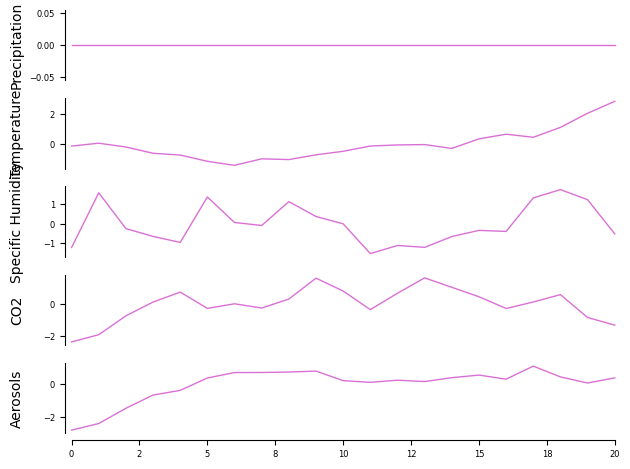

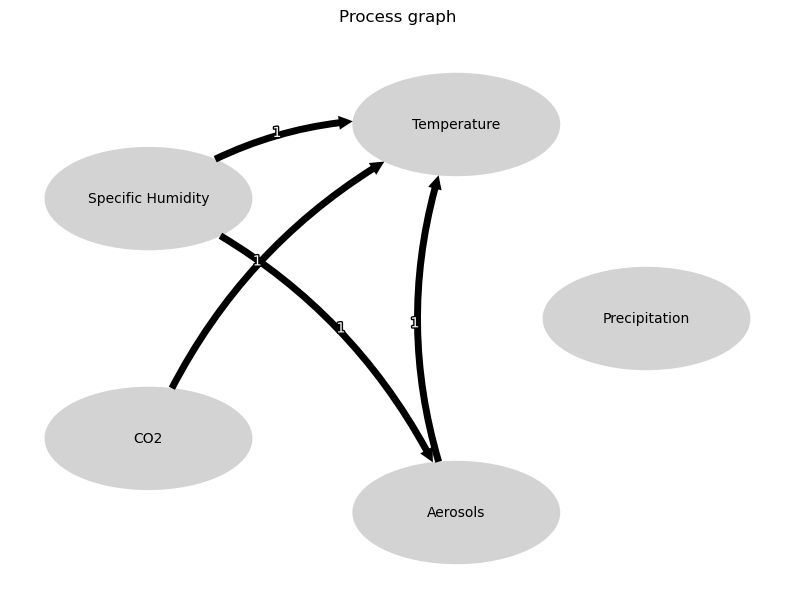


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





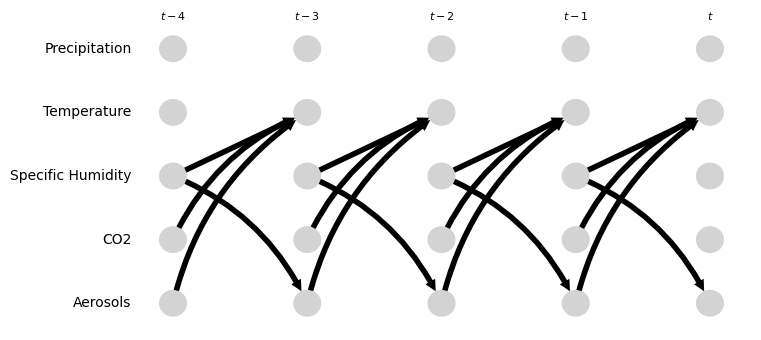

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.16 [-0.36, 1.08]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.72 [-1.77, 1.80]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.49 [-0.53, 0.81]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.02 [-0.09, 0.13]
Negative precipitation values in event 127: 0


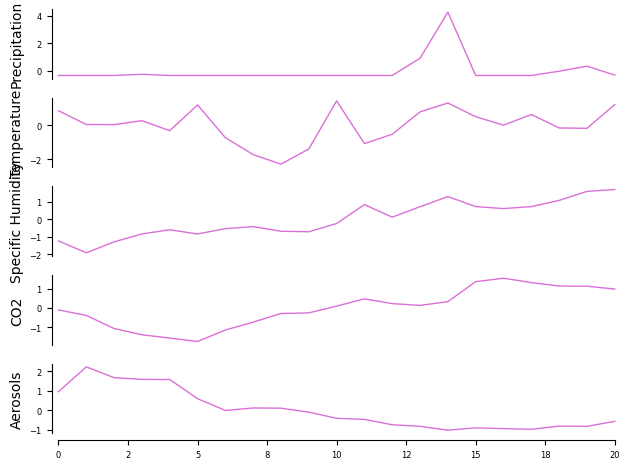

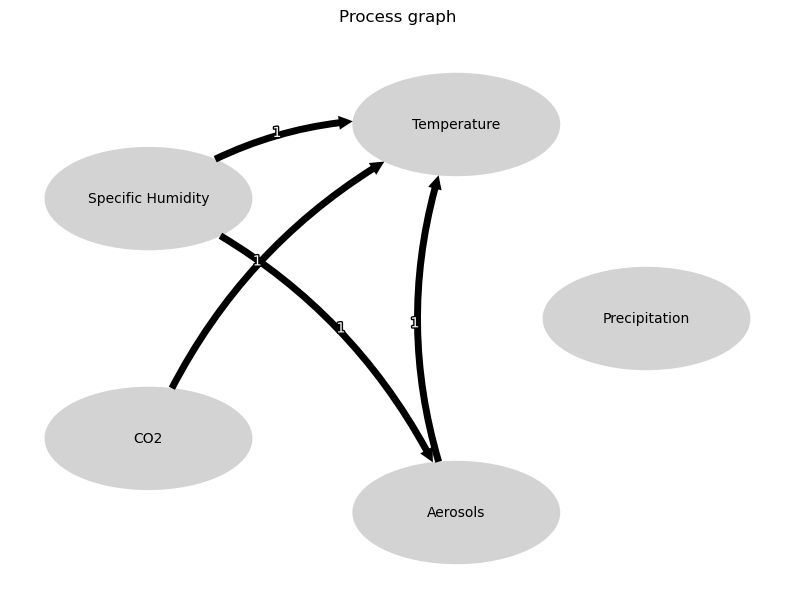


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





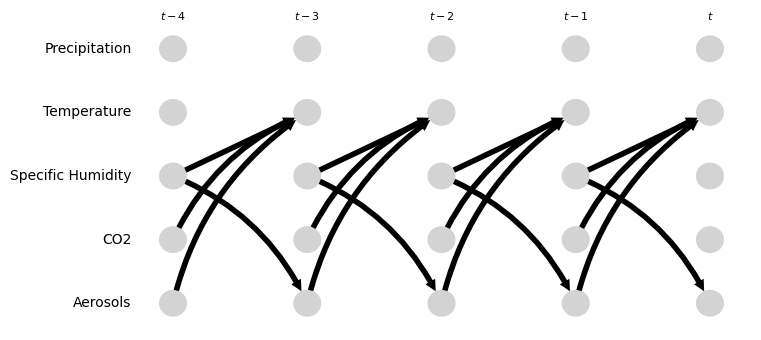

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.30 [-0.98, 1.53]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.76 [-4.64, 1.76]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.76 [-1.67, 2.09]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.46 [-0.74, -0.43]
Negative precipitation values in event 128: 0


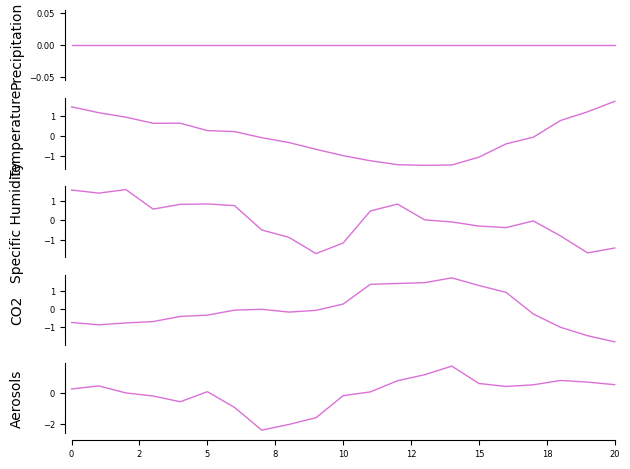

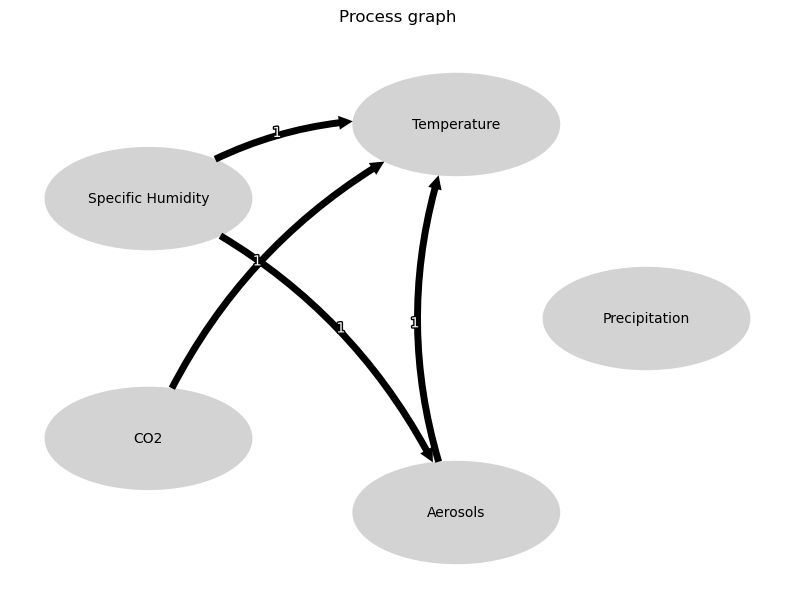


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





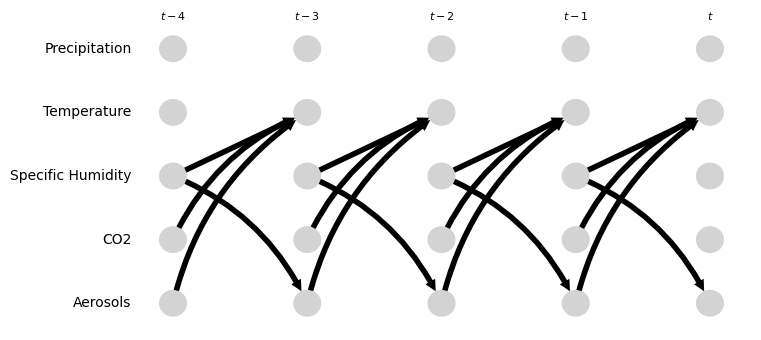

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.00 [-1.19, -0.59]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.34 [0.09, 0.50]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.10 [-0.26, 0.38]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.03 [-0.52, 0.66]
Negative precipitation values in event 129: 0


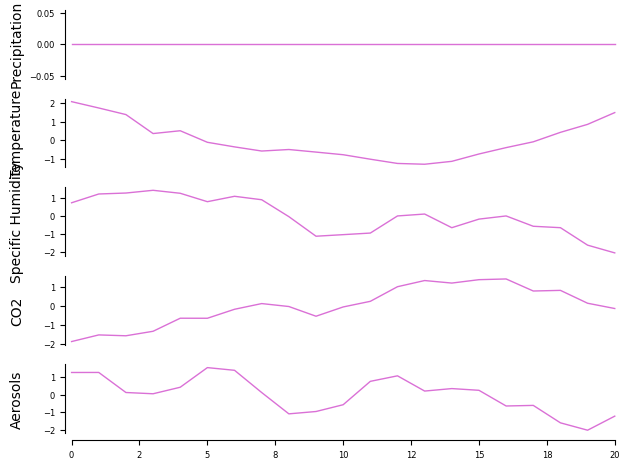

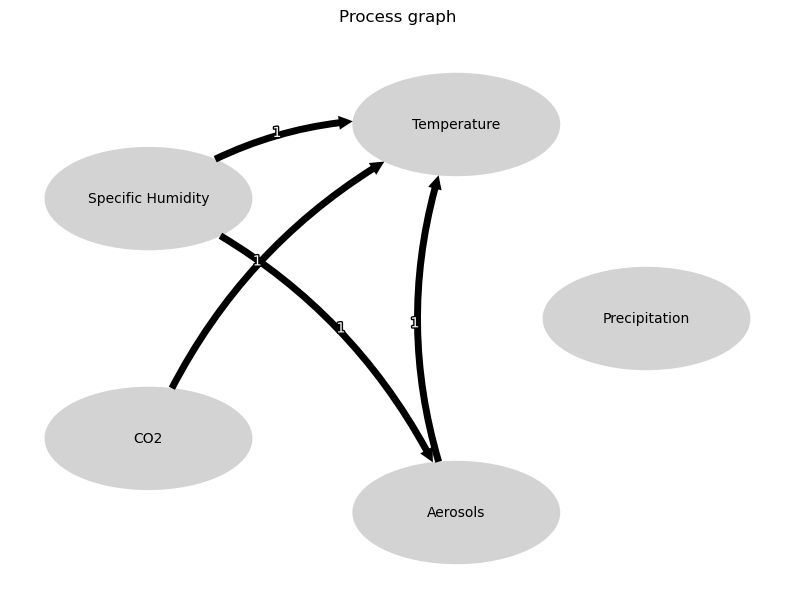


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





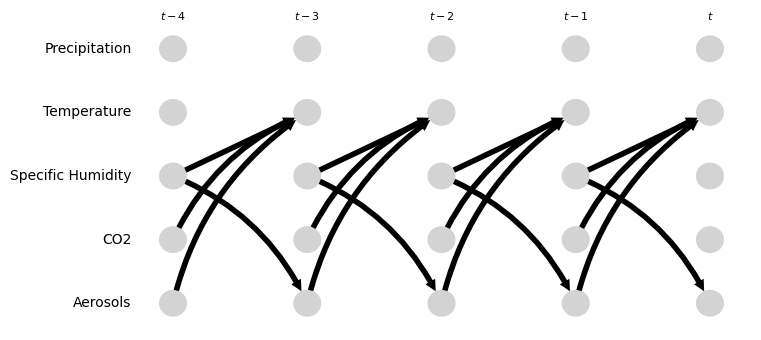

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.03 [-0.21, 0.39]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.61 [-0.75, -0.13]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.28 [0.12, 0.64]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.44 [-0.16, 0.95]
Negative precipitation values in event 130: 0


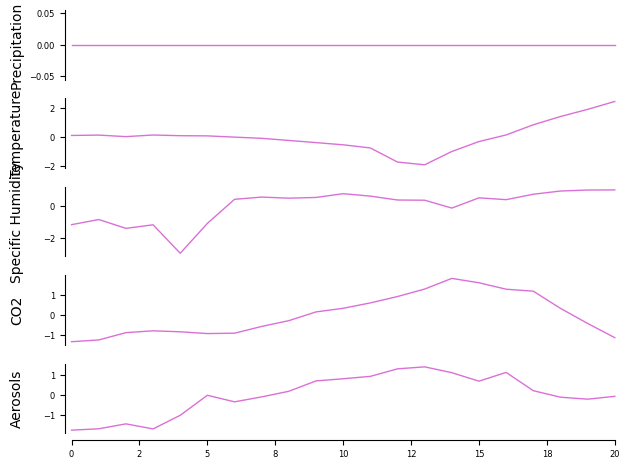

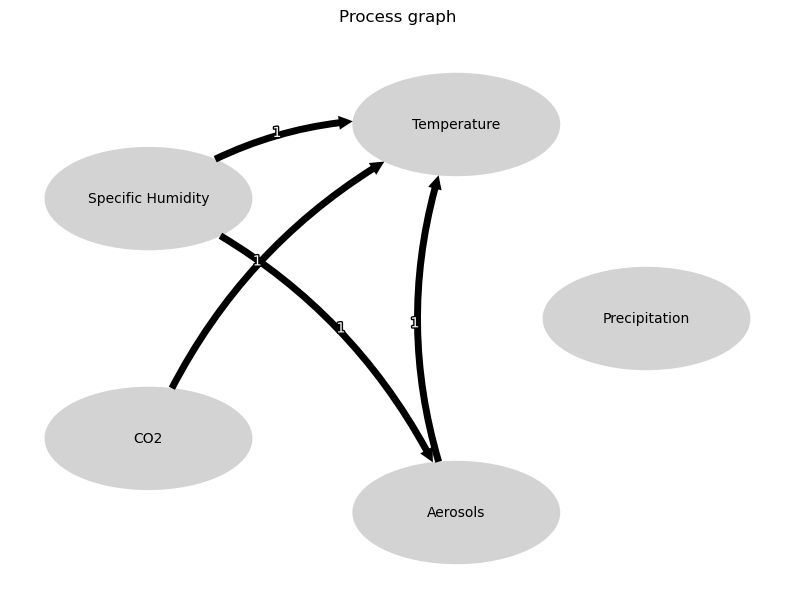


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





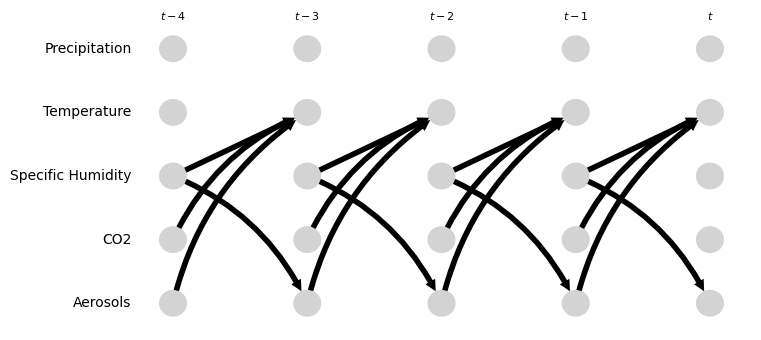

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.95 [0.67, 1.60]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -2.21 [-2.83, -1.34]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.54 [-0.39, 0.68]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.16 [-0.46, 0.57]
Negative precipitation values in event 131: 0


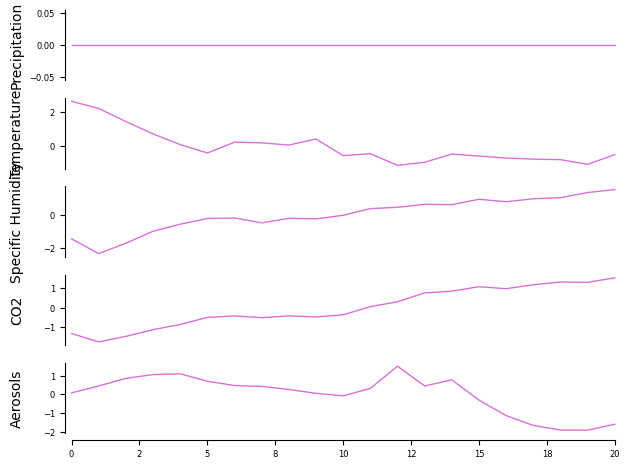

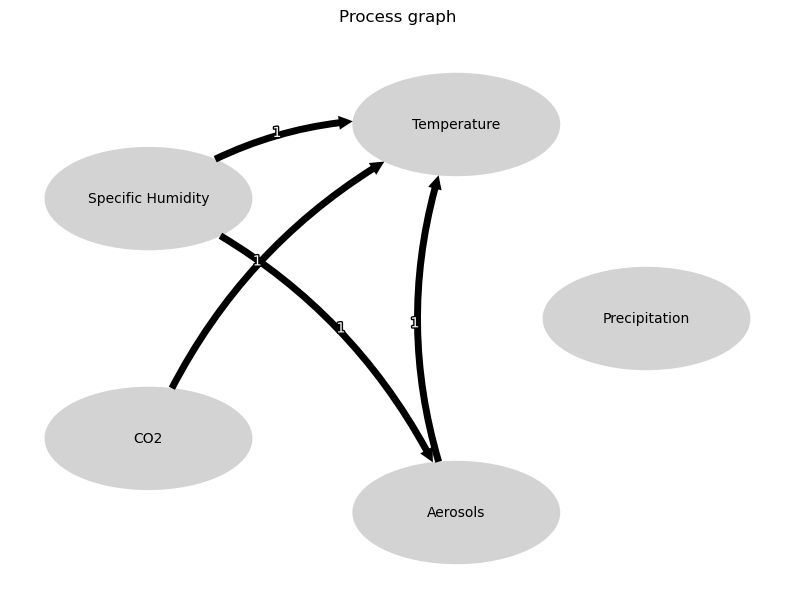


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





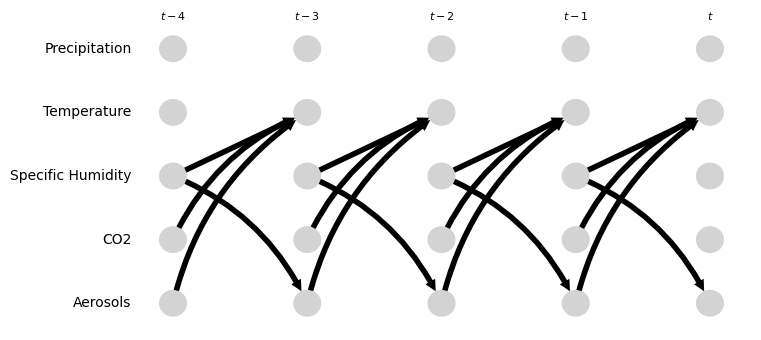

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.24 [-0.33, 1.85]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.09 [-0.14, 0.16]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.90 [-3.41, -0.11]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.23 [-1.64, -0.63]
Negative precipitation values in event 132: 0


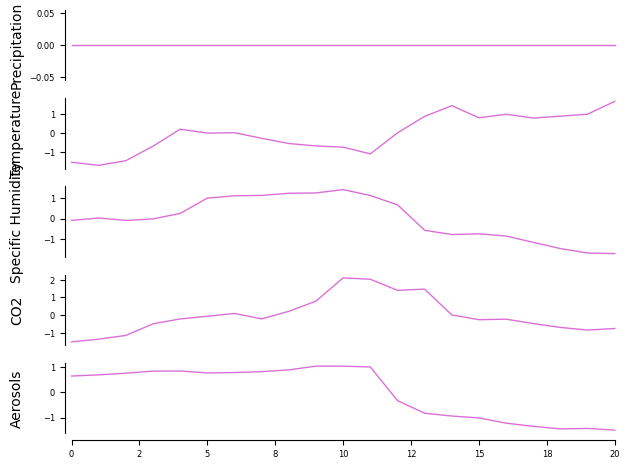

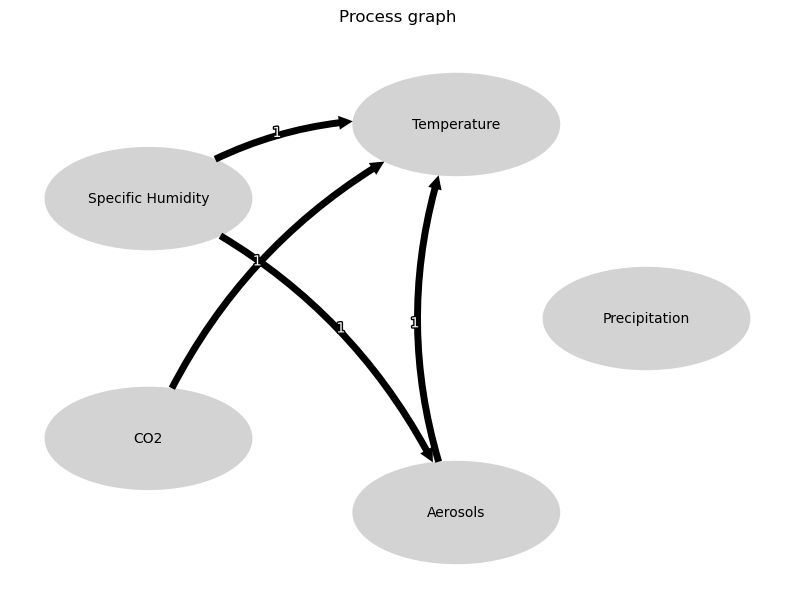


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





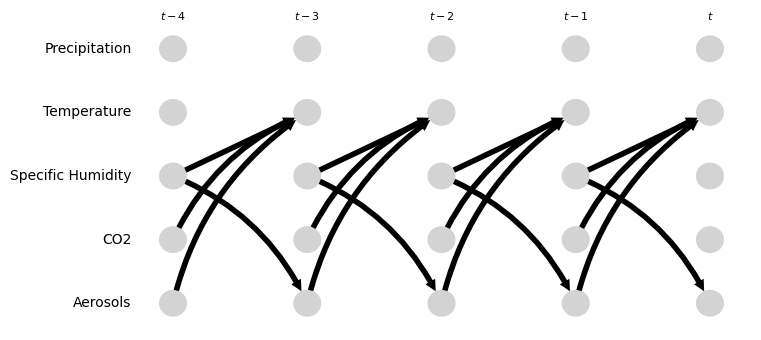

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.16 [-0.21, 0.39]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.43 [-1.67, 0.00]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.38 [-0.78, 0.78]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.88 [0.79, 1.04]
Negative precipitation values in event 133: 0


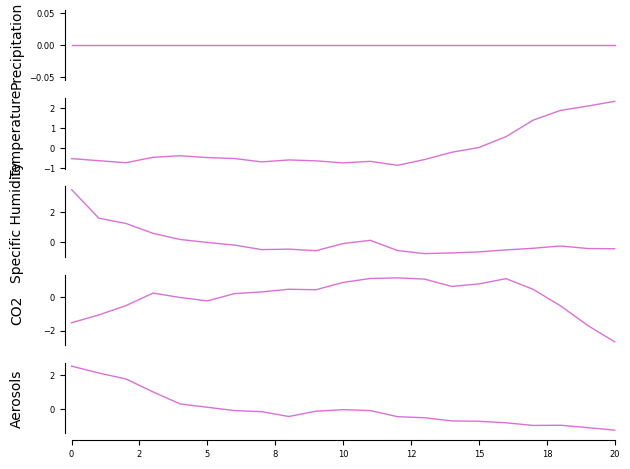

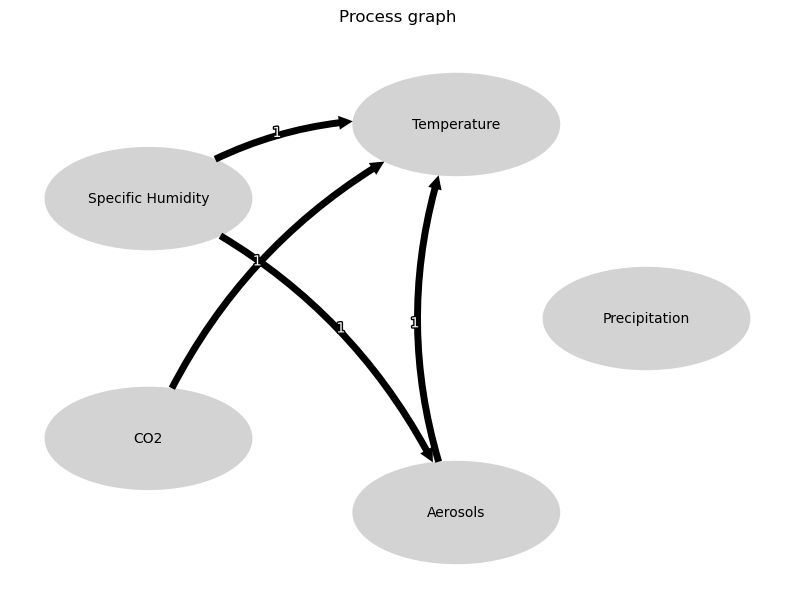


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





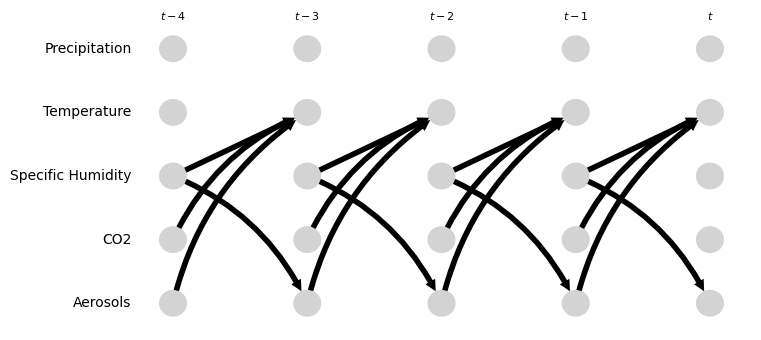

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.31 [-0.73, 0.11]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -2.79 [-3.38, -2.37]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.33 [0.74, 2.38]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.64 [0.19, 0.93]
Negative precipitation values in event 134: 0


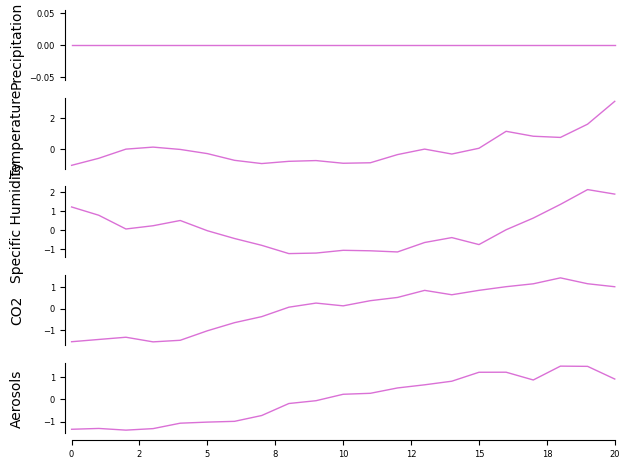

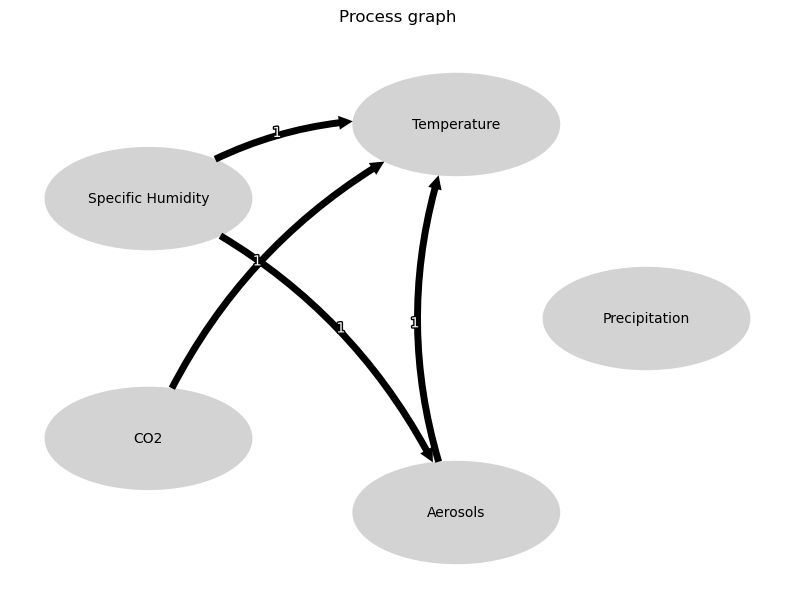


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





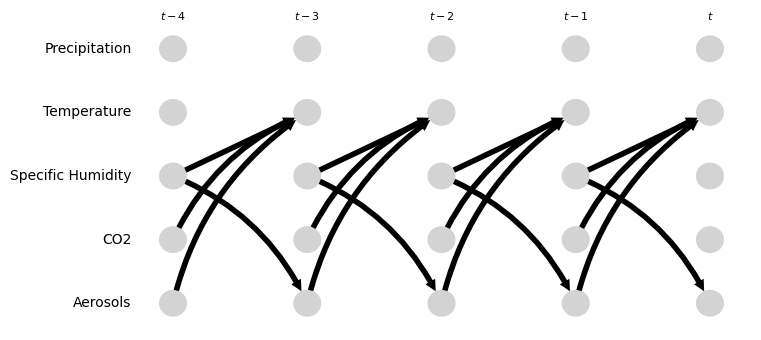

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.57 [-1.30, 0.27]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.25 [0.37, 1.88]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.62 [0.32, 0.66]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.20 [-0.32, 0.57]
Negative precipitation values in event 135: 0


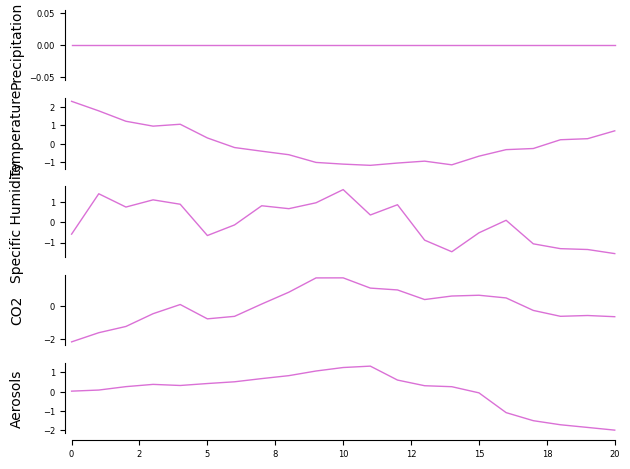

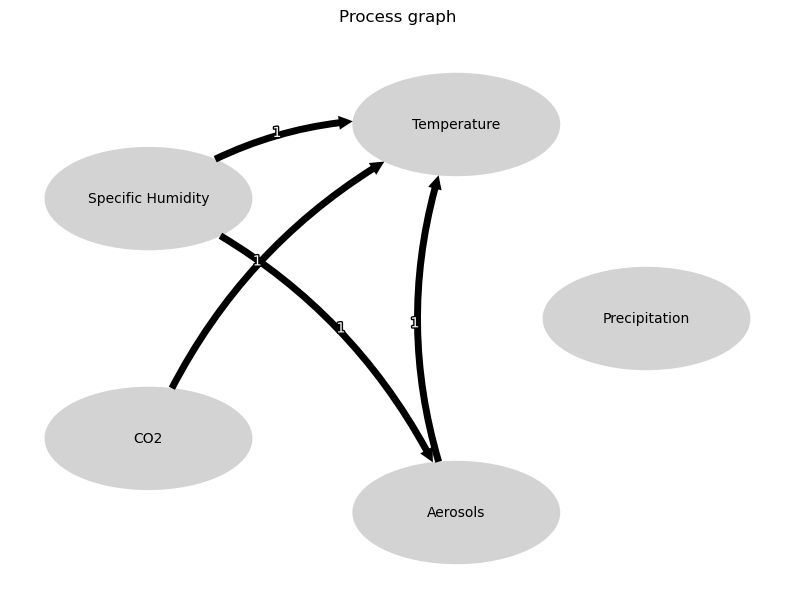


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





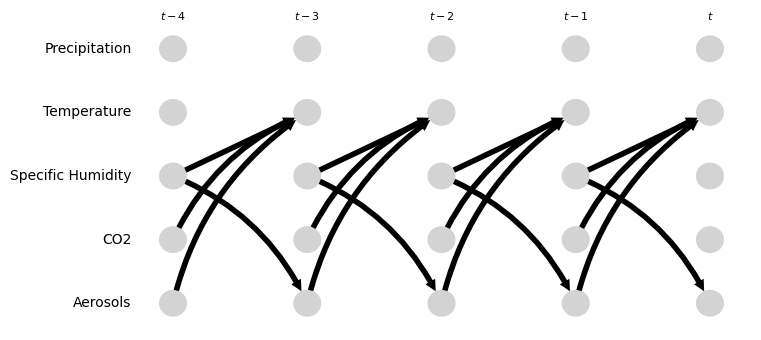

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.40 [-0.59, -0.24]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.40 [-0.52, -0.27]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.19 [-0.04, 0.40]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.86 [0.47, 1.18]
Negative precipitation values in event 136: 0


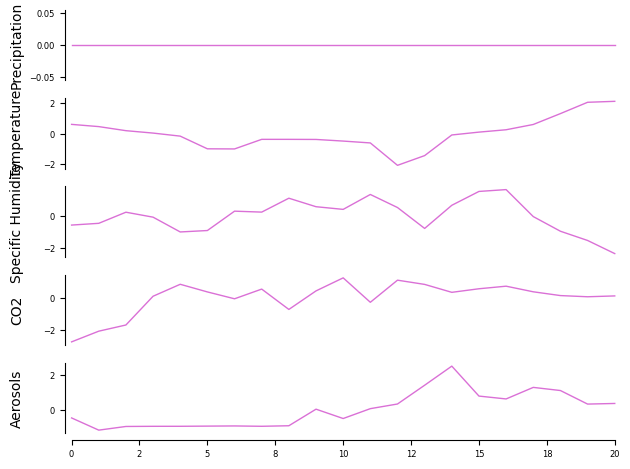

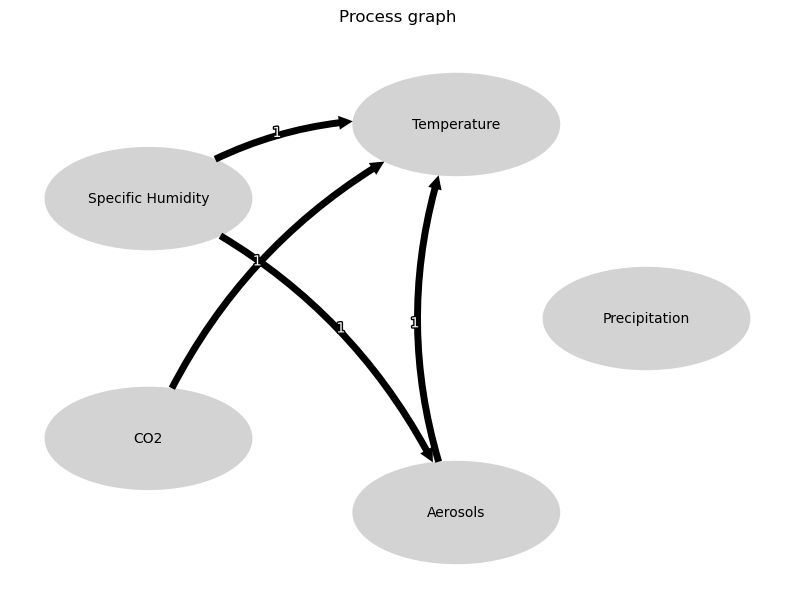


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





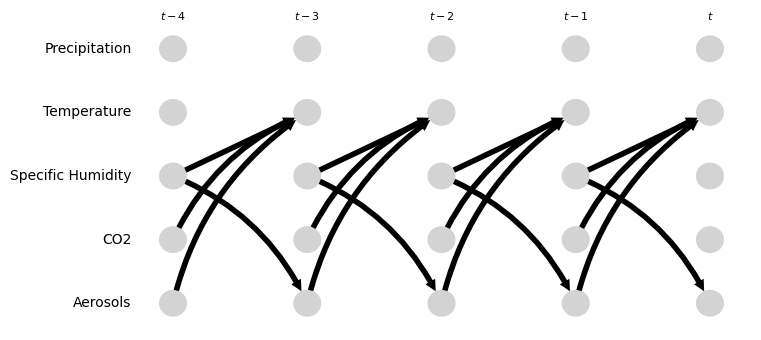

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.53 [-0.98, 0.47]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.56 [0.19, 0.99]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.50 [-0.83, 0.27]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.14 [-0.36, 0.69]
Negative precipitation values in event 137: 0


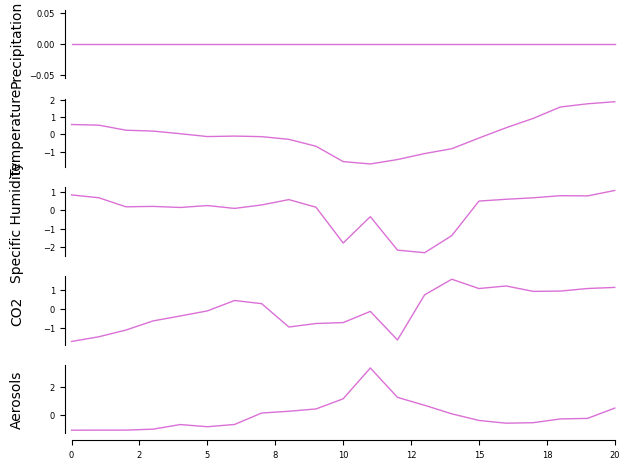

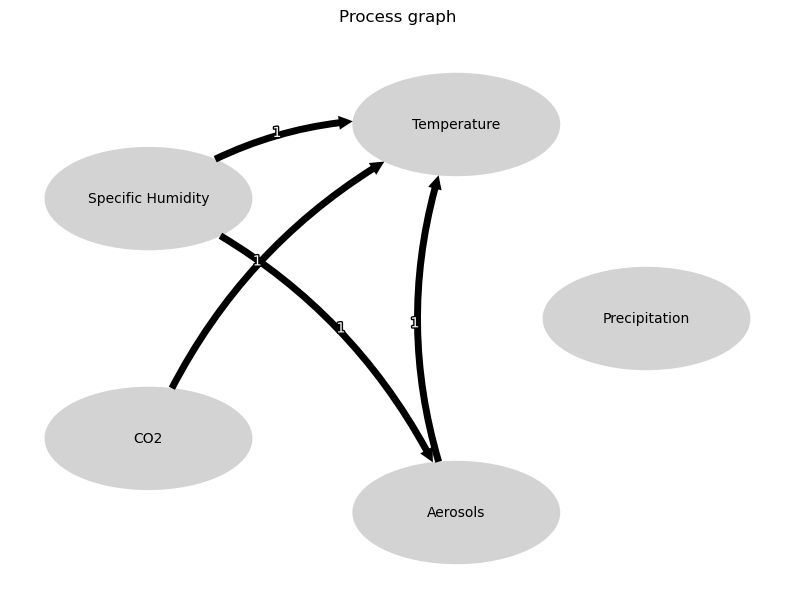


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





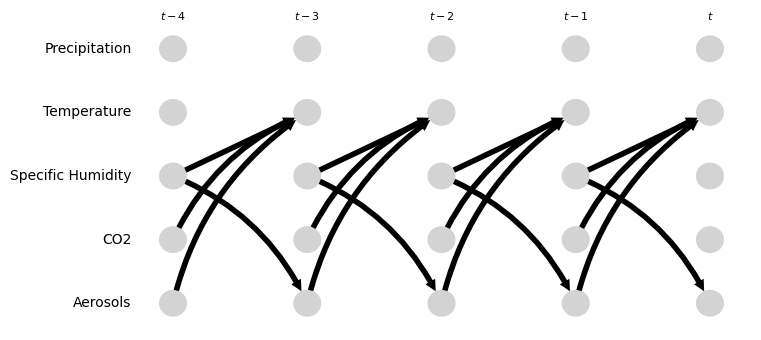

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.61 [0.30, 1.05]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.30 [-0.48, 0.10]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.37 [-0.08, 0.98]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.39 [-1.03, -0.04]
Negative precipitation values in event 138: 0


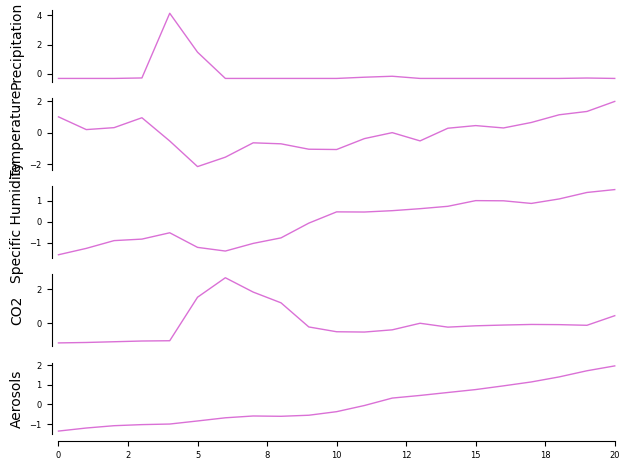

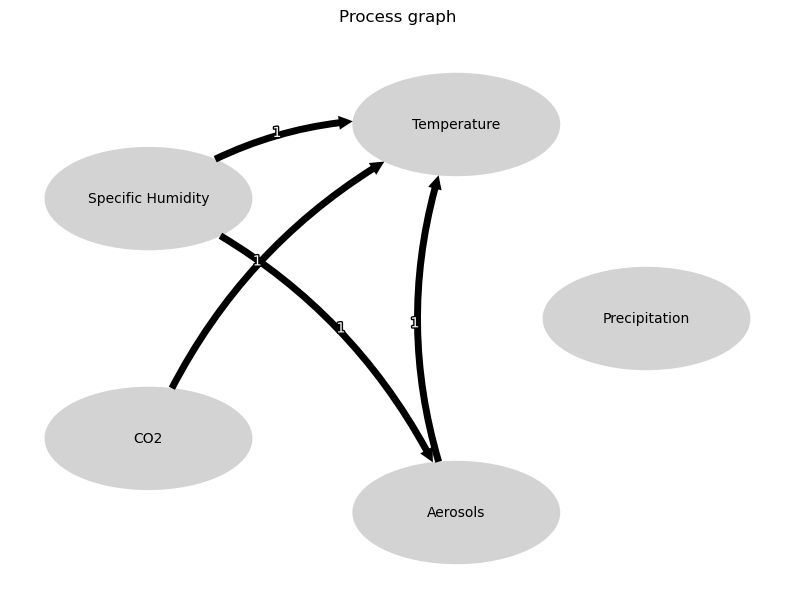


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





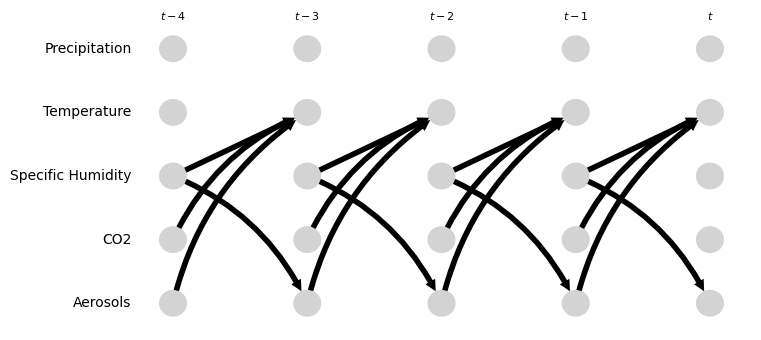

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.53 [0.14, 1.10]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.65 [0.02, 1.24]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.87 [0.19, 1.90]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.91 [0.70, 1.03]
Negative precipitation values in event 139: 0


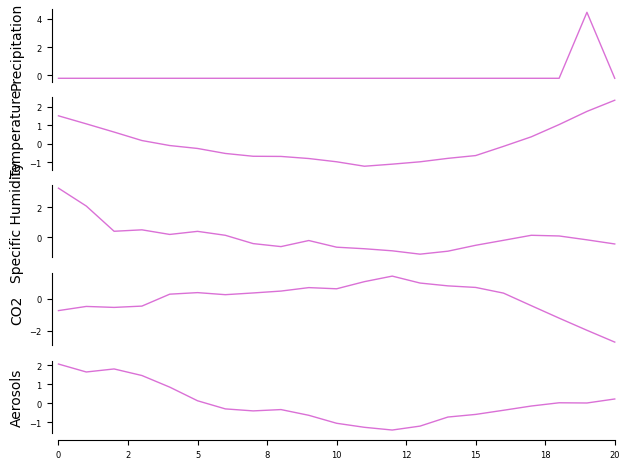

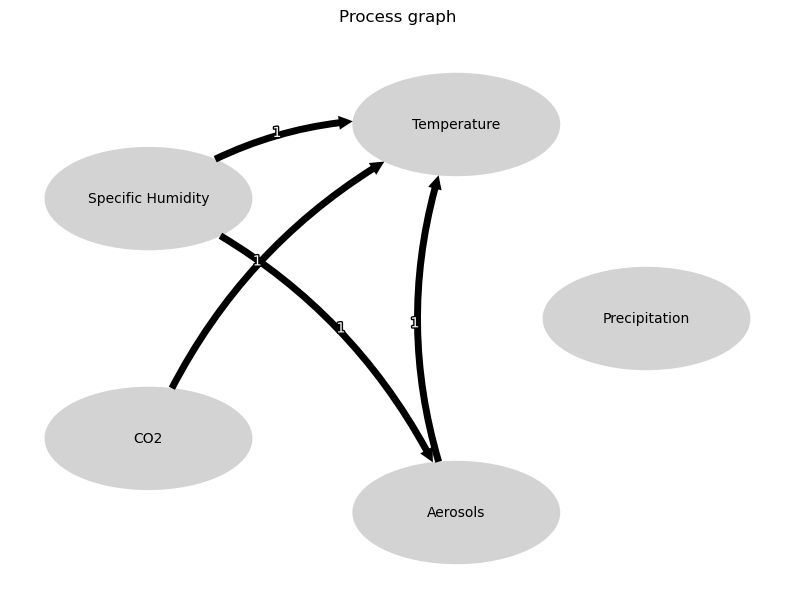


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





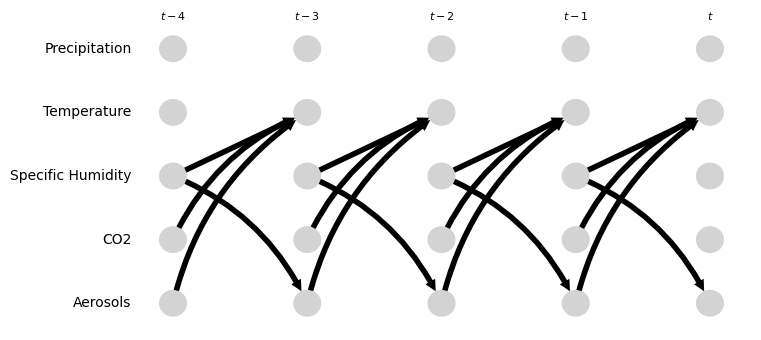

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.19 [-1.61, -0.65]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.01 [-0.78, 0.83]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.16 [-0.79, 0.33]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.73 [0.38, 1.01]
Negative precipitation values in event 140: 0


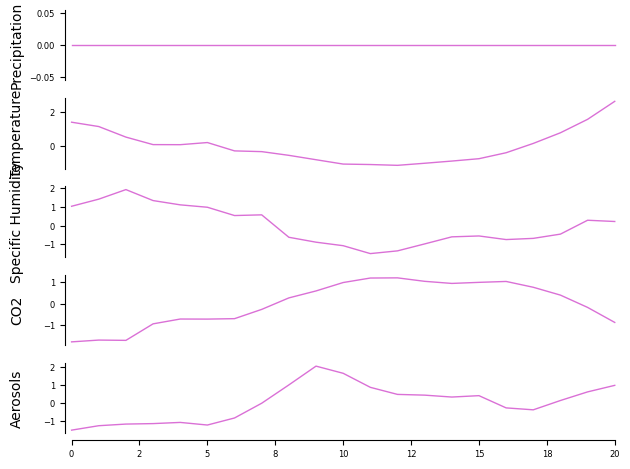

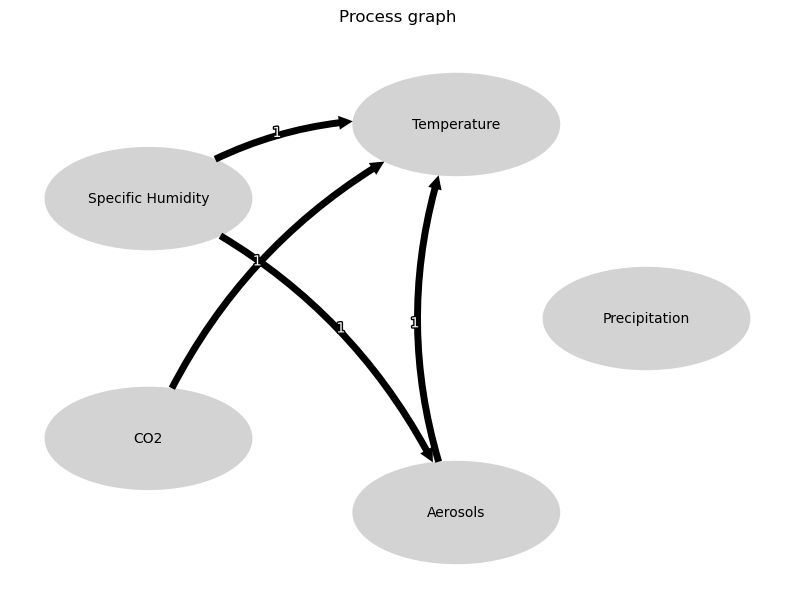


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





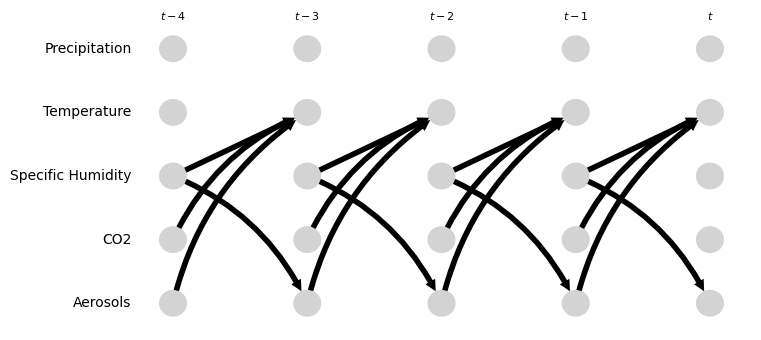

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.30 [-0.93, 0.73]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.04 [-0.90, -0.25]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.71 [-1.13, 0.69]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.45 [-0.87, -0.02]
Negative precipitation values in event 141: 0


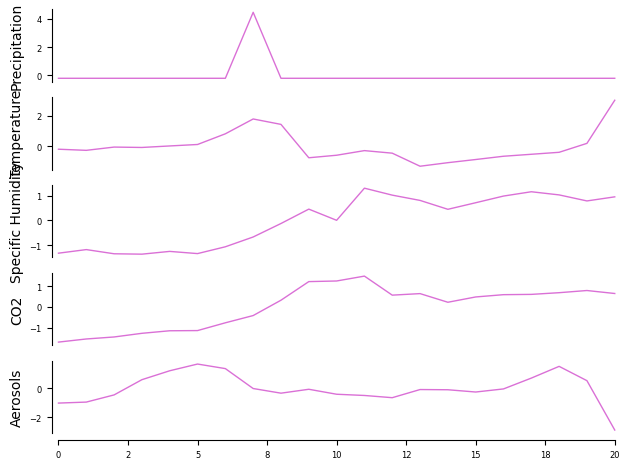

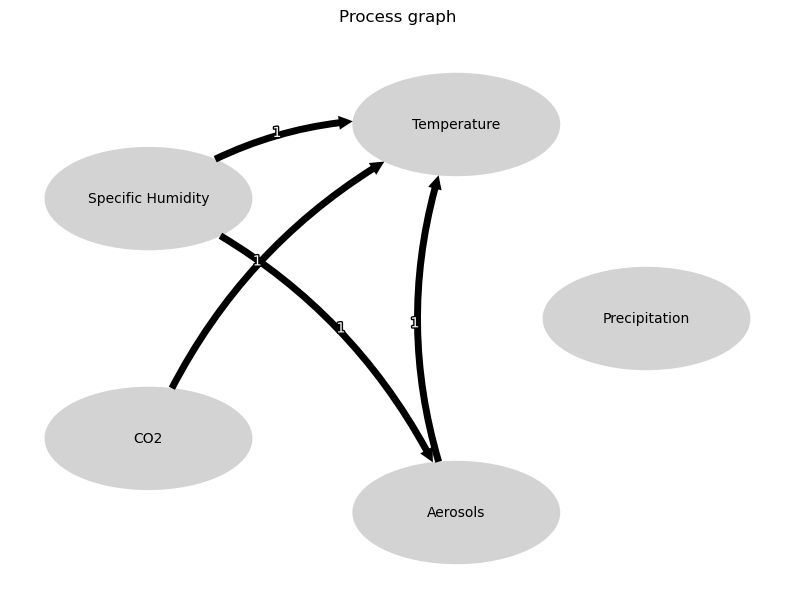


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





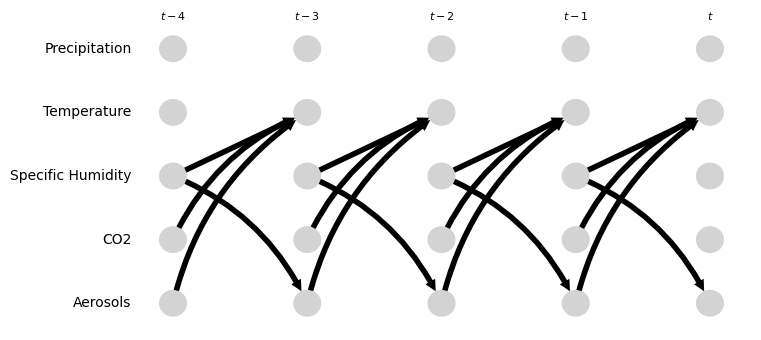

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.53 [-0.36, 0.65]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.83 [-0.11, 0.85]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.58 [-1.09, -0.36]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.36 [-0.51, 0.21]
Negative precipitation values in event 142: 0


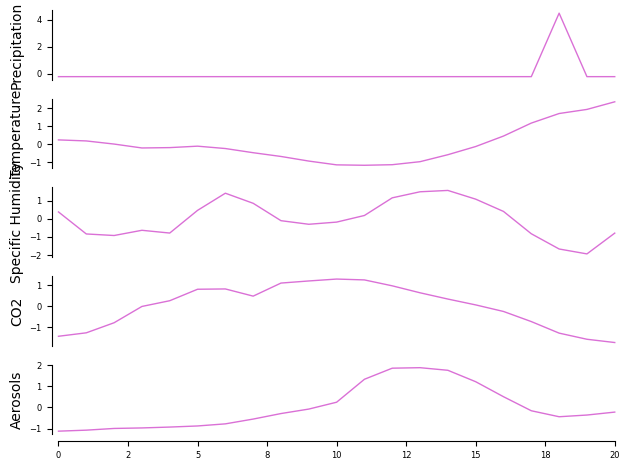

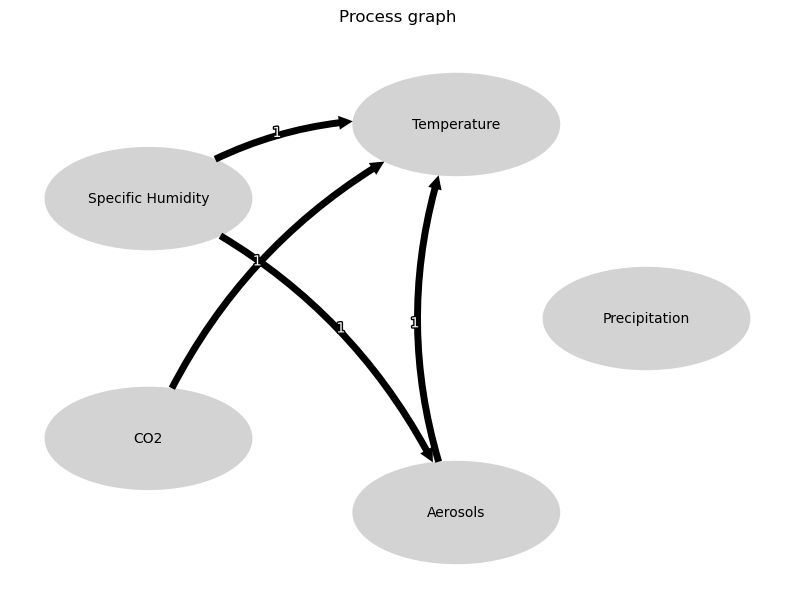


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





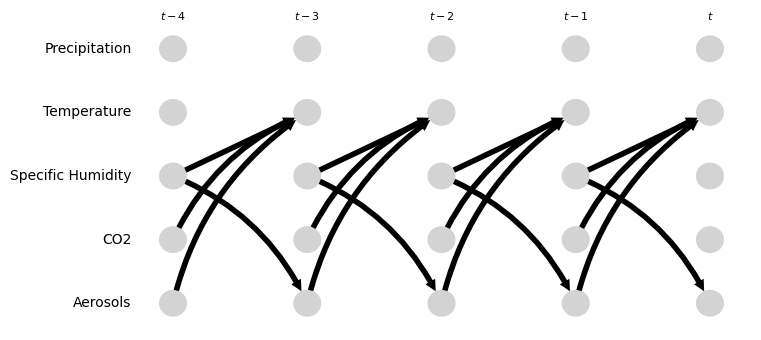

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.30 [-1.47, -1.23]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.04 [-0.16, 0.11]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.02 [-0.25, 0.14]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.39 [0.07, 0.78]
Negative precipitation values in event 143: 0


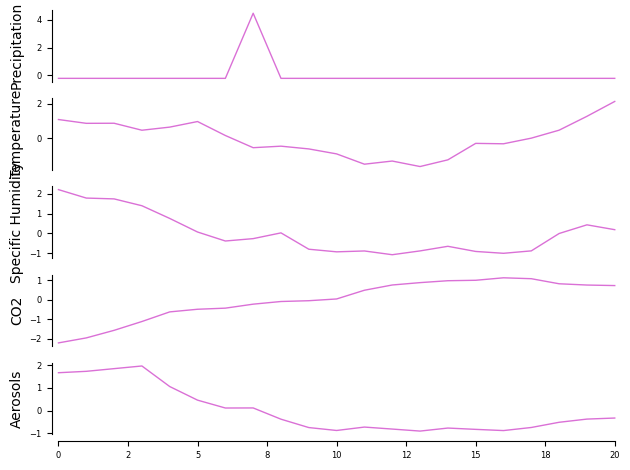

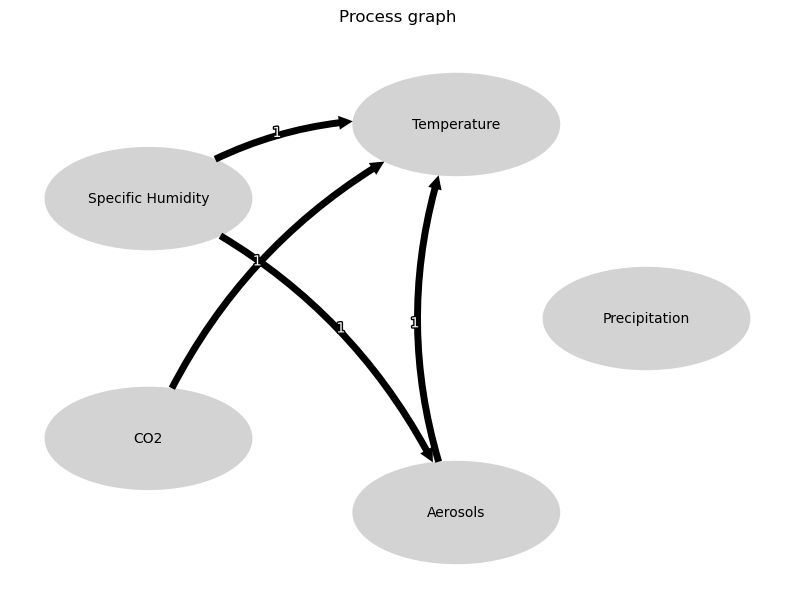


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





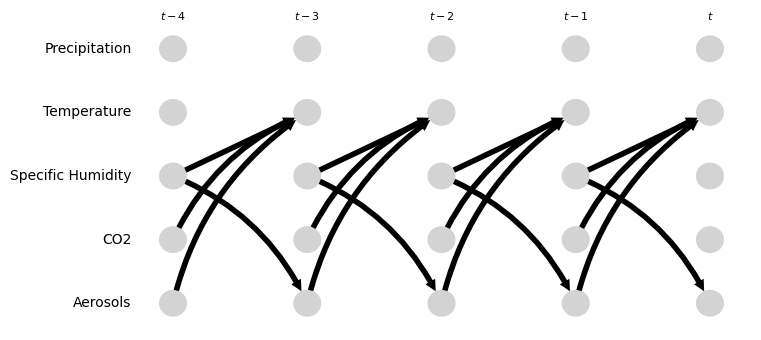

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.31 [0.77, 1.76]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.52 [-0.32, 1.63]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.69 [0.22, 2.37]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.57 [0.34, 0.80]
Negative precipitation values in event 144: 0


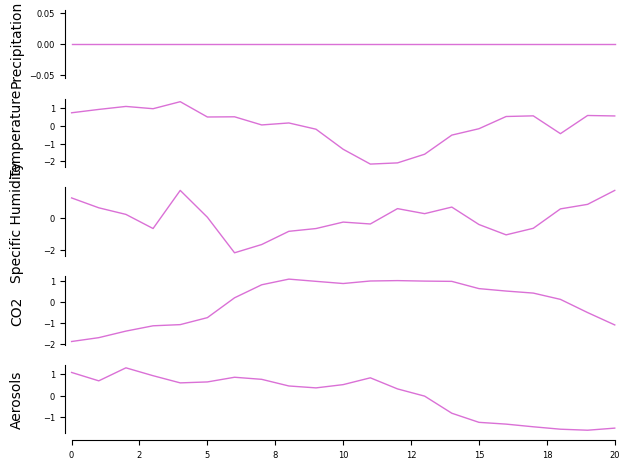

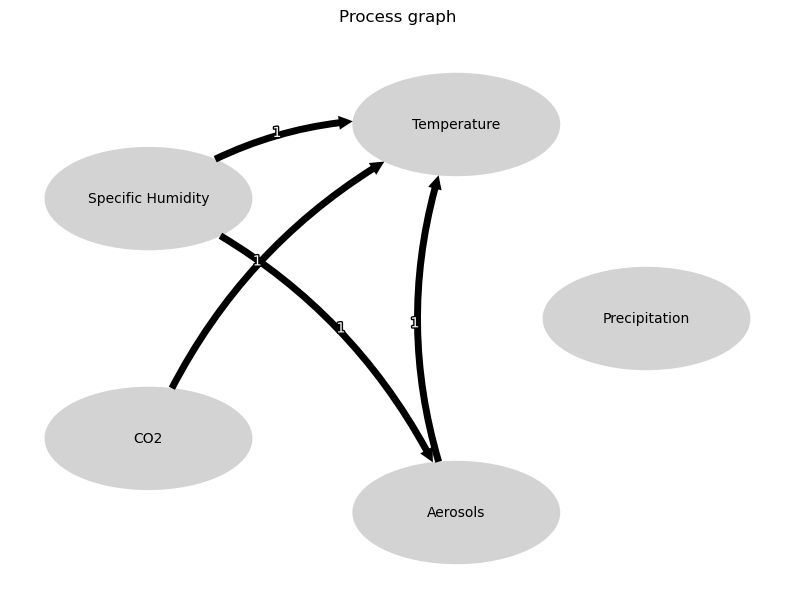


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





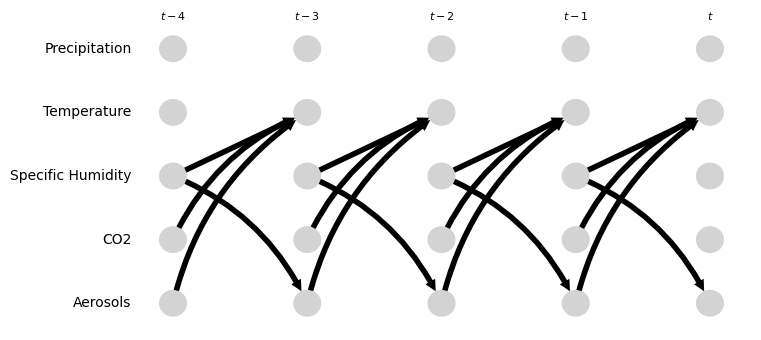

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.98 [-1.40, -0.07]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.46 [-0.92, -0.16]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.33 [-0.73, -0.05]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.23 [-0.62, 0.18]
Negative precipitation values in event 145: 0


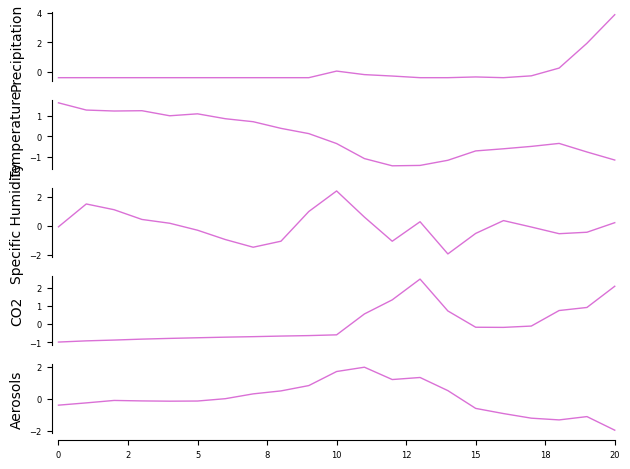

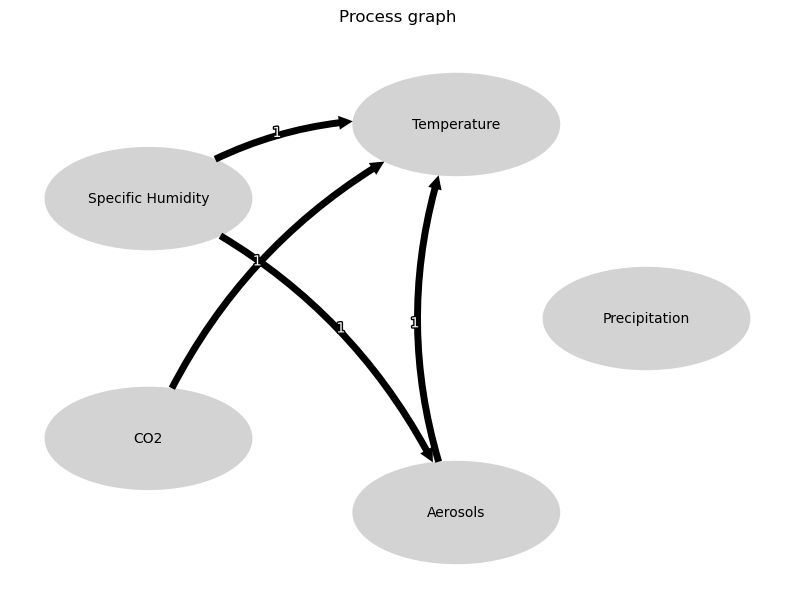


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





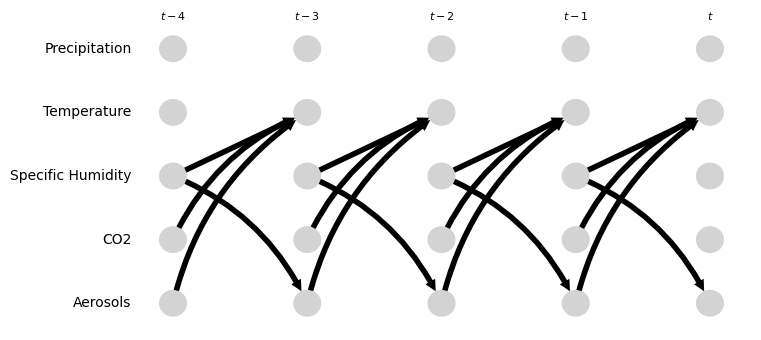

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.65 [-1.24, -0.37]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.07 [-0.26, 0.04]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.23 [-0.38, -0.01]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.42 [-0.12, 0.67]
Negative precipitation values in event 146: 0


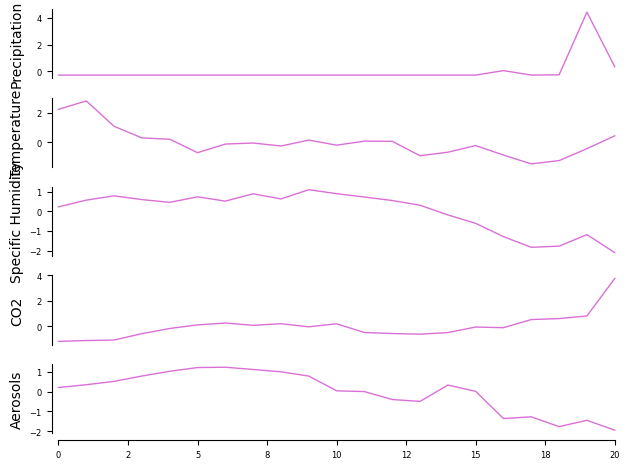

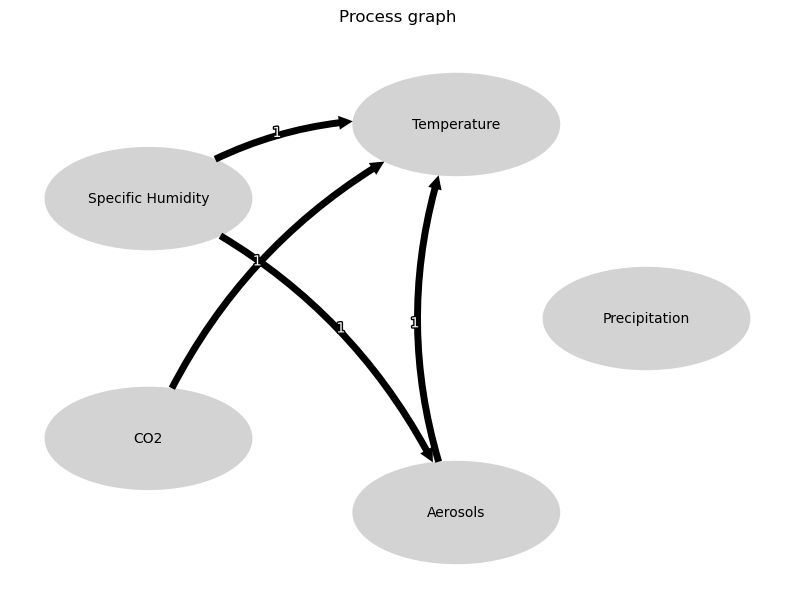


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





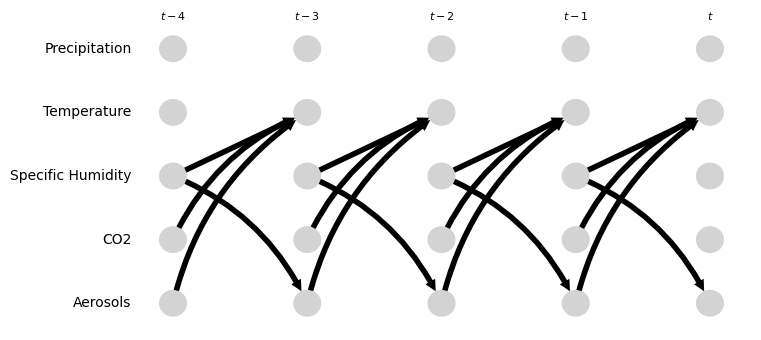

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.85 [-0.20, 1.14]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.14 [-0.26, 0.37]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.53 [0.07, 0.75]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.90 [0.68, 1.04]
Negative precipitation values in event 147: 0


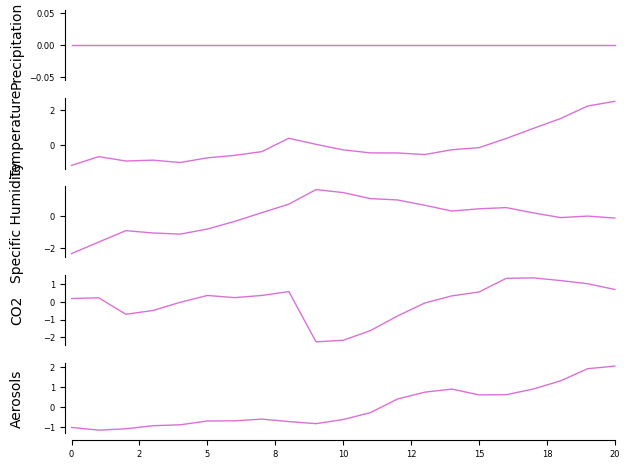

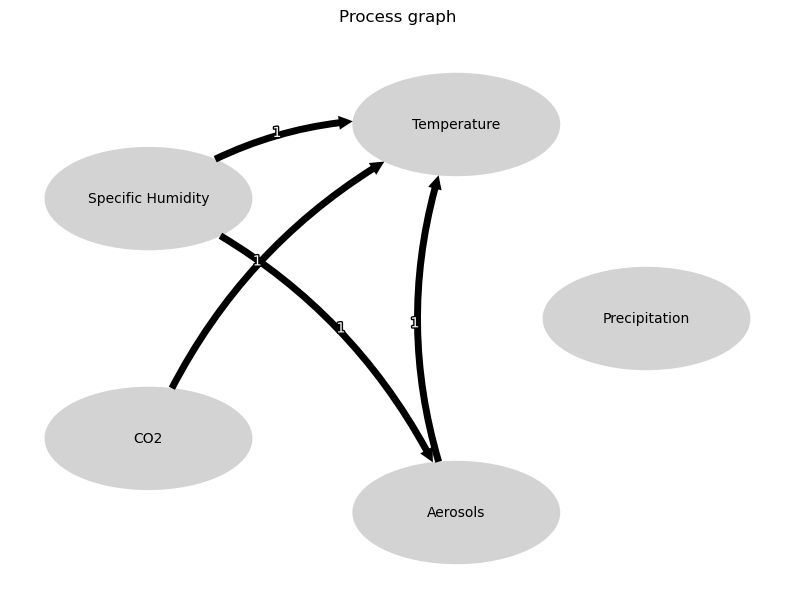


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





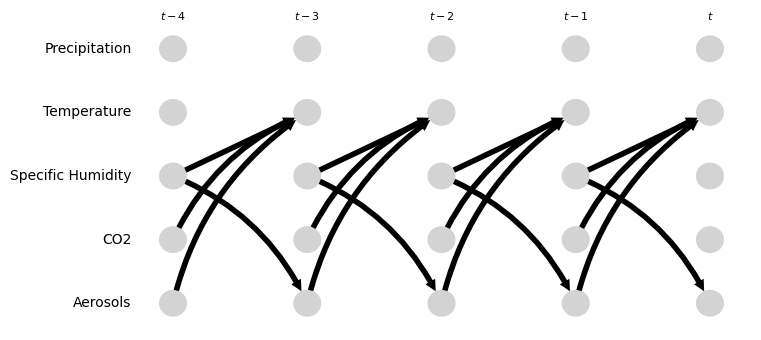

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.40 [0.25, 0.95]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.60 [-0.41, 0.91]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.22 [-0.02, 0.94]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.03 [-0.41, 0.53]
Negative precipitation values in event 148: 0


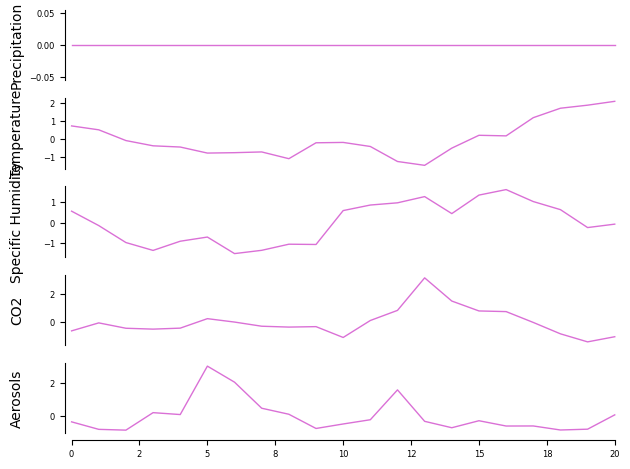

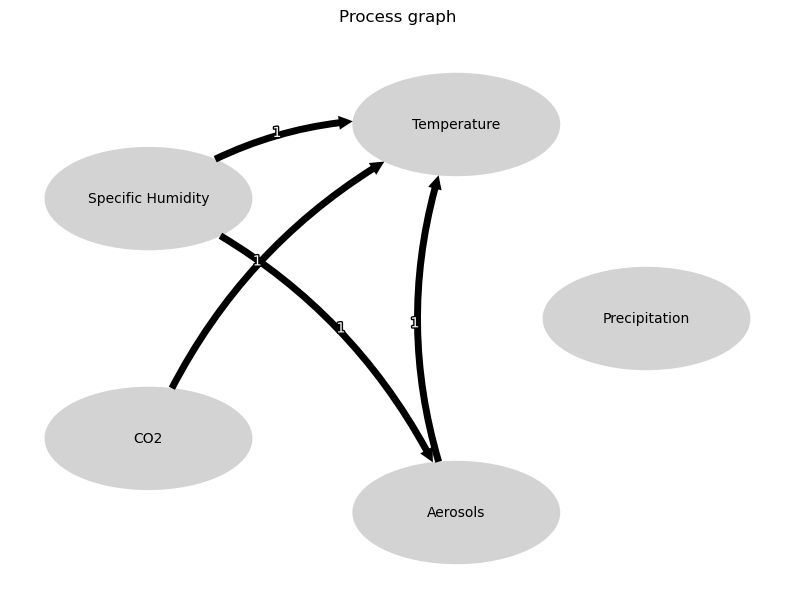


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





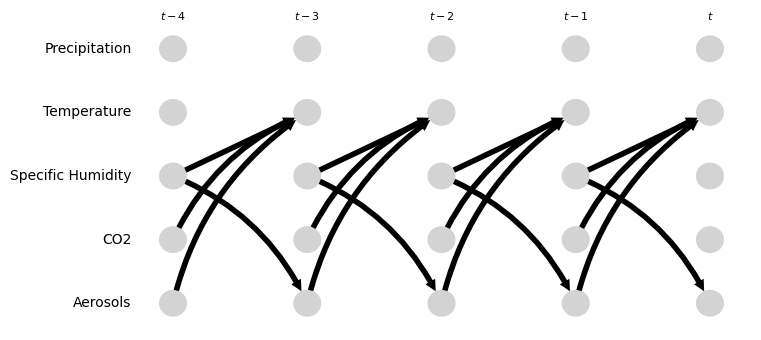

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.39 [-0.77, 0.12]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.42 [-0.80, -0.07]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.33 [0.02, 0.72]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.41 [-0.81, -0.07]
Negative precipitation values in event 149: 0


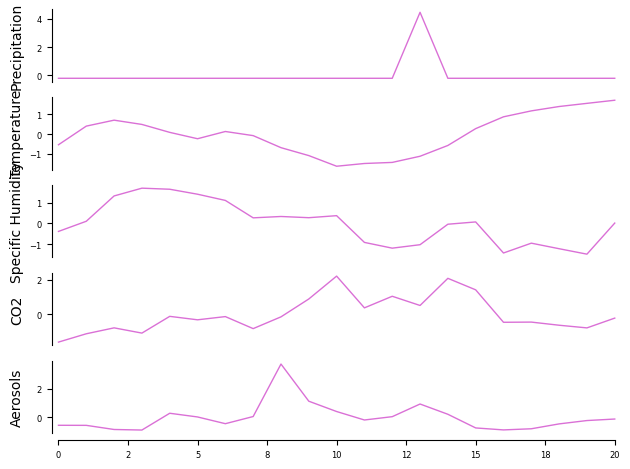

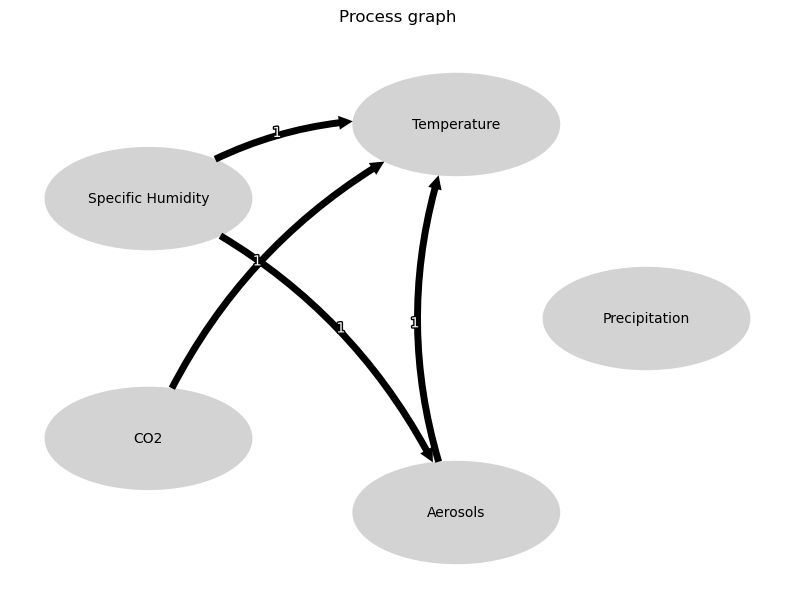


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





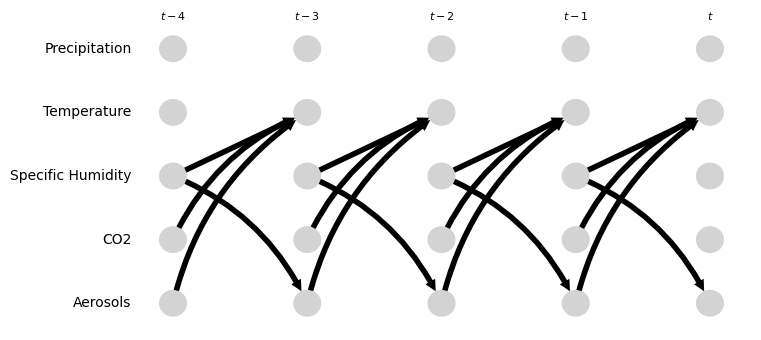

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.44 [-0.82, 0.07]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.49 [-1.38, -0.32]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.21 [-0.43, 0.20]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.13 [-0.15, 0.47]
Negative precipitation values in event 150: 0


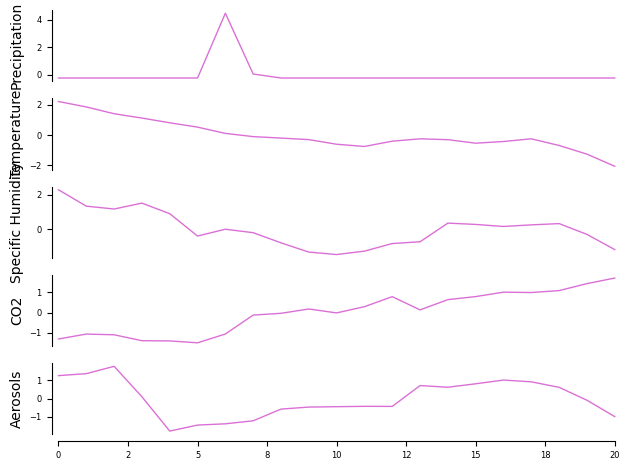

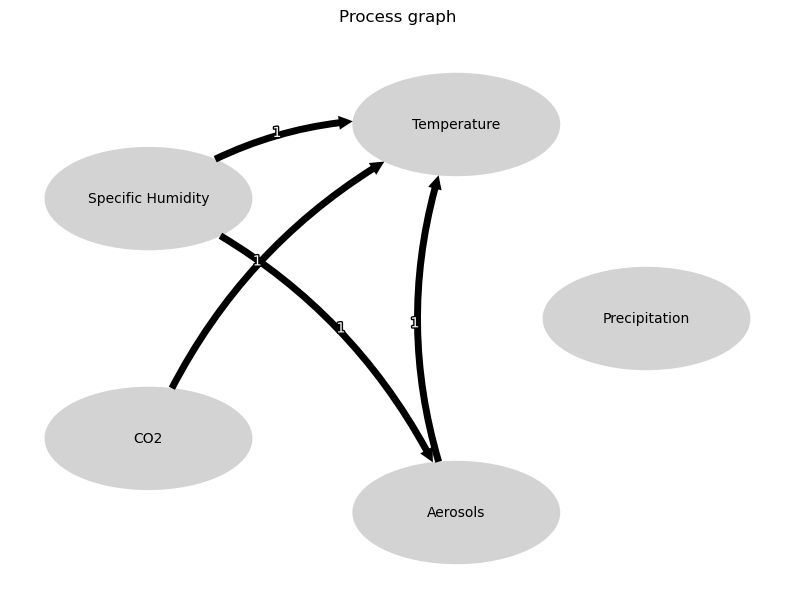


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





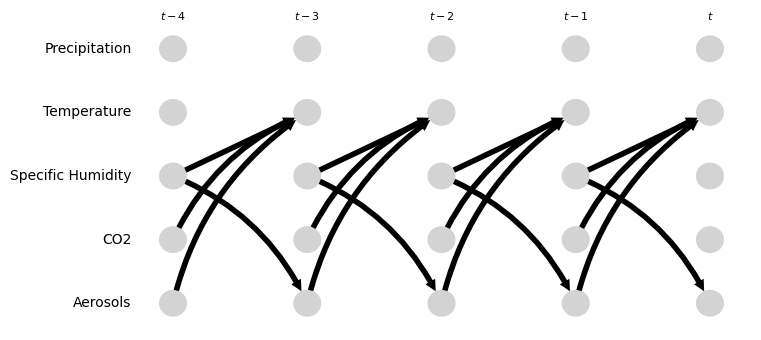

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.72 [-0.67, 0.06]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.27 [-0.37, 0.24]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.06 [-0.14, 0.28]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.10 [-0.27, 0.67]
Negative precipitation values in event 151: 0


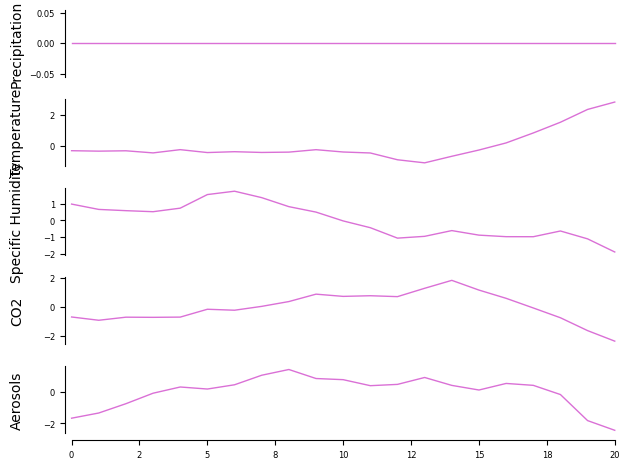

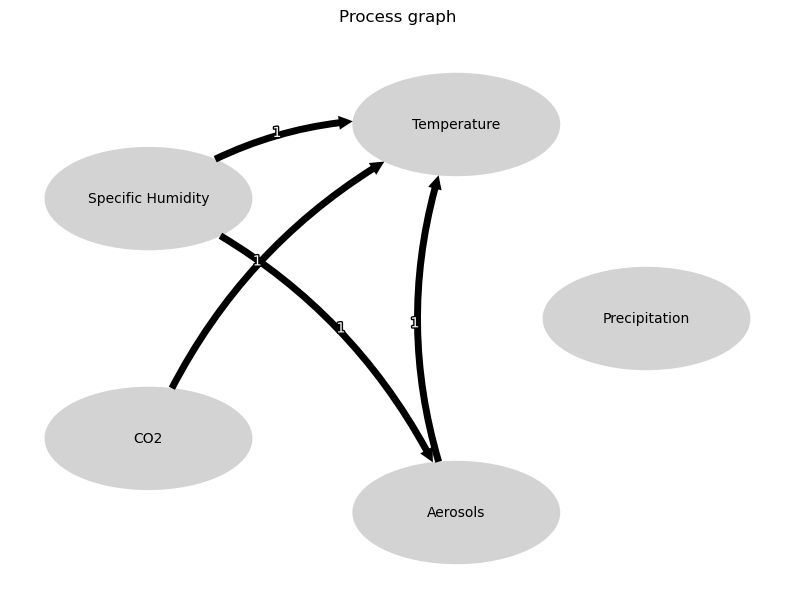


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





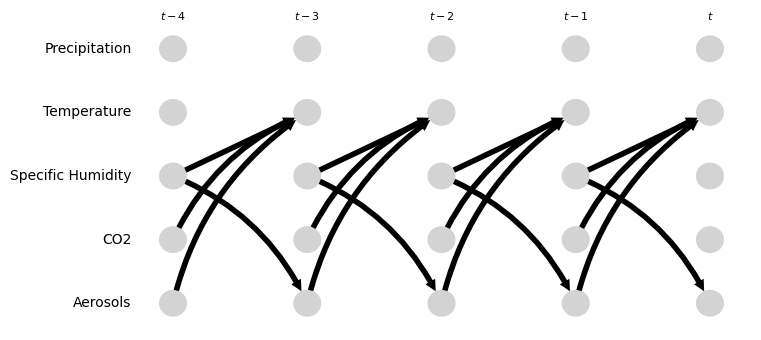

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.85 [-1.65, -0.23]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.23 [-1.12, 0.77]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.56 [-0.84, -0.10]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.47 [0.08, 0.56]
Negative precipitation values in event 152: 0


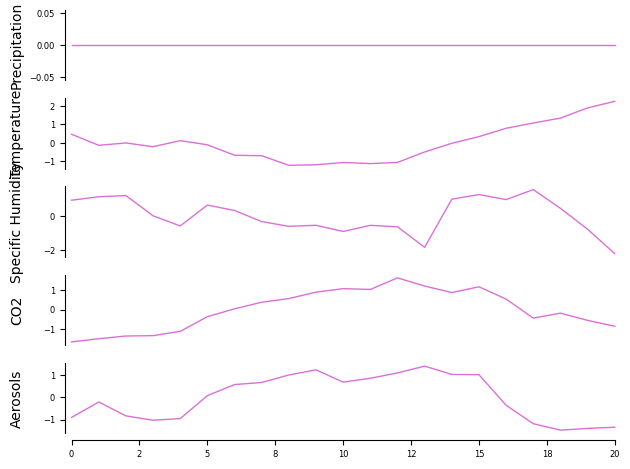

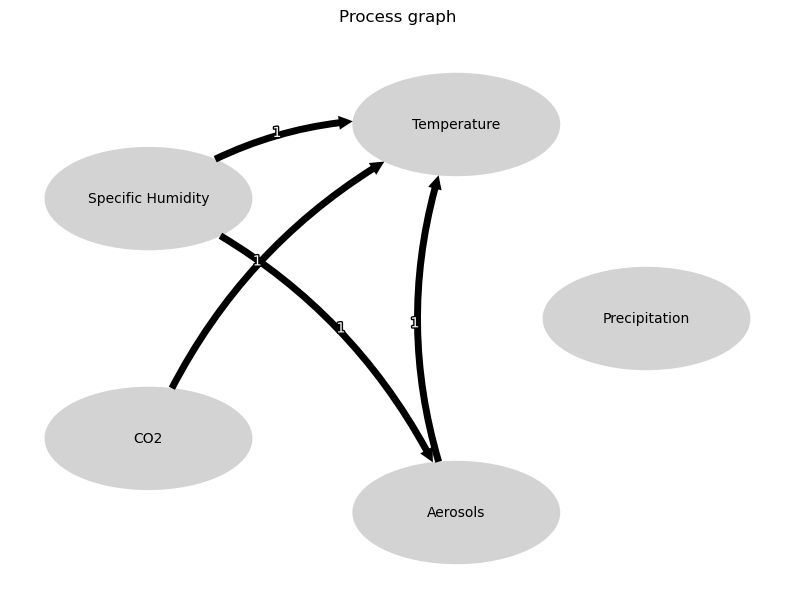


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





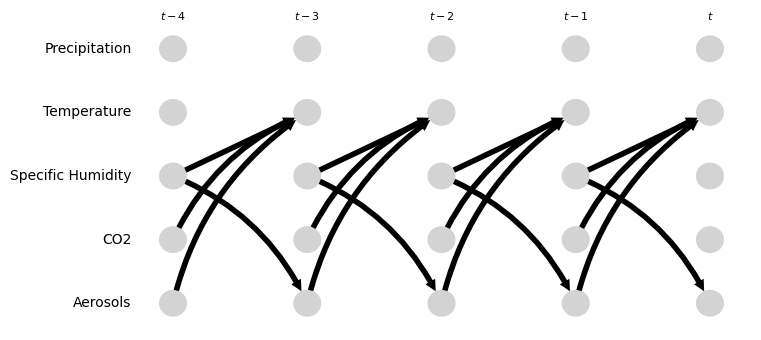

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.01 [0.58, 1.35]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.42 [-1.51, -0.68]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.23 [-0.05, 0.95]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.57 [-1.05, -0.44]
Negative precipitation values in event 153: 0


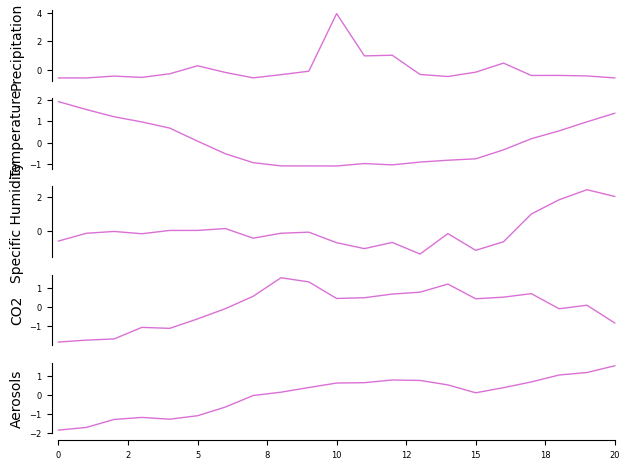

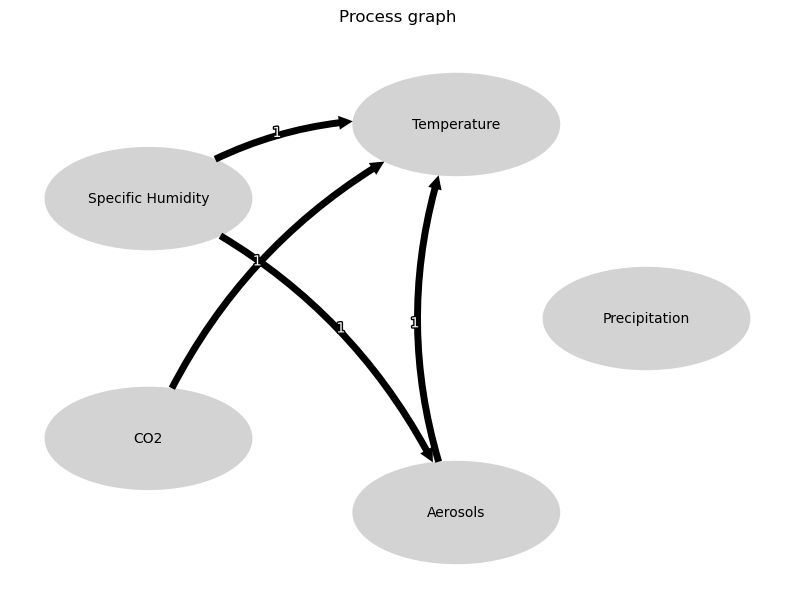


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





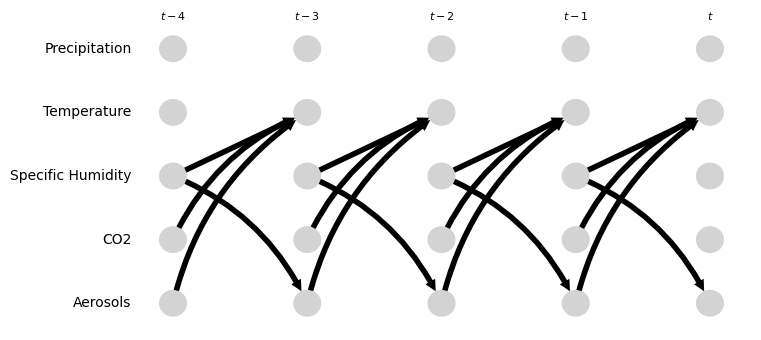

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.59 [-0.86, -0.25]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.48 [0.14, 0.82]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.43 [-0.01, 0.64]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.23 [-0.40, 0.28]
Negative precipitation values in event 154: 0


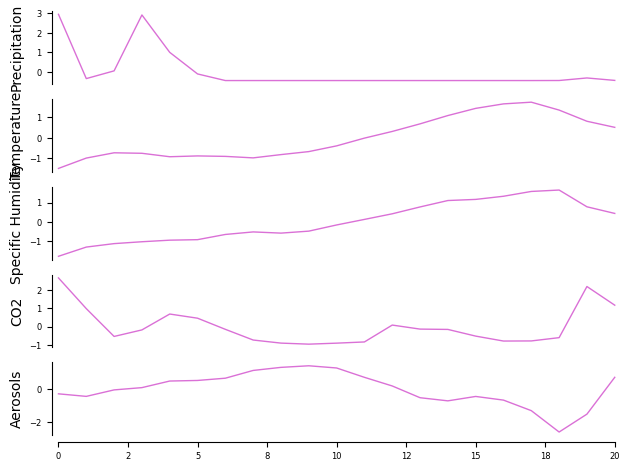

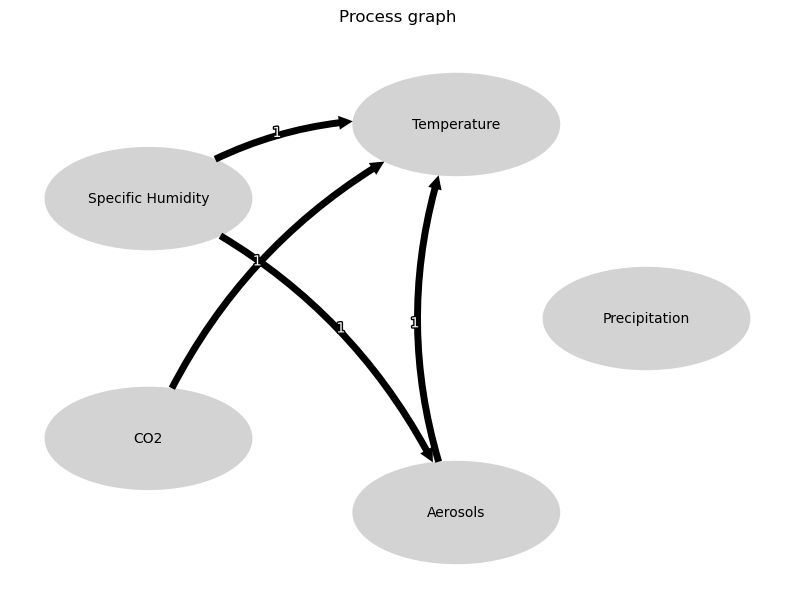


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





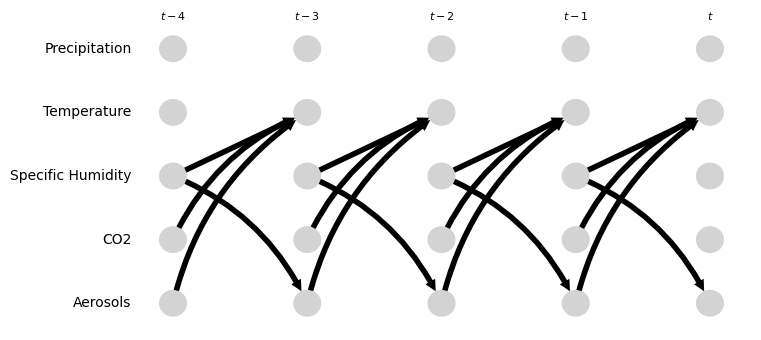

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.26 [0.38, 0.86]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.58 [0.43, 0.86]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.65 [1.62, 2.14]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.11 [-1.46, -0.92]
Negative precipitation values in event 155: 0


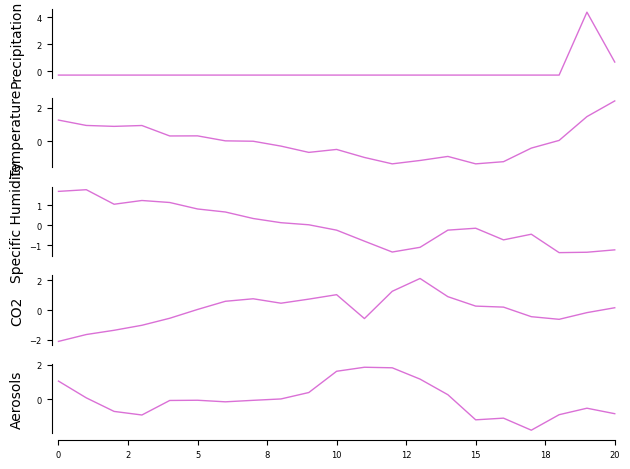

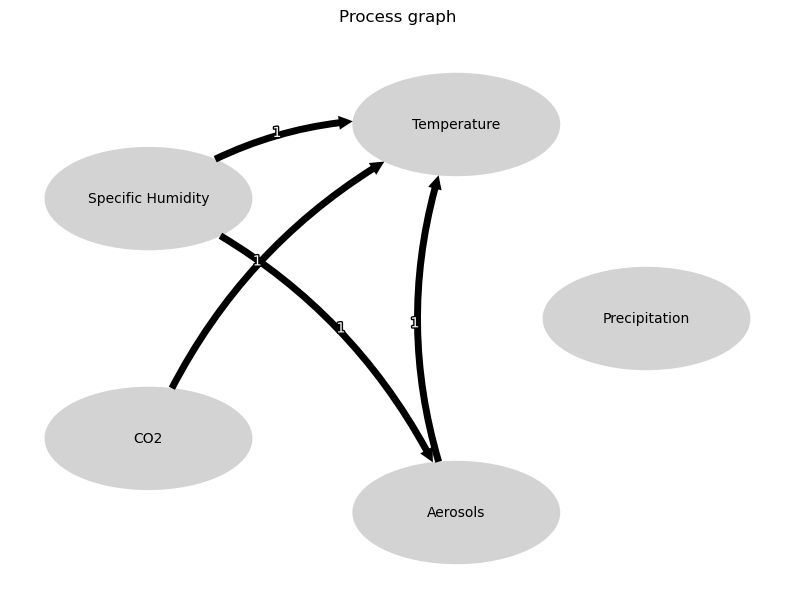


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





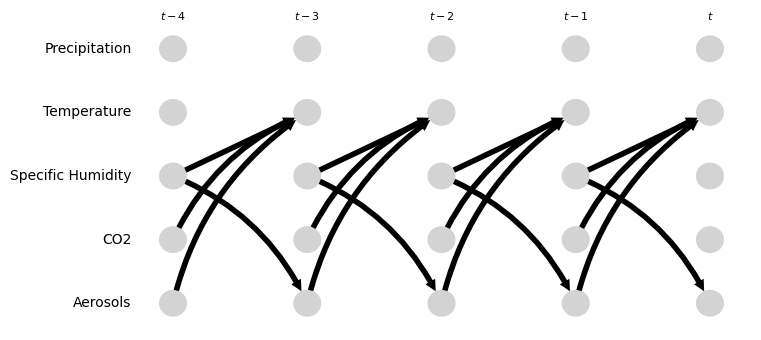

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.48 [-1.25, 0.10]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.32 [-0.50, 0.30]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.30 [-0.39, 0.56]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.03 [-0.44, 0.36]
Negative precipitation values in event 156: 0


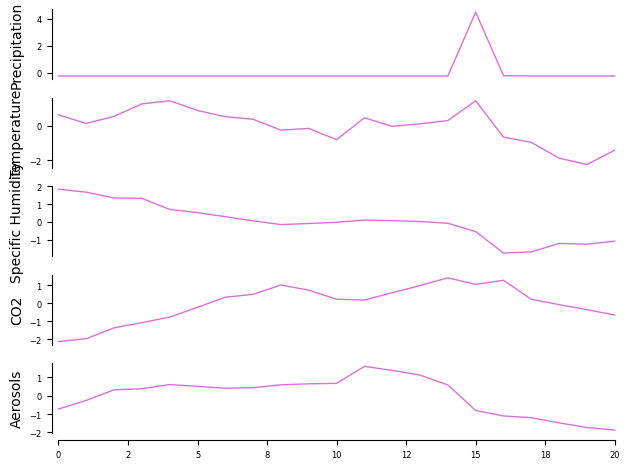

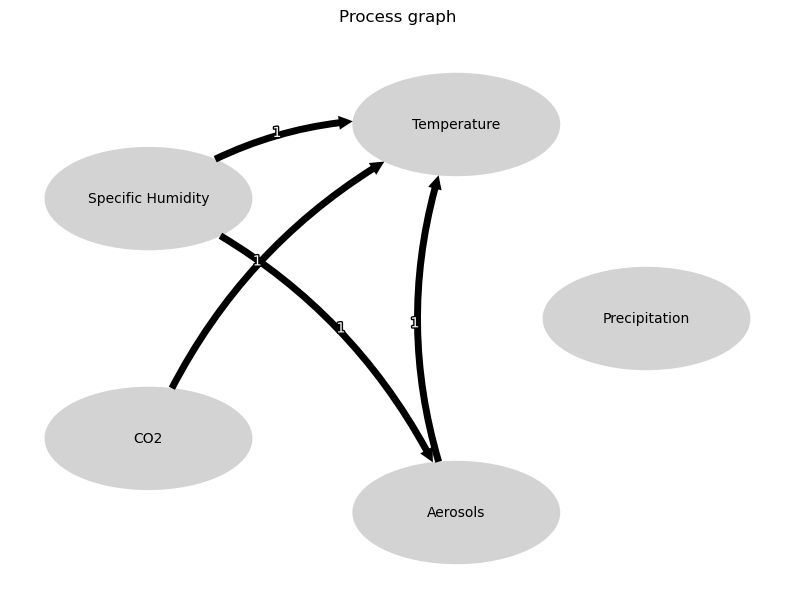


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





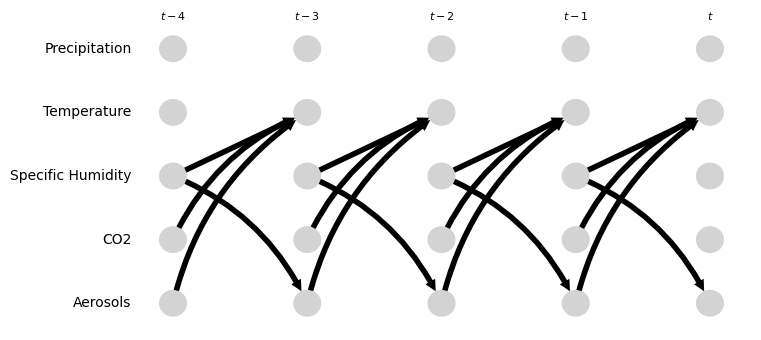

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.45 [-0.07, 1.09]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.00 [-0.70, 0.35]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.16 [0.62, 1.94]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.21 [0.87, 1.50]
Negative precipitation values in event 157: 0


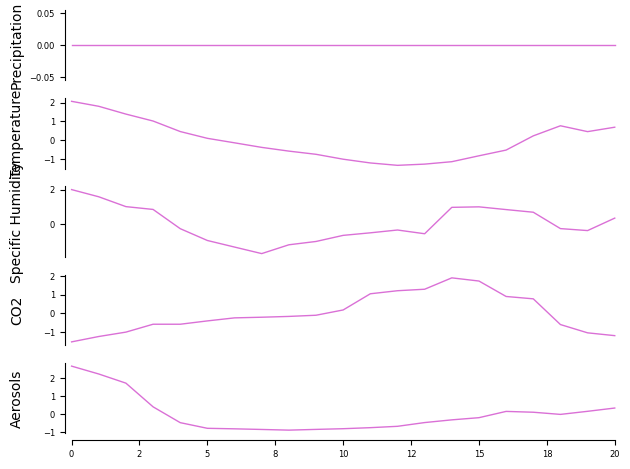

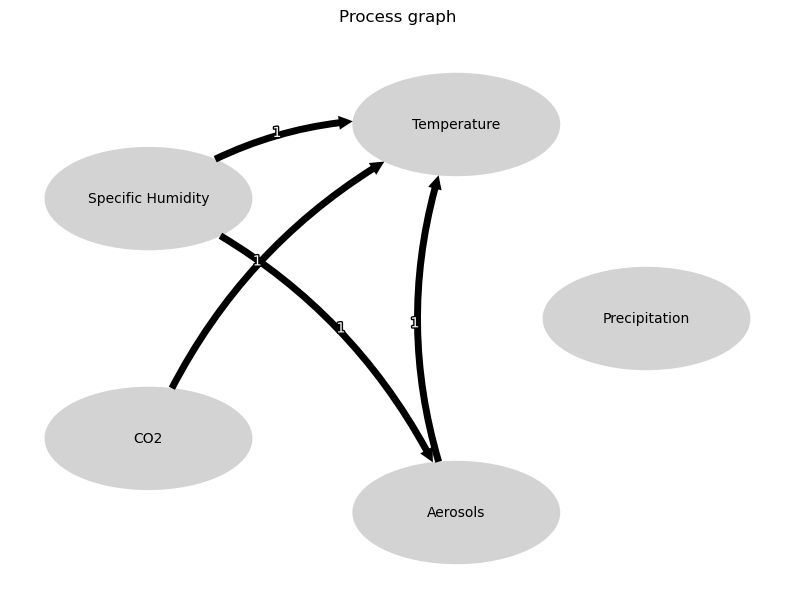


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





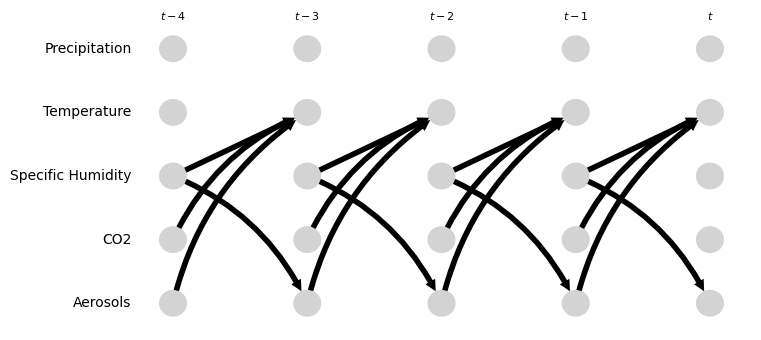

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.53 [-0.79, -0.31]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.14 [0.66, 2.41]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.21 [-0.33, 0.43]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.39 [0.33, 0.48]
Negative precipitation values in event 158: 0


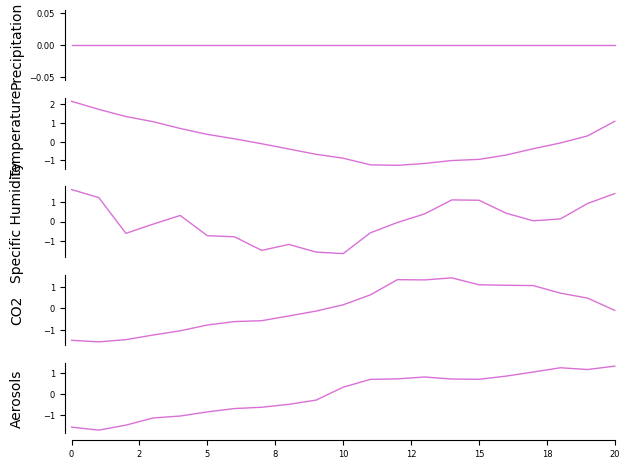

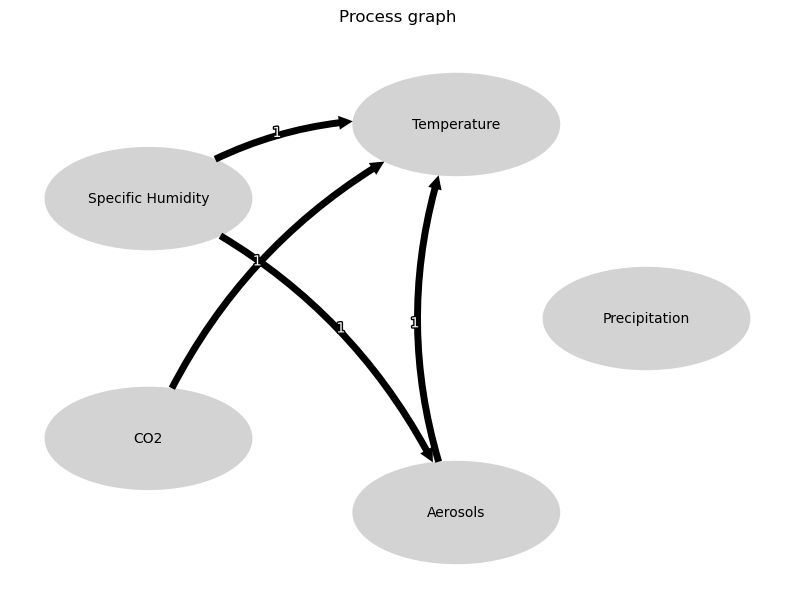


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





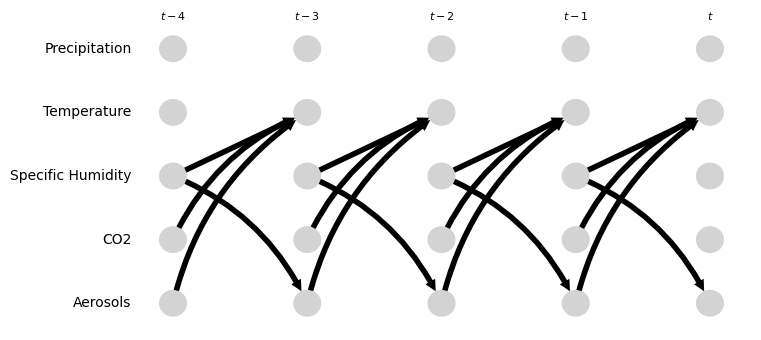

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.53 [-1.84, -0.74]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.03 [0.10, 1.35]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.54 [0.33, 0.81]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.38 [0.13, 0.60]
Negative precipitation values in event 159: 0


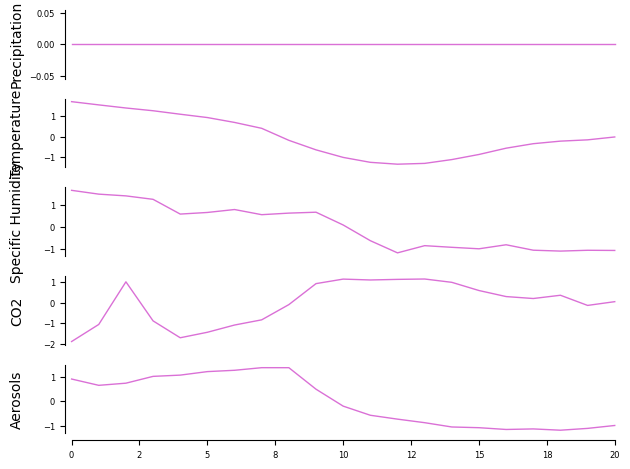

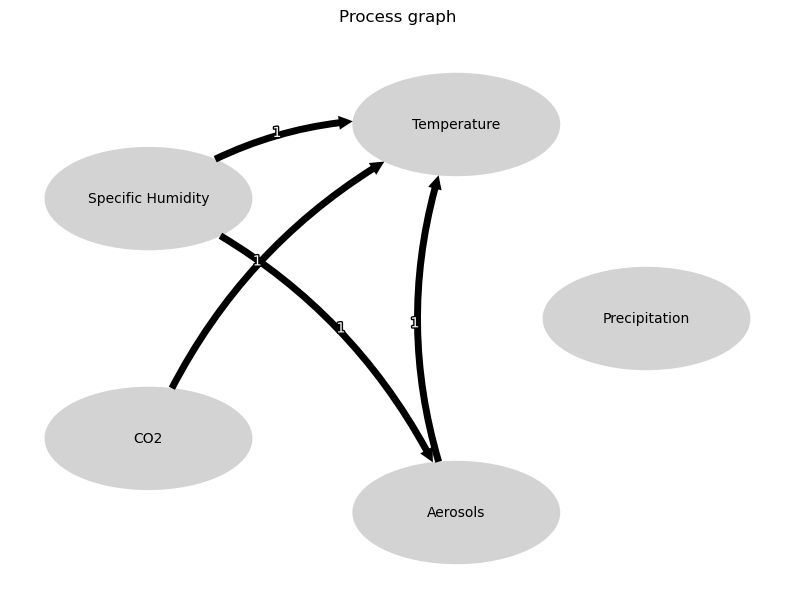


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





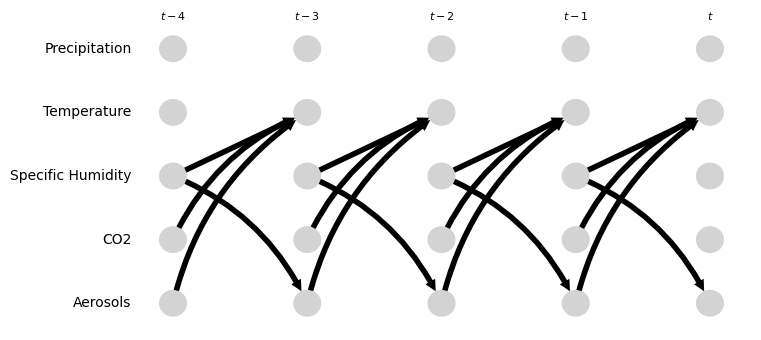

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.92 [-1.00, -0.88]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.55 [-0.72, -0.43]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.38 [0.17, 0.59]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.15 [0.92, 1.37]
Negative precipitation values in event 160: 0


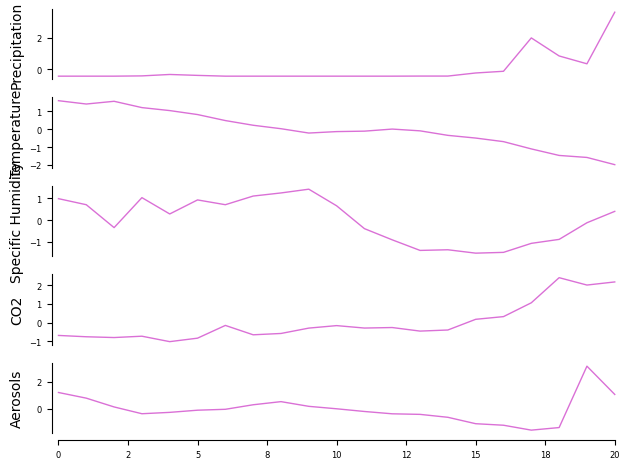

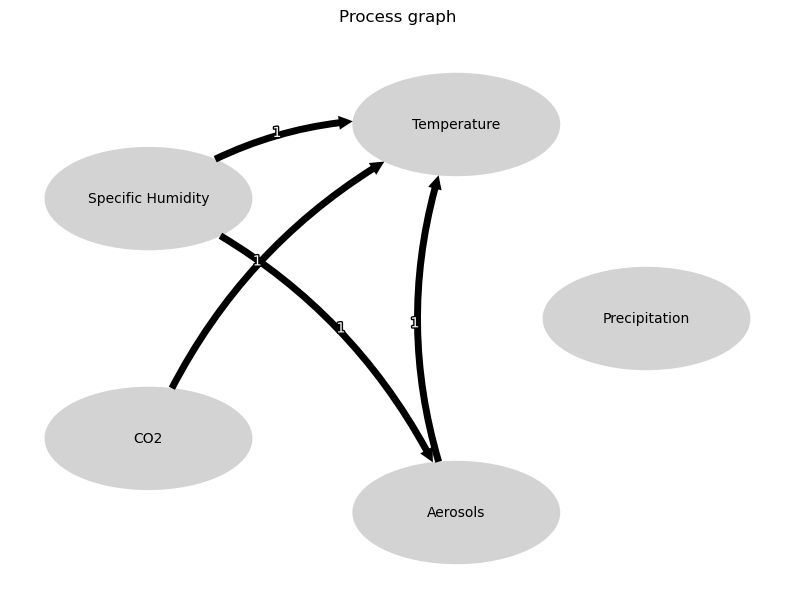


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





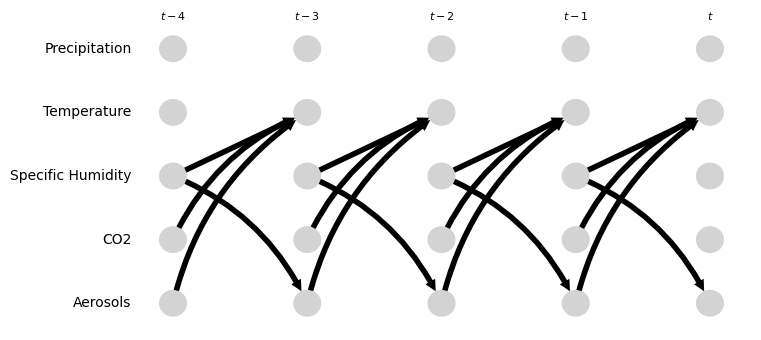

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.63 [-1.13, -0.15]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.10 [-0.65, 0.79]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.20 [-0.10, 0.42]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.35 [-0.02, 0.59]
Negative precipitation values in event 161: 0


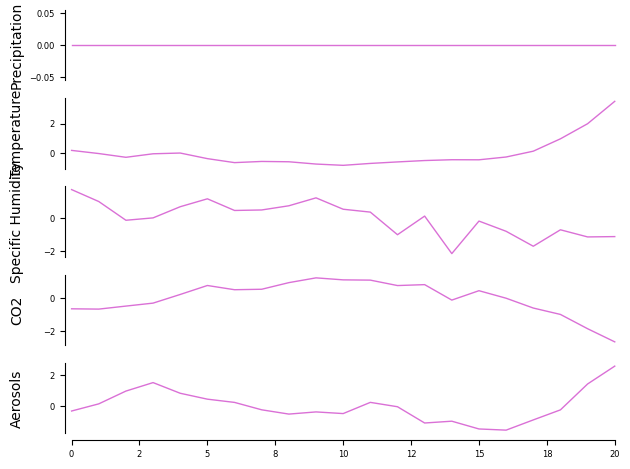

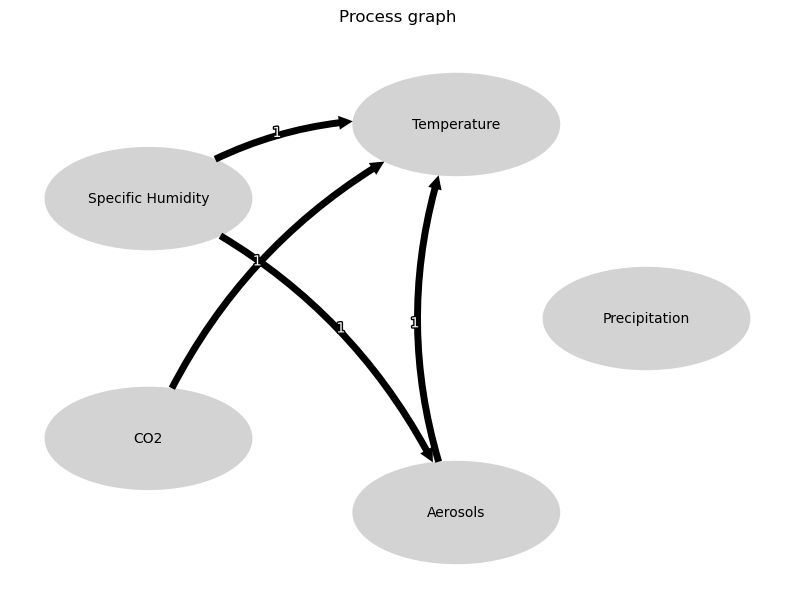


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





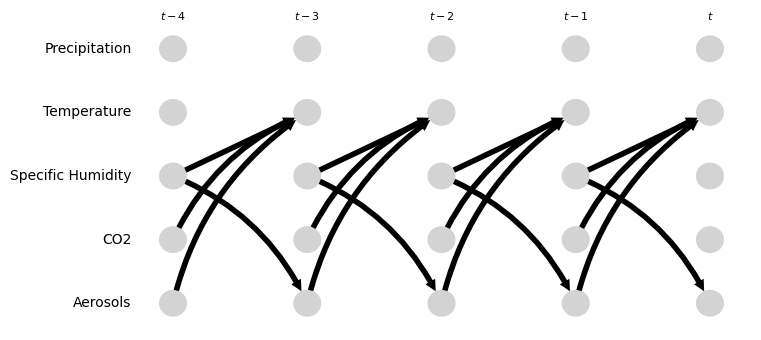

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.42 [-1.83, -0.51]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.07 [-0.42, 0.16]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.19 [-0.14, 0.51]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.05 [-0.03, 0.48]
Negative precipitation values in event 162: 0


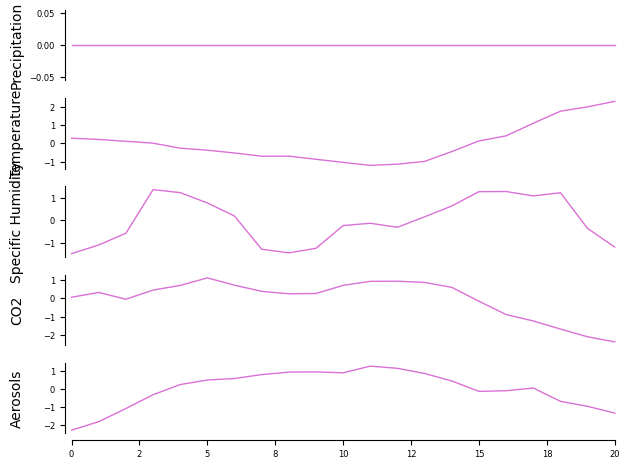

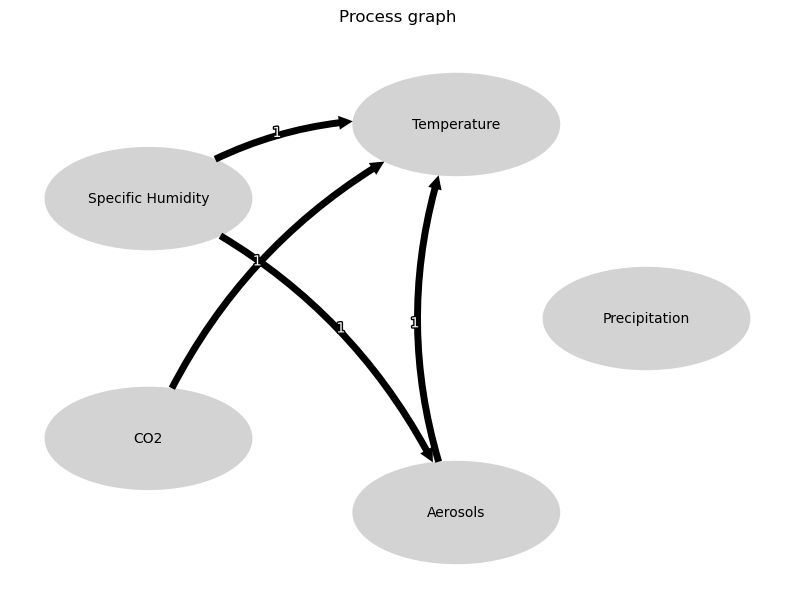


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





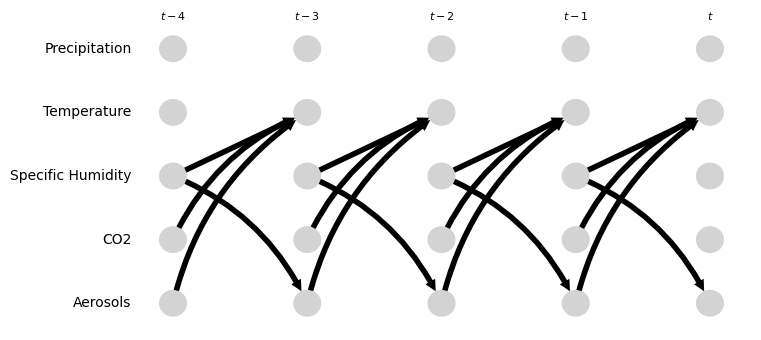

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.82 [-1.07, -0.49]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.37 [-0.80, 0.35]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.29 [0.19, 0.57]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.42 [-0.74, -0.35]
Negative precipitation values in event 163: 0


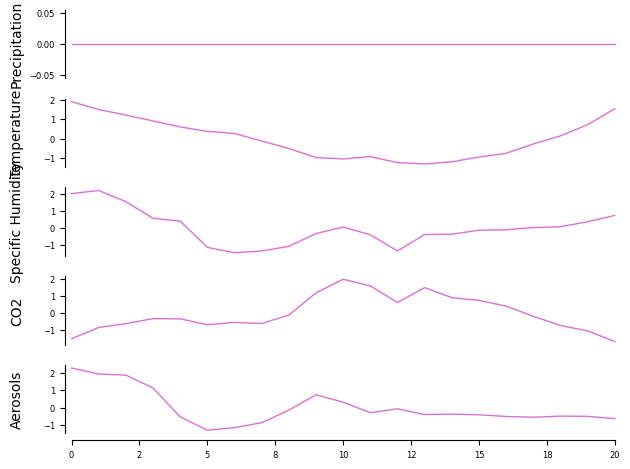

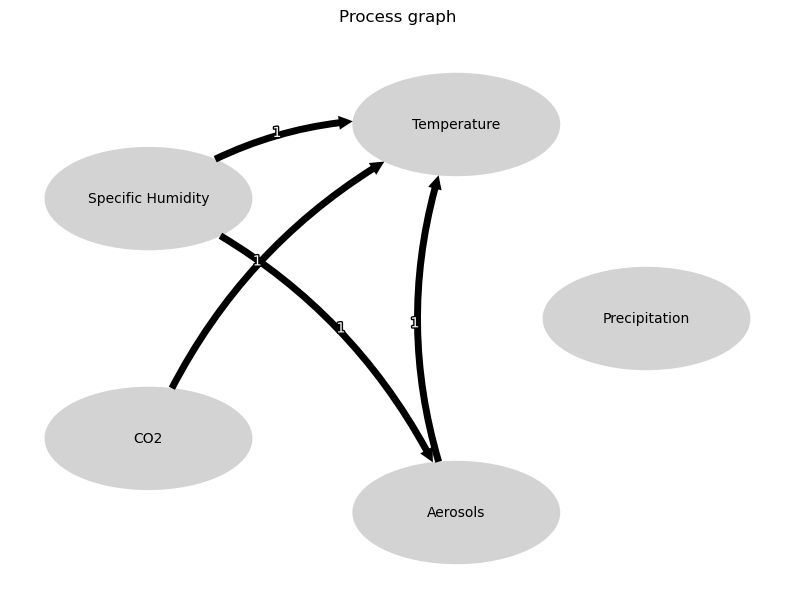


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





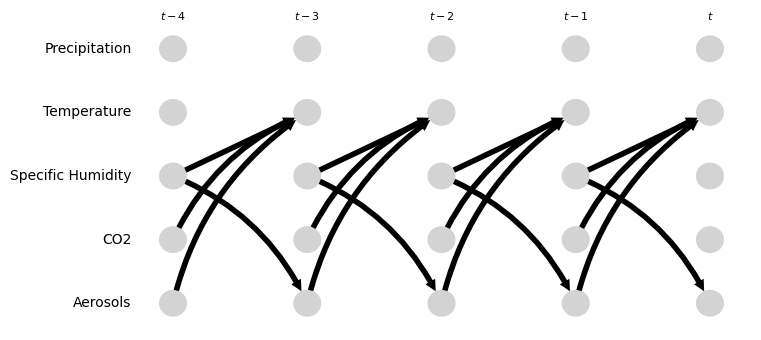

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.68 [-0.72, -0.38]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.22 [-0.61, -0.05]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.72 [0.45, 0.79]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.16 [-0.43, 0.20]
Negative precipitation values in event 164: 0


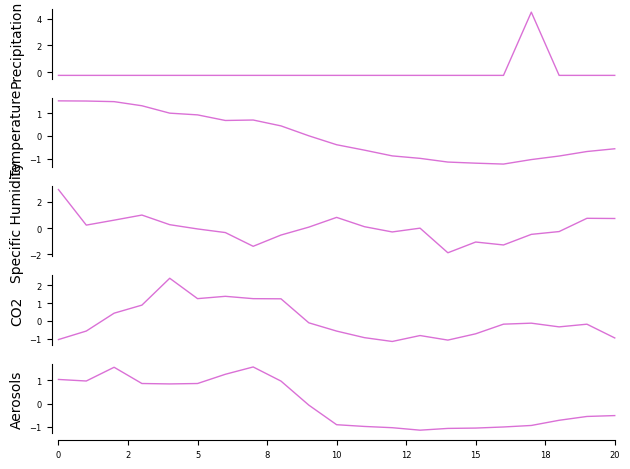

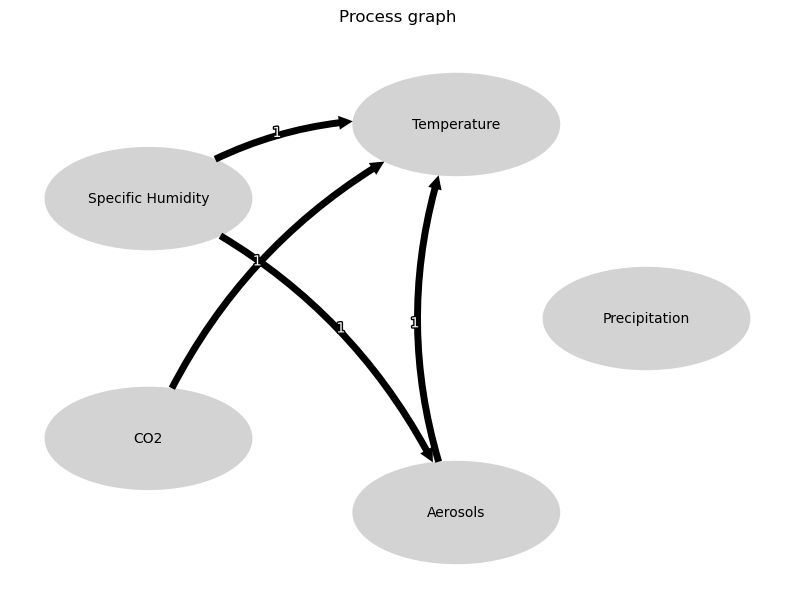


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





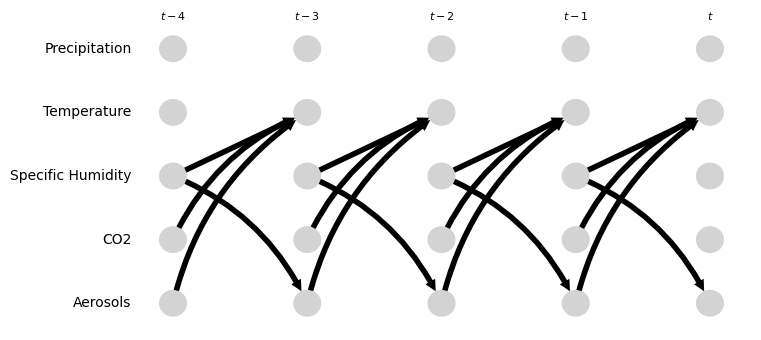

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.29 [0.02, 0.35]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.42 [0.34, 0.63]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.18 [0.13, 0.31]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.02 [-0.59, 0.58]
Negative precipitation values in event 165: 0


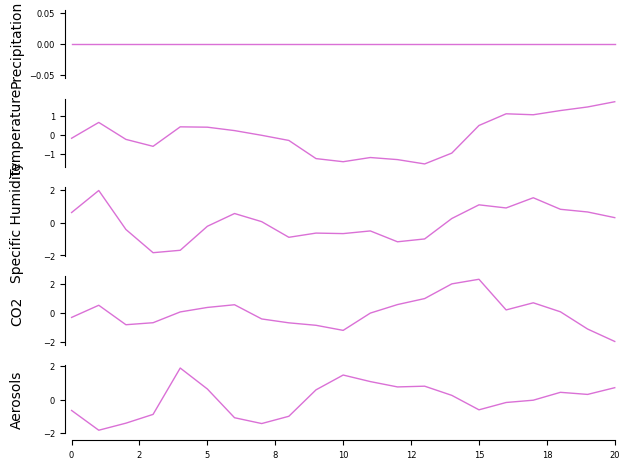

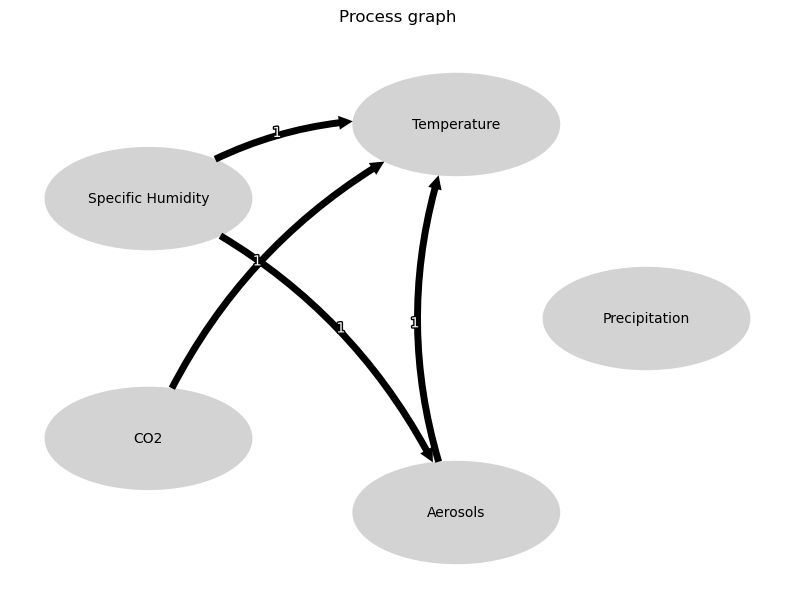


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





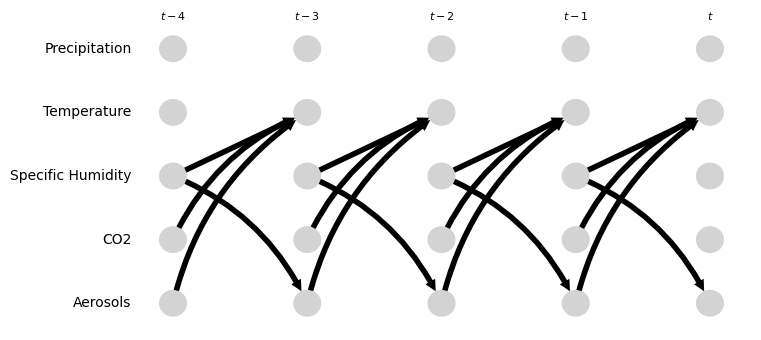

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.06 [-0.07, 0.54]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.37 [-0.07, 0.99]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.10 [0.63, 1.35]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.33 [-0.66, -0.18]
Negative precipitation values in event 166: 0


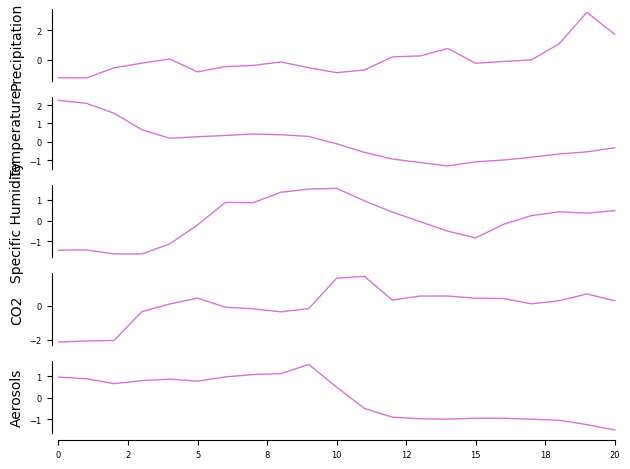

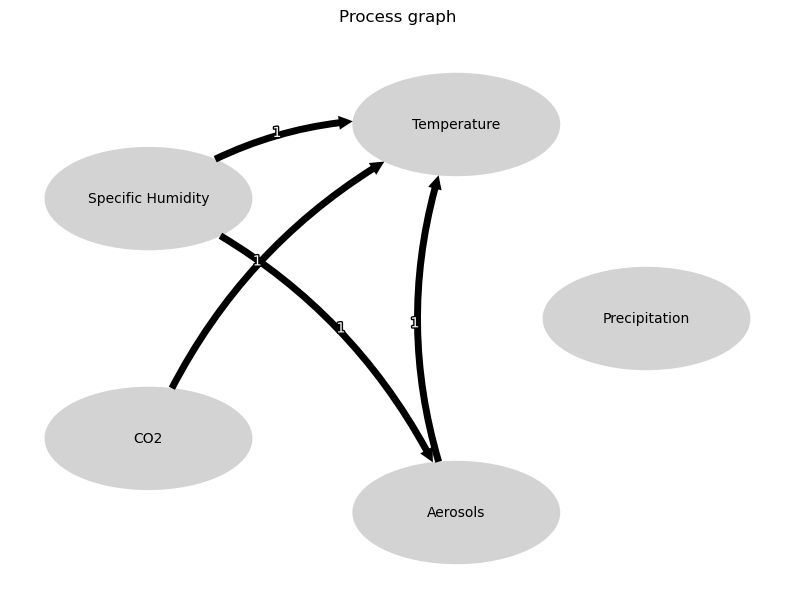


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





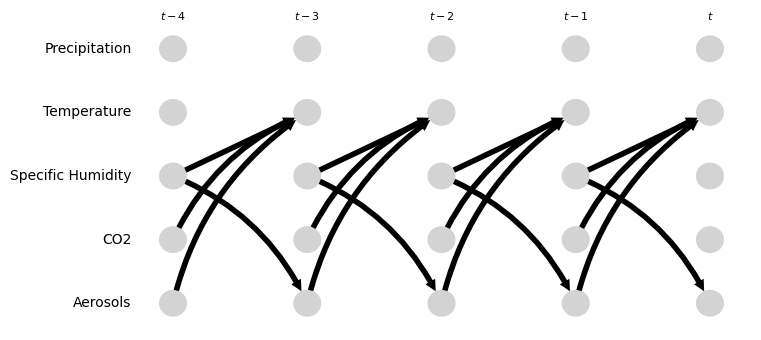

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.23 [-0.59, -0.06]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.46 [0.39, 0.71]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.07 [-0.34, 0.08]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.34 [-0.04, 0.96]
Negative precipitation values in event 167: 0


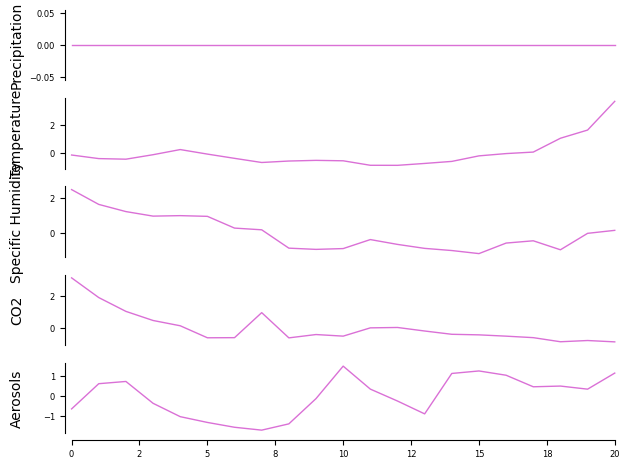

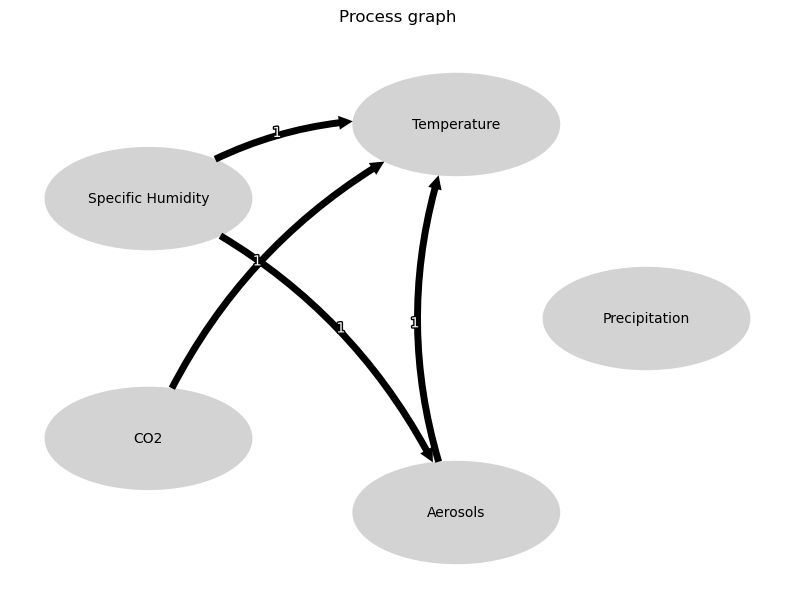


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





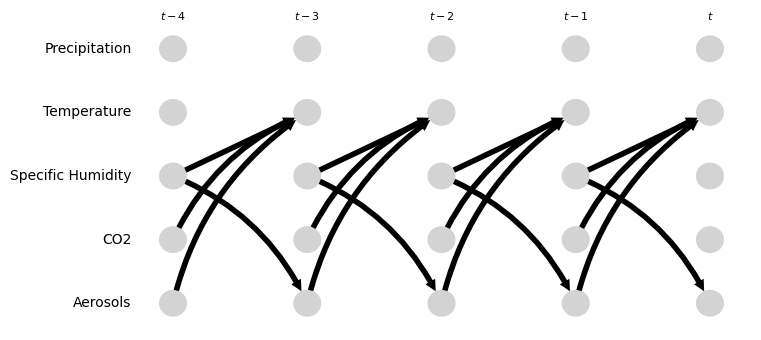

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.09 [-1.99, -0.03]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.32 [-0.19, 0.44]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.59 [-0.45, 0.51]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.22 [-1.89, -1.11]
Negative precipitation values in event 168: 0


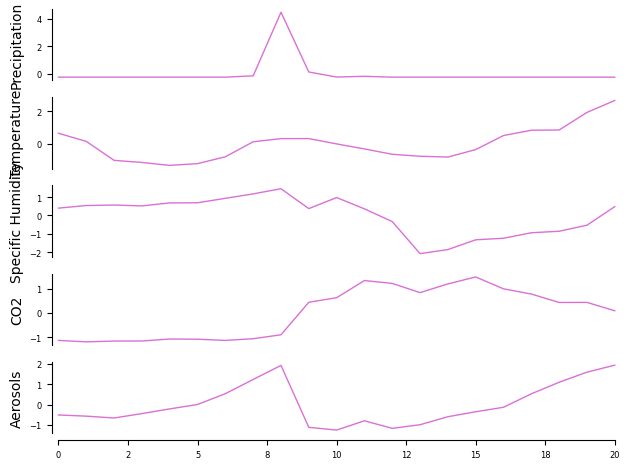

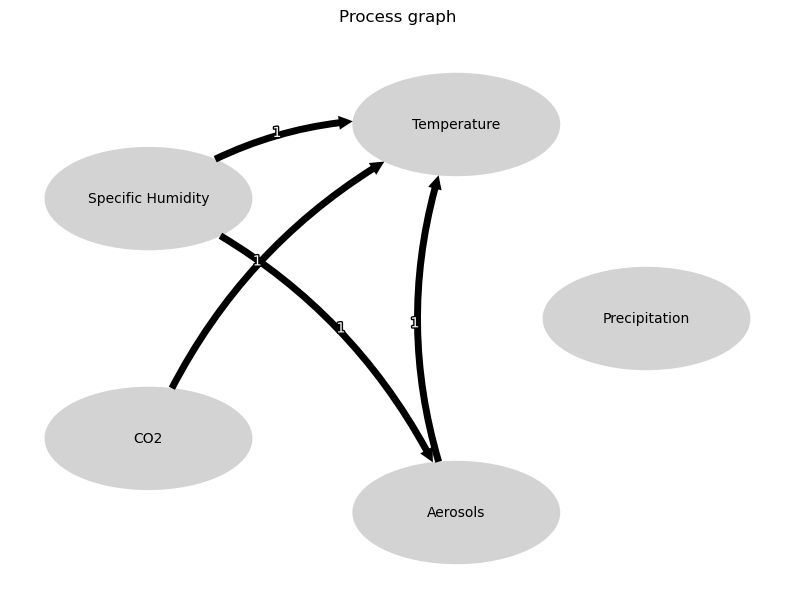


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





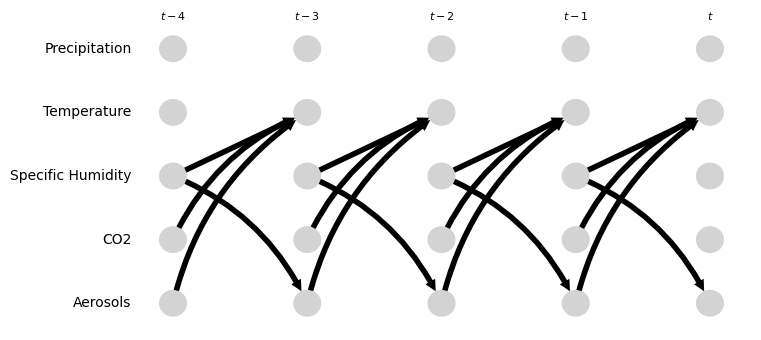

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.66 [0.10, 0.84]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.99 [0.49, 1.31]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.01 [-0.43, 0.32]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.04 [-0.46, 0.36]
Negative precipitation values in event 169: 0


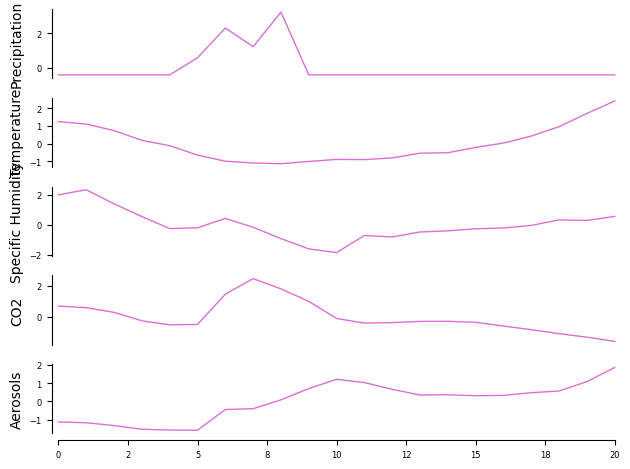

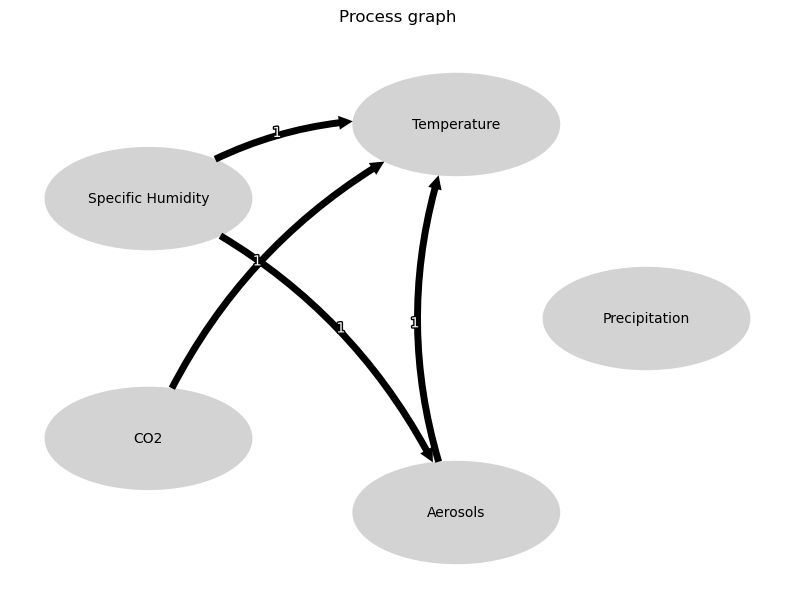


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





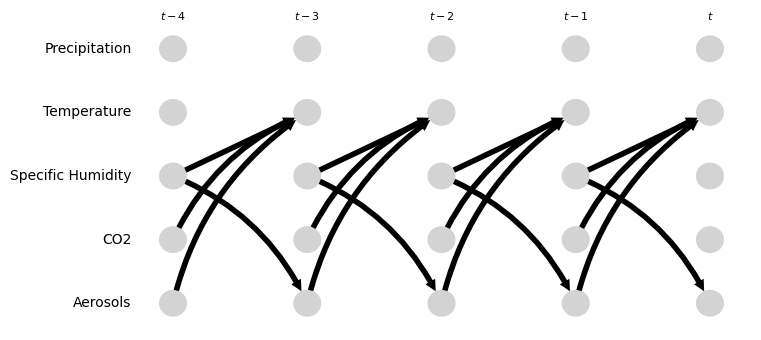

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.42 [-0.68, -0.07]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.64 [-0.16, 0.76]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.99 [0.25, 1.58]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.28 [-0.86, -0.11]
Negative precipitation values in event 170: 0


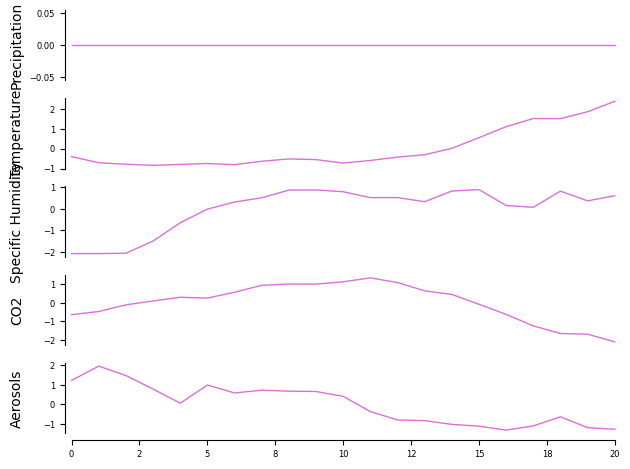

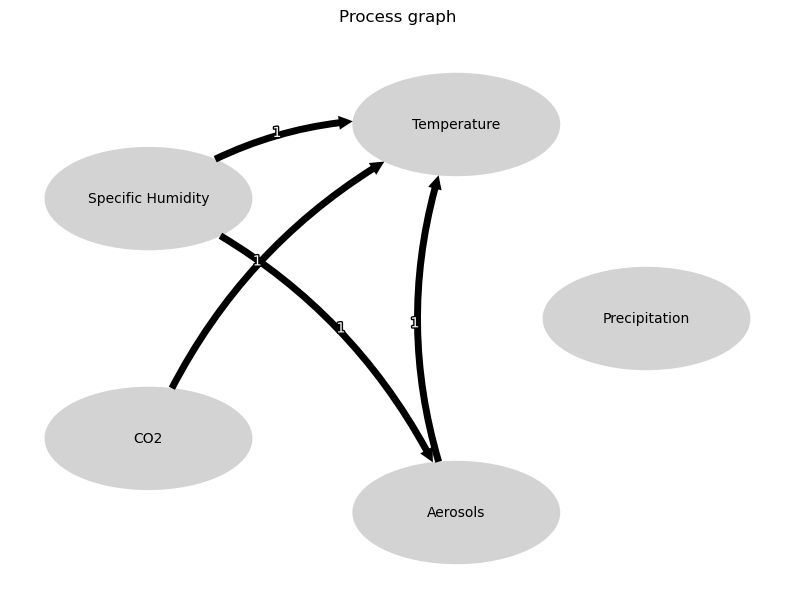


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





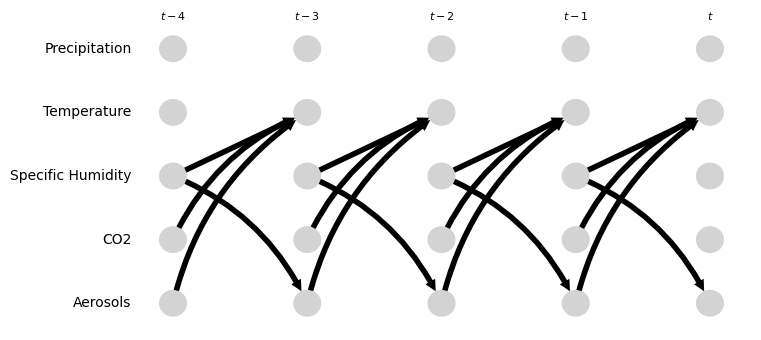

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.77 [-0.86, -0.66]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.52 [-0.62, -0.41]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.58 [0.35, 0.71]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.70 [-1.40, 0.54]
Negative precipitation values in event 171: 0


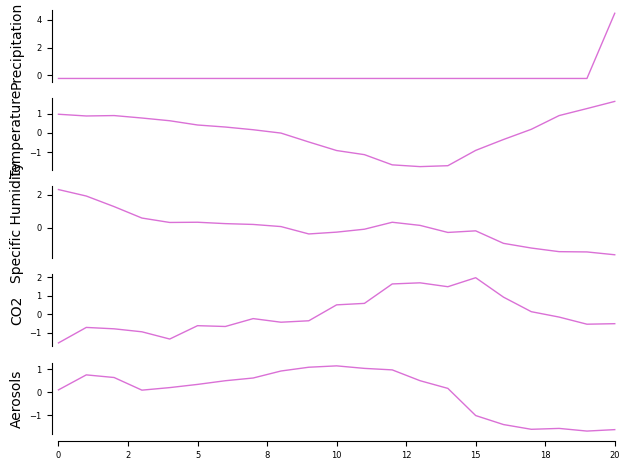

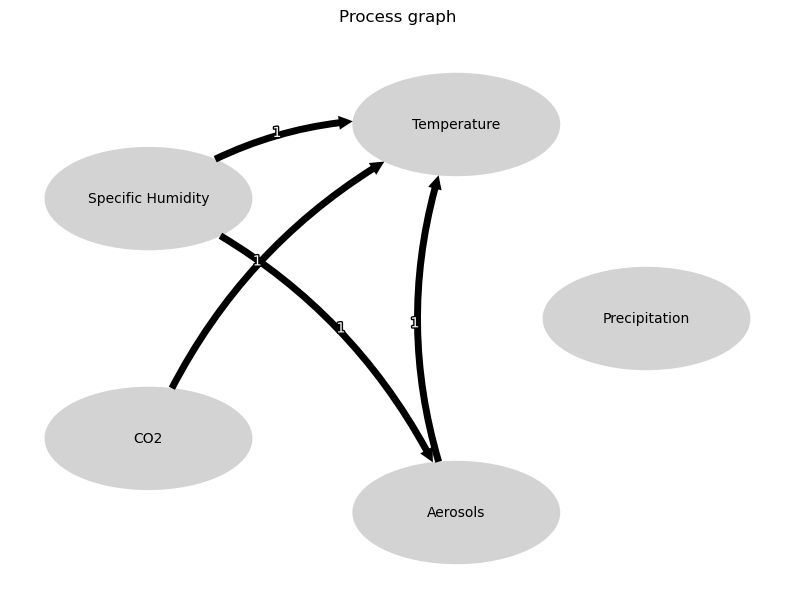


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





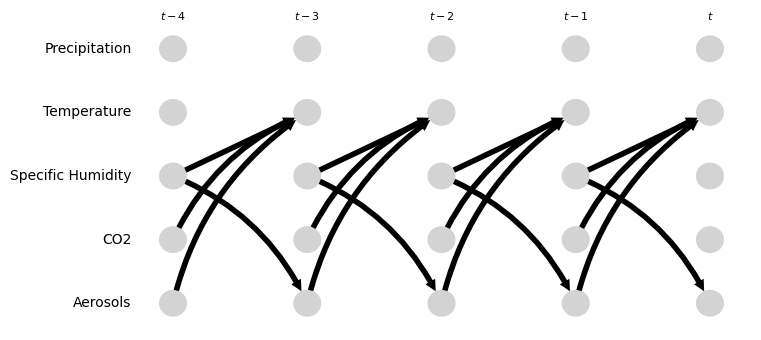

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.64 [-0.78, -0.53]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.85 [-1.03, -0.65]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.19 [-0.04, 0.56]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.39 [1.13, 1.68]
Negative precipitation values in event 172: 0


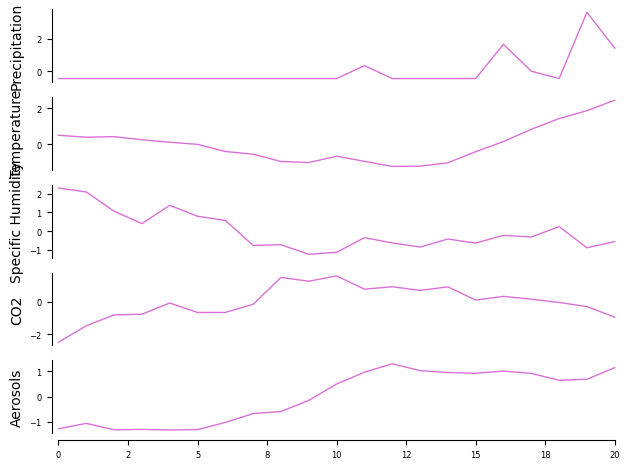

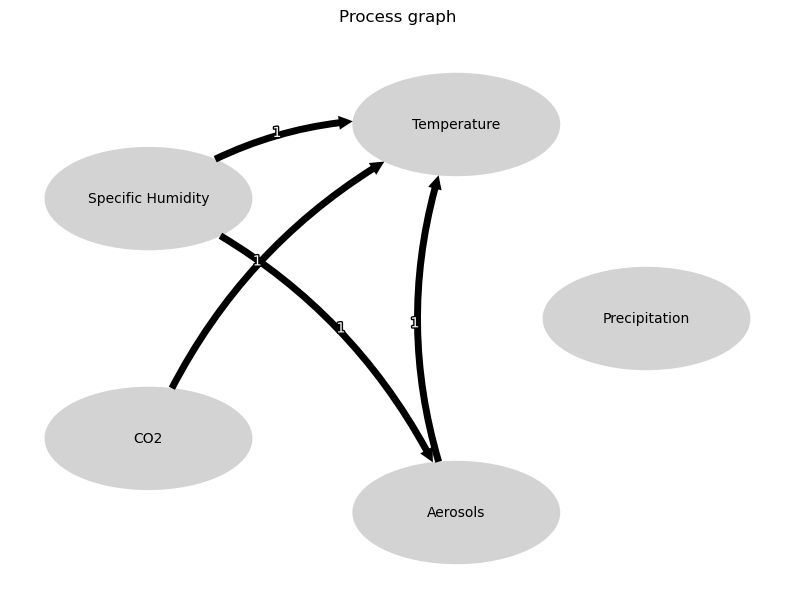


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





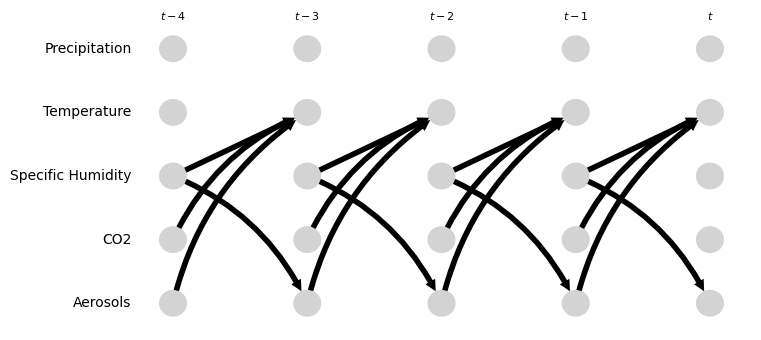

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.05 [-1.67, -0.15]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.57 [0.11, 1.22]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.02 [-0.23, 1.12]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.79 [-1.06, -0.29]
Negative precipitation values in event 173: 0


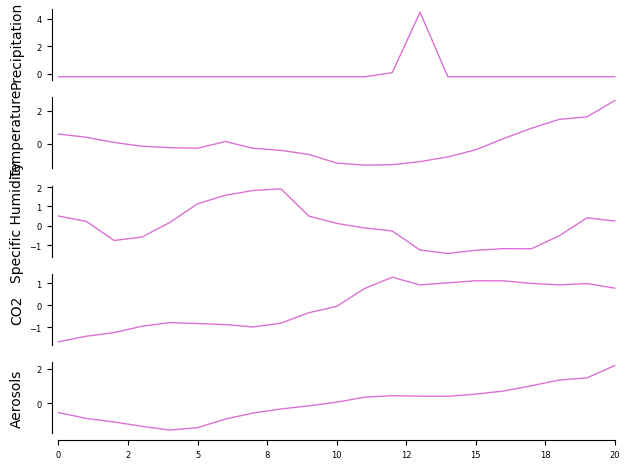

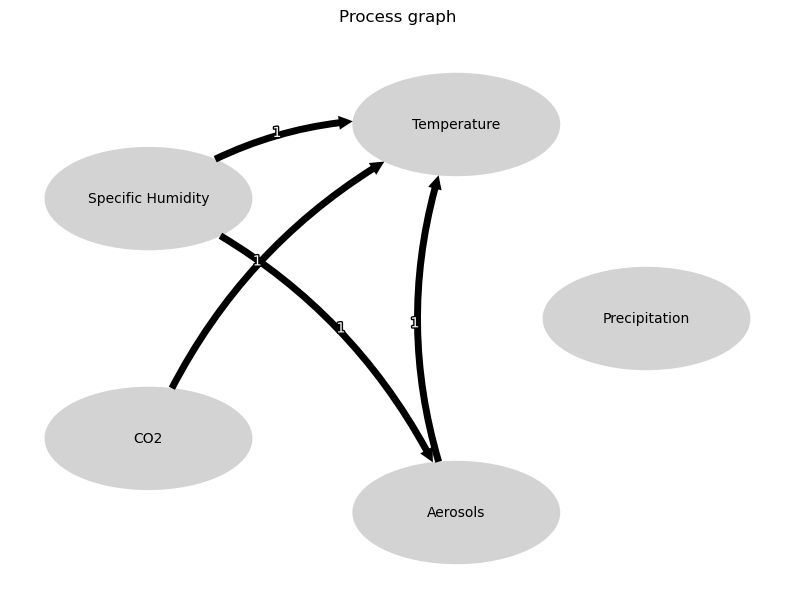


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





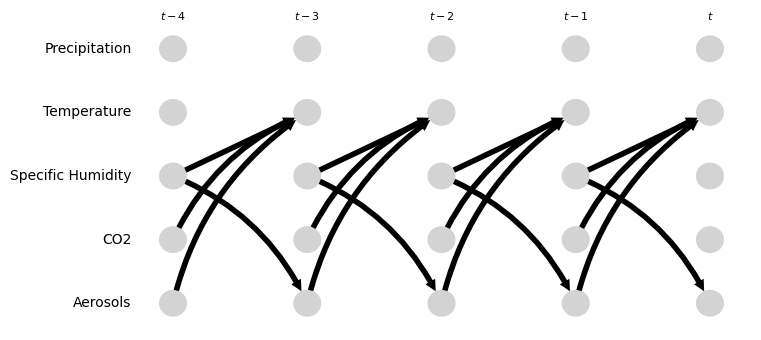

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.75 [-2.16, 2.01]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 1.21 [-0.75, 2.00]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.15 [-1.08, 0.88]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.41 [-0.64, -0.33]
Negative precipitation values in event 174: 0


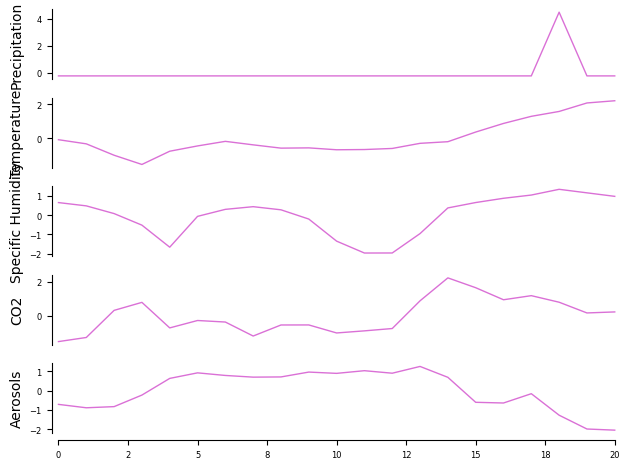

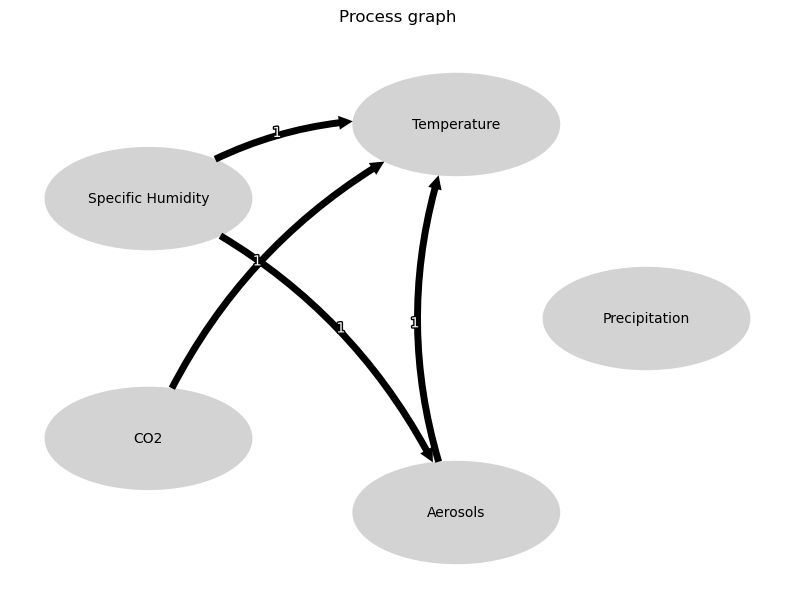


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





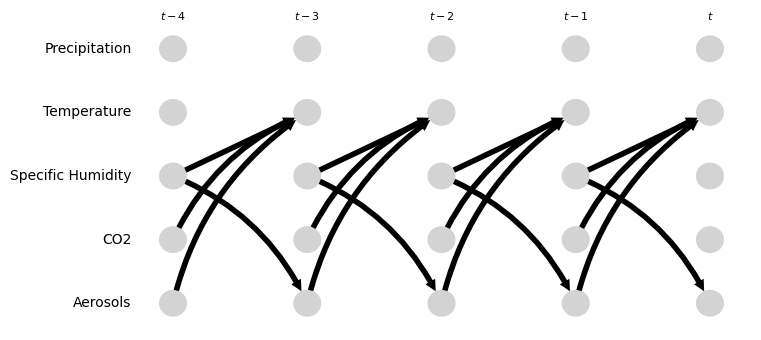

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.29 [0.09, 0.51]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.88 [-1.14, -0.63]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.00 [-0.14, 0.14]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.75 [-0.90, -0.40]
Negative precipitation values in event 175: 0


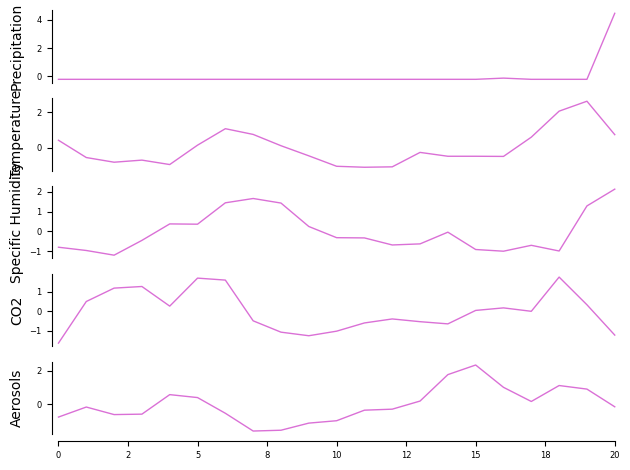

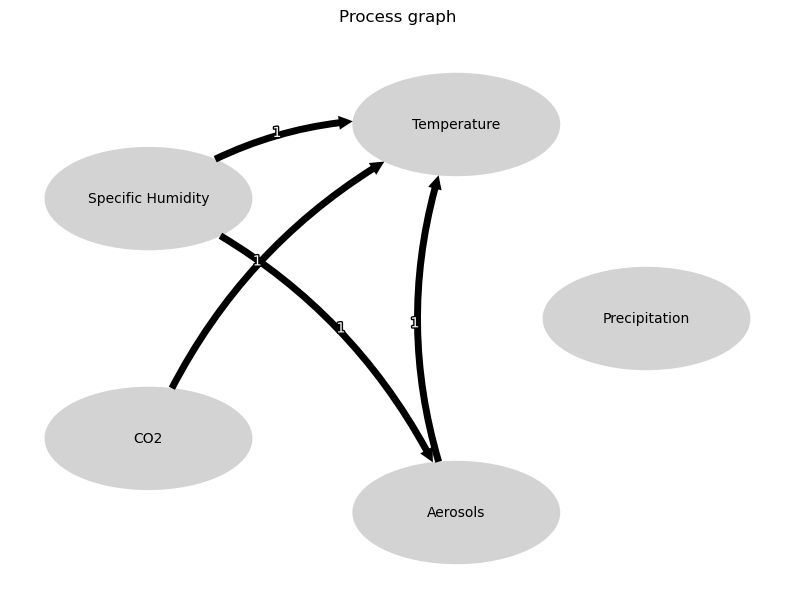


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





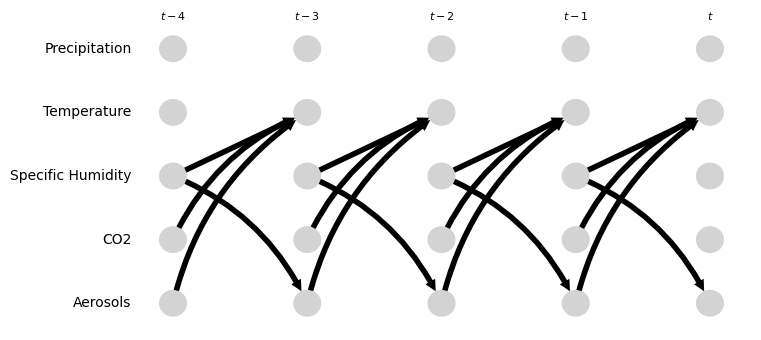

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.93 [0.64, 1.30]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.10 [-0.55, 0.22]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.18 [-0.90, 0.15]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.83 [-1.13, -0.73]
Negative precipitation values in event 176: 0


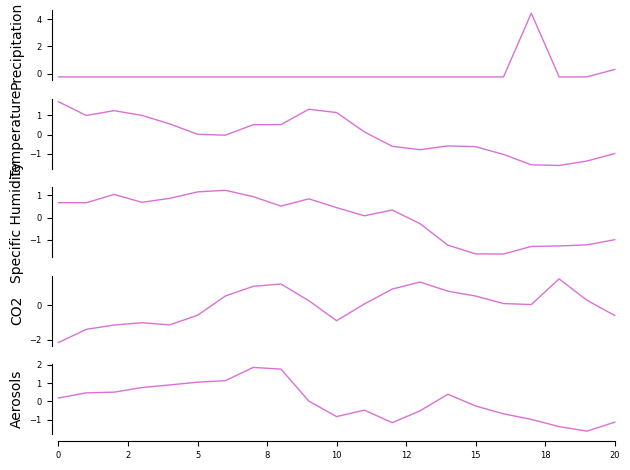

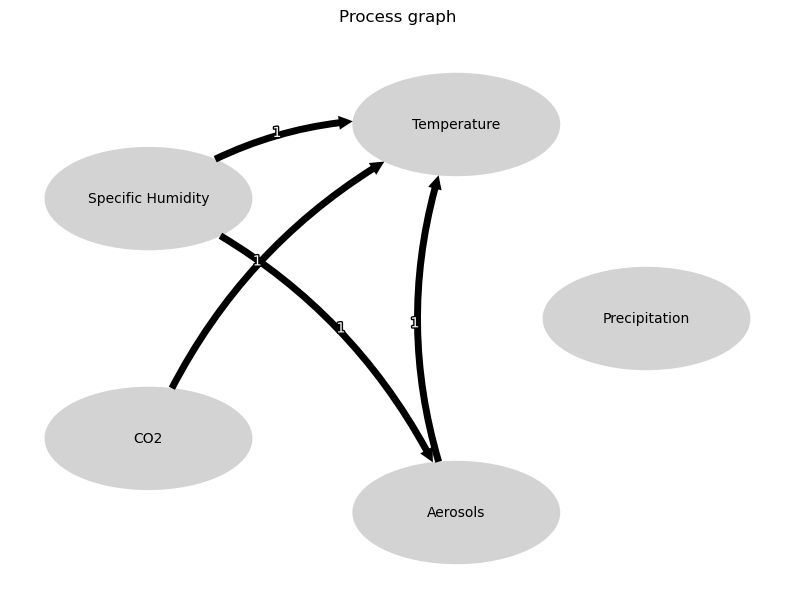


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





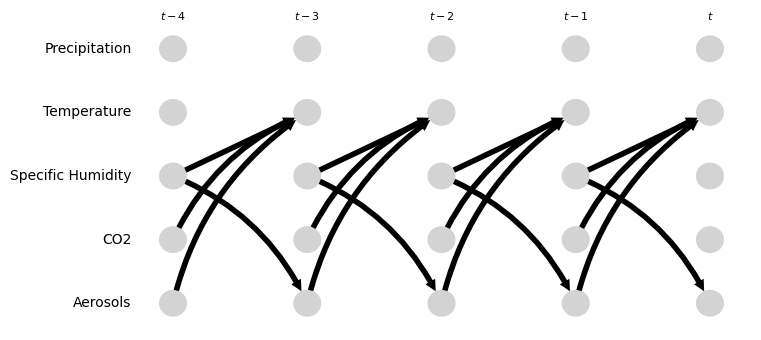

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.14 [-0.14, 0.50]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.27 [-0.05, 0.51]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.54 [0.36, 0.89]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.74 [0.43, 0.99]
Negative precipitation values in event 177: 0


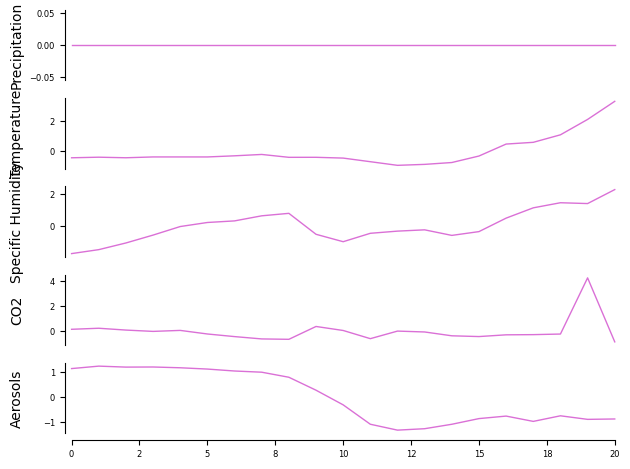

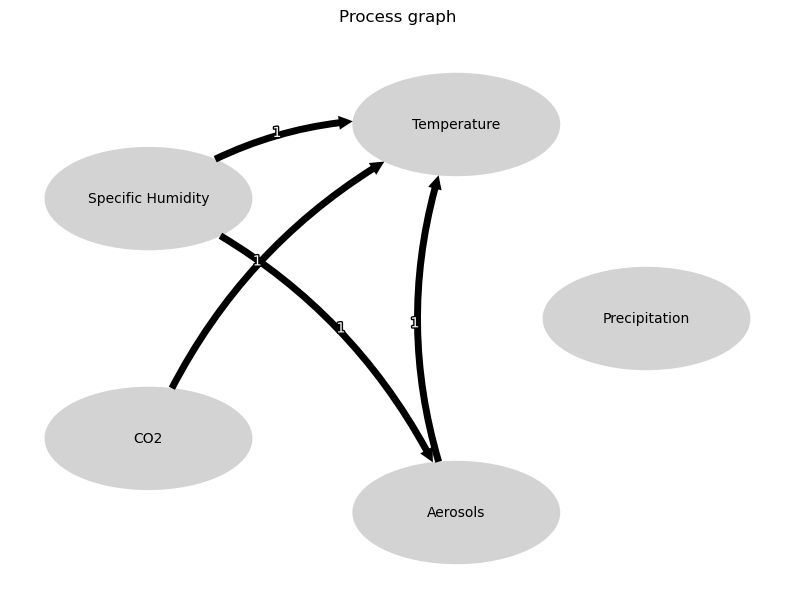


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





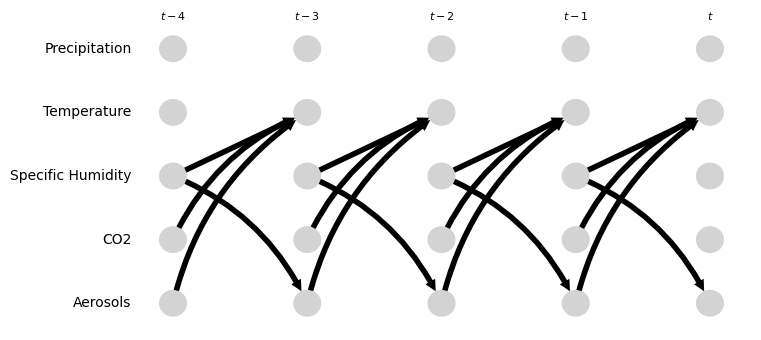

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.43 [-0.59, 1.22]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -0.28 [-0.48, -0.06]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.99 [0.52, 1.33]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.21 [0.01, 0.92]
Negative precipitation values in event 178: 0


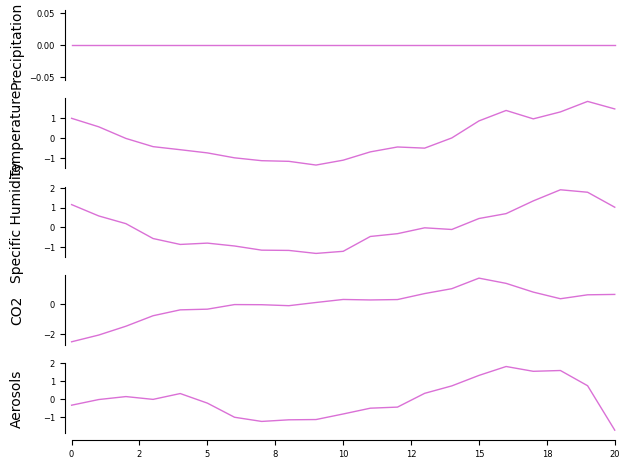

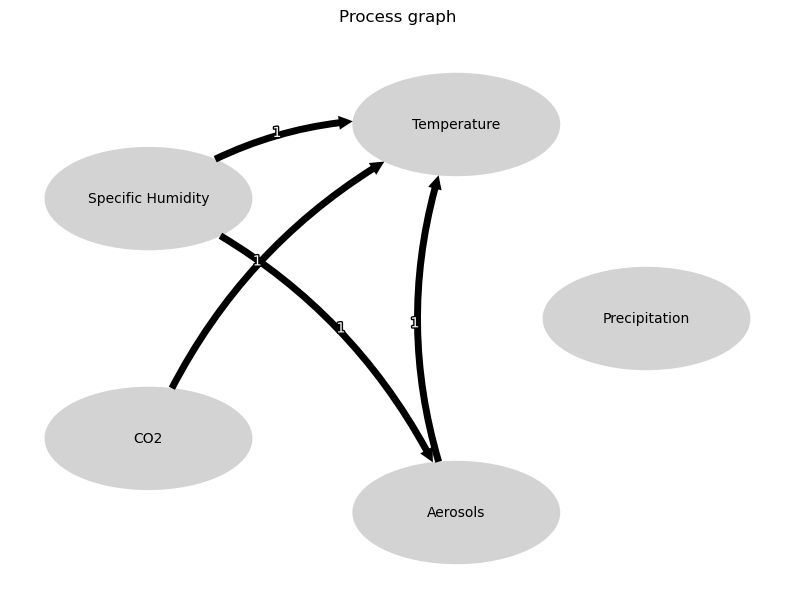


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





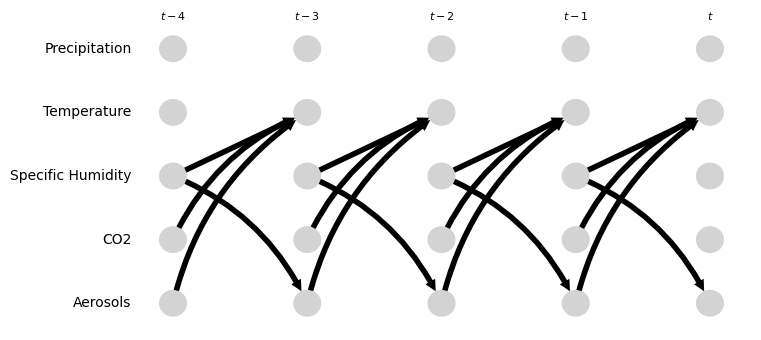

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.50 [0.28, 0.81]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.22 [0.03, 0.56]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.64 [-0.00, 0.83]
Effect of Specific Humidity on Aerosols


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 0.51 [0.67, 1.44]
Negative precipitation values in event 179: 0


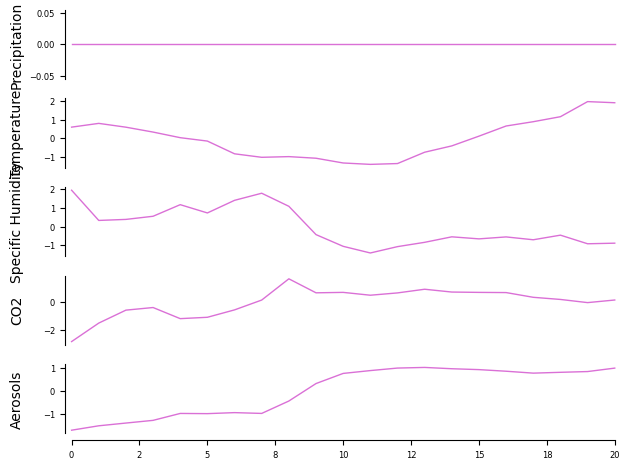

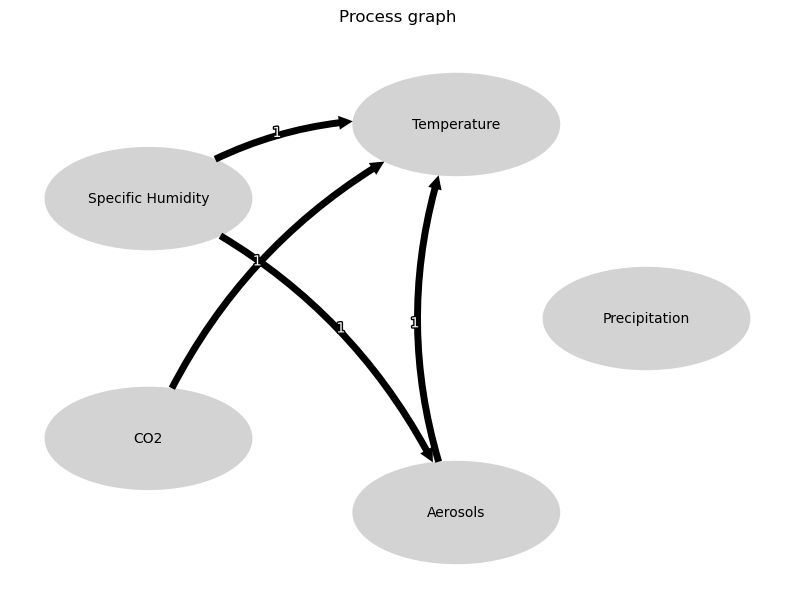


##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(3, -1)]
Y = [(1, 0)]
S = []
M = []





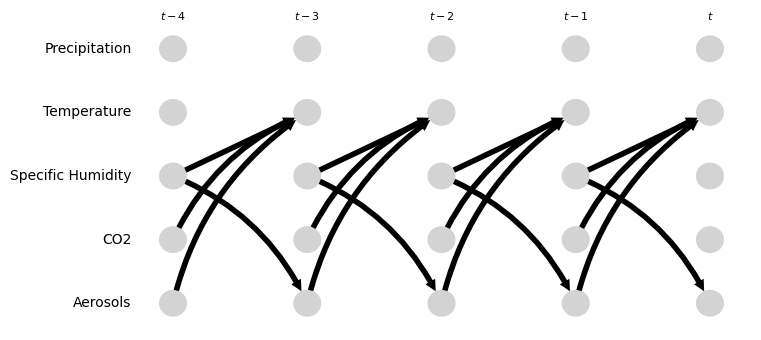

[(3, -1)]
[(1, 0)]
Effect of CO2 on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = -1.33 [-2.70, -0.61]
Effect of Aerosols on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 3.91 [2.37, 5.49]
Effect of Specific Humidity on Temperature


/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


Wright's path effect    = 2.26 [1.17, 3.06]
Effect of Specific Humidity on Aerosols
Wright's path effect    = -0.67 [-0.86, -0.48]
         CO2 on Temperature Aerosols on Temperature  \
0      [-0.434905877369194]   [0.05250033990261791]   
1     [-0.6025434813864997]  [-0.15381843850597518]   
2      [0.6529480096592423]  [-0.05919365924231835]   
3     [0.20668633552922322]   [-1.3564077092280635]   
4    [-0.36791941766481295]    [1.2227819297766966]   
..                      ...                     ...   
175    [0.9344173917920227]  [-0.10168657723121956]   
176    [0.1354999540868738]   [0.27199875031880083]   
177    [0.4257100644685723]   [-0.2753848979062181]   
178    [0.5048771771728188]   [0.22225753871676193]   
179   [-1.3348938016390426]     [3.909985723901276]   

    Specific Humidity on Temperature Specific Humidity on Aerosols  \
0               [0.5706767622939736]          [0.5434444966256755]   
1              [0.43908234851397354]         [-0.7824062380442152]  

/var/folders/j5/0j3xm4fn1qj5_2y9vvy7j8p80000gn/T/ipykernel_13039/2801705832.py:41: DeprecationWarning: Conversion of an array with ndim > 0 to a scalar is deprecated, and will error in future. Ensure you extract a single element from your array before performing this operation. (Deprecated NumPy 1.25.)
  print("Wright's path effect    = %.2f [%.2f, %.2f]"


In [23]:
######################## 30_min : CO2 and Aerosols ###############################

conf_interval_CO2_temp_1_=[]
conf_interval_aero_temp_1_=[]
conf_interval_sh_temp_1_=[]
conf_interval_sh_aero_1_=[]

conf_interval_CO2_temp_2_=[]
conf_interval_aero_temp_2_=[]
conf_interval_sh_temp_2_=[]
conf_interval_sh_aero_2_=[]

prediction_CO2_temp_=[]
prediction_aero_temp_=[]
prediction_sh_temp_=[]
prediction_sh_aero_=[]

####################################################################################

var_names = ['Precipitation','Temperature', "Specific Humidity", "CO2", "Aerosols"]

a=0
for rain in morning_events:

    data = pd.read_csv(path + f"{site}_30_min_meteorological_CO2_aerosol_data.csv")
    data['time'] = pd.to_datetime(data['time'])
    data["co2 spec. humidity (meas)"] = data["co2 spec. humidity (meas)"] * 1000
    data.set_index('time', inplace=True)

    # Rango del evento (sin resample)
    start_time, end_time = rain
    data_event = data[start_time:end_time]

    ##############################################################################################

    # Validation
    if data_event.empty:
        print(f"⚠️ Skipping event {a} ({start_time} to {end_time}) → no data in this window.")
        continue

    # Variables of interest
    numeric = data_event[["precipitation", 
                          "temperature", 
                          "co2 spec. humidity (meas)" ,
                          "co2 molar density", 
                          "total number conc"]]

    # Maksing
    negative_precip_mask = numeric["precipitation"] < 0
    print(f"Negative precipitation values in event {a}: {negative_precip_mask.sum()}")

    # Numpy Array
    data_array = numeric.to_numpy()

    # Reemplazo de valores negativos y NaNs
    data_array[negative_precip_mask.to_numpy(), :] = 999999  
    data_array[np.isnan(data_array)] = 999999
    
    # Scale
    scaler = StandardScaler()
    scaled_array = scaler.fit_transform(data_array)
    
    # Replace values
    scaled_array[negative_precip_mask.to_numpy(), :] = 999999

    scaled_array[np.isnan(scaled_array)] = 999999


    T, N = data_array.shape  

    # DataFrame
    dataframe = pp.DataFrame(scaled_array, var_names=var_names, missing_flag=999999)


    ######################################## PLOTTING  #############################################

    fig, axes = tp.plot_timeseries(dataframe=dataframe, color='orchid')

    # Change font size of y-labels
    for ax in axes:
        ax.set_ylabel(ax.get_ylabel(), fontsize=10) 

    # Align y-axis labels
    fig.align_ylabels(axes)
    plt.show()

    ############For 30 min data with co2 and aerosols########################################

    
    # Given Dag made with conclusions from causal discovery process
    hypothesis_graph = np.full((5, 5, 5), '', dtype='<U3')

    hypothesis_graph[2, 1, 1] = "-->"  # SH_{t-1} → Temp_t
    hypothesis_graph[4, 1, 1] = "-->"  # Aerosols_{t-1} → Temp_t
    hypothesis_graph[3, 1, 1] = "-->"  # CO2_{t-1} → Temp_t
    hypothesis_graph[2, 4, 1] = "-->"  # Aerosols_{t-1} → SH_t

    Specific_Humidity = [(2, -1)]
    CO2 = [(3, -1)]  
    Aerosols = [(4, -1)]
    Temperature = [(1, 0)]
    Aerosols_due_SH = [(4,0)]

    ##########################################################################################

    
    fig, ax = plt.subplots(figsize=(10, 7))  # Solo un eje

    tp.plot_graph(
        fig_ax=(fig, ax),
        graph=hypothesis_graph,
        arrow_linewidth=5,
        node_size=0.5,
        node_aspect=1.5,
        var_names=var_names,
        tick_label_size=6,
    )
    ax.set_title('Process graph', pad=20)
    plt.show()

    ###########################################################################################

    causal_effects = CausalEffects(hypothesis_graph, graph_type='stationary_dag', 
                                   X=CO2, 
                                   Y=Temperature, 
                                   S=None, 
                                   hidden_variables=None, #[(1, -1)], 
                                   verbosity=1)
    
    tp.plot_time_series_graph(graph = hypothesis_graph,
    var_names=var_names, 
    figsize = (8, 4),
    ); plt.show()
    
    newX, newY = causal_effects.check_XYS_paths()

    print(newX)
    print(newY)
    
    # Optional data transform
    data_transform = None  # sklearn.preprocessing.StandardScaler()

    # Confidence interval range
    conf_lev = 0.9
 
    ################################################################################
  
    #Effect of CO2 on Temperature 
    print('Effect of CO2 on Temperature')
    prediction_CO2_temp, conf_interval_CO2_temp_1, conf_interval_CO2_temp_2 = get_path_effect(hypothesis_graph, X=CO2, Y=Temperature, mediation="direct", conf_lev=0.9)
    
    print('Effect of Aerosols on Temperature')
    prediction_aero_temp, conf_interval_aero_temp_1, conf_interval_aero_temp_2 = get_path_effect(hypothesis_graph, X=Aerosols, Y=Temperature, mediation="direct", conf_lev=0.9)

    print('Effect of Specific Humidity on Temperature')
    prediction_sh_temp,conf_interval_sh_temp_1, conf_interval_sh_temp_2 = get_path_effect(hypothesis_graph, X=Specific_Humidity, Y=Temperature, mediation="direct", conf_lev=0.9)

    print('Effect of Specific Humidity on Aerosols')
    prediction_sh_aero, conf_interval_sh_aero_1,  conf_interval_sh_aero_2 = get_path_effect(hypothesis_graph, X=Specific_Humidity, Y=Aerosols_due_SH , mediation="direct", conf_lev=0.9)
    
    prediction_CO2_temp_.append(prediction_CO2_temp)
    prediction_aero_temp_.append(prediction_aero_temp)
    prediction_sh_temp_.append(prediction_sh_temp)
    prediction_sh_aero_.append(prediction_sh_aero)
    
    conf_interval_CO2_temp_1_.append(conf_interval_CO2_temp_1)
    conf_interval_aero_temp_1_.append(conf_interval_aero_temp_1)
    conf_interval_sh_temp_1_.append(conf_interval_sh_temp_1)
    conf_interval_sh_aero_1_.append(conf_interval_sh_aero_1)
    
    conf_interval_CO2_temp_2_.append(conf_interval_CO2_temp_2)
    conf_interval_aero_temp_2_.append(conf_interval_aero_temp_2)
    conf_interval_sh_temp_2_.append(conf_interval_sh_temp_2)
    conf_interval_sh_aero_2_.append(conf_interval_sh_aero_2)
    
    a=a+1

# 30_min_data
data = {
    'CO2 on Temperature':prediction_CO2_temp_,
    'Aerosols on Temperature':prediction_aero_temp_,
    'Specific Humidity on Temperature':prediction_sh_temp_,
    'Specific Humidity on Aerosols': prediction_sh_aero_,
    'CO2 on Temperature interval 1' :conf_interval_CO2_temp_1_,
    'Aerosols on Temperature interval 1':conf_interval_aero_temp_1_,
    'Specific Humidity on Temperature interval 1':conf_interval_sh_temp_1_,
    'Specific Humidity on Aerosols interval 1':conf_interval_sh_aero_1_,
    'CO2 on Temperature interval 2' :conf_interval_CO2_temp_2_,
    'Aerosols on Temperature interval 2':conf_interval_aero_temp_2_,
    'Specific Humidity on Temperature interval 2': conf_interval_sh_temp_2_,
    'Specific Humidity on Aerosols interval 2': conf_interval_sh_aero_2_
}


# Crear DataFrame
df_effects = pd.DataFrame(data)

# Mostrar tabla
print(df_effects)

#Wright Path Coefficients
df_effects.to_csv(f'WPC_{site}_morning_table_new.csv', index=False)



In [22]:

# Crear un diccionario con los datos
data = {
    'CO2 on Temperature':prediction_CO2_temp_,
    'Aerosols on Temperature':prediction_aero_temp_,
    'Specific Humidity on Temperature':prediction_sh_temp_,
    'Specific Humidity on Aerosols': prediction_sh_aero_,
    'CO2 on Temperature interval 1' :conf_interval_CO2_temp_1_,
    'Aerosols on Temperature interval 1':conf_interval_aero_temp_1_,
    'Specific Humidity on Temperature interval 1':conf_interval_sh_temp_1_,
    'Specific Humidity on Aerosols: interval 1':conf_interval_sh_aero_1_,
    'CO2 on Temperature interval 2' :conf_interval_CO2_temp_2_,
    'Aerosols on Temperature interval 2':conf_interval_aero_temp_2_,
    'Specific Humidity on Temperature interval 2': conf_interval_sh_temp_2_,
    'Specific Humidity on Aerosols: interval 2': conf_interval_sh_aero_2_
}

# Crear DataFrame
df_effects = pd.DataFrame(data)

# Mostrar tabla
print(df_effects)

#Wright Path Coefficients
df_effects.to_csv(f'WPC_{site}_morning_table.csv', index=False)


        CO2 on Temperature   Aerosols on Temperature  \
0      [7.163029207109503]    [0.013835160200316495]   
1      [3.269096707459539]     [0.01004230389930249]   
2     [0.7244426919050966]   [0.0005263388695337562]   
3      [5.329482495921411]    [0.003703633130022595]   
4    [-1.1197905480585177]   [-0.001054395750753324]   
..                     ...                       ...   
171  [-0.7955903781227107]   [-0.006121564996379483]   
172   [0.4218146329348542]   [-0.025646296534897823]   
173  [-0.2603549822911191]   [-0.019385831146849424]   
174  [-0.5425979135594616]   [0.0016958916010478338]   
175  [-0.9233641166147564]  [-0.0016242946920123963]   

    Specific Humidity on Temperature Specific Humidity on Aerosols  \
0              [-14981.304843115968]          [159986.75319433783]   
1               [-52497.84607774581]          [2014741.7073926763]   
2               [-1449.106417398967]          [-250340.3199467877]   
3               [-2022.624858579965]          [

In [39]:
graph 

array([[['', ''],
        ['', ''],
        ['', ''],
        ['', ''],
        ['', '']],

       [['', ''],
        ['', '-->'],
        ['', ''],
        ['', ''],
        ['', '']],

       [['', ''],
        ['', ''],
        ['', '-->'],
        ['', ''],
        ['', '']],

       [['', ''],
        ['', ''],
        ['', ''],
        ['', ''],
        ['<--', '']],

       [['', ''],
        ['', ''],
        ['', ''],
        ['-->', ''],
        ['', '']]], dtype='<U3')

In [53]:
parents

{0: [], 1: [(1, -1)], 2: [(2, -1)], 3: [(4, 0)], 4: []}

In [55]:
X = [(0, 0)]  # causa
Y = [(4, 0)]  # efecto

causal_effects = CausalEffects(graph, graph_type='stationary_dag', X=X, Y=Y, S=None, 
                               hidden_variables=None, #[(1, -1)], 
                               verbosity=1)


No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, 0)]
Y = [(4, 0)]
S = []
M = []



No causal path from X to Y exists!


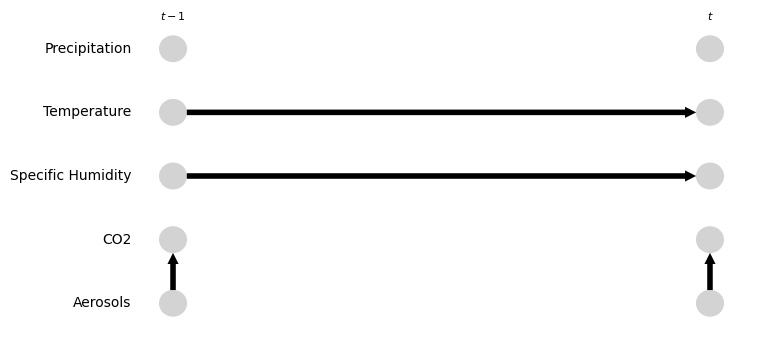

In [56]:
tp.plot_time_series_graph(graph = graph,
        var_names=var_names, 
#         save_name='Example.pdf',
        figsize = (8, 4),
        ); plt.show()

In [57]:
newX, newY = causal_effects.check_XYS_paths()

Consider pruning X = {(0, 0)} to X = set() since only these have causal path to Y
Consider pruning Y = {(4, 0)} to Y = set() since only these have causal path from X


In [59]:
# Optional data transform
data_transform = None  # sklearn.preprocessing.StandardScaler()

# Confidence interval range
conf_lev = 0.9

# Fit causal effect model from observational data
causal_effects.fit_total_effect(
    dataframe=dataframe, 
    mask_type='y',
    estimator=LinearRegression(),
    data_transform=data_transform,
    )

# Fit bootstrap causal effect model
causal_effects.fit_bootstrap_of(
    method='fit_total_effect',
    method_args={'dataframe':dataframe,  
    'mask_type':'y',
    'estimator':LinearRegression(),
    'data_transform':data_transform,
    },
    seed=4
    )

No causal path from X to Y exists.
No causal path from X to Y exists.


AttributeError: 'CausalEffects' object has no attribute 'model'

In [21]:
# Define interventions
dox_vals = np.linspace(0., 1., 2)

# Predict effect of interventions do(X=0.), ..., do(X=1.) in one go
intervention_data = np.repeat(dox_vals.reshape(len(dox_vals), 1), axis=1, repeats=len(X))
pred_Y = causal_effects.predict_total_effect( 
        intervention_data=intervention_data)


In [58]:
opt = causal_effects.get_optimal_set()
print("Oset = ", [(var_names[v[0]], v[1]) for v in opt])

Oset =  []


In [22]:
# Bootstrap: Predict effect of interventions do(X=0.), ..., do(X=1.) in one go
intervention_data = np.repeat(dox_vals.reshape(len(dox_vals), 1), axis=1, repeats=len(X))
conf = causal_effects.predict_bootstrap_of(
    method='predict_total_effect',
    method_args={'intervention_data':intervention_data},
    conf_lev=conf_lev)

print("Total effect via adjustment = %.2f [%.2f, %.2f]"
        %(pred_Y[1]-pred_Y[0], conf[0,1]-conf[0,0], conf[1,1]-conf[1,0])) 

Total effect via adjustment = -5.43 [-6.48, -5.52]


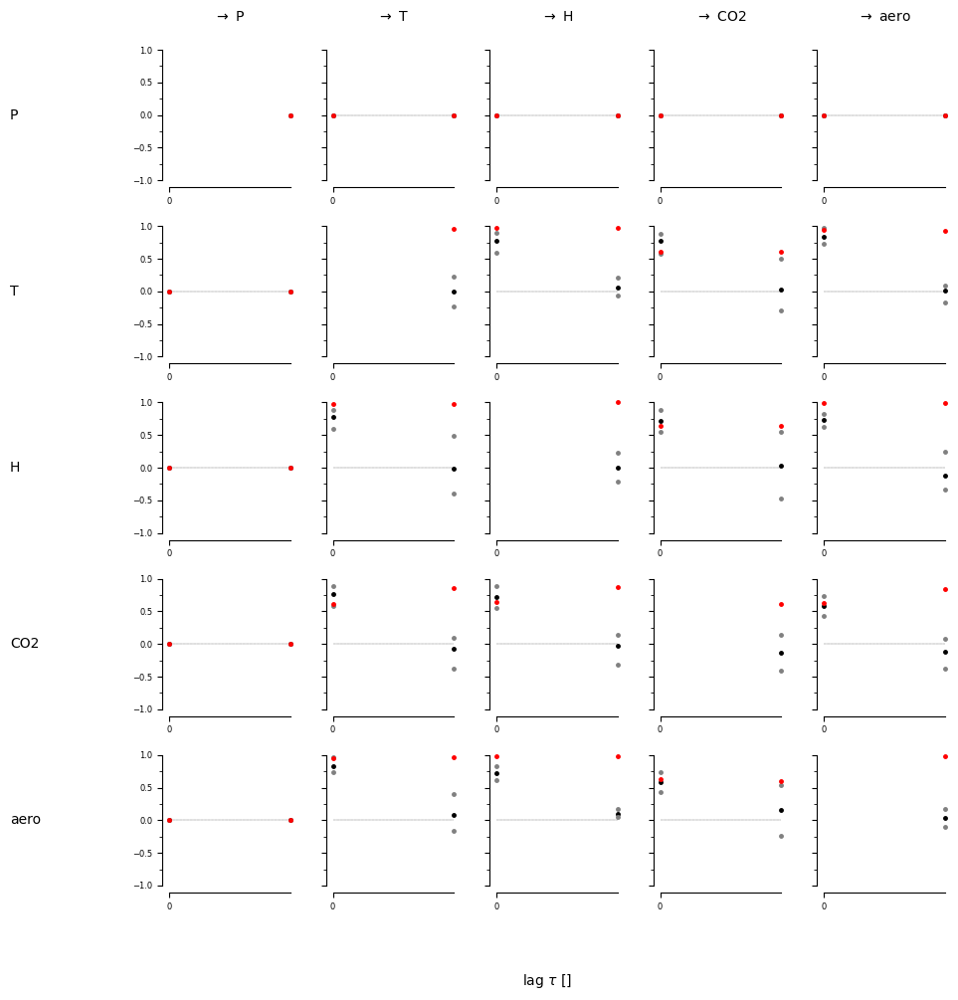

[[[False False]
  [False False]
  [False False]
  [False False]
  [False False]]

 [[False False]
  [False  True]
  [ True  True]
  [ True  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [False  True]
  [ True  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [ True  True]
  [False  True]
  [ True  True]]

 [[False False]
  [ True  True]
  [ True  True]
  [ True  True]
  [False  True]]]


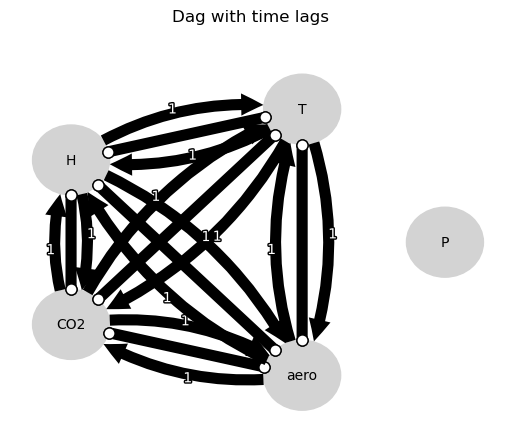


Precipitation
   Precipitation(t-0)    no relación
   Precipitation(t-1)    no relación
   Temperature(t-0)    no relación
   Temperature(t-1)    no relación
   Specific Humidity(t-0)    no relación
   Specific Humidity(t-1)    no relación
   CO2(t-0)    no relación
   CO2(t-1)    no relación
   Aerosols(t-0)    no relación
   Aerosols(t-1)    no relación

Temperature
   Precipitation(t-0)    no relación
   Precipitation(t-1)    no relación
   Temperature(t-0)    no relación
✅ Temperature(t-1) --> Temperature(t)
✅ Specific Humidity(t-0) --> Temperature(t)
✅ Specific Humidity(t-1) --> Temperature(t)
✅ CO2(t-0) --> Temperature(t)
✅ CO2(t-1) --> Temperature(t)
✅ Aerosols(t-0) --> Temperature(t)
✅ Aerosols(t-1) --> Temperature(t)

Specific Humidity
   Precipitation(t-0)    no relación
   Precipitation(t-1)    no relación
✅ Temperature(t-0) --> Specific Humidity(t)
✅ Temperature(t-1) --> Specific Humidity(t)
   Specific Humidity(t-0)    no relación
✅ Specific Humidity(t-1) --> Specific Hum

ValueError: Graph contains invalid graph edge. For graph_type = stationary_dag only ['-->', '<--', '<->', '<-+', '+->', ''] are allowed.

In [115]:
generator = surrogate_generator.generate_linear_model_from_data(dataframe, parents, tau_max, realizations=5, 
            generate_noise_from='covariance')

datasets = {}
for r in range(5):
    datasets[r] = next(generator)

#####################################################################################################

correlations = np.zeros((5, N, N, tau_max + 1))

for r in range(5):
    pcmci = PCMCI(
        dataframe=pp.DataFrame(datasets[r]), 
        cond_ind_test=RobustParCorr(),
        verbosity=0)
    correlations[r] = pcmci.get_lagged_dependencies(tau_max=tau_max, val_only=True)['val_matrix']

# Get mean and 5th and 95th quantile
correlation_mean = correlations.mean(axis=0)
correlation_interval = np.percentile(correlations, q=[5, 95], axis=0)

# Plot lag functions of mean and 5th and 95th quantile together with original correlation in one plot
lag_func_matrix = tp.setup_matrix(N=N, tau_max=tau_max, x_base=10, figsize=(10, 10), var_names=var_names, label_space_left=0.17)
lag_func_matrix.add_lagfuncs(val_matrix=correlation_mean, color='black')
lag_func_matrix.add_lagfuncs(val_matrix=correlation_interval[0], color='grey')
lag_func_matrix.add_lagfuncs(val_matrix=correlation_interval[1], color='grey')
lag_func_matrix.add_lagfuncs(val_matrix=original_correlations, color='red')
lag_func_matrix.savefig(name=None)

pcmci = PCMCI(
    dataframe=dataframe, 
    cond_ind_test=parcorr,
    verbosity=0)

original_correlations_pvals = pcmci.get_lagged_dependencies(tau_max=tau_max)['p_matrix'] 

graph = original_correlations_pvals<0.01

print(graph)
 
fig, axes = tp.plot_graph(graph=graph, var_names=var_names, node_size=0.5)

fig.suptitle(f"Dag with time lags")

# Align y-axis labels
fig.align_ylabels(axes)
plt.show()

met_vars = ["Precipitation", "Temperature", "Specific Humidity", "CO2", "Aerosols"]
N = len(met_vars)

# Creamos el arreglo de strings vacío
str_array = np.full(graph.shape, '', dtype='<U4')  # shape: (5, 5, 2)

# Recorremos y llenamos las flechas
for effect_idx in range(N):  # j: variable efecto
    effect_var = met_vars[effect_idx]
    print(f"\n{effect_var}")

    for cause_idx in range(N):  # i: variable causa
        cause_var = met_vars[cause_idx]

        for lag, element in enumerate(graph[effect_idx][cause_idx]):
            if element:
                str_array[effect_idx, cause_idx, lag] = "-->"  # ← esta línea actualiza el grafo
                print(f"✅ {cause_var}(t-{lag}) --> {effect_var}(t)")
            else:
                print(f"   {cause_var}(t-{lag})    no relación")

for i in range(5):
    for j in range(5):
        for lag in range(2):
            if str_array[i, j, lag] == '-->' and str_array[j, i, lag] == '-->':
                # Decide quitar la arista (j,i) para romper ciclo
                str_array[j, i, lag] = ''
                print(f"Quitando ciclo entre {j} -> {i} lag {lag}")

print(str_array.shape)

# Imprimir de forma legible
# for i in range(str_array.shape[0]):
#     print(str_array[i])

X = [(0, 0)]  # causa
Y = [(4, 0)]  # efecto

causal_effects = CausalEffects(graph, graph_type='stationary_dag', X=X, Y=Y, S=None, 
                               hidden_variables=None, #[(1, -1)], 
                               verbosity=1)



In [18]:
graph

array([[[False, False],
        [False, False],
        [False, False],
        [False, False],
        [False, False]],

       [[False, False],
        [False,  True],
        [ True,  True],
        [ True,  True],
        [ True,  True]],

       [[False, False],
        [ True,  True],
        [False,  True],
        [ True,  True],
        [ True,  True]],

       [[False, False],
        [ True,  True],
        [ True,  True],
        [False,  True],
        [ True,  True]],

       [[False, False],
        [ True,  True],
        [ True,  True],
        [ True,  True],
        [False,  True]]])

In [31]:
vars_order = ["Precipitation","Temperature","Specific Humidity","CO2 Density", "Aerosols"]

a=0
for i in graph:
    
    print(vars_order[a])
    print(i)
    
    a=a+1

Precipitation
[[False False]
 [False False]
 [False False]
 [False False]
 [False False]]
Temperature
[[False False]
 [False  True]
 [ True  True]
 [ True  True]
 [ True  True]]
Specific Humidity
[[False False]
 [ True  True]
 [False  True]
 [ True  True]
 [ True  True]]
CO2 Density
[[False False]
 [ True  True]
 [ True  True]
 [False  True]
 [ True  True]]
Aerosols
[[False False]
 [ True  True]
 [ True  True]
 [ True  True]
 [False  True]]


In [112]:
print(graph.shape)

(5, 5, 2)


In [113]:
for effect in range(5):
    for cause in range(5):
        for lag in range(2):
            if str_array[effect, cause, lag] == '-->' and str_array[cause, effect, lag] == '-->':
                print(f"Ciclo detectado entre {effect} y {cause} en lag {lag}")

Ciclo detectado entre 1 y 1 en lag 1
Ciclo detectado entre 1 y 2 en lag 0
Ciclo detectado entre 1 y 2 en lag 1
Ciclo detectado entre 1 y 3 en lag 0
Ciclo detectado entre 1 y 3 en lag 1
Ciclo detectado entre 1 y 4 en lag 0
Ciclo detectado entre 1 y 4 en lag 1
Ciclo detectado entre 2 y 1 en lag 0
Ciclo detectado entre 2 y 1 en lag 1
Ciclo detectado entre 2 y 2 en lag 1
Ciclo detectado entre 2 y 3 en lag 0
Ciclo detectado entre 2 y 3 en lag 1
Ciclo detectado entre 2 y 4 en lag 0
Ciclo detectado entre 2 y 4 en lag 1
Ciclo detectado entre 3 y 1 en lag 0
Ciclo detectado entre 3 y 1 en lag 1
Ciclo detectado entre 3 y 2 en lag 0
Ciclo detectado entre 3 y 2 en lag 1
Ciclo detectado entre 3 y 3 en lag 1
Ciclo detectado entre 3 y 4 en lag 0
Ciclo detectado entre 3 y 4 en lag 1
Ciclo detectado entre 4 y 1 en lag 0
Ciclo detectado entre 4 y 1 en lag 1
Ciclo detectado entre 4 y 2 en lag 0
Ciclo detectado entre 4 y 2 en lag 1
Ciclo detectado entre 4 y 3 en lag 0
Ciclo detectado entre 4 y 3 en lag 1
C

In [114]:
for i in range(5):
    for j in range(5):
        for lag in range(2):
            if str_array[i, j, lag] == '-->' and str_array[j, i, lag] == '-->':
                # Decide quitar la arista (j,i) para romper ciclo
                str_array[j, i, lag] = ''
                print(f"Quitando ciclo entre {j} -> {i} lag {lag}")


Quitando ciclo entre 1 -> 1 lag 1
Quitando ciclo entre 2 -> 1 lag 0
Quitando ciclo entre 2 -> 1 lag 1
Quitando ciclo entre 3 -> 1 lag 0
Quitando ciclo entre 3 -> 1 lag 1
Quitando ciclo entre 4 -> 1 lag 0
Quitando ciclo entre 4 -> 1 lag 1
Quitando ciclo entre 2 -> 2 lag 1
Quitando ciclo entre 3 -> 2 lag 0
Quitando ciclo entre 3 -> 2 lag 1
Quitando ciclo entre 4 -> 2 lag 0
Quitando ciclo entre 4 -> 2 lag 1
Quitando ciclo entre 3 -> 3 lag 1
Quitando ciclo entre 4 -> 3 lag 0
Quitando ciclo entre 4 -> 3 lag 1
Quitando ciclo entre 4 -> 4 lag 1


In [85]:
met_vars = ["Precipitation","Temperature","Specific Humidity","CO2", "Aerosols"]


N = len(met_vars)  # Esto debe valer 5
for index in range(5):  # effect variable
    
    print(met_vars[index])
    
    for ind in range(5):  # cause variable

        effect_var = met_vars[index]
        cause_var = met_vars[ind]
        

        for lag, element in enumerate(graph[index][ind]):
            #print(lag)

            if element == True:  
                if effect_var == "Precipitation":
                    if cause_var == "Precipitation":
                        #P_P.append(lag)
                        print(element)

                    elif cause_var == "Temperature":
                        #P_T.append(lag)
                        print(element)

                    elif cause_var == "Specific Humidity":
                        #P_H.append(lag)
                        print(element)

                    elif cause_var == "CO2":
                        #P_CO2.append(lag)
                        print(element)

                    elif cause_var == "Aerosols":
                        #P_aero.append(lag)
                        print(element)


                ####################################

                elif effect_var == "Temperature":
                    if cause_var == "Precipitation":
                        print(element)

                        #T_P.append(lag)
                    elif cause_var == "Temperature":
                        #T_T.append(lag)
                        print(element)
                        
                    elif cause_var == "Specific Humidity":
                        #T_H.append(lag)
                        print(element)

                    elif cause_var == "CO2":
                        #T_CO2.append(lag)
                        print(element)

                    elif cause_var == "Aerosols":
                        #T_aero.append(lag)
                        print(element)

                ####################################

                elif effect_var == "Specific Humidity":
                    if cause_var == "Precipitation":
                        #H_P.append(lag)
                        print(element)

                    elif cause_var == "Temperature":
                        #H_T.append(lag)
                        print(element)

                    elif cause_var == "Specific Humidity":
                        #H_H.append(lag)
                        print(element)

                    elif cause_var == "CO2":
                        #H_CO2.append(lag)
                        print(element)

                    elif cause_var == "Aerosols":
                        #H_aero.append(lag)
                        print(element)

                ####################################

                elif effect_var == "CO2":
                    if cause_var == "Precipitation":
                        #CO2_P.append(lag)
                        print(element)

                    elif cause_var == "Temperature":
                        #CO2_T.append(lag)
                        print(element)

                    elif cause_var == "Specific Humidity":
                        #CO2_H.append(lag)
                        print(element)

                    elif cause_var == "CO2":
                        #CO2_CO2.append(lag)
                        print(element)

                    elif cause_var == "Aerosols":
                        #CO2_aero.append(lag)
                        print(element)

                ####################################

                elif effect_var == "Aerosols":
                    if cause_var == "Precipitation":
                        #aero_P.append(lag)
                        print(element)

                    elif cause_var == "Temperature":
                        #aero_T.append(lag)
                        print(element)

                    elif cause_var == "Specific Humidity":
                        #aero_H.append(lag)
                        print(element)

                    elif cause_var == "CO2":
                        #aero_CO2.append(lag)
                        print(element)

                    elif cause_var == "Aerosols":
                        #aero_aero.append(lag)
                        print(element)


            else:
                element == False
                print(element)


Precipitation
False
False
False
False
False
False
False
False
False
False
Temperature
False
False
False
True
True
True
True
True
True
True
Specific Humidity
False
False
True
True
False
True
True
True
True
True
CO2
False
False
True
True
True
True
False
True
True
True
Aerosols
False
False
True
True
True
True
True
True
False
True


In [86]:
met_vars = ["Precipitation", "Temperature", "Specific Humidity", "CO2", "Aerosols"]
N = len(met_vars)  # 5

for effect_idx in range(N):  # j: variable efecto
    effect_var = met_vars[effect_idx]
    print(f"\n{effect_var}")

    for cause_idx in range(N):  # i: variable causa
        cause_var = met_vars[cause_idx]

        for lag, element in enumerate(graph[effect_idx][cause_idx]):  # graph[j][i][tau]
            if element:
                print(f"✅ {cause_var}(t-{lag}) --> {effect_var}(t)")
            else:
                print(f"   {cause_var}(t-{lag})    no relación")



Precipitation
   Precipitation(t-0)    no relación
   Precipitation(t-1)    no relación
   Temperature(t-0)    no relación
   Temperature(t-1)    no relación
   Specific Humidity(t-0)    no relación
   Specific Humidity(t-1)    no relación
   CO2(t-0)    no relación
   CO2(t-1)    no relación
   Aerosols(t-0)    no relación
   Aerosols(t-1)    no relación

Temperature
   Precipitation(t-0)    no relación
   Precipitation(t-1)    no relación
   Temperature(t-0)    no relación
✅ Temperature(t-1) --> Temperature(t)
✅ Specific Humidity(t-0) --> Temperature(t)
✅ Specific Humidity(t-1) --> Temperature(t)
✅ CO2(t-0) --> Temperature(t)
✅ CO2(t-1) --> Temperature(t)
✅ Aerosols(t-0) --> Temperature(t)
✅ Aerosols(t-1) --> Temperature(t)

Specific Humidity
   Precipitation(t-0)    no relación
   Precipitation(t-1)    no relación
✅ Temperature(t-0) --> Specific Humidity(t)
✅ Temperature(t-1) --> Specific Humidity(t)
   Specific Humidity(t-0)    no relación
✅ Specific Humidity(t-1) --> Specific Hum

In [104]:
met_vars = ["Precipitation", "Temperature", "Specific Humidity", "CO2", "Aerosols"]
N = len(met_vars)

# Supongamos que `graph` es tu grafo booleano de shape (5, 5, 2)
# Creamos el arreglo de strings vacío
str_array = np.full(graph.shape, '', dtype='<U4')  # shape: (5, 5, 2)

# Recorremos y llenamos las flechas
for effect_idx in range(N):  # j: variable efecto
    effect_var = met_vars[effect_idx]
    print(f"\n{effect_var}")

    for cause_idx in range(N):  # i: variable causa
        cause_var = met_vars[cause_idx]

        for lag, element in enumerate(graph[effect_idx][cause_idx]):
            if element:
                str_array[effect_idx, cause_idx, lag] = '-->'  # ← esta línea actualiza el grafo
                print(f"✅ {cause_var}(t-{lag}) --> {effect_var}(t)")
            else:
                print(f"   {cause_var}(t-{lag})    no relación")



Precipitation
   Precipitation(t-0)    no relación
   Precipitation(t-1)    no relación
   Temperature(t-0)    no relación
   Temperature(t-1)    no relación
   Specific Humidity(t-0)    no relación
   Specific Humidity(t-1)    no relación
   CO2(t-0)    no relación
   CO2(t-1)    no relación
   Aerosols(t-0)    no relación
   Aerosols(t-1)    no relación

Temperature
   Precipitation(t-0)    no relación
   Precipitation(t-1)    no relación
   Temperature(t-0)    no relación
✅ Temperature(t-1) --> Temperature(t)
✅ Specific Humidity(t-0) --> Temperature(t)
✅ Specific Humidity(t-1) --> Temperature(t)
✅ CO2(t-0) --> Temperature(t)
✅ CO2(t-1) --> Temperature(t)
✅ Aerosols(t-0) --> Temperature(t)
✅ Aerosols(t-1) --> Temperature(t)

Specific Humidity
   Precipitation(t-0)    no relación
   Precipitation(t-1)    no relación
✅ Temperature(t-0) --> Specific Humidity(t)
✅ Temperature(t-1) --> Specific Humidity(t)
   Specific Humidity(t-0)    no relación
✅ Specific Humidity(t-1) --> Specific Hum

In [111]:
str_array

array([[['', ''],
        ['', ''],
        ['', ''],
        ['', ''],
        ['', '']],

       [['', ''],
        ['', '-->'],
        ['-->', '-->'],
        ['-->', '-->'],
        ['-->', '-->']],

       [['', ''],
        ['-->', '-->'],
        ['', '-->'],
        ['-->', '-->'],
        ['-->', '-->']],

       [['', ''],
        ['-->', '-->'],
        ['-->', '-->'],
        ['', '-->'],
        ['-->', '-->']],

       [['', ''],
        ['-->', '-->'],
        ['-->', '-->'],
        ['-->', '-->'],
        ['', '-->']]], dtype='<U4')

In [102]:
# Paso 1: Inicializa el arreglo de strings con forma igual a tu grafo
str_array = np.full(graph.shape, '', dtype='<U4')  # (5, 5, 2)

# Supongamos que tienes un grafo booleano:
# graph.shape = (5, 5, 2)  → (effect, cause, lag)

# # Inserta manualmente las flechas deseadas
str_array[1, 1, 1] = '-->'
str_array[3, 4, 0] = '<--'
str_array[4, 3, 0] = '-->'

str_array[cause,effect,lag] = '-->'


In [103]:
str_array = np.full((5, 5, 2), '', dtype='<U4')

# Ejemplo de cómo hacerlo en bucle
for cause in range(5):
    for effect in range(5):
        for lag in range(2):
            if some_condition:  # reemplaza esto con tu criterio o matriz booleana
                str_array[effect, cause, lag] = '-->'

NameError: name 'some_condition' is not defined

In [17]:
# Inicializa array de strings vacíos
str_array = np.full(graph.shape, '', dtype='<U4')

# Inserta manualmente las flechas deseadas
# str_array[1, 1, 1] = '-->'
# str_array[3, 4, 0] = '<--'
# str_array[4, 3, 0] = '-->'

# Imprimir de forma legible
for i in range(str_array.shape[0]):
    print(str_array[i])

[['' '']
 ['' '']
 ['' '']
 ['' '']
 ['' '']]
[['' '']
 ['' '']
 ['' '']
 ['' '']
 ['' '']]
[['' '']
 ['' '']
 ['' '']
 ['' '']
 ['' '']]
[['' '']
 ['' '']
 ['' '']
 ['' '']
 ['' '']]
[['' '']
 ['' '']
 ['' '']
 ['' '']
 ['' '']]


In [87]:
import numpy as np

met_vars = ["Precipitation", "Temperature", "Specific Humidity", "CO2", "Aerosols"]
N = len(met_vars)

# Paso 1: Inicializa el arreglo de strings con forma igual a tu grafo
str_array = np.full(graph.shape, '', dtype='<U4')  # (5, 5, 2)

# Paso 2: Copia las flechas en las posiciones donde hay relación
for effect_idx in range(N):
    for cause_idx in range(N):
        for lag in range(2):
            if graph[effect_idx, cause_idx, lag]:  # si hay relación causal
                str_array[effect_idx, cause_idx, lag] = '-->'  # o el tipo de flecha que necesites


In [88]:
str_array

array([[['', ''],
        ['', ''],
        ['', ''],
        ['', ''],
        ['', '']],

       [['', ''],
        ['', '-->'],
        ['-->', '-->'],
        ['-->', '-->'],
        ['-->', '-->']],

       [['', ''],
        ['-->', '-->'],
        ['', '-->'],
        ['-->', '-->'],
        ['-->', '-->']],

       [['', ''],
        ['-->', '-->'],
        ['-->', '-->'],
        ['', '-->'],
        ['-->', '-->']],

       [['', ''],
        ['-->', '-->'],
        ['-->', '-->'],
        ['-->', '-->'],
        ['', '-->']]], dtype='<U4')

In [66]:
X = [(0, 0)]  # causa
Y = [(4, 0)]  # efecto

causal_effects = CausalEffects(str_array, graph_type='stationary_dag', X=X, Y=Y, S=None, 
                               hidden_variables=None, #[(1, -1)], 
                               verbosity=1)


No causal path from X to Y exists.

##
## Initializing CausalEffects class
##

Input:

graph_type = stationary_dag
X = [(0, 0)]
Y = [(4, 0)]
S = []
M = []



No causal path from X to Y exists!
